In [1]:
#%install_ext https://raw.github.com/cpcloud/ipython-autotime/master/autotime.py
%load_ext autotime
import osmnx as ox, geopandas as gpd, pandas as pd, networkx as nx
import numpy as np
import matplotlib.pyplot as plt
from shapely.geometry import Point, LineString, Polygon, MultiPolygon
from IPython.display import Image
from descartes import PolygonPatch
from itertools import combinations, combinations_with_replacement
%matplotlib inline
ox.config(log_console=True, use_cache=True)
%config IPCompleter.greedy=True

import libpysal as lp

In [2]:
import pickle 
pickle_in = open("etas_cut_threshold_dict.pickle","rb")
etas_cut_threshold_dict = pickle.load(pickle_in)
etas_cut_threshold_dict

{'NY': array([1.        , 1.        , 1.        , 1.        , 1.        ,
        0.99991145, 0.98955316, 0.97868522, 0.96344498, 0.95205618,
        0.94615067, 0.93194961, 0.92540239, 0.92150344, 0.91822455,
        0.91569734, 0.91218202, 0.90337978, 0.898264  , 0.89376519,
        0.89441924, 0.88573077, 0.88617046, 0.87902683, 0.87195329,
        0.87101443, 0.87158631, 0.86935351, 0.86321974, 0.86053312,
        0.86079304, 0.86069179, 0.86140605, 0.85888874, 0.8617884 ,
        0.85709178, 0.8579834 , 0.85179248, 0.84947743, 0.84847717,
        0.84228408, 0.82983947, 0.82767187, 0.82334824, 0.81678545,
        0.81788964, 0.81304395, 0.807866  , 0.79902867, 0.79698224,
        0.78820712, 0.76853775, 0.76312442, 0.75071909, 0.7481045 ,
        0.73389742, 0.71700231, 0.70245218, 0.68328343, 0.67990807,
        0.66811743, 0.61552082, 0.58620924, 0.57826542, 0.57372339,
        0.55441141, 0.5326264 , 0.53706259, 0.53126932, 0.52772792,
        0.5331439 , 0.51700595, 0.49034259

time: 67 ms


In [3]:
chicago_data = np.zeros((100, 2))
chicago_data[:,0] = np.arange(100)
chicago_data[:,1] = etas_cut_threshold_dict['Chicago']
chicago_data

array([[0.00000000e+00, 1.00000000e+00],
       [1.00000000e+00, 1.00000000e+00],
       [2.00000000e+00, 1.00000000e+00],
       [3.00000000e+00, 1.00000000e+00],
       [4.00000000e+00, 1.00000000e+00],
       [5.00000000e+00, 1.00000000e+00],
       [6.00000000e+00, 9.76307364e-01],
       [7.00000000e+00, 9.62679168e-01],
       [8.00000000e+00, 9.47775749e-01],
       [9.00000000e+00, 9.47996893e-01],
       [1.00000000e+01, 9.35857226e-01],
       [1.10000000e+01, 9.30133481e-01],
       [1.20000000e+01, 9.19192813e-01],
       [1.30000000e+01, 9.13711150e-01],
       [1.40000000e+01, 8.93866366e-01],
       [1.50000000e+01, 8.89583106e-01],
       [1.60000000e+01, 8.83775078e-01],
       [1.70000000e+01, 8.77698685e-01],
       [1.80000000e+01, 8.59828037e-01],
       [1.90000000e+01, 8.57220095e-01],
       [2.00000000e+01, 8.47920283e-01],
       [2.10000000e+01, 8.44597023e-01],
       [2.20000000e+01, 8.34252202e-01],
       [2.30000000e+01, 8.32968570e-01],
       [2.400000

time: 5.98 ms


In [4]:
London_data = np.zeros((100, 2))
London_data[:,0] = np.arange(100)
London_data[:,1] = etas_cut_threshold_dict['London']
London_data

array([[0.00000000e+00, 1.00000000e+00],
       [1.00000000e+00, 1.00000000e+00],
       [2.00000000e+00, 1.00000000e+00],
       [3.00000000e+00, 1.00000000e+00],
       [4.00000000e+00, 1.00000000e+00],
       [5.00000000e+00, 1.00000000e+00],
       [6.00000000e+00, 1.00000000e+00],
       [7.00000000e+00, 1.00000000e+00],
       [8.00000000e+00, 1.00000000e+00],
       [9.00000000e+00, 1.00000000e+00],
       [1.00000000e+01, 9.98490109e-01],
       [1.10000000e+01, 9.76459959e-01],
       [1.20000000e+01, 9.56281959e-01],
       [1.30000000e+01, 9.41323042e-01],
       [1.40000000e+01, 9.22769883e-01],
       [1.50000000e+01, 9.05560150e-01],
       [1.60000000e+01, 8.92047026e-01],
       [1.70000000e+01, 8.76341030e-01],
       [1.80000000e+01, 8.65314758e-01],
       [1.90000000e+01, 8.50541401e-01],
       [2.00000000e+01, 8.38607375e-01],
       [2.10000000e+01, 8.27233382e-01],
       [2.20000000e+01, 8.15479477e-01],
       [2.30000000e+01, 8.05809615e-01],
       [2.400000

time: 5.98 ms


4.833076893134764 0.3260407703476683 0.10778660475102875 2.028153783937674 13.611903652560377


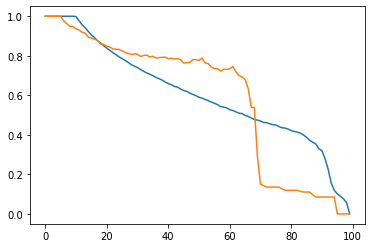

time: 315 ms


In [5]:
import similaritymeasures
# quantify the difference between the two curves using PCM
pcm = similaritymeasures.pcm(London_data, chicago_data)

# quantify the difference between the two curves using
# Discrete Frechet distance
df = similaritymeasures.frechet_dist(London_data, chicago_data)

# quantify the difference between the two curves using
# area between two curves
area = similaritymeasures.area_between_two_curves(London_data, chicago_data)

# quantify the difference between the two curves using
# Curve Length based similarity measure
cl = similaritymeasures.curve_length_measure(London_data, chicago_data)

# quantify the difference between the two curves using
# Dynamic Time Warping distance
dtw, d = similaritymeasures.dtw(London_data, chicago_data)

# print the results
print(pcm, df, area, cl, dtw)

# plot the data
plt.figure()
plt.plot(London_data[:, 0], London_data[:, 1])
plt.plot(chicago_data[:, 0], chicago_data[:, 1])
plt.show()

In [6]:
city_dict = {}
for n, key in enumerate(etas_cut_threshold_dict):
    city_dict[n] = key
city_dict

{0: 'NY',
 1: 'Ottawa',
 2: 'Nashville',
 3: 'New_Orleans',
 4: 'Shanghai',
 5: 'Portland',
 6: 'Aarhus',
 7: 'Amsterdam',
 8: 'Arezzo',
 9: 'Barcelona',
 10: 'Beijing',
 11: 'Berlin',
 12: 'Bologna',
 13: 'Bordeaux',
 14: 'Boston',
 15: 'Bremen',
 16: 'Brno',
 17: 'Budapest',
 18: 'Buenos_Aires',
 19: 'Busan',
 20: 'Denver',
 21: 'Dublin',
 22: 'Edinburgh',
 23: 'Florence',
 24: 'Los_Angeles',
 25: 'Lyon',
 26: 'Madrid',
 27: 'Moscow',
 28: 'Palermo',
 29: 'Paris',
 30: 'Porto',
 31: 'Prague',
 32: 'Reykjavik',
 33: 'Riga',
 34: 'Rio',
 35: 'Rome',
 36: 'Seoul',
 37: 'Siena',
 38: 'Stockholm',
 39: 'Sydney',
 40: 'Tallin',
 41: 'Treviso',
 42: 'Valencia',
 43: 'Venezia',
 44: 'Verona',
 45: 'Vicenza',
 46: 'Vienna',
 47: 'Wellington',
 48: 'Zurich',
 49: 'Milan',
 50: 'London',
 51: 'Istanbul',
 52: 'Chicago',
 53: 'Toronto',
 54: 'Munich'}

time: 3 ms


In [142]:
city_nums

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54])

time: 1.98 ms


In [7]:
city_nums = np.arange(55)
city_pairs = []
for pair in combinations_with_replacement(city_nums, 2):
    city_pairs.append(pair)
city_pairs

[(0, 0),
 (0, 1),
 (0, 2),
 (0, 3),
 (0, 4),
 (0, 5),
 (0, 6),
 (0, 7),
 (0, 8),
 (0, 9),
 (0, 10),
 (0, 11),
 (0, 12),
 (0, 13),
 (0, 14),
 (0, 15),
 (0, 16),
 (0, 17),
 (0, 18),
 (0, 19),
 (0, 20),
 (0, 21),
 (0, 22),
 (0, 23),
 (0, 24),
 (0, 25),
 (0, 26),
 (0, 27),
 (0, 28),
 (0, 29),
 (0, 30),
 (0, 31),
 (0, 32),
 (0, 33),
 (0, 34),
 (0, 35),
 (0, 36),
 (0, 37),
 (0, 38),
 (0, 39),
 (0, 40),
 (0, 41),
 (0, 42),
 (0, 43),
 (0, 44),
 (0, 45),
 (0, 46),
 (0, 47),
 (0, 48),
 (0, 49),
 (0, 50),
 (0, 51),
 (0, 52),
 (0, 53),
 (0, 54),
 (1, 1),
 (1, 2),
 (1, 3),
 (1, 4),
 (1, 5),
 (1, 6),
 (1, 7),
 (1, 8),
 (1, 9),
 (1, 10),
 (1, 11),
 (1, 12),
 (1, 13),
 (1, 14),
 (1, 15),
 (1, 16),
 (1, 17),
 (1, 18),
 (1, 19),
 (1, 20),
 (1, 21),
 (1, 22),
 (1, 23),
 (1, 24),
 (1, 25),
 (1, 26),
 (1, 27),
 (1, 28),
 (1, 29),
 (1, 30),
 (1, 31),
 (1, 32),
 (1, 33),
 (1, 34),
 (1, 35),
 (1, 36),
 (1, 37),
 (1, 38),
 (1, 39),
 (1, 40),
 (1, 41),
 (1, 42),
 (1, 43),
 (1, 44),
 (1, 45),
 (1, 46),
 (1, 47),

time: 40 ms


---------------------   NY  vs.  NY   ---------------------
Discrete Frechet distance:  0.0 



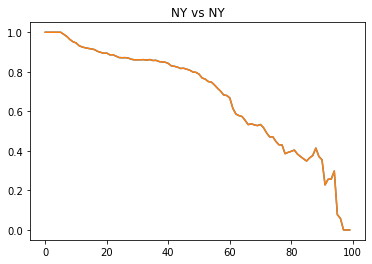

---------------------   NY  vs.  Ottawa   ---------------------
Discrete Frechet distance:  0.4139723851335668 



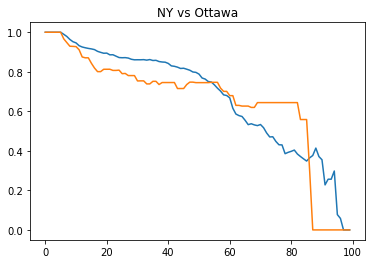

---------------------   NY  vs.  Nashville   ---------------------
Discrete Frechet distance:  0.3251977410764999 



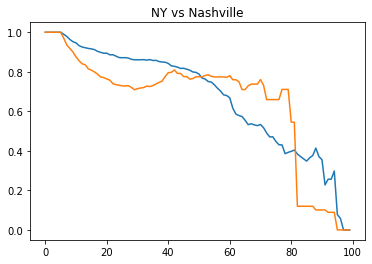

---------------------   NY  vs.  New_Orleans   ---------------------
Discrete Frechet distance:  0.2524046085152879 



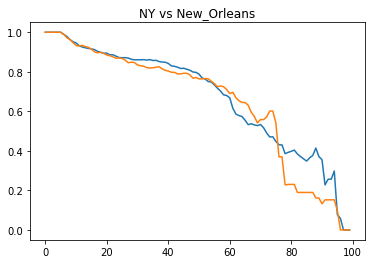

---------------------   NY  vs.  Shanghai   ---------------------
Discrete Frechet distance:  0.6242442925140762 



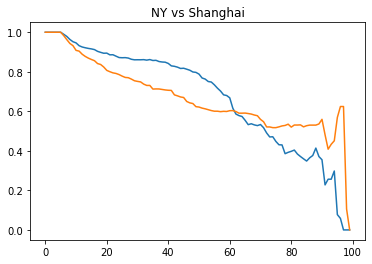

---------------------   NY  vs.  Portland   ---------------------
Discrete Frechet distance:  0.32255367484106273 



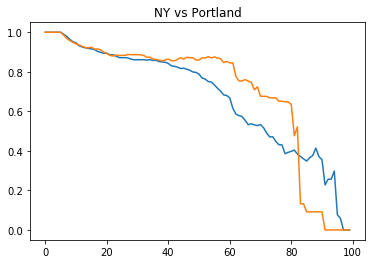

---------------------   NY  vs.  Aarhus   ---------------------
Discrete Frechet distance:  0.29797320040187325 



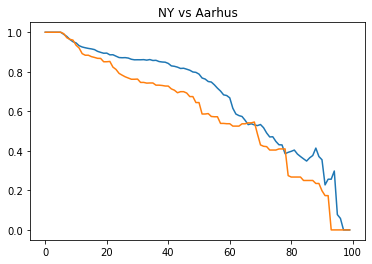

---------------------   NY  vs.  Amsterdam   ---------------------
Discrete Frechet distance:  0.1900118709970865 



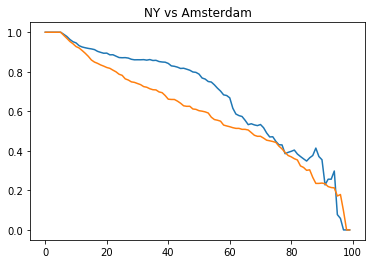

---------------------   NY  vs.  Arezzo   ---------------------
Discrete Frechet distance:  0.4139723851335668 



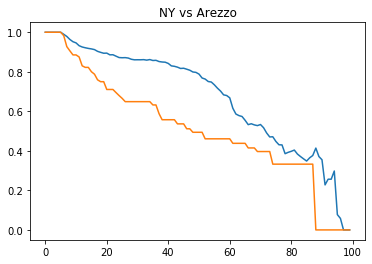

---------------------   NY  vs.  Barcelona   ---------------------
Discrete Frechet distance:  0.5785829455210569 



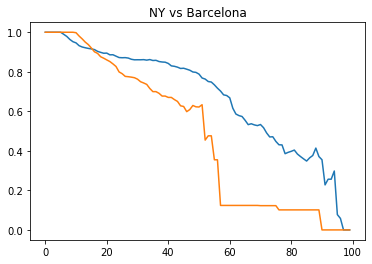

---------------------   NY  vs.  Beijing   ---------------------
Discrete Frechet distance:  0.5862092356098374 



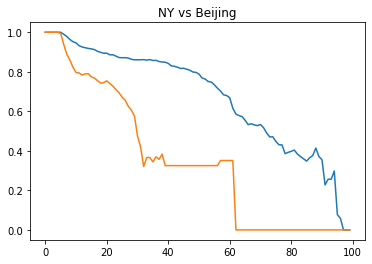

---------------------   NY  vs.  Berlin   ---------------------
Discrete Frechet distance:  0.5424838992395511 



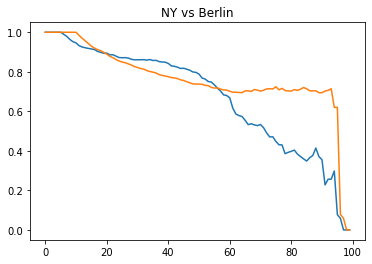

---------------------   NY  vs.  Bologna   ---------------------
Discrete Frechet distance:  0.28602797039899464 



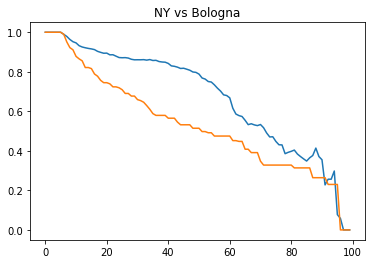

---------------------   NY  vs.  Bordeaux   ---------------------
Discrete Frechet distance:  0.26258592981042306 



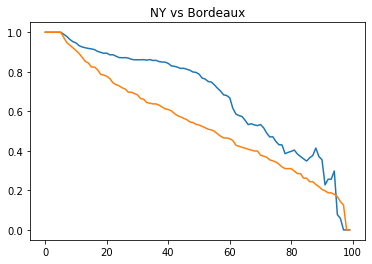

---------------------   NY  vs.  Boston   ---------------------
Discrete Frechet distance:  0.32971749104224 



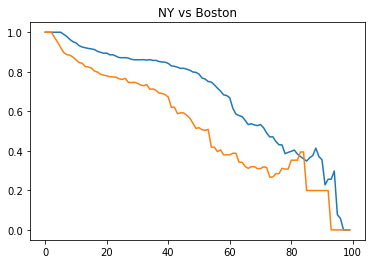

---------------------   NY  vs.  Bremen   ---------------------
Discrete Frechet distance:  1.2351300298129035 



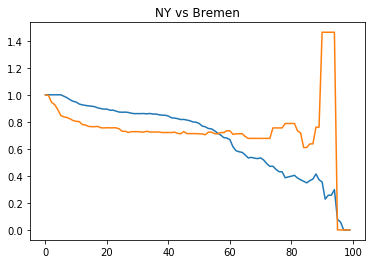

---------------------   NY  vs.  Brno   ---------------------
Discrete Frechet distance:  0.37117055259603954 



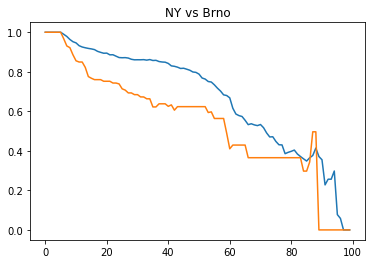

---------------------   NY  vs.  Budapest   ---------------------
Discrete Frechet distance:  0.18836839096702418 



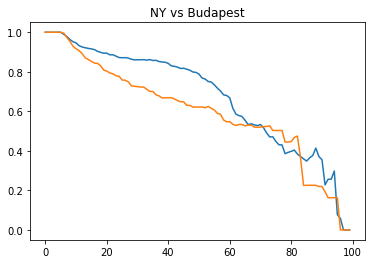

---------------------   NY  vs.  Buenos_Aires   ---------------------
Discrete Frechet distance:  0.6889251160342869 



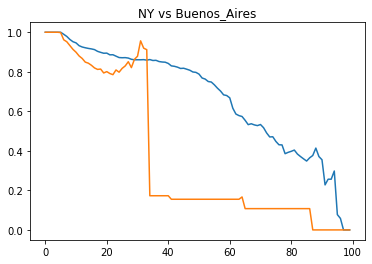

---------------------   NY  vs.  Busan   ---------------------
Discrete Frechet distance:  2.1866352735227927 



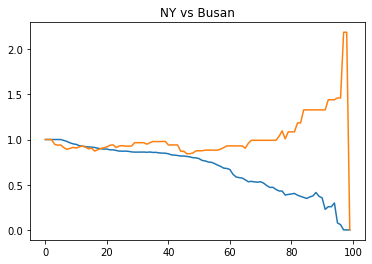

---------------------   NY  vs.  Denver   ---------------------
Discrete Frechet distance:  0.2805457375372996 



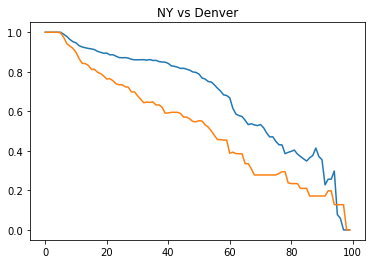

---------------------   NY  vs.  Dublin   ---------------------
Discrete Frechet distance:  0.15703976520254392 



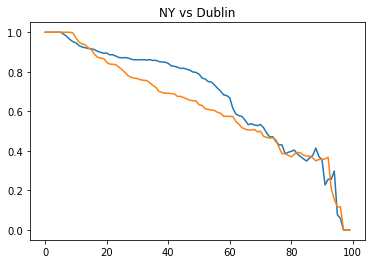

---------------------   NY  vs.  Edinburgh   ---------------------
Discrete Frechet distance:  0.16575694178000847 



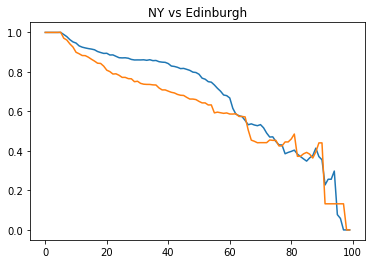

---------------------   NY  vs.  Florence   ---------------------
Discrete Frechet distance:  0.3862558825491318 



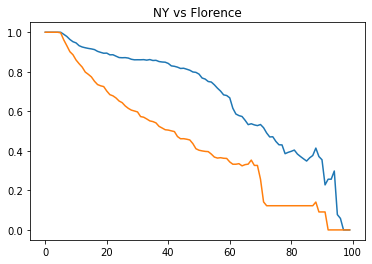

---------------------   NY  vs.  Los_Angeles   ---------------------
Discrete Frechet distance:  0.37674052140562375 



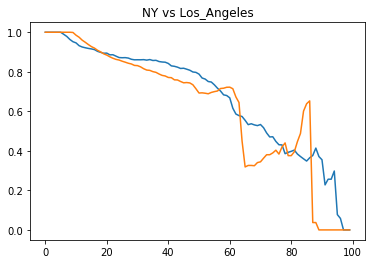

---------------------   NY  vs.  Lyon   ---------------------
Discrete Frechet distance:  0.2441591464449847 



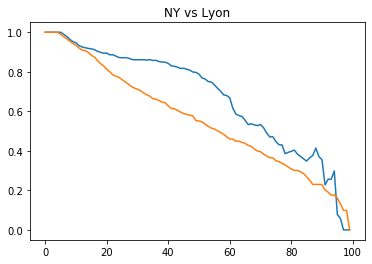

---------------------   NY  vs.  Madrid   ---------------------
Discrete Frechet distance:  0.22213069854674838 



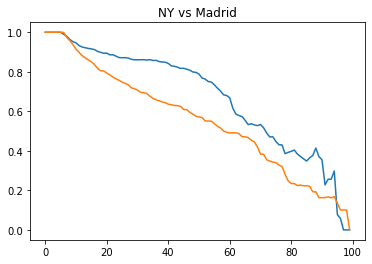

---------------------   NY  vs.  Moscow   ---------------------
Discrete Frechet distance:  0.4252820986275163 



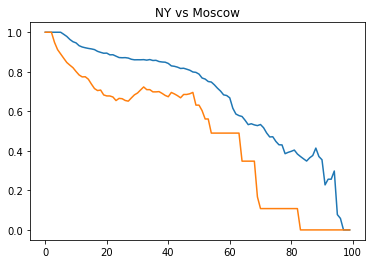

---------------------   NY  vs.  Palermo   ---------------------
Discrete Frechet distance:  0.754977561633101 



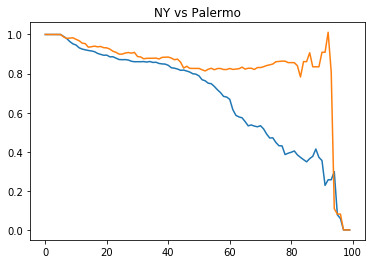

---------------------   NY  vs.  Paris   ---------------------
Discrete Frechet distance:  0.19221418807529328 



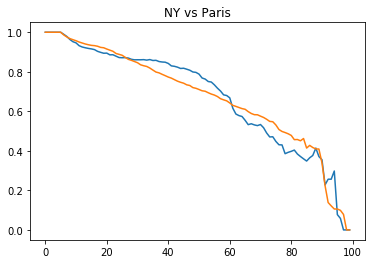

---------------------   NY  vs.  Porto   ---------------------
Discrete Frechet distance:  1.0451141079713095 



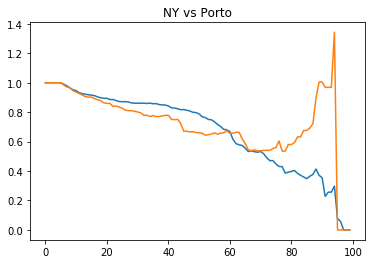

---------------------   NY  vs.  Prague   ---------------------
Discrete Frechet distance:  0.33559971039921976 



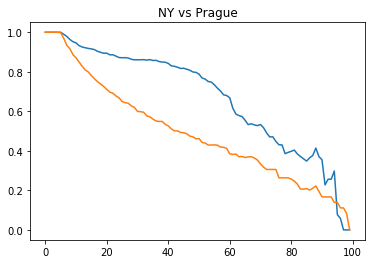

---------------------   NY  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.23865273758456773 



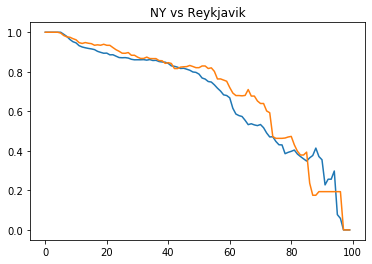

---------------------   NY  vs.  Riga   ---------------------
Discrete Frechet distance:  0.3245471817265296 



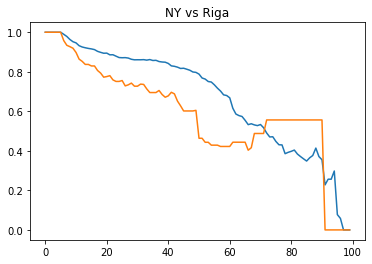

---------------------   NY  vs.  Rio   ---------------------
Discrete Frechet distance:  1.639445486183051 



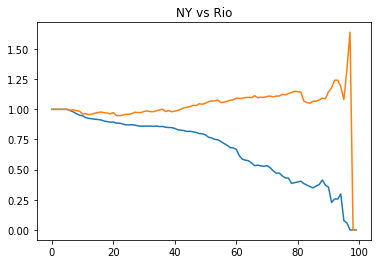

---------------------   NY  vs.  Rome   ---------------------
Discrete Frechet distance:  0.29048345945982057 



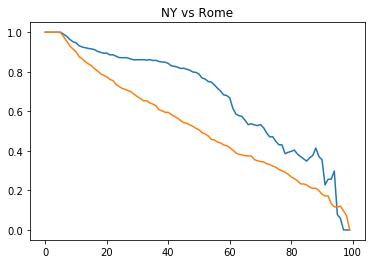

---------------------   NY  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.8252439663075871 



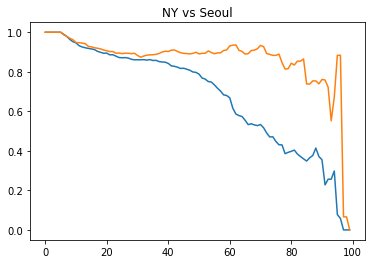

---------------------   NY  vs.  Siena   ---------------------
Discrete Frechet distance:  0.32718698381541417 



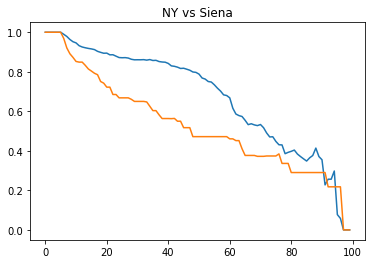

---------------------   NY  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.328815599048339 



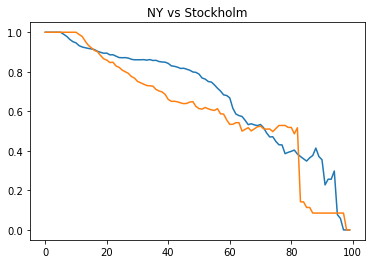

---------------------   NY  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.9194488759080831 



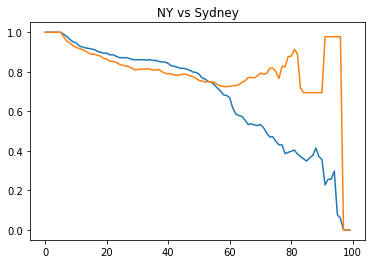

---------------------   NY  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.3039343426194161 



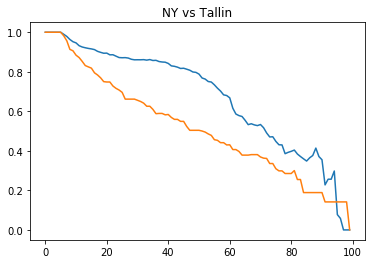

---------------------   NY  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.4139723851335668 



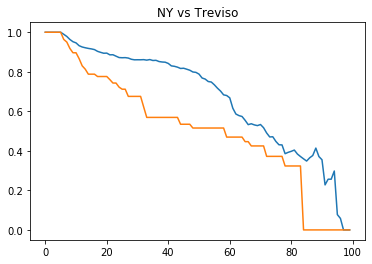

---------------------   NY  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.21089046100551737 



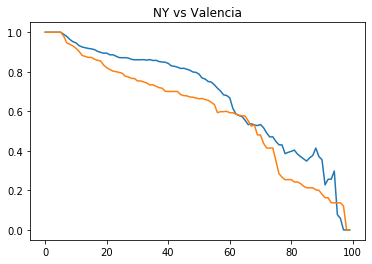

---------------------   NY  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.1876671516325331 



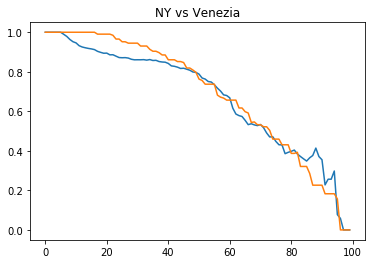

---------------------   NY  vs.  Verona   ---------------------
Discrete Frechet distance:  0.29395730963646116 



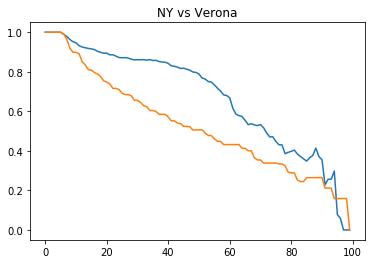

---------------------   NY  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.34294145242843177 



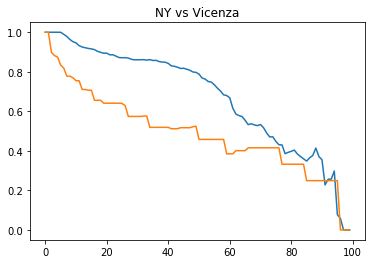

---------------------   NY  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.5983642645457203 



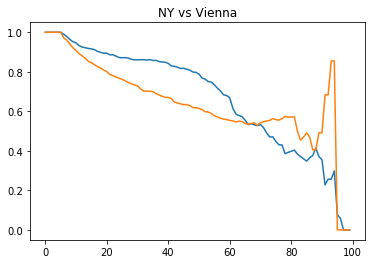

---------------------   NY  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.4381481760488705 



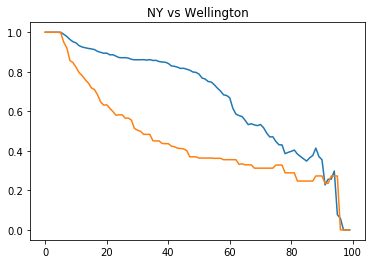

---------------------   NY  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.29797320040187325 



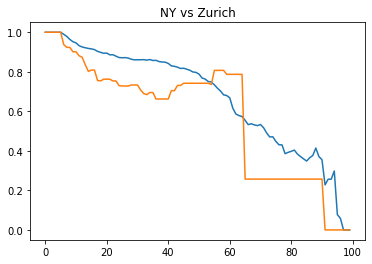

---------------------   NY  vs.  Milan   ---------------------
Discrete Frechet distance:  0.17018819436265545 



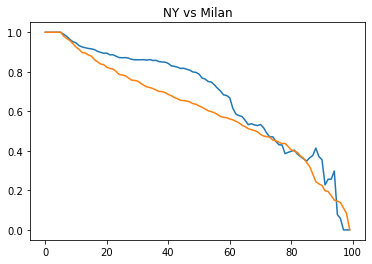

---------------------   NY  vs.  London   ---------------------
Discrete Frechet distance:  0.19878798045396717 



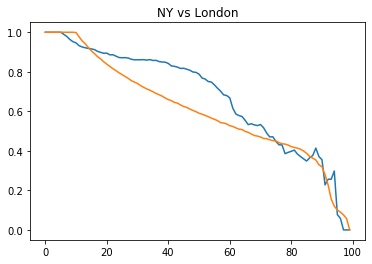

---------------------   NY  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.6089513293764404 



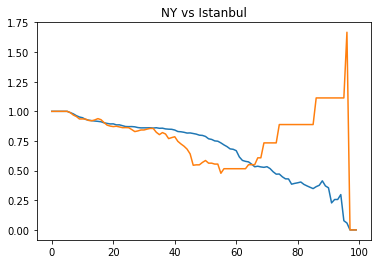

---------------------   NY  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.3830479484019232 



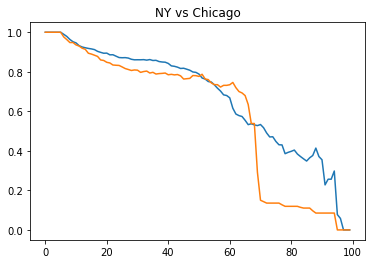

---------------------   NY  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.18035152903260618 



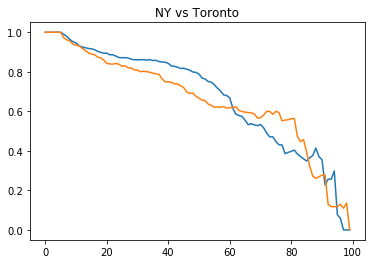

---------------------   NY  vs.  Munich   ---------------------
Discrete Frechet distance:  0.27064916852137255 



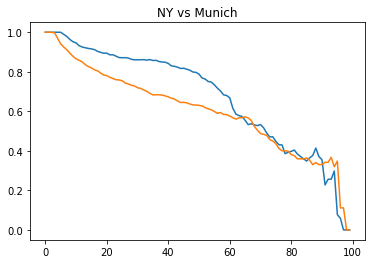

---------------------   Ottawa  vs.  Ottawa   ---------------------
Discrete Frechet distance:  0.0 



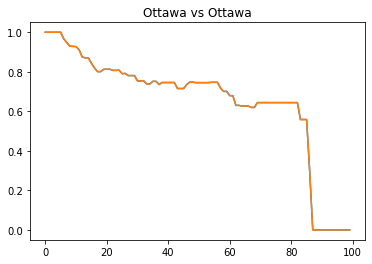

---------------------   Ottawa  vs.  Nashville   ---------------------
Discrete Frechet distance:  0.5242706723774961 



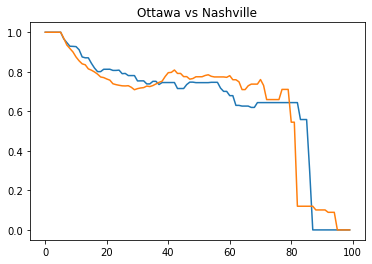

---------------------   Ottawa  vs.  New_Orleans   ---------------------
Discrete Frechet distance:  0.45447816042155964 



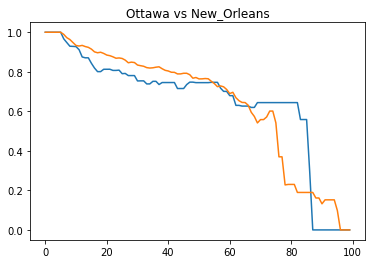

---------------------   Ottawa  vs.  Shanghai   ---------------------
Discrete Frechet distance:  0.6242442925140762 



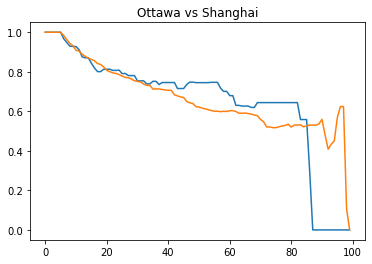

---------------------   Ottawa  vs.  Portland   ---------------------
Discrete Frechet distance:  0.4669999398092229 



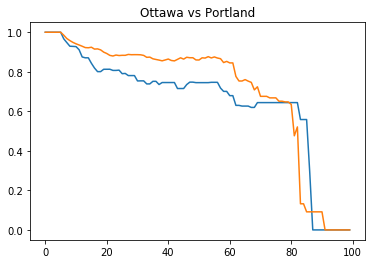

---------------------   Ottawa  vs.  Aarhus   ---------------------
Discrete Frechet distance:  0.3765403156558904 



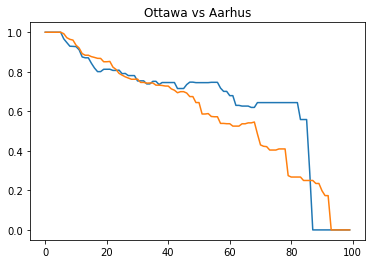

---------------------   Ottawa  vs.  Amsterdam   ---------------------
Discrete Frechet distance:  0.2901569434910854 



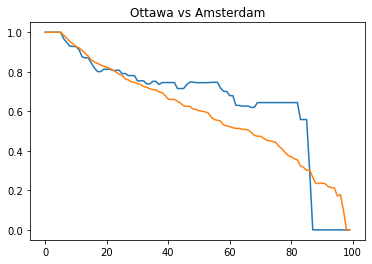

---------------------   Ottawa  vs.  Arezzo   ---------------------
Discrete Frechet distance:  0.3326854866904326 



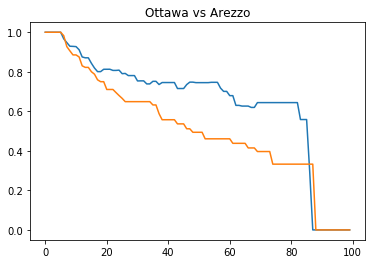

---------------------   Ottawa  vs.  Barcelona   ---------------------
Discrete Frechet distance:  0.5935802771576151 



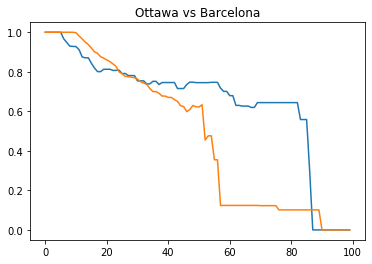

---------------------   Ottawa  vs.  Beijing   ---------------------
Discrete Frechet distance:  0.6440531879823539 



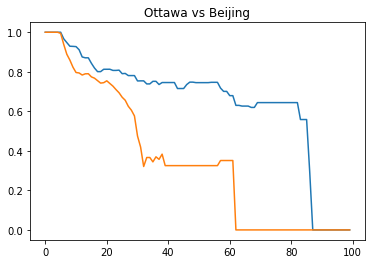

---------------------   Ottawa  vs.  Berlin   ---------------------
Discrete Frechet distance:  0.7141135865816987 



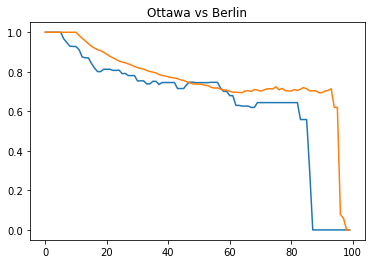

---------------------   Ottawa  vs.  Bologna   ---------------------
Discrete Frechet distance:  0.3302941664272729 



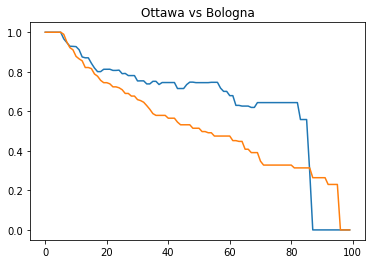

---------------------   Ottawa  vs.  Bordeaux   ---------------------
Discrete Frechet distance:  0.3590676311725709 



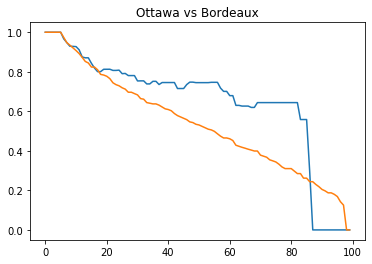

---------------------   Ottawa  vs.  Boston   ---------------------
Discrete Frechet distance:  0.37669688114377203 



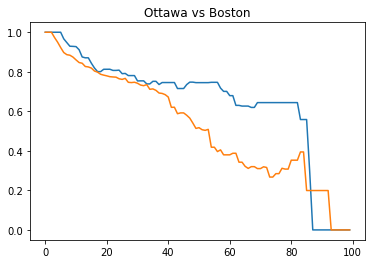

---------------------   Ottawa  vs.  Bremen   ---------------------
Discrete Frechet distance:  1.4629207548535066 



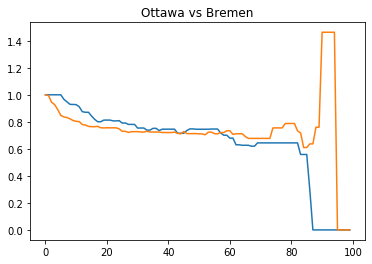

---------------------   Ottawa  vs.  Brno   ---------------------
Discrete Frechet distance:  0.49637978089058 



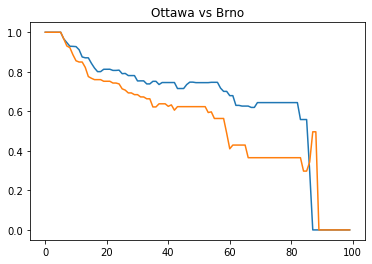

---------------------   Ottawa  vs.  Budapest   ---------------------
Discrete Frechet distance:  0.33281465593518433 



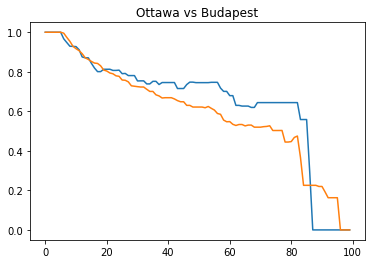

---------------------   Ottawa  vs.  Buenos_Aires   ---------------------
Discrete Frechet distance:  0.5924774235586656 



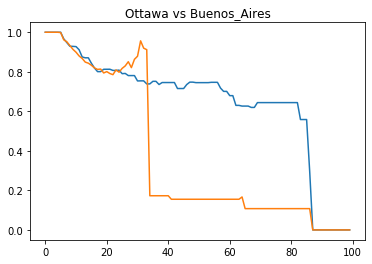

---------------------   Ottawa  vs.  Busan   ---------------------
Discrete Frechet distance:  2.1866352735227927 



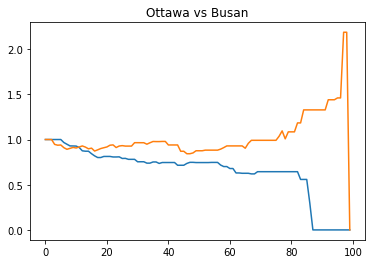

---------------------   Ottawa  vs.  Denver   ---------------------
Discrete Frechet distance:  0.4096467173033695 



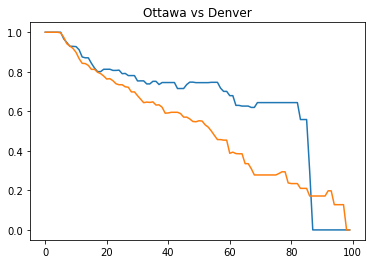

---------------------   Ottawa  vs.  Dublin   ---------------------
Discrete Frechet distance:  0.3676371271195406 



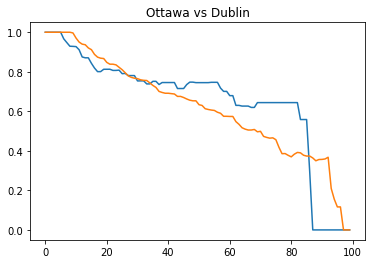

---------------------   Ottawa  vs.  Edinburgh   ---------------------
Discrete Frechet distance:  0.44072086207282996 



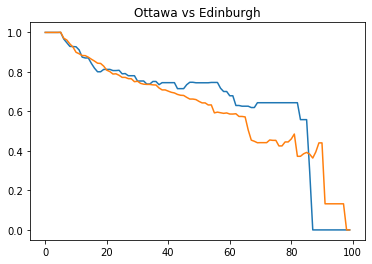

---------------------   Ottawa  vs.  Florence   ---------------------
Discrete Frechet distance:  0.5216936305219587 



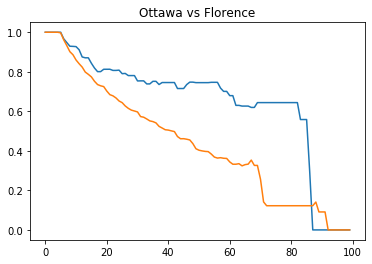

---------------------   Ottawa  vs.  Los_Angeles   ---------------------
Discrete Frechet distance:  0.3565893683096448 



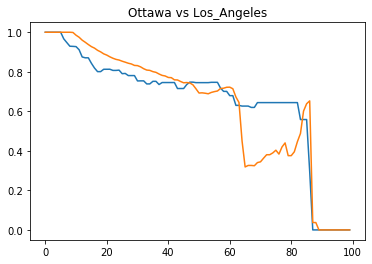

---------------------   Ottawa  vs.  Lyon   ---------------------
Discrete Frechet distance:  0.3433117055852983 



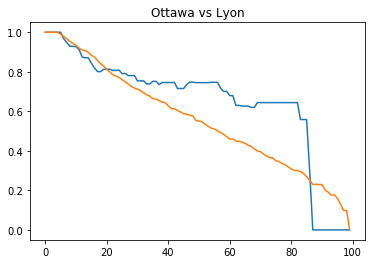

---------------------   Ottawa  vs.  Madrid   ---------------------
Discrete Frechet distance:  0.41968871388936435 



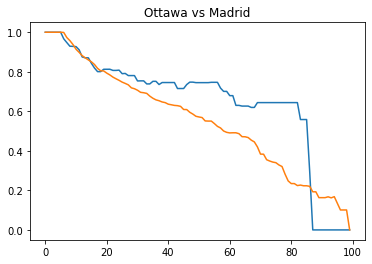

---------------------   Ottawa  vs.  Moscow   ---------------------
Discrete Frechet distance:  0.558418650101727 



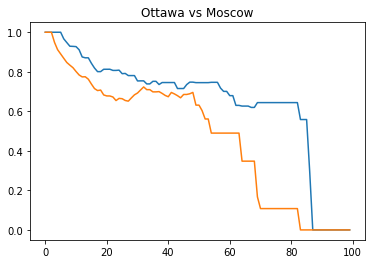

---------------------   Ottawa  vs.  Palermo   ---------------------
Discrete Frechet distance:  1.011525905917469 



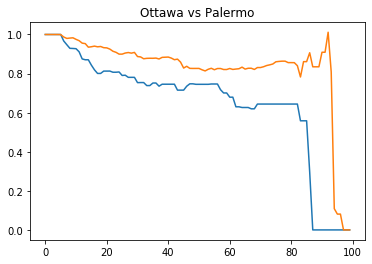

---------------------   Ottawa  vs.  Paris   ---------------------
Discrete Frechet distance:  0.41691132490611044 



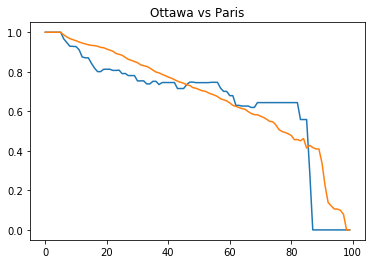

---------------------   Ottawa  vs.  Porto   ---------------------
Discrete Frechet distance:  1.3430873083731827 



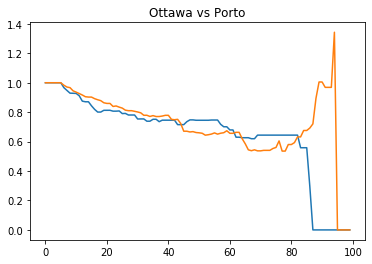

---------------------   Ottawa  vs.  Prague   ---------------------
Discrete Frechet distance:  0.41251743122280143 



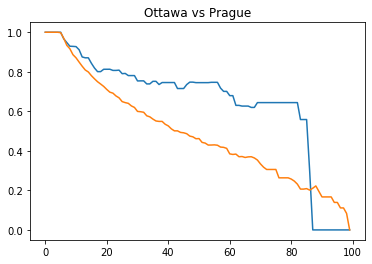

---------------------   Ottawa  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.24579851142700654 



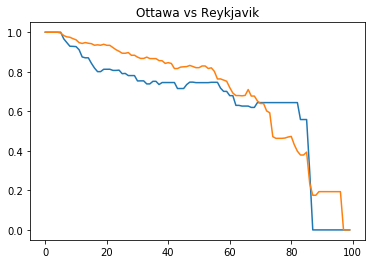

---------------------   Ottawa  vs.  Riga   ---------------------
Discrete Frechet distance:  0.5563612798024404 



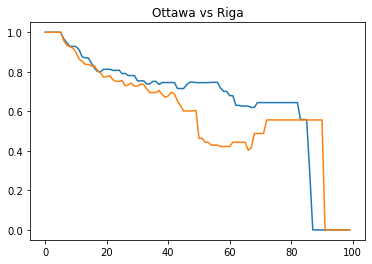

---------------------   Ottawa  vs.  Rio   ---------------------
Discrete Frechet distance:  1.639445486183051 



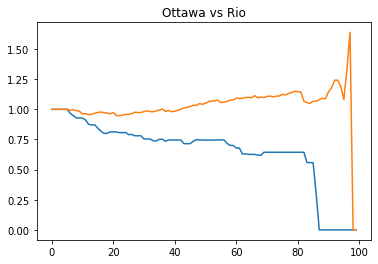

---------------------   Ottawa  vs.  Rome   ---------------------
Discrete Frechet distance:  0.39539193380142756 



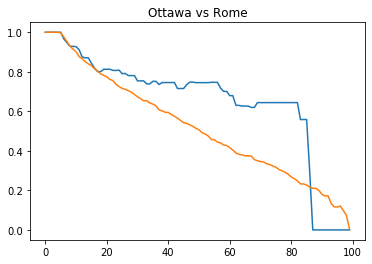

---------------------   Ottawa  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.8833447012990394 



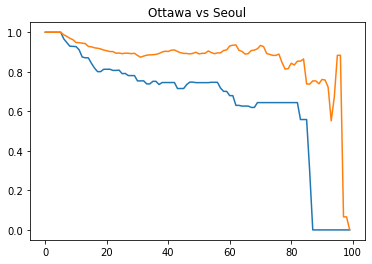

---------------------   Ottawa  vs.  Siena   ---------------------
Discrete Frechet distance:  0.35380569365153924 



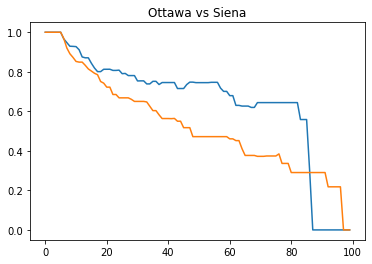

---------------------   Ottawa  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.4448762686546666 



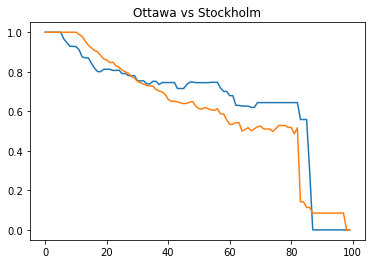

---------------------   Ottawa  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.9775496108995354 



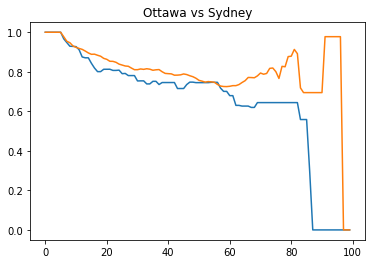

---------------------   Ottawa  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.3890622134645173 



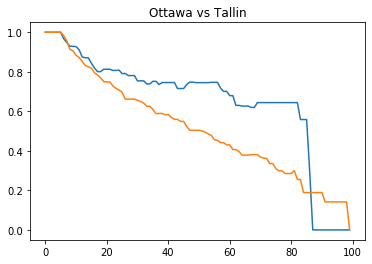

---------------------   Ottawa  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.558418650101727 



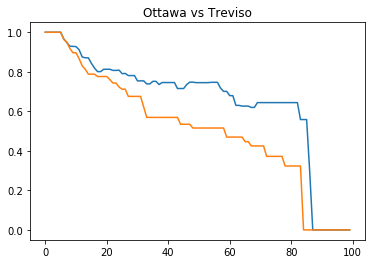

---------------------   Ottawa  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.401472813454959 



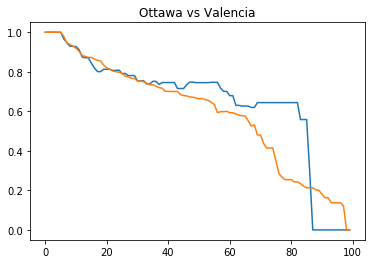

---------------------   Ottawa  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.2568892799751892 



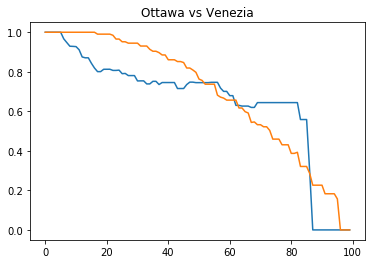

---------------------   Ottawa  vs.  Verona   ---------------------
Discrete Frechet distance:  0.39168531712902505 



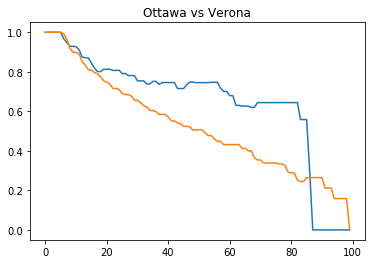

---------------------   Ottawa  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.315866797674277 



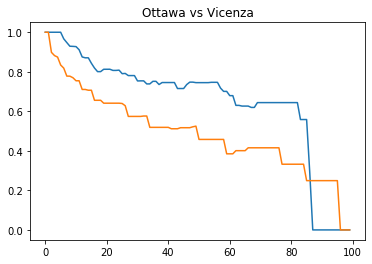

---------------------   Ottawa  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.8549126088300883 



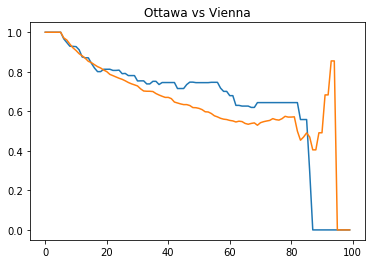

---------------------   Ottawa  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.39680031109083724 



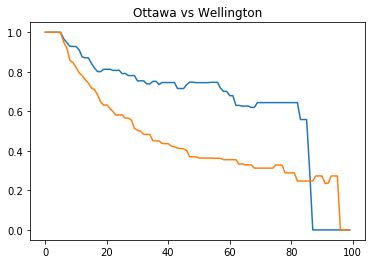

---------------------   Ottawa  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.38695545003425064 



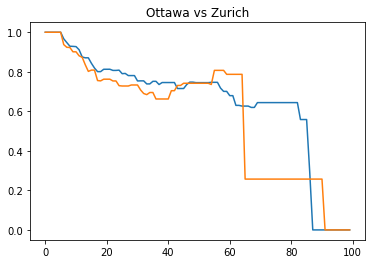

---------------------   Ottawa  vs.  Milan   ---------------------
Discrete Frechet distance:  0.2826549054897698 



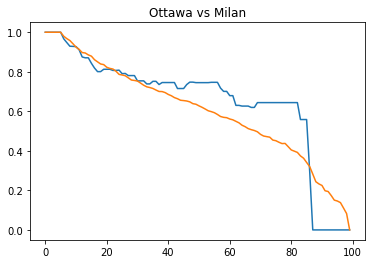

---------------------   Ottawa  vs.  London   ---------------------
Discrete Frechet distance:  0.3628418497697532 



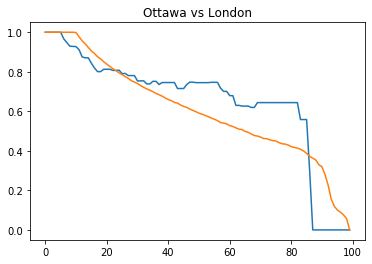

---------------------   Ottawa  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.6670520643678925 



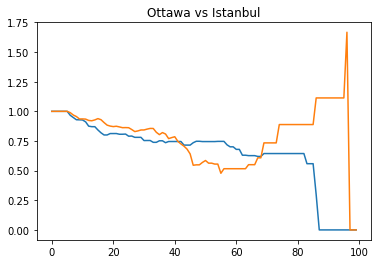

---------------------   Ottawa  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.5247010664608691 



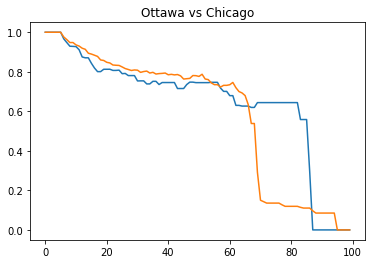

---------------------   Ottawa  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.2771986325114767 



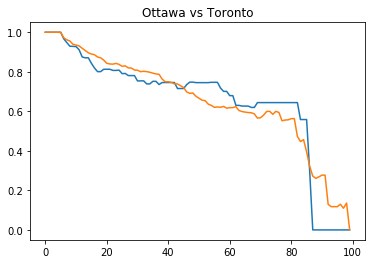

---------------------   Ottawa  vs.  Munich   ---------------------
Discrete Frechet distance:  0.3671130278414978 



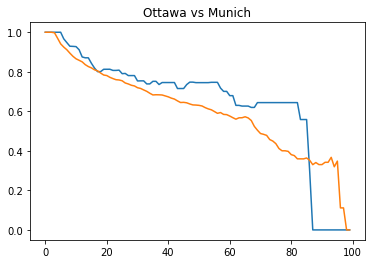

---------------------   Nashville  vs.  Nashville   ---------------------
Discrete Frechet distance:  0.0 



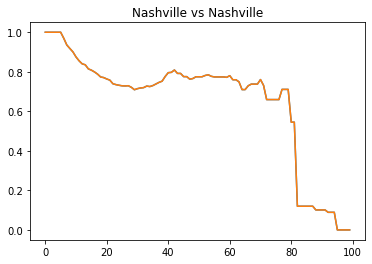

---------------------   Nashville  vs.  New_Orleans   ---------------------
Discrete Frechet distance:  0.4831566334107871 



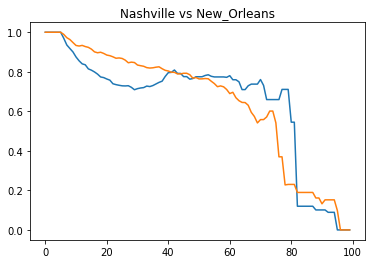

---------------------   Nashville  vs.  Shanghai   ---------------------
Discrete Frechet distance:  0.6242442925140762 



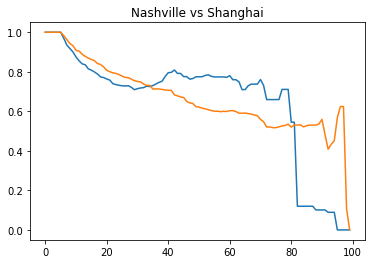

---------------------   Nashville  vs.  Portland   ---------------------
Discrete Frechet distance:  0.4012616559849301 



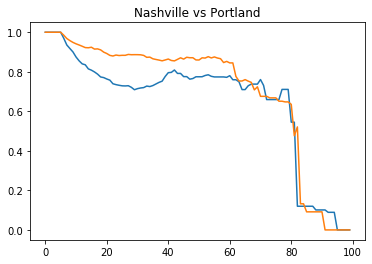

---------------------   Nashville  vs.  Aarhus   ---------------------
Discrete Frechet distance:  0.4362747060649697 



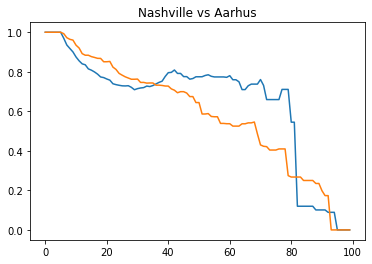

---------------------   Nashville  vs.  Amsterdam   ---------------------
Discrete Frechet distance:  0.3345604018890797 



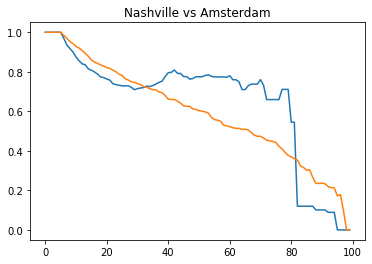

---------------------   Nashville  vs.  Arezzo   ---------------------
Discrete Frechet distance:  0.37815321068347946 



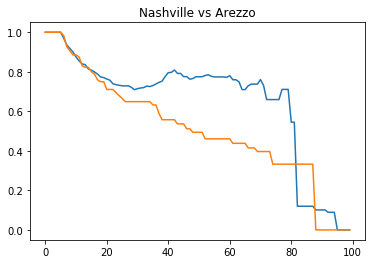

---------------------   Nashville  vs.  Barcelona   ---------------------
Discrete Frechet distance:  0.6563677122806972 



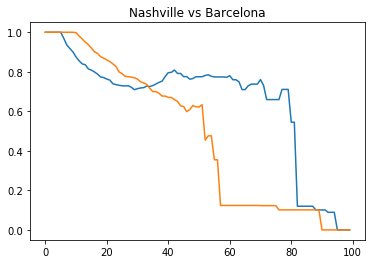

---------------------   Nashville  vs.  Beijing   ---------------------
Discrete Frechet distance:  0.7607166380818943 



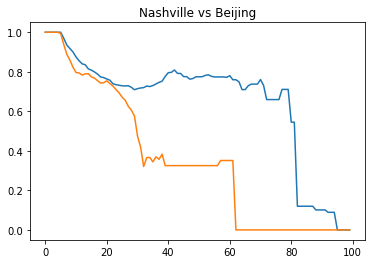

---------------------   Nashville  vs.  Berlin   ---------------------
Discrete Frechet distance:  0.6250663777830566 



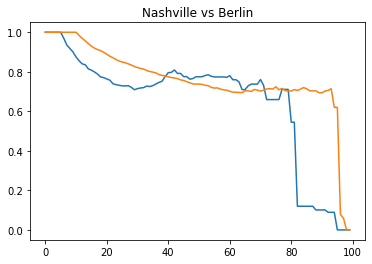

---------------------   Nashville  vs.  Bologna   ---------------------
Discrete Frechet distance:  0.4131236273850369 



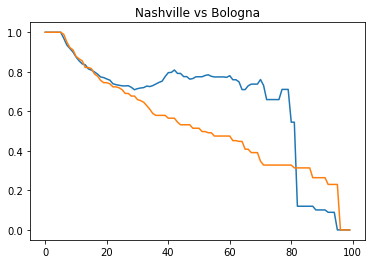

---------------------   Nashville  vs.  Bordeaux   ---------------------
Discrete Frechet distance:  0.40063049711978005 



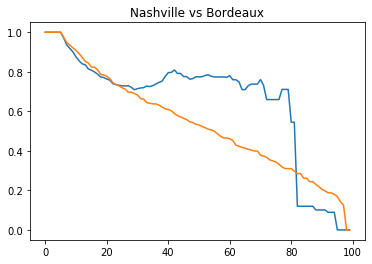

---------------------   Nashville  vs.  Boston   ---------------------
Discrete Frechet distance:  0.4504757665652609 



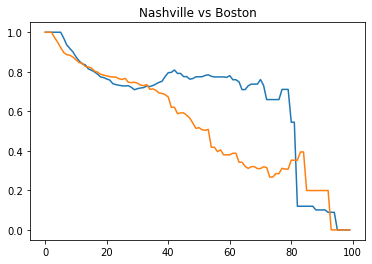

---------------------   Nashville  vs.  Bremen   ---------------------
Discrete Frechet distance:  1.3738735460548646 



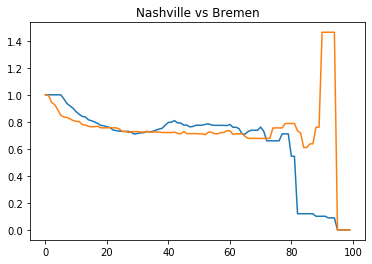

---------------------   Nashville  vs.  Brno   ---------------------
Discrete Frechet distance:  0.39540193212050506 



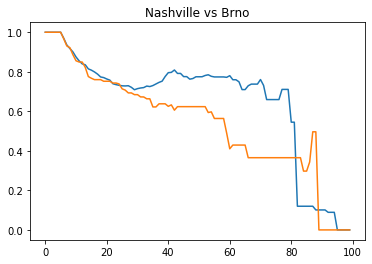

---------------------   Nashville  vs.  Budapest   ---------------------
Discrete Frechet distance:  0.355099581634408 



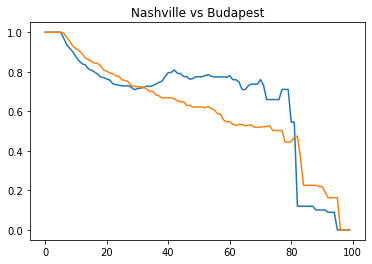

---------------------   Nashville  vs.  Buenos_Aires   ---------------------
Discrete Frechet distance:  0.6539402077220333 



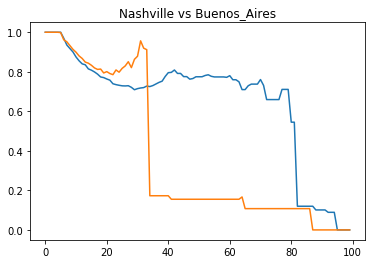

---------------------   Nashville  vs.  Busan   ---------------------
Discrete Frechet distance:  2.1866352735227927 



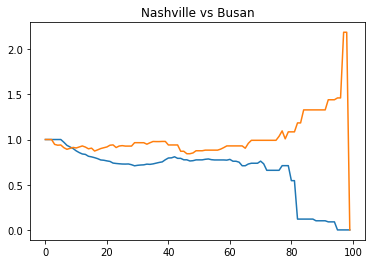

---------------------   Nashville  vs.  Denver   ---------------------
Discrete Frechet distance:  0.4827110236669335 



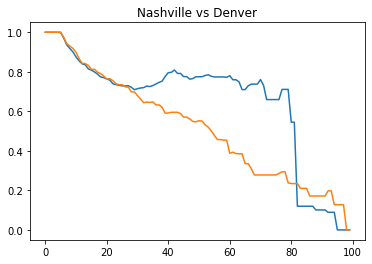

---------------------   Nashville  vs.  Dublin   ---------------------
Discrete Frechet distance:  0.33347560563841017 



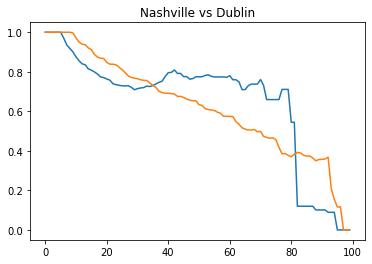

---------------------   Nashville  vs.  Edinburgh   ---------------------
Discrete Frechet distance:  0.33967984647368704 



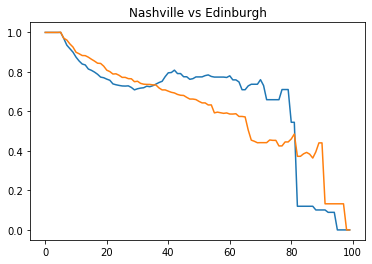

---------------------   Nashville  vs.  Florence   ---------------------
Discrete Frechet distance:  0.5894292146890006 



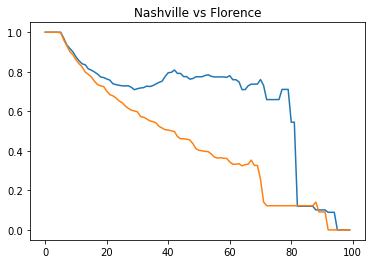

---------------------   Nashville  vs.  Los_Angeles   ---------------------
Discrete Frechet distance:  0.5329047966050221 



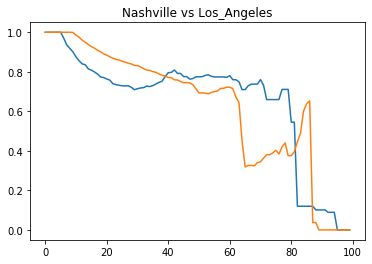

---------------------   Nashville  vs.  Lyon   ---------------------
Discrete Frechet distance:  0.3925118418709637 



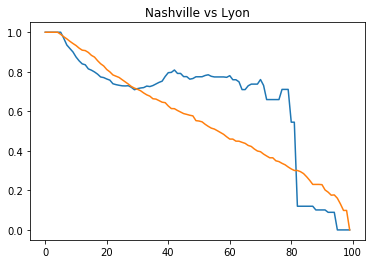

---------------------   Nashville  vs.  Madrid   ---------------------
Discrete Frechet distance:  0.4629997081402811 



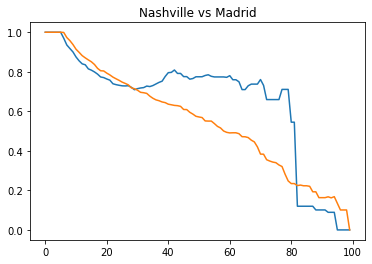

---------------------   Nashville  vs.  Moscow   ---------------------
Discrete Frechet distance:  0.6528548349131895 



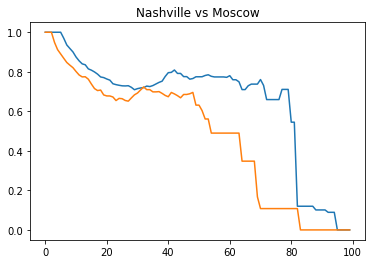

---------------------   Nashville  vs.  Palermo   ---------------------
Discrete Frechet distance:  0.922478697118827 



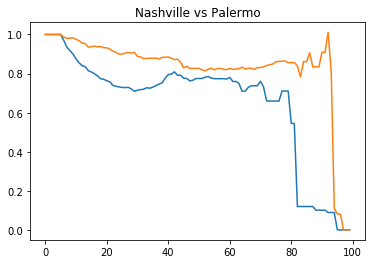

---------------------   Nashville  vs.  Paris   ---------------------
Discrete Frechet distance:  0.34258512060845786 



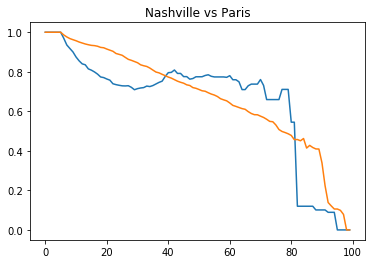

---------------------   Nashville  vs.  Porto   ---------------------
Discrete Frechet distance:  1.2540400995745407 



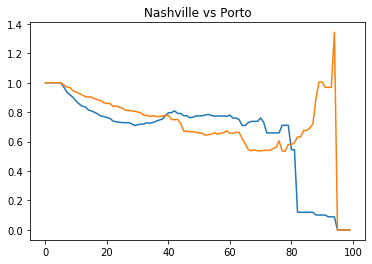

---------------------   Nashville  vs.  Prague   ---------------------
Discrete Frechet distance:  0.4473466522010936 



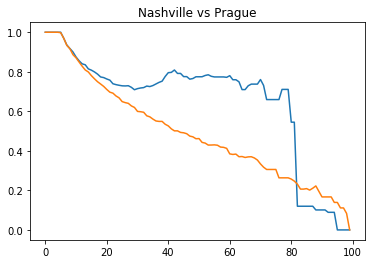

---------------------   Nashville  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.27847216095048954 



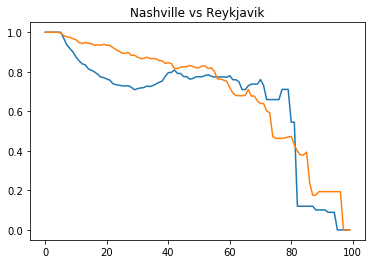

---------------------   Nashville  vs.  Riga   ---------------------
Discrete Frechet distance:  0.4553202642032975 



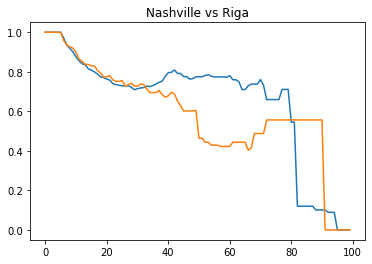

---------------------   Nashville  vs.  Rio   ---------------------
Discrete Frechet distance:  1.639445486183051 



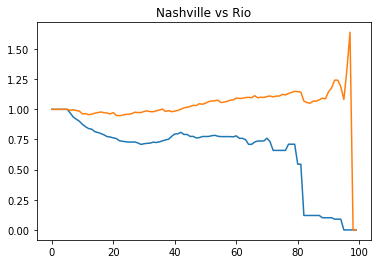

---------------------   Nashville  vs.  Rome   ---------------------
Discrete Frechet distance:  0.42895073273029716 



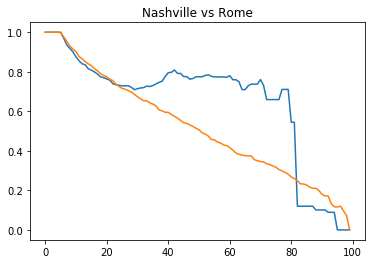

---------------------   Nashville  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.8833447012990394 



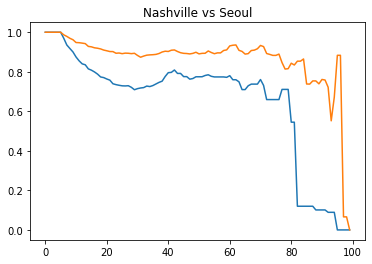

---------------------   Nashville  vs.  Siena   ---------------------
Discrete Frechet distance:  0.38847734305688064 



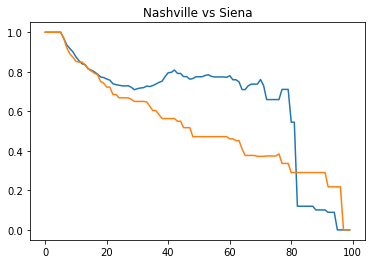

---------------------   Nashville  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.39683531997925786 



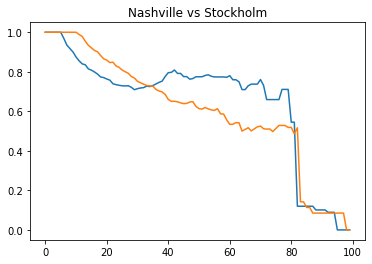

---------------------   Nashville  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.9775496108995354 



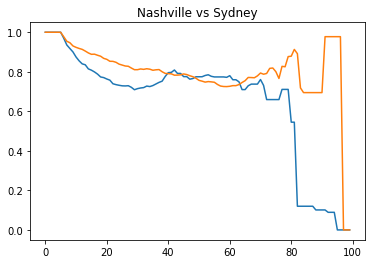

---------------------   Nashville  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.4254637068621278 



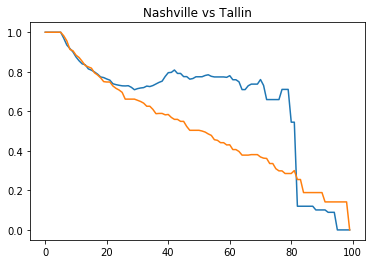

---------------------   Nashville  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.3873563938323951 



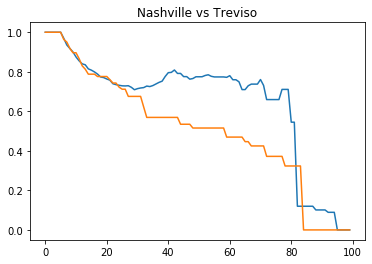

---------------------   Nashville  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.45656586467463295 



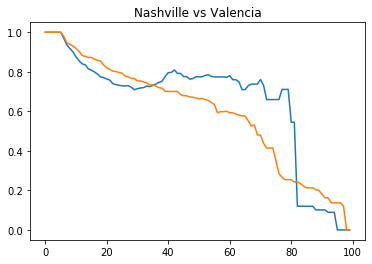

---------------------   Nashville  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.2801796814750807 



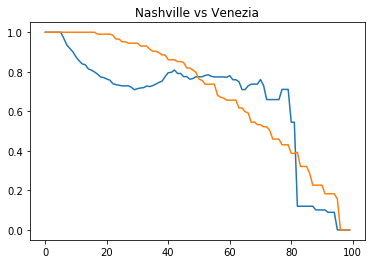

---------------------   Nashville  vs.  Verona   ---------------------
Discrete Frechet distance:  0.4190346014842205 



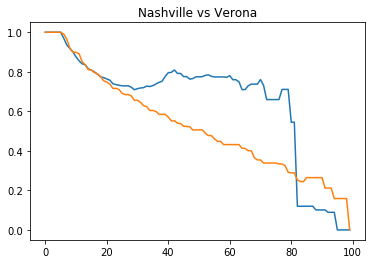

---------------------   Nashville  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.39527511056835646 



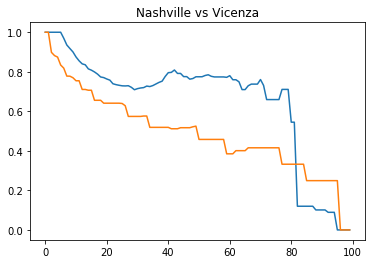

---------------------   Nashville  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.7658654000314463 



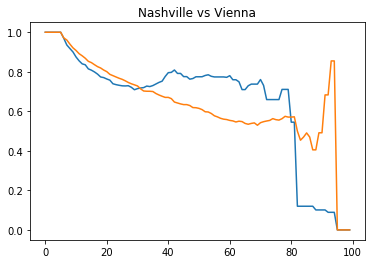

---------------------   Nashville  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.4482828131625152 



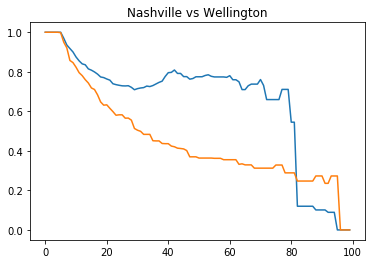

---------------------   Nashville  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.503618900133791 



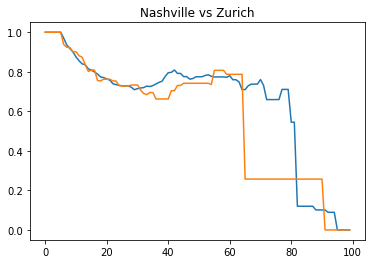

---------------------   Nashville  vs.  Milan   ---------------------
Discrete Frechet distance:  0.2895470996042655 



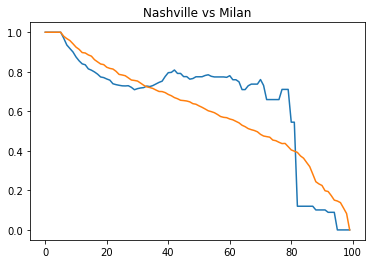

---------------------   Nashville  vs.  London   ---------------------
Discrete Frechet distance:  0.2940447943287086 



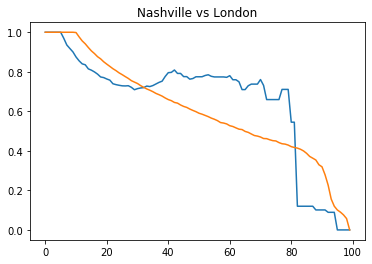

---------------------   Nashville  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.6670520643678925 



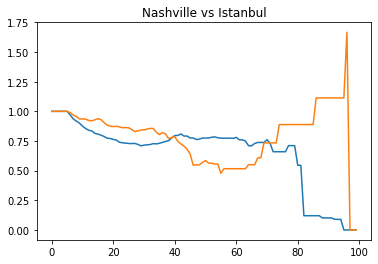

---------------------   Nashville  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.6106206846875963 



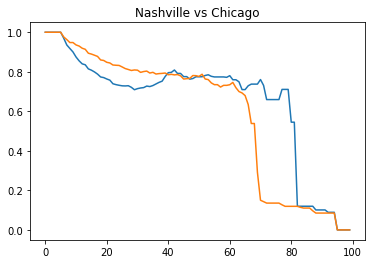

---------------------   Nashville  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.35338984130788076 



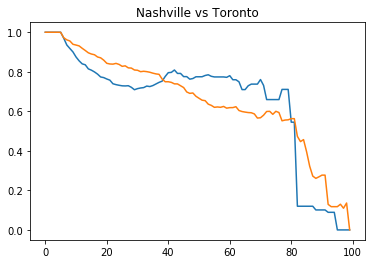

---------------------   Nashville  vs.  Munich   ---------------------
Discrete Frechet distance:  0.3481168151766423 



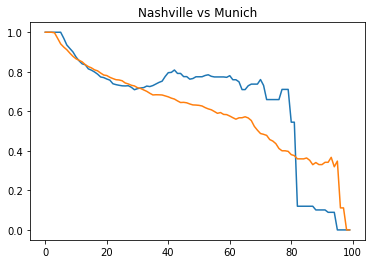

---------------------   New_Orleans  vs.  New_Orleans   ---------------------
Discrete Frechet distance:  0.0 



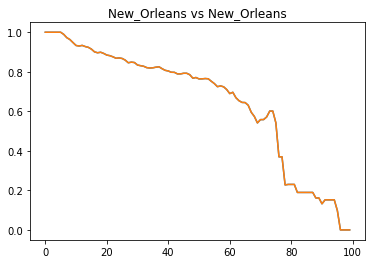

---------------------   New_Orleans  vs.  Shanghai   ---------------------
Discrete Frechet distance:  0.6242442925140762 



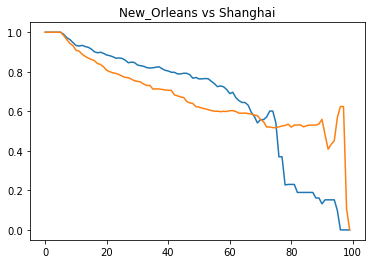

---------------------   New_Orleans  vs.  Portland   ---------------------
Discrete Frechet distance:  0.4199304435079593 



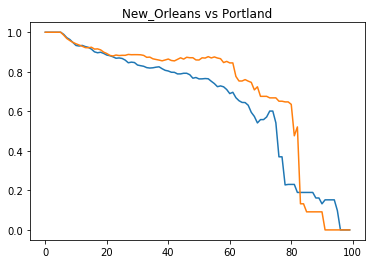

---------------------   New_Orleans  vs.  Aarhus   ---------------------
Discrete Frechet distance:  0.197167348275117 



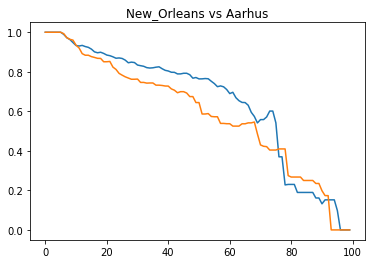

---------------------   New_Orleans  vs.  Amsterdam   ---------------------
Discrete Frechet distance:  0.19355337345654622 



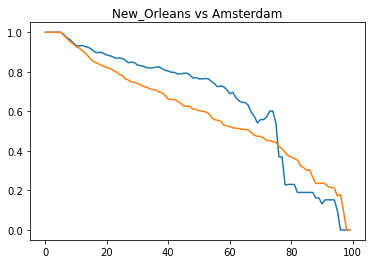

---------------------   New_Orleans  vs.  Arezzo   ---------------------
Discrete Frechet distance:  0.3049132357557562 



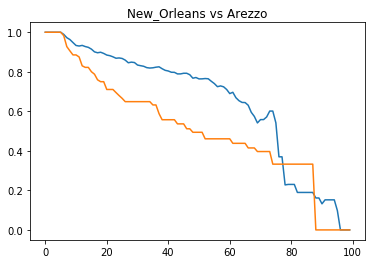

---------------------   New_Orleans  vs.  Barcelona   ---------------------
Discrete Frechet distance:  0.604630379848238 



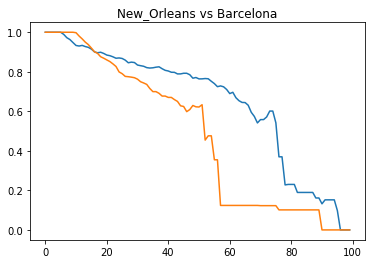

---------------------   New_Orleans  vs.  Beijing   ---------------------
Discrete Frechet distance:  0.6688546498474789 



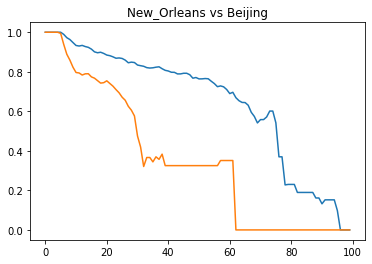

---------------------   New_Orleans  vs.  Berlin   ---------------------
Discrete Frechet distance:  0.5620702977507637 



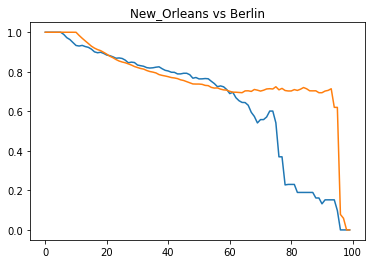

---------------------   New_Orleans  vs.  Bologna   ---------------------
Discrete Frechet distance:  0.2732315537101831 



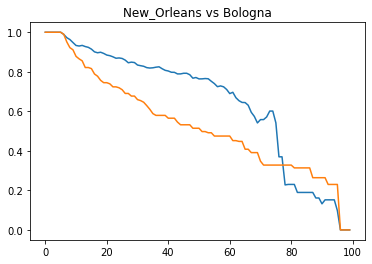

---------------------   New_Orleans  vs.  Bordeaux   ---------------------
Discrete Frechet distance:  0.25881025532198015 



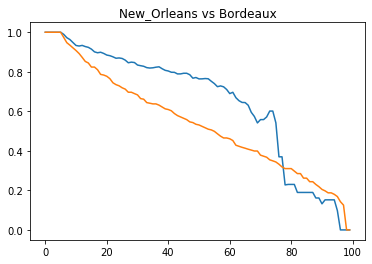

---------------------   New_Orleans  vs.  Boston   ---------------------
Discrete Frechet distance:  0.3441720556142862 



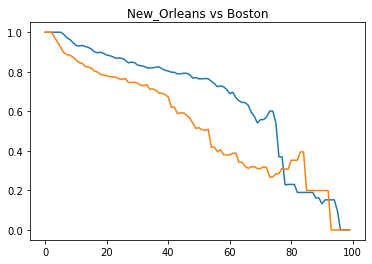

---------------------   New_Orleans  vs.  Bremen   ---------------------
Discrete Frechet distance:  1.3309163783144298 



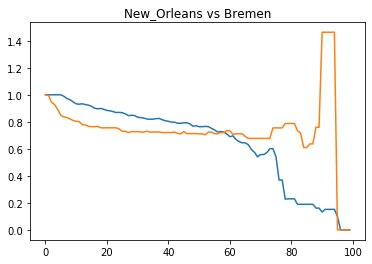

---------------------   New_Orleans  vs.  Brno   ---------------------
Discrete Frechet distance:  0.33481200427230107 



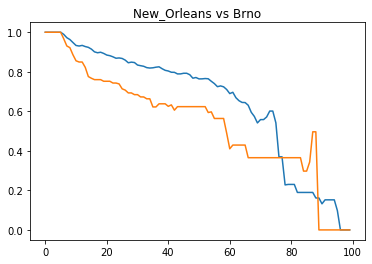

---------------------   New_Orleans  vs.  Budapest   ---------------------
Discrete Frechet distance:  0.2853070696784715 



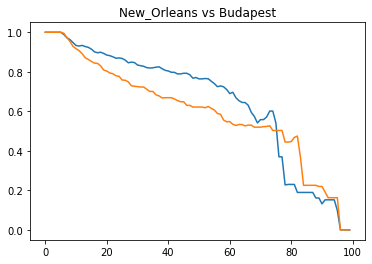

---------------------   New_Orleans  vs.  Buenos_Aires   ---------------------
Discrete Frechet distance:  0.6522822708140343 



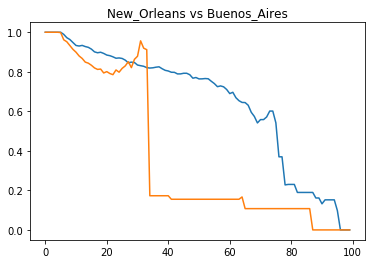

---------------------   New_Orleans  vs.  Busan   ---------------------
Discrete Frechet distance:  2.1866352735227927 



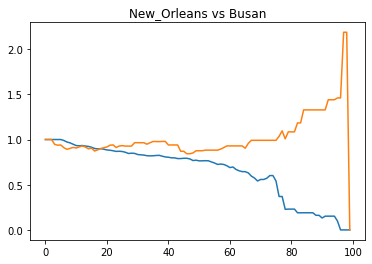

---------------------   New_Orleans  vs.  Denver   ---------------------
Discrete Frechet distance:  0.32324189559831007 



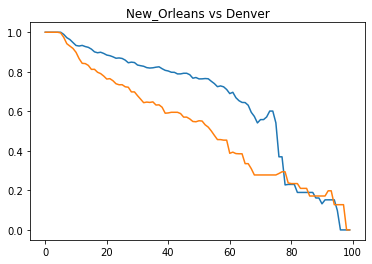

---------------------   New_Orleans  vs.  Dublin   ---------------------
Discrete Frechet distance:  0.2246900790832012 



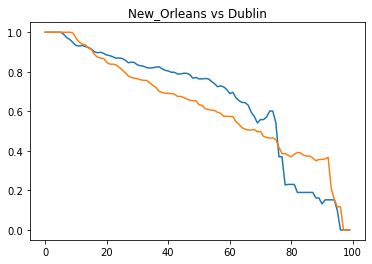

---------------------   New_Orleans  vs.  Edinburgh   ---------------------
Discrete Frechet distance:  0.3087164855337531 



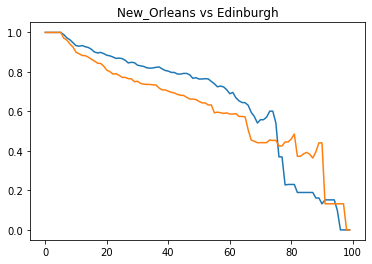

---------------------   New_Orleans  vs.  Florence   ---------------------
Discrete Frechet distance:  0.47888795255287564 



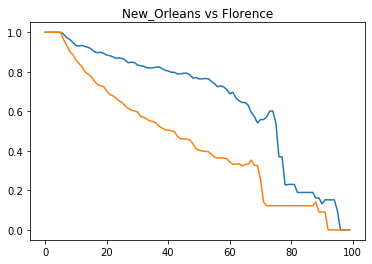

---------------------   New_Orleans  vs.  Los_Angeles   ---------------------
Discrete Frechet distance:  0.4631122846490856 



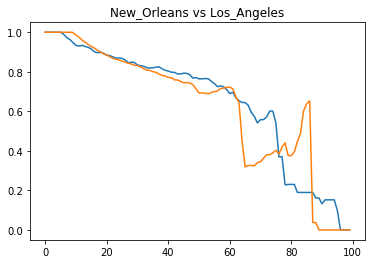

---------------------   New_Orleans  vs.  Lyon   ---------------------
Discrete Frechet distance:  0.240705654209035 



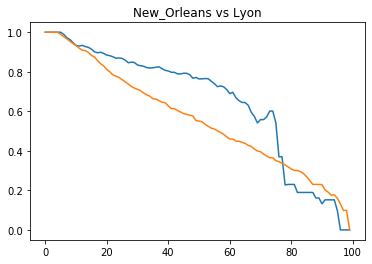

---------------------   New_Orleans  vs.  Madrid   ---------------------
Discrete Frechet distance:  0.2581285156002774 



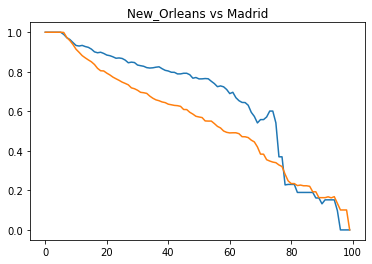

---------------------   New_Orleans  vs.  Moscow   ---------------------
Discrete Frechet distance:  0.49338570684456606 



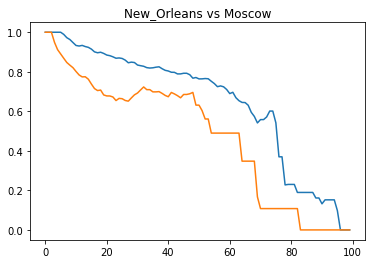

---------------------   New_Orleans  vs.  Palermo   ---------------------
Discrete Frechet distance:  0.8593754274893468 



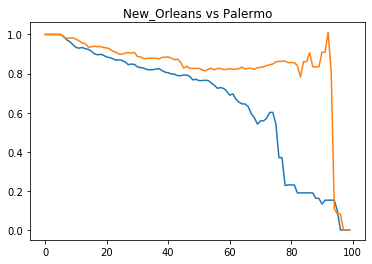

---------------------   New_Orleans  vs.  Paris   ---------------------
Discrete Frechet distance:  0.2727926086525214 



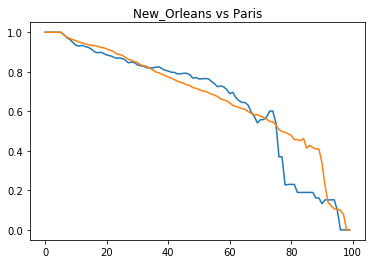

---------------------   New_Orleans  vs.  Porto   ---------------------
Discrete Frechet distance:  1.1909368299450604 



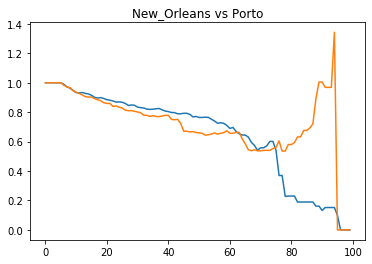

---------------------   New_Orleans  vs.  Prague   ---------------------
Discrete Frechet distance:  0.33534675679421194 



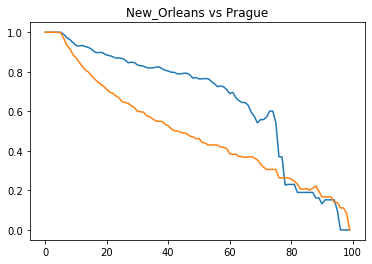

---------------------   New_Orleans  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.24292443857928248 



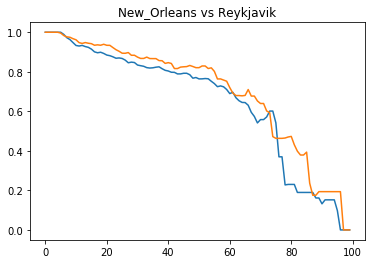

---------------------   New_Orleans  vs.  Riga   ---------------------
Discrete Frechet distance:  0.42435690326336356 



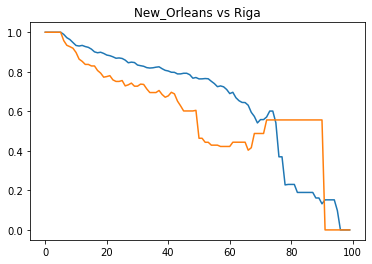

---------------------   New_Orleans  vs.  Rio   ---------------------
Discrete Frechet distance:  1.639445486183051 



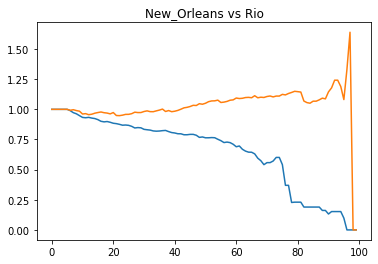

---------------------   New_Orleans  vs.  Rome   ---------------------
Discrete Frechet distance:  0.29428587779167215 



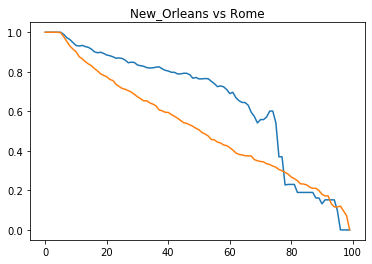

---------------------   New_Orleans  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.8833447012990394 



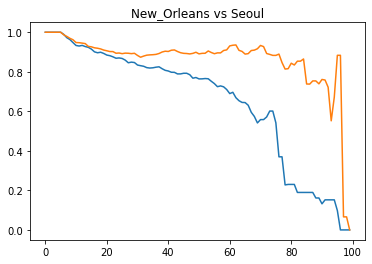

---------------------   New_Orleans  vs.  Siena   ---------------------
Discrete Frechet distance:  0.2991423336791664 



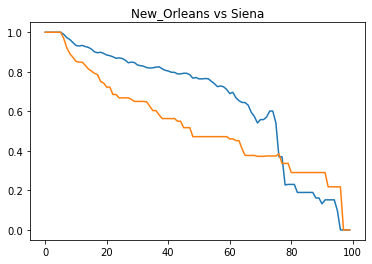

---------------------   New_Orleans  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.3270428080233214 



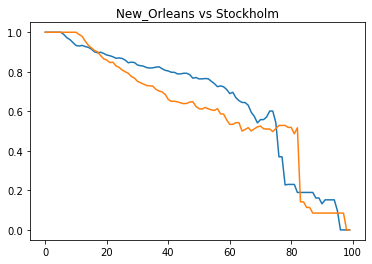

---------------------   New_Orleans  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.9775496108995354 



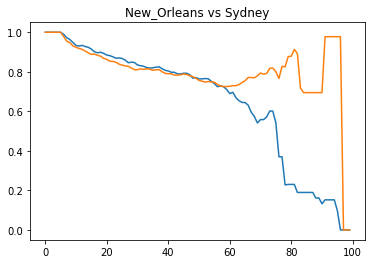

---------------------   New_Orleans  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.2897804792065268 



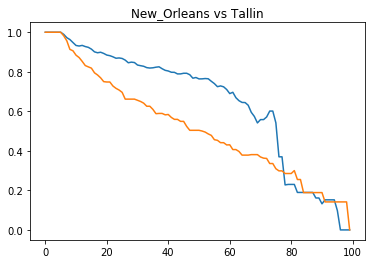

---------------------   New_Orleans  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.25790833030620486 



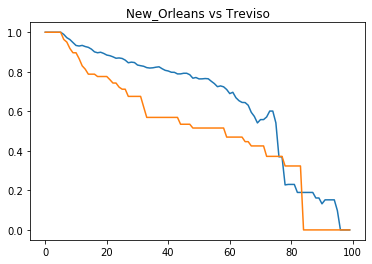

---------------------   New_Orleans  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.19085517845985317 



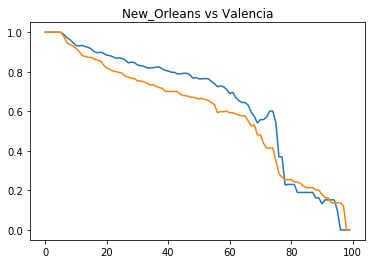

---------------------   New_Orleans  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.20313967978054467 



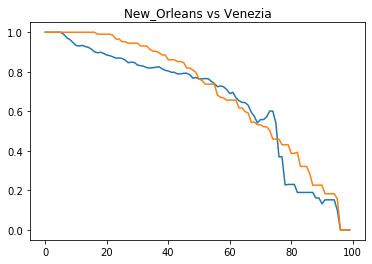

---------------------   New_Orleans  vs.  Verona   ---------------------
Discrete Frechet distance:  0.29227380729546726 



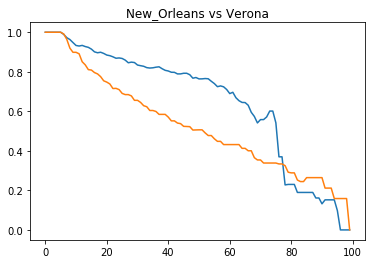

---------------------   New_Orleans  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.32533687923026317 



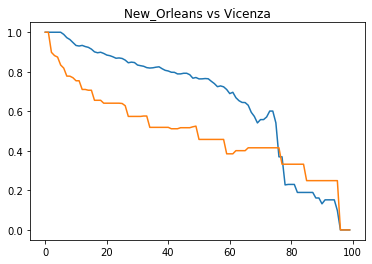

---------------------   New_Orleans  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.702762130401966 



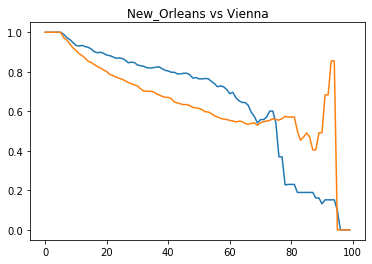

---------------------   New_Orleans  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.4154010365085707 



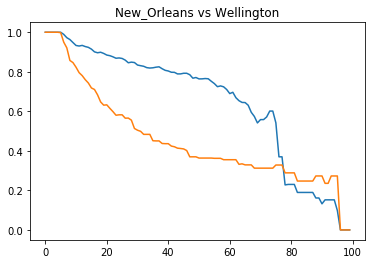

---------------------   New_Orleans  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.3871382078525473 



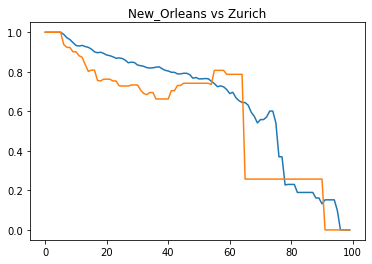

---------------------   New_Orleans  vs.  Milan   ---------------------
Discrete Frechet distance:  0.20992214791398636 



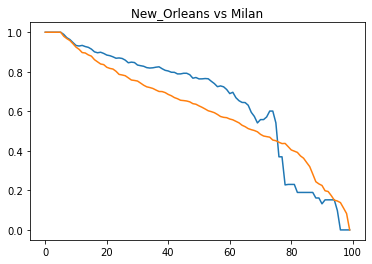

---------------------   New_Orleans  vs.  London   ---------------------
Discrete Frechet distance:  0.22425228237277214 



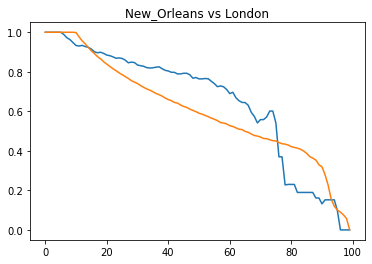

---------------------   New_Orleans  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.6670520643678925 



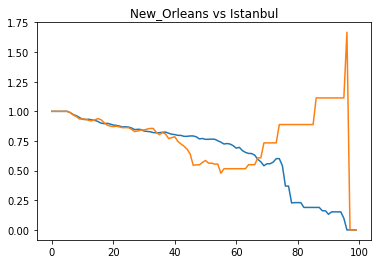

---------------------   New_Orleans  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.4655532558486912 



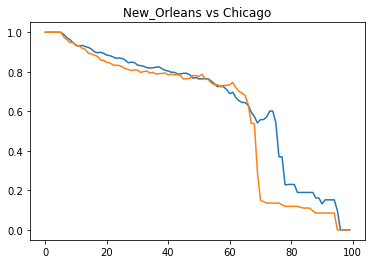

---------------------   New_Orleans  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.33282863027661136 



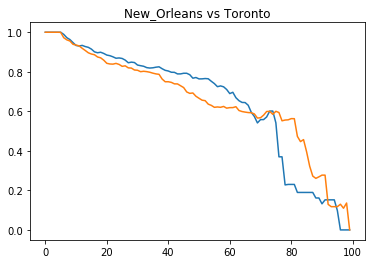

---------------------   New_Orleans  vs.  Munich   ---------------------
Discrete Frechet distance:  0.2500915165016224 



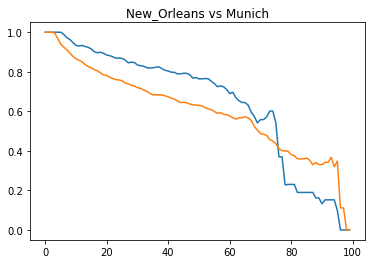

---------------------   Shanghai  vs.  Shanghai   ---------------------
Discrete Frechet distance:  0.0 



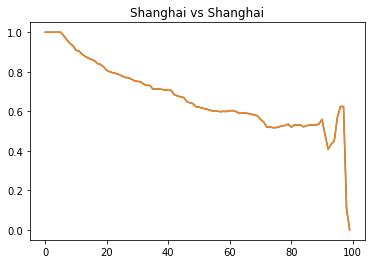

---------------------   Shanghai  vs.  Portland   ---------------------
Discrete Frechet distance:  0.6242442925140762 



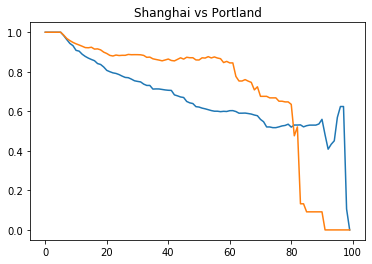

---------------------   Shanghai  vs.  Aarhus   ---------------------
Discrete Frechet distance:  0.6242442925140762 



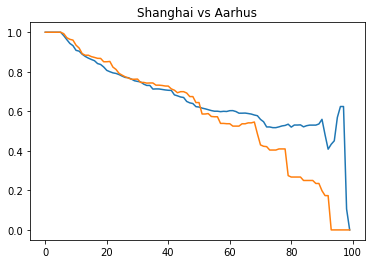

---------------------   Shanghai  vs.  Amsterdam   ---------------------
Discrete Frechet distance:  0.5283718756830341 



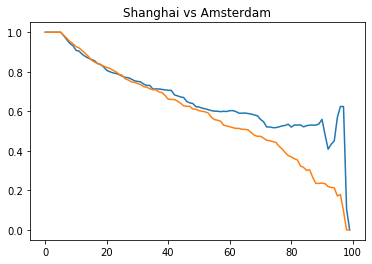

---------------------   Shanghai  vs.  Arezzo   ---------------------
Discrete Frechet distance:  0.6242442925140762 



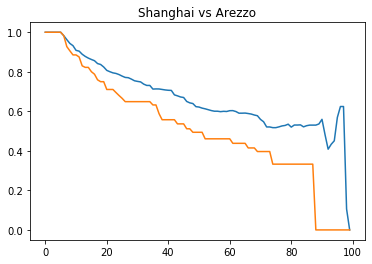

---------------------   Shanghai  vs.  Barcelona   ---------------------
Discrete Frechet distance:  0.6242442925140762 



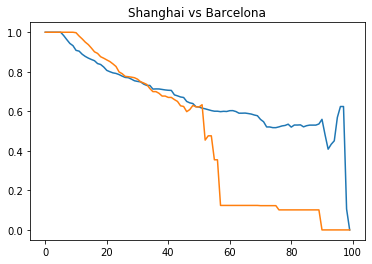

---------------------   Shanghai  vs.  Beijing   ---------------------
Discrete Frechet distance:  0.6242442925140762 



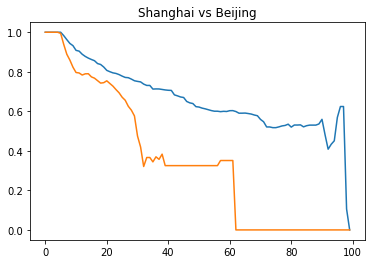

---------------------   Shanghai  vs.  Berlin   ---------------------
Discrete Frechet distance:  0.5655736462551441 



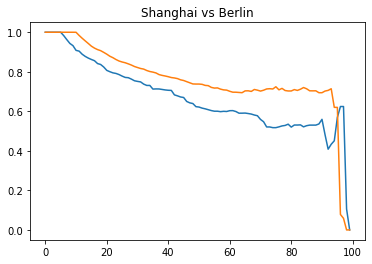

---------------------   Shanghai  vs.  Bologna   ---------------------
Discrete Frechet distance:  0.6242442925140762 



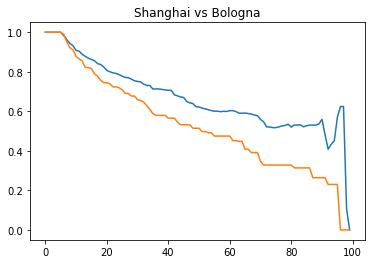

---------------------   Shanghai  vs.  Bordeaux   ---------------------
Discrete Frechet distance:  0.4986849670960539 



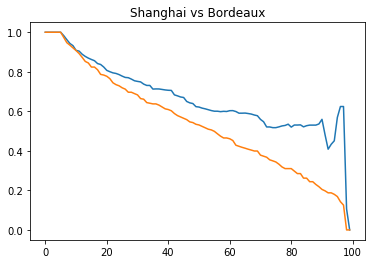

---------------------   Shanghai  vs.  Boston   ---------------------
Discrete Frechet distance:  0.6242442925140762 



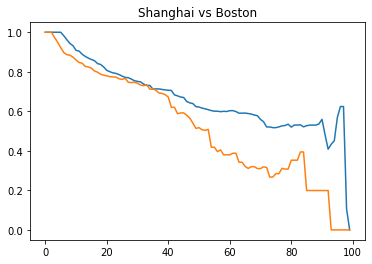

---------------------   Shanghai  vs.  Bremen   ---------------------
Discrete Frechet distance:  1.0545124438691271 



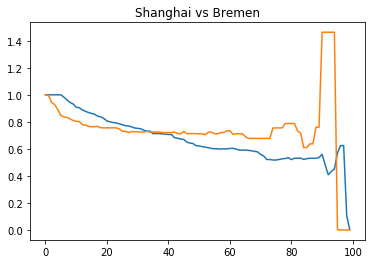

---------------------   Shanghai  vs.  Brno   ---------------------
Discrete Frechet distance:  0.6242442925140762 



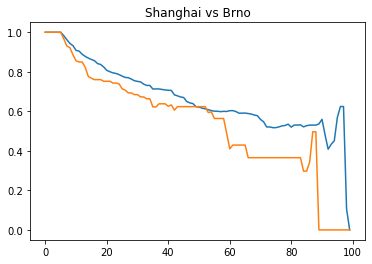

---------------------   Shanghai  vs.  Budapest   ---------------------
Discrete Frechet distance:  0.6242442925140762 



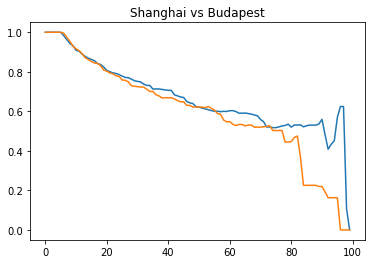

---------------------   Shanghai  vs.  Buenos_Aires   ---------------------
Discrete Frechet distance:  0.6242442925140762 



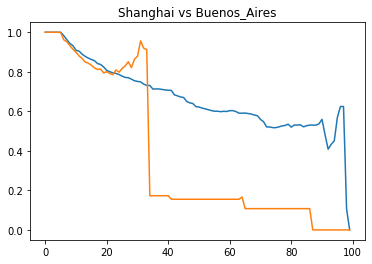

---------------------   Shanghai  vs.  Busan   ---------------------
Discrete Frechet distance:  1.855010937309368 



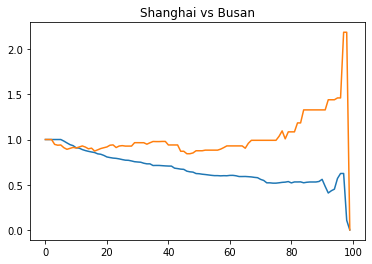

---------------------   Shanghai  vs.  Denver   ---------------------
Discrete Frechet distance:  0.49661015674495845 



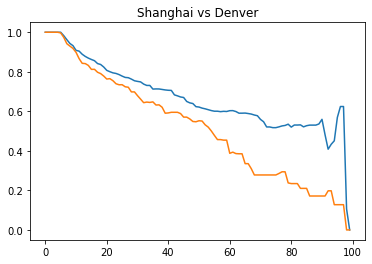

---------------------   Shanghai  vs.  Dublin   ---------------------
Discrete Frechet distance:  0.6242442925140762 



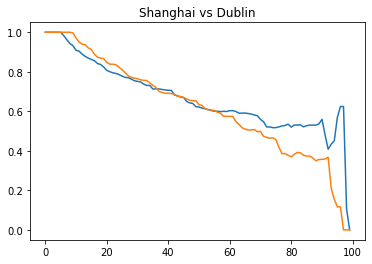

---------------------   Shanghai  vs.  Edinburgh   ---------------------
Discrete Frechet distance:  0.4920280338922114 



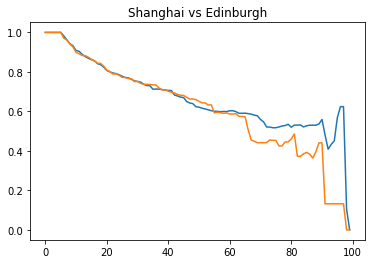

---------------------   Shanghai  vs.  Florence   ---------------------
Discrete Frechet distance:  0.6242442925140762 



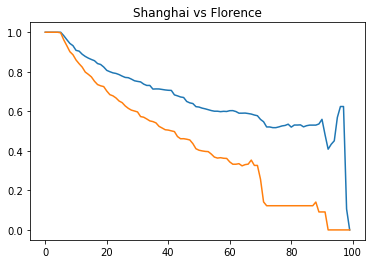

---------------------   Shanghai  vs.  Los_Angeles   ---------------------
Discrete Frechet distance:  0.6242442925140762 



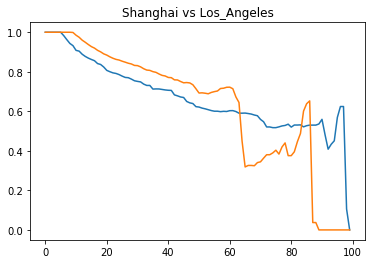

---------------------   Shanghai  vs.  Lyon   ---------------------
Discrete Frechet distance:  0.5257059025108803 



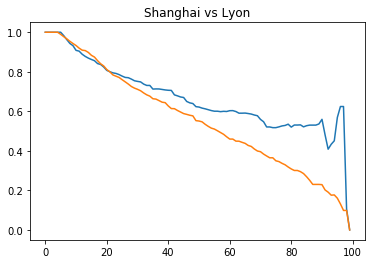

---------------------   Shanghai  vs.  Madrid   ---------------------
Discrete Frechet distance:  0.5233310737212167 



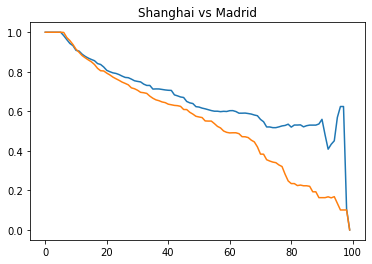

---------------------   Shanghai  vs.  Moscow   ---------------------
Discrete Frechet distance:  0.6242442925140762 



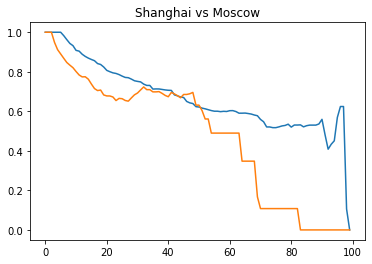

---------------------   Shanghai  vs.  Palermo   ---------------------
Discrete Frechet distance:  0.6242442925140762 



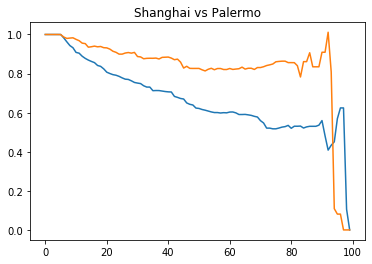

---------------------   Shanghai  vs.  Paris   ---------------------
Discrete Frechet distance:  0.5458899772164352 



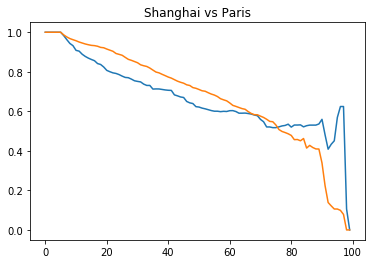

---------------------   Shanghai  vs.  Porto   ---------------------
Discrete Frechet distance:  0.8921966917302742 



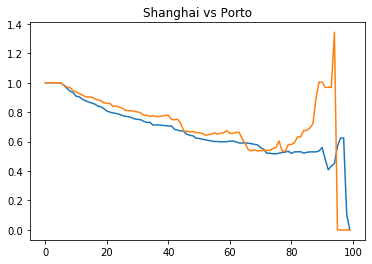

---------------------   Shanghai  vs.  Prague   ---------------------
Discrete Frechet distance:  0.5129714745532645 



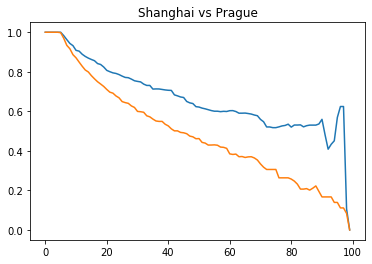

---------------------   Shanghai  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.6242442925140762 



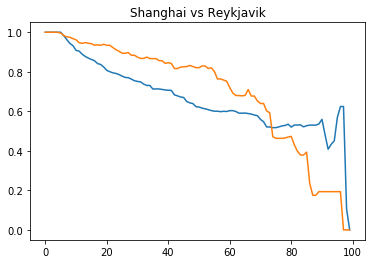

---------------------   Shanghai  vs.  Riga   ---------------------
Discrete Frechet distance:  0.6242442925140762 



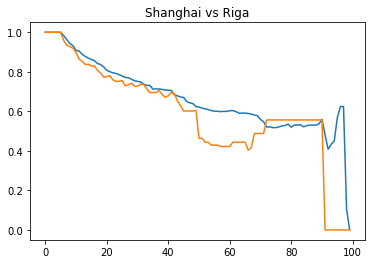

---------------------   Shanghai  vs.  Rio   ---------------------
Discrete Frechet distance:  1.0152011936689749 



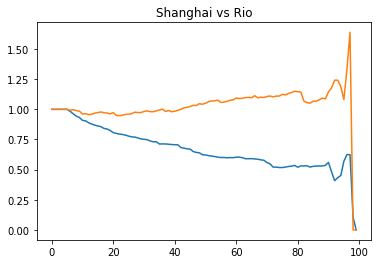

---------------------   Shanghai  vs.  Rome   ---------------------
Discrete Frechet distance:  0.5279606165920645 



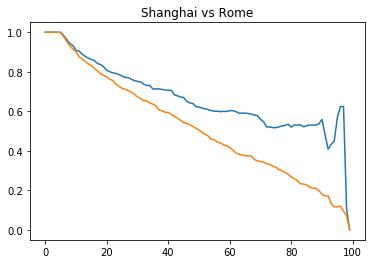

---------------------   Shanghai  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.558237583920129 



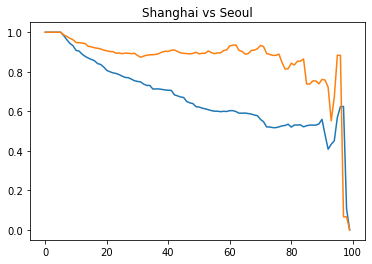

---------------------   Shanghai  vs.  Siena   ---------------------
Discrete Frechet distance:  0.6242442925140762 



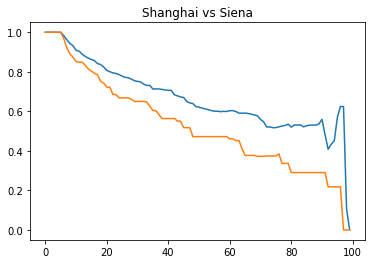

---------------------   Shanghai  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.5390875064288484 



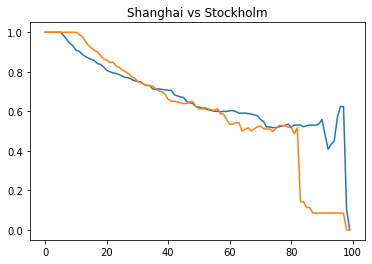

---------------------   Shanghai  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.6242442925140762 



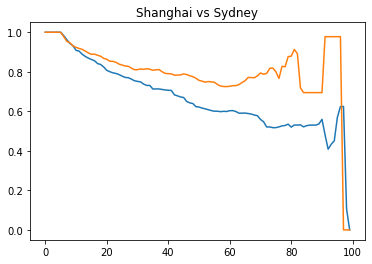

---------------------   Shanghai  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.48258686811971646 



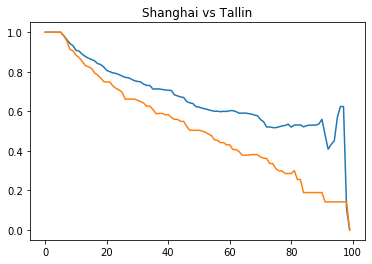

---------------------   Shanghai  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.6242442925140762 



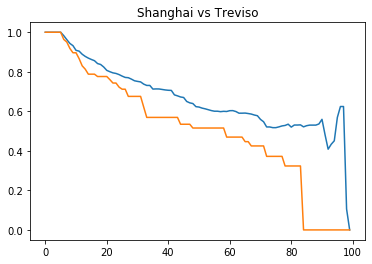

---------------------   Shanghai  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.5034841201498992 



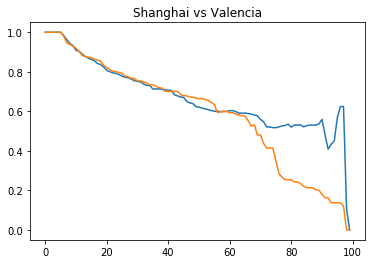

---------------------   Shanghai  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.6242442925140762 



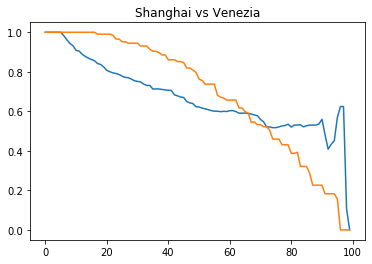

---------------------   Shanghai  vs.  Verona   ---------------------
Discrete Frechet distance:  0.46554192427151264 



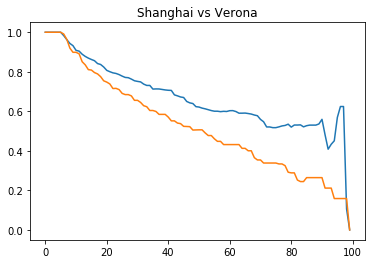

---------------------   Shanghai  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.6242442925140762 



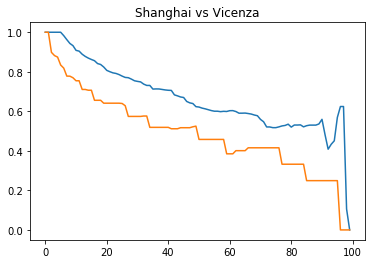

---------------------   Shanghai  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.6242442925140762 



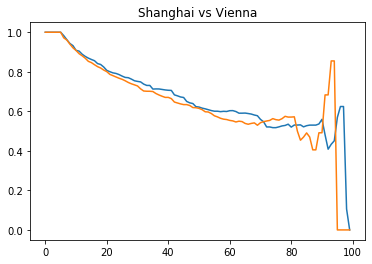

---------------------   Shanghai  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.6242442925140762 



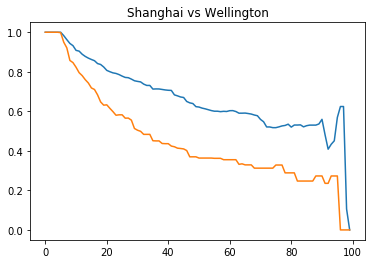

---------------------   Shanghai  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.6242442925140762 



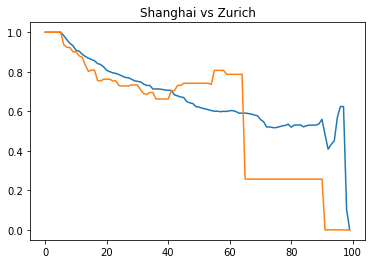

---------------------   Shanghai  vs.  Milan   ---------------------
Discrete Frechet distance:  0.5134258556406649 



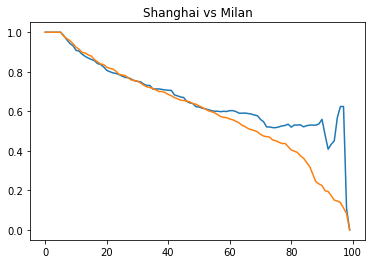

---------------------   Shanghai  vs.  London   ---------------------
Discrete Frechet distance:  0.5482141953547165 



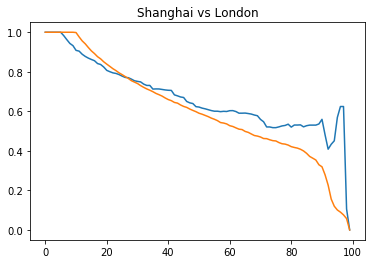

---------------------   Shanghai  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.0428077718538162 



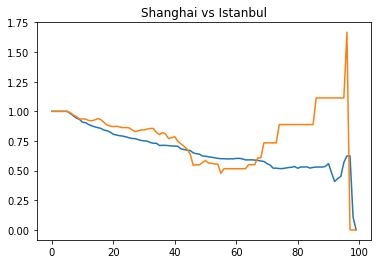

---------------------   Shanghai  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.6242442925140762 



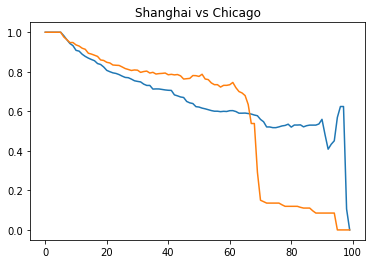

---------------------   Shanghai  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.5145141699711966 



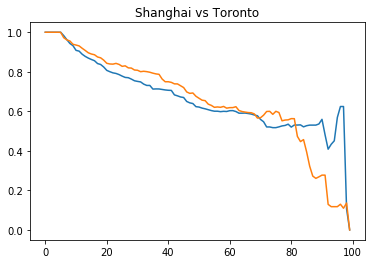

---------------------   Shanghai  vs.  Munich   ---------------------
Discrete Frechet distance:  0.5128466907581959 



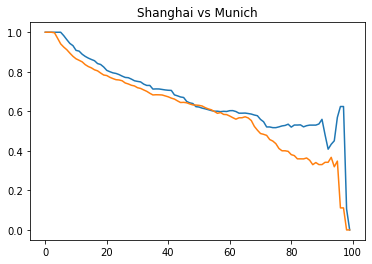

---------------------   Portland  vs.  Portland   ---------------------
Discrete Frechet distance:  0.0 



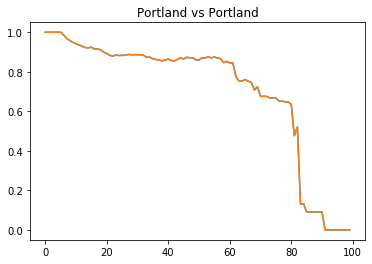

---------------------   Portland  vs.  Aarhus   ---------------------
Discrete Frechet distance:  0.3730485161621419 



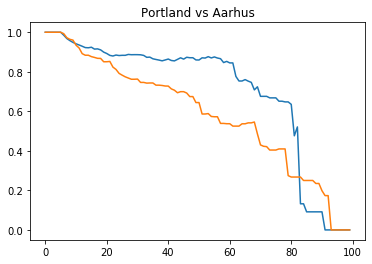

---------------------   Portland  vs.  Amsterdam   ---------------------
Discrete Frechet distance:  0.3277480121452292 



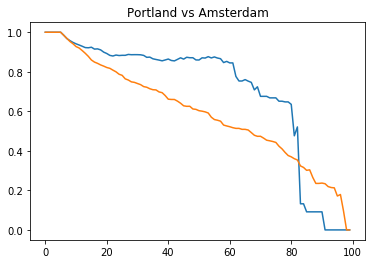

---------------------   Portland  vs.  Arezzo   ---------------------
Discrete Frechet distance:  0.4156274998133555 



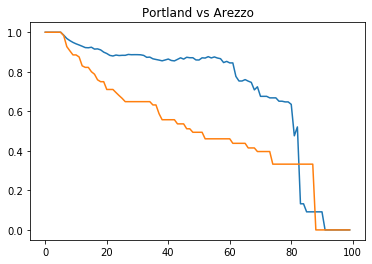

---------------------   Portland  vs.  Barcelona   ---------------------
Discrete Frechet distance:  0.7423087324117315 



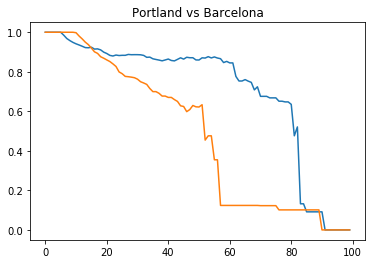

---------------------   Portland  vs.  Beijing   ---------------------
Discrete Frechet distance:  0.7764623505280392 



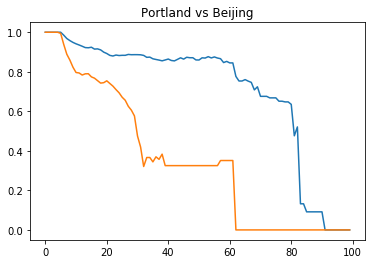

---------------------   Portland  vs.  Berlin   ---------------------
Discrete Frechet distance:  0.7141135865816987 



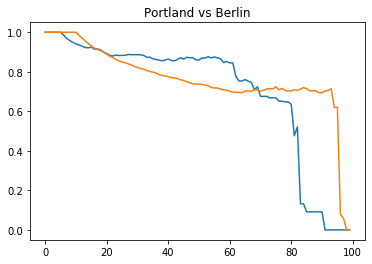

---------------------   Portland  vs.  Bologna   ---------------------
Discrete Frechet distance:  0.40020931838998064 



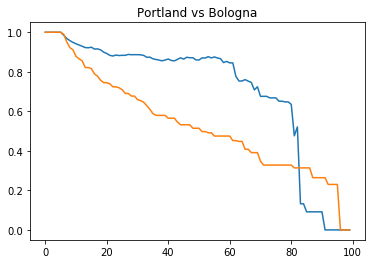

---------------------   Portland  vs.  Bordeaux   ---------------------
Discrete Frechet distance:  0.392664396017158 



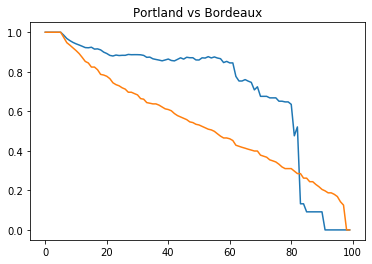

---------------------   Portland  vs.  Boston   ---------------------
Discrete Frechet distance:  0.47327731180318583 



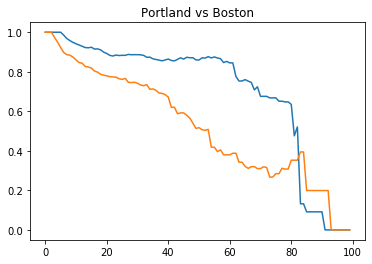

---------------------   Portland  vs.  Bremen   ---------------------
Discrete Frechet distance:  1.4629207548535066 



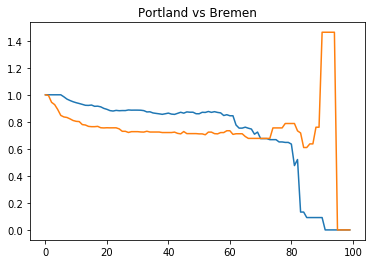

---------------------   Portland  vs.  Brno   ---------------------
Discrete Frechet distance:  0.4344463682690177 



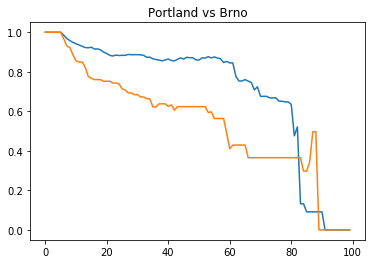

---------------------   Portland  vs.  Budapest   ---------------------
Discrete Frechet distance:  0.31063928460892165 



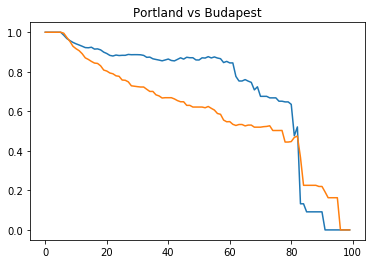

---------------------   Portland  vs.  Buenos_Aires   ---------------------
Discrete Frechet distance:  0.7214067628623322 



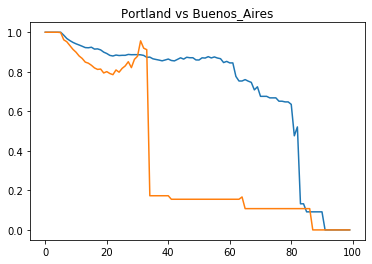

---------------------   Portland  vs.  Busan   ---------------------
Discrete Frechet distance:  2.1866352735227927 



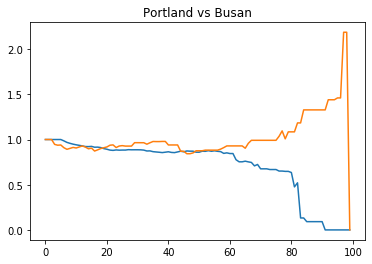

---------------------   Portland  vs.  Denver   ---------------------
Discrete Frechet distance:  0.4572932749859816 



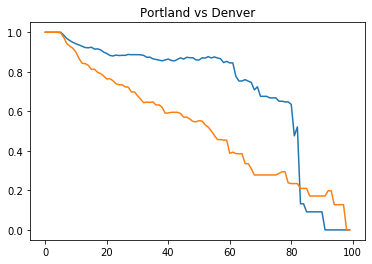

---------------------   Portland  vs.  Dublin   ---------------------
Discrete Frechet distance:  0.3676371271195406 



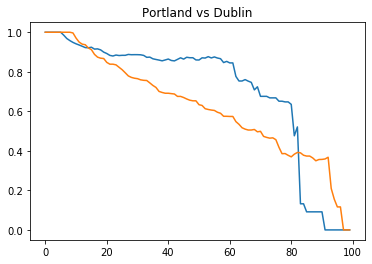

---------------------   Portland  vs.  Edinburgh   ---------------------
Discrete Frechet distance:  0.34930215178032586 



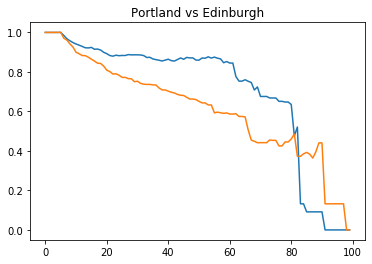

---------------------   Portland  vs.  Florence   ---------------------
Discrete Frechet distance:  0.553388520324673 



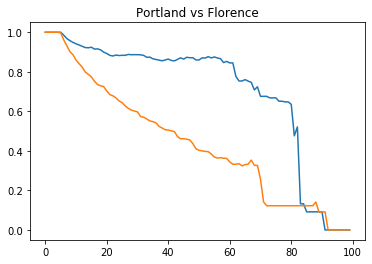

---------------------   Portland  vs.  Los_Angeles   ---------------------
Discrete Frechet distance:  0.5612686019173757 



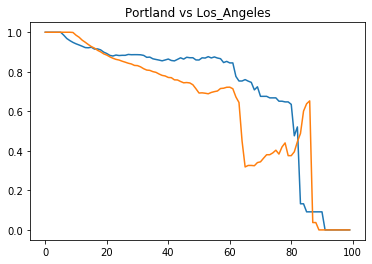

---------------------   Portland  vs.  Lyon   ---------------------
Discrete Frechet distance:  0.3853315247506416 



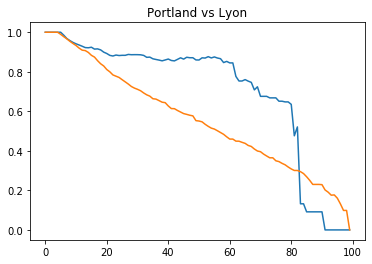

---------------------   Portland  vs.  Madrid   ---------------------
Discrete Frechet distance:  0.4008059208909748 



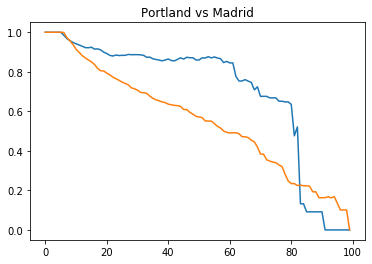

---------------------   Portland  vs.  Moscow   ---------------------
Discrete Frechet distance:  0.5678862746163634 



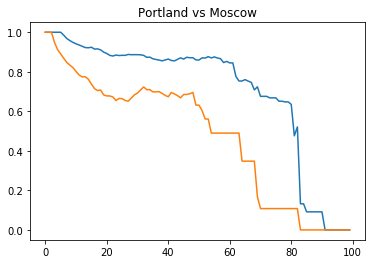

---------------------   Portland  vs.  Palermo   ---------------------
Discrete Frechet distance:  1.011525905917469 



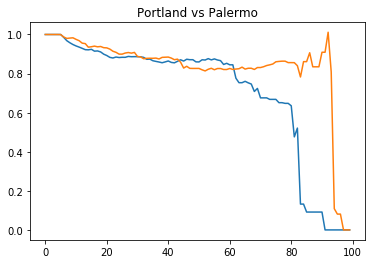

---------------------   Portland  vs.  Paris   ---------------------
Discrete Frechet distance:  0.33623579132514975 



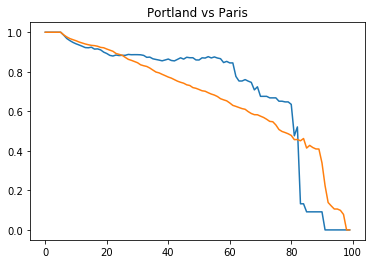

---------------------   Portland  vs.  Porto   ---------------------
Discrete Frechet distance:  1.3430873083731827 



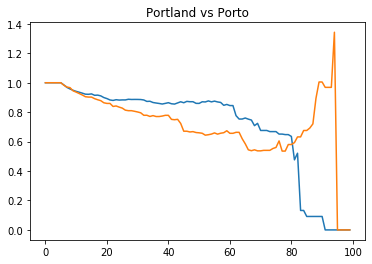

---------------------   Portland  vs.  Prague   ---------------------
Discrete Frechet distance:  0.4630354229647278 



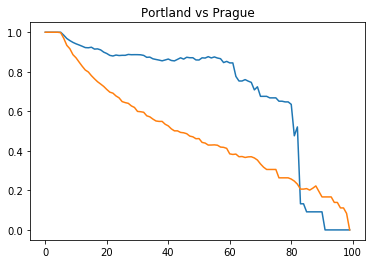

---------------------   Portland  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.30205654746885235 



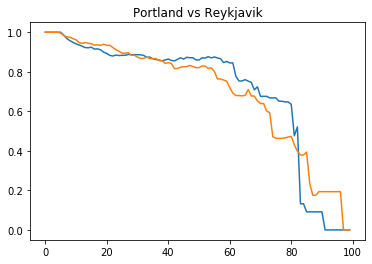

---------------------   Portland  vs.  Riga   ---------------------
Discrete Frechet distance:  0.46494256950993634 



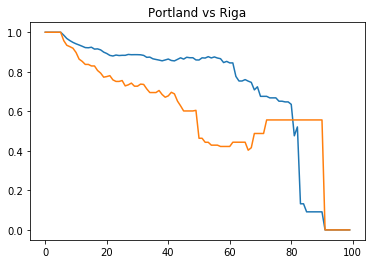

---------------------   Portland  vs.  Rio   ---------------------
Discrete Frechet distance:  1.639445486183051 



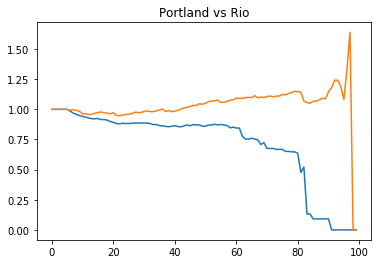

---------------------   Portland  vs.  Rome   ---------------------
Discrete Frechet distance:  0.44091355680414684 



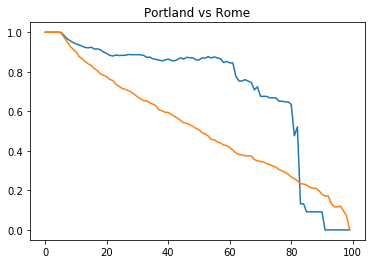

---------------------   Portland  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.8833447012990394 



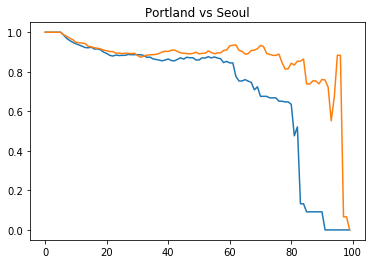

---------------------   Portland  vs.  Siena   ---------------------
Discrete Frechet distance:  0.4046650642814357 



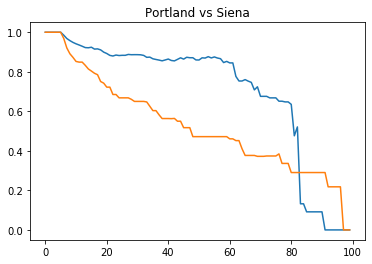

---------------------   Portland  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.3109952009333278 



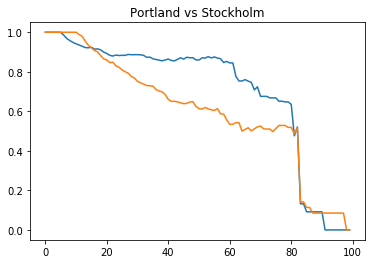

---------------------   Portland  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.9775496108995354 



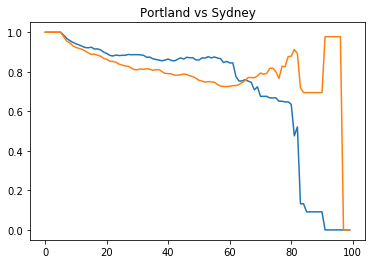

---------------------   Portland  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.4384119581345423 



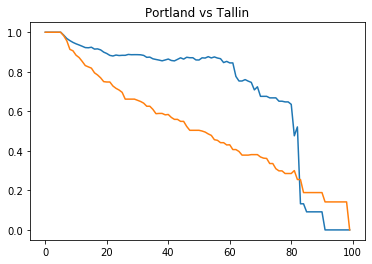

---------------------   Portland  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.3830008944552077 



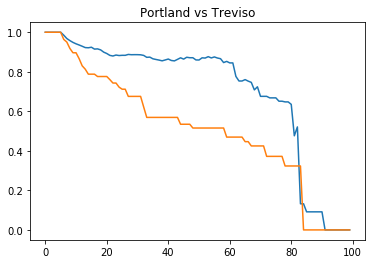

---------------------   Portland  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.39333967477180515 



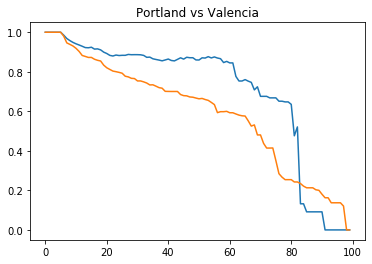

---------------------   Portland  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.2480689418495715 



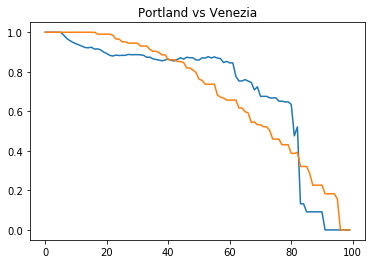

---------------------   Portland  vs.  Verona   ---------------------
Discrete Frechet distance:  0.4215160854588765 



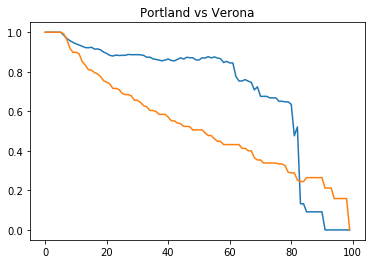

---------------------   Portland  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.4676182394239497 



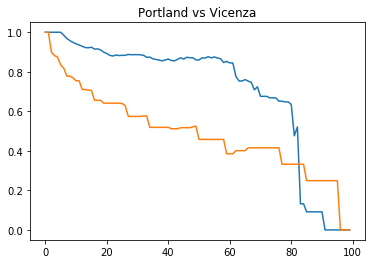

---------------------   Portland  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.8549126088300883 



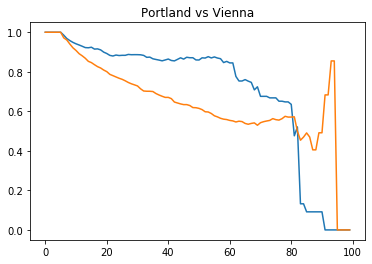

---------------------   Portland  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.5130154935839077 



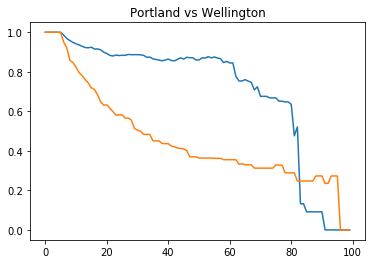

---------------------   Portland  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.5033101120525918 



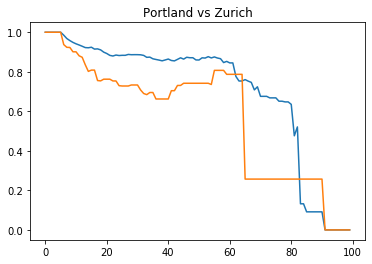

---------------------   Portland  vs.  Milan   ---------------------
Discrete Frechet distance:  0.2924074546937556 



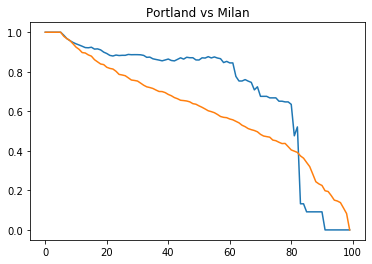

---------------------   Portland  vs.  London   ---------------------
Discrete Frechet distance:  0.32304619742540575 



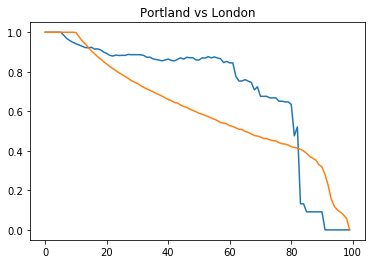

---------------------   Portland  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.6670520643678925 



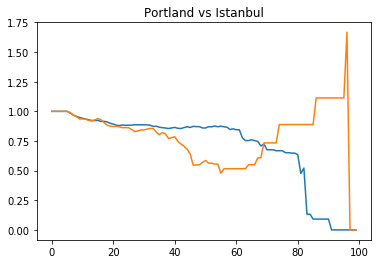

---------------------   Portland  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.5400538236204886 



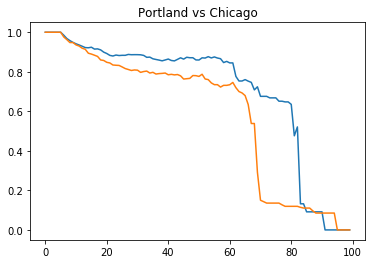

---------------------   Portland  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.32467656003529427 



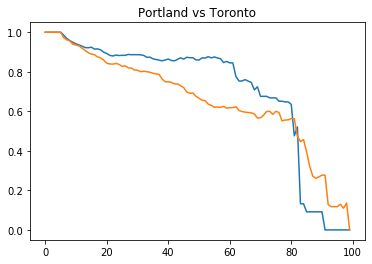

---------------------   Portland  vs.  Munich   ---------------------
Discrete Frechet distance:  0.3671130278414978 



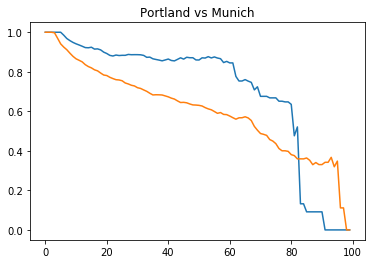

---------------------   Aarhus  vs.  Aarhus   ---------------------
Discrete Frechet distance:  0.0 



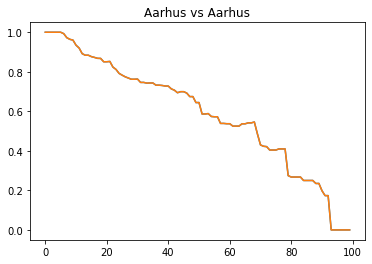

---------------------   Aarhus  vs.  Amsterdam   ---------------------
Discrete Frechet distance:  0.21438225976665634 



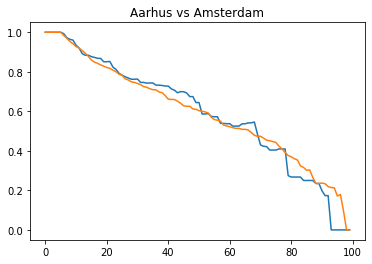

---------------------   Aarhus  vs.  Arezzo   ---------------------
Discrete Frechet distance:  0.23500114471593256 



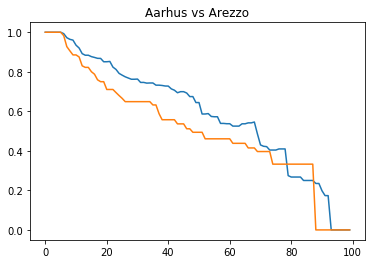

---------------------   Aarhus  vs.  Barcelona   ---------------------
Discrete Frechet distance:  0.42196193345520755 



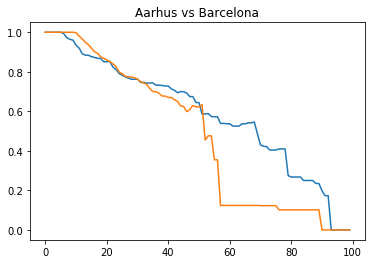

---------------------   Aarhus  vs.  Beijing   ---------------------
Discrete Frechet distance:  0.5458311692264295 



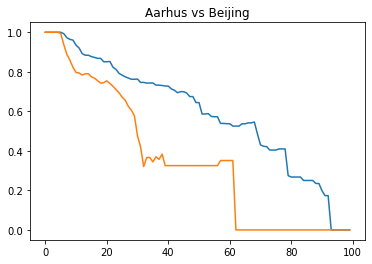

---------------------   Aarhus  vs.  Berlin   ---------------------
Discrete Frechet distance:  0.7141135865816987 



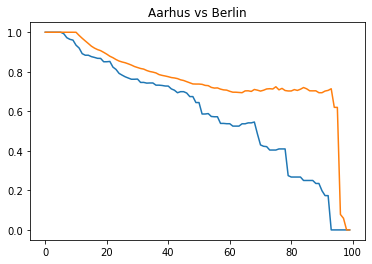

---------------------   Aarhus  vs.  Bologna   ---------------------
Discrete Frechet distance:  0.23004883681468558 



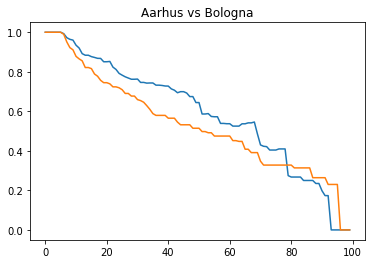

---------------------   Aarhus  vs.  Bordeaux   ---------------------
Discrete Frechet distance:  0.1875546729917963 



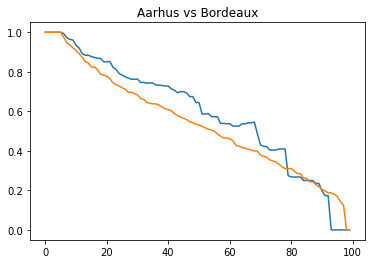

---------------------   Aarhus  vs.  Boston   ---------------------
Discrete Frechet distance:  0.23035184689512667 



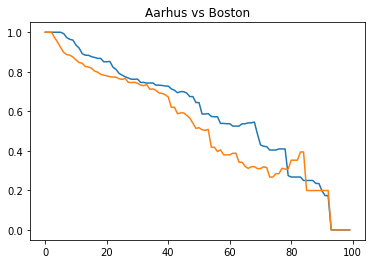

---------------------   Aarhus  vs.  Bremen   ---------------------
Discrete Frechet distance:  1.4629207548535066 



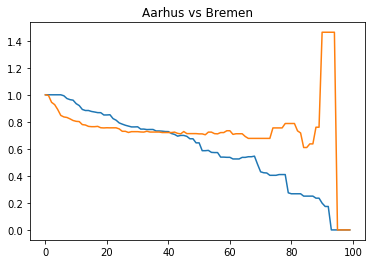

---------------------   Aarhus  vs.  Brno   ---------------------
Discrete Frechet distance:  0.2613786361746474 



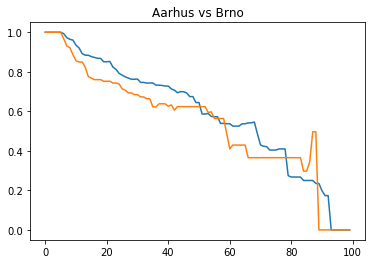

---------------------   Aarhus  vs.  Budapest   ---------------------
Discrete Frechet distance:  0.20736922491280235 



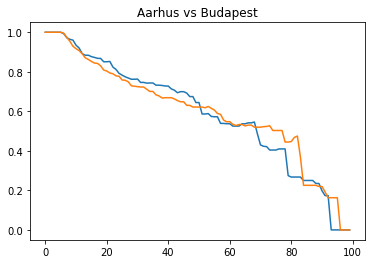

---------------------   Aarhus  vs.  Buenos_Aires   ---------------------
Discrete Frechet distance:  0.5704755388616247 



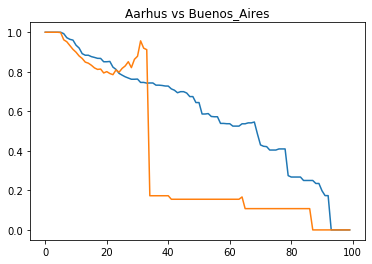

---------------------   Aarhus  vs.  Busan   ---------------------
Discrete Frechet distance:  2.1866352735227927 



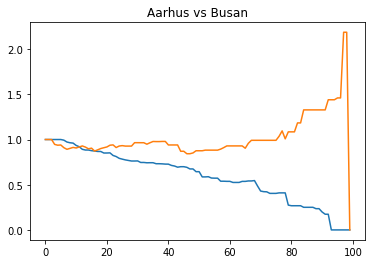

---------------------   Aarhus  vs.  Denver   ---------------------
Discrete Frechet distance:  0.26782555481146875 



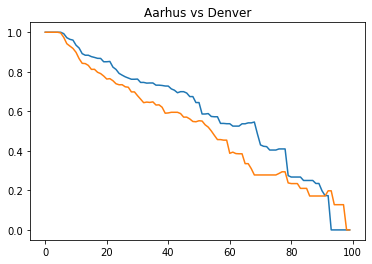

---------------------   Aarhus  vs.  Dublin   ---------------------
Discrete Frechet distance:  0.20975993876686333 



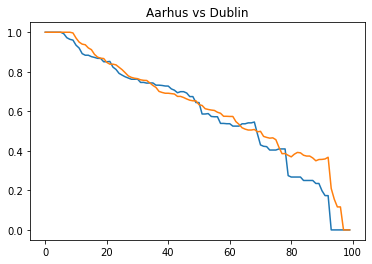

---------------------   Aarhus  vs.  Edinburgh   ---------------------
Discrete Frechet distance:  0.24252438831690407 



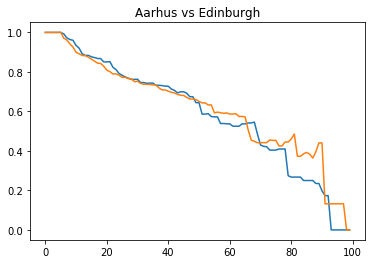

---------------------   Aarhus  vs.  Florence   ---------------------
Discrete Frechet distance:  0.2989646259647947 



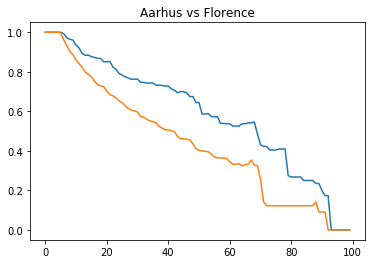

---------------------   Aarhus  vs.  Los_Angeles   ---------------------
Discrete Frechet distance:  0.4025689058930854 



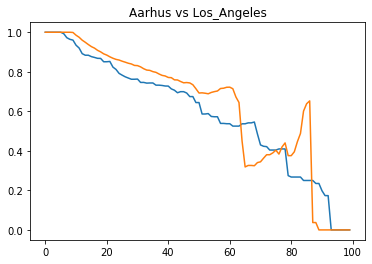

---------------------   Aarhus  vs.  Lyon   ---------------------
Discrete Frechet distance:  0.1770190755048407 



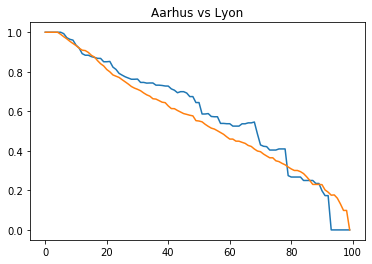

---------------------   Aarhus  vs.  Madrid   ---------------------
Discrete Frechet distance:  0.1681886979880792 



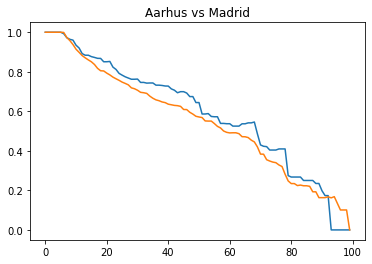

---------------------   Aarhus  vs.  Moscow   ---------------------
Discrete Frechet distance:  0.3221116613623991 



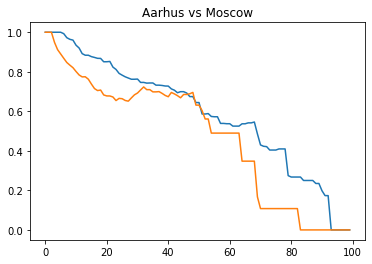

---------------------   Aarhus  vs.  Palermo   ---------------------
Discrete Frechet distance:  0.8379919515159656 



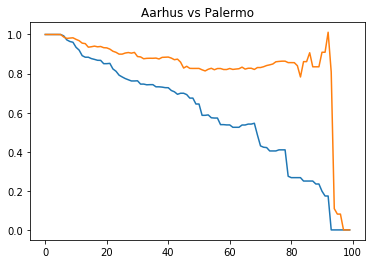

---------------------   Aarhus  vs.  Paris   ---------------------
Discrete Frechet distance:  0.21224922989652123 



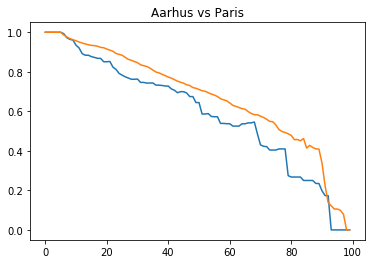

---------------------   Aarhus  vs.  Porto   ---------------------
Discrete Frechet distance:  1.3430873083731827 



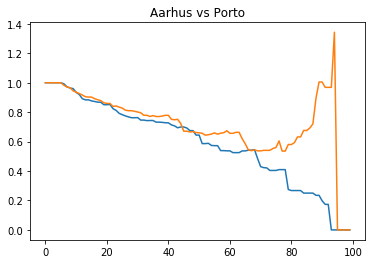

---------------------   Aarhus  vs.  Prague   ---------------------
Discrete Frechet distance:  0.20798999193527284 



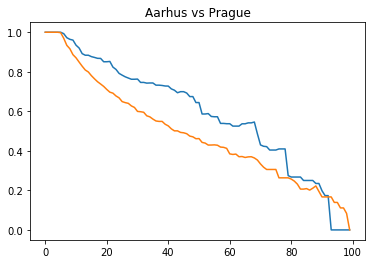

---------------------   Aarhus  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.2460966644132565 



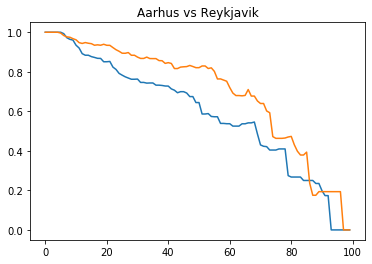

---------------------   Aarhus  vs.  Riga   ---------------------
Discrete Frechet distance:  0.35816480604651457 



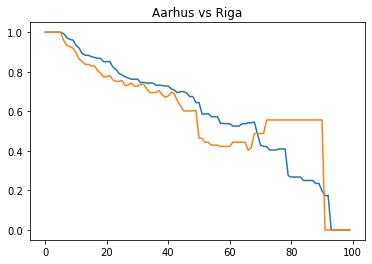

---------------------   Aarhus  vs.  Rio   ---------------------
Discrete Frechet distance:  1.639445486183051 



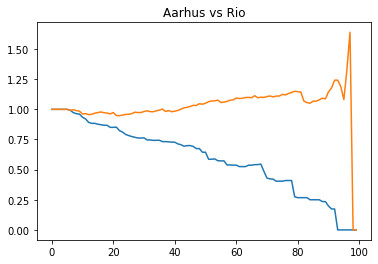

---------------------   Aarhus  vs.  Rome   ---------------------
Discrete Frechet distance:  0.18989708654805 



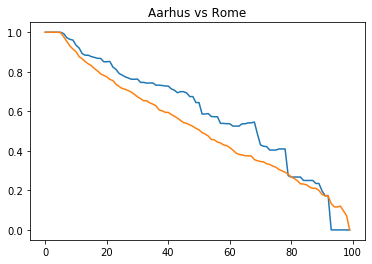

---------------------   Aarhus  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.8833447012990394 



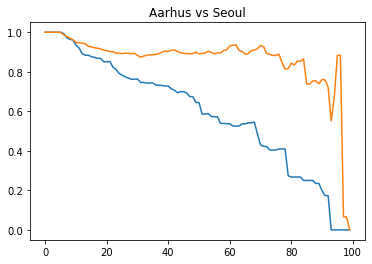

---------------------   Aarhus  vs.  Siena   ---------------------
Discrete Frechet distance:  0.21800762130988874 



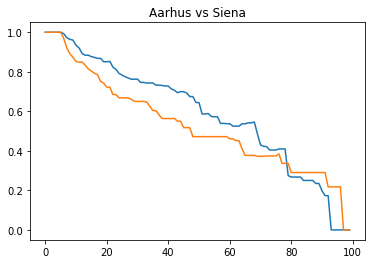

---------------------   Aarhus  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.251064827763849 



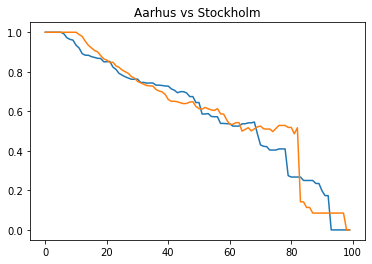

---------------------   Aarhus  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.9775496108995354 



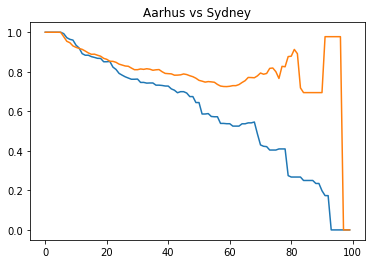

---------------------   Aarhus  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.170588284427714 



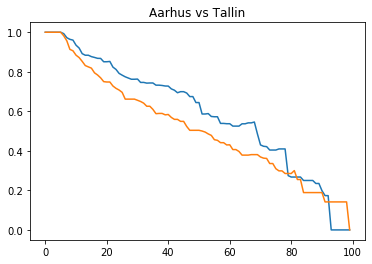

---------------------   Aarhus  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.25011840631679444 



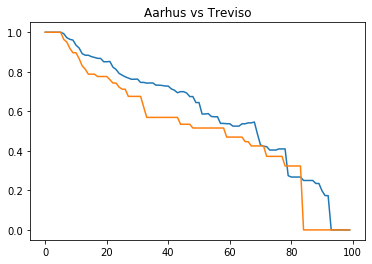

---------------------   Aarhus  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.15543238088177913 



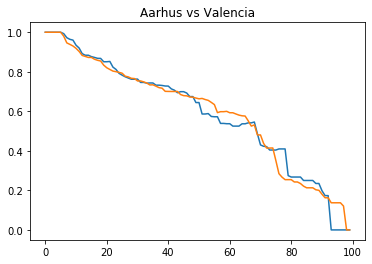

---------------------   Aarhus  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.1875940639514514 



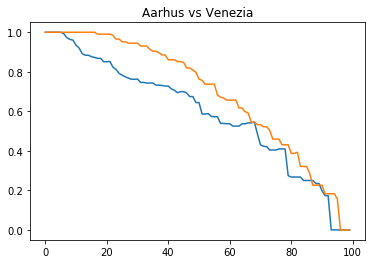

---------------------   Aarhus  vs.  Verona   ---------------------
Discrete Frechet distance:  0.21160315765679333 



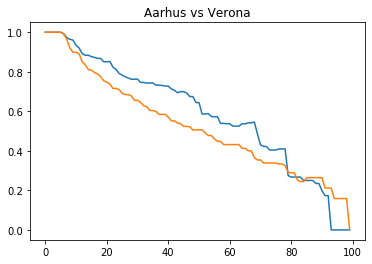

---------------------   Aarhus  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.24926778410034237 



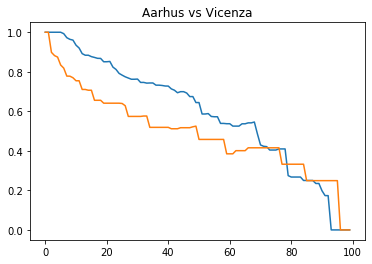

---------------------   Aarhus  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.8549126088300883 



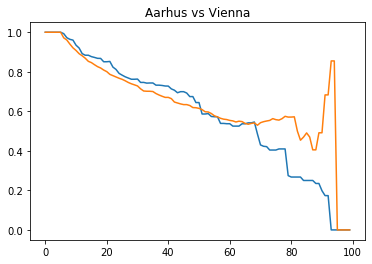

---------------------   Aarhus  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.30480211785716843 



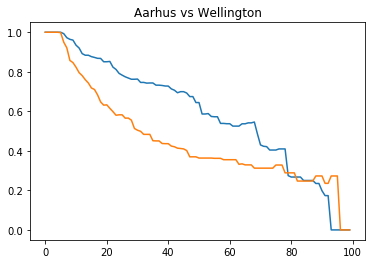

---------------------   Aarhus  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.28873343127832624 



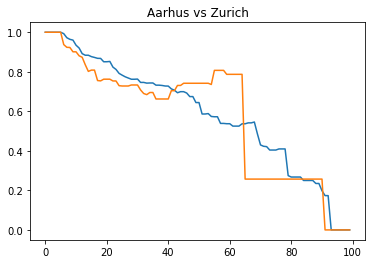

---------------------   Aarhus  vs.  Milan   ---------------------
Discrete Frechet distance:  0.1739388083912284 



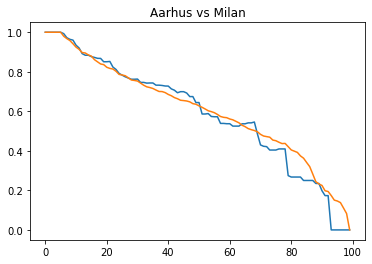

---------------------   Aarhus  vs.  London   ---------------------
Discrete Frechet distance:  0.15601136963051485 



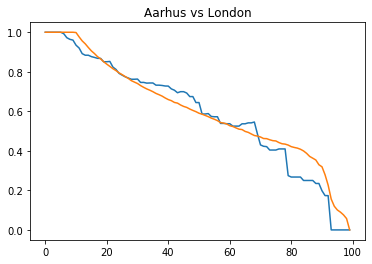

---------------------   Aarhus  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.6670520643678925 



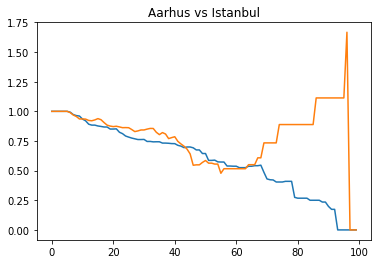

---------------------   Aarhus  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.29035309205957344 



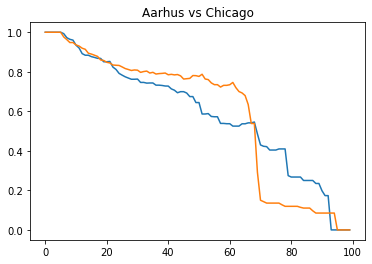

---------------------   Aarhus  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.2954749985921452 



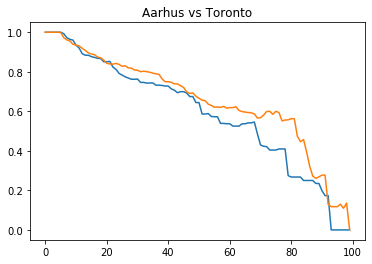

---------------------   Aarhus  vs.  Munich   ---------------------
Discrete Frechet distance:  0.3671130278414978 



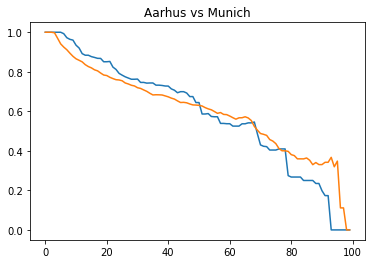

---------------------   Amsterdam  vs.  Amsterdam   ---------------------
Discrete Frechet distance:  0.0 



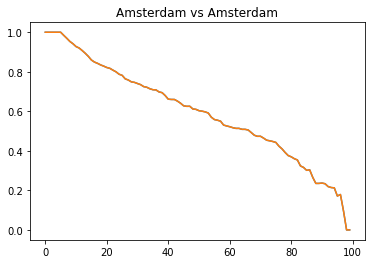

---------------------   Amsterdam  vs.  Arezzo   ---------------------
Discrete Frechet distance:  0.23698666730795864 



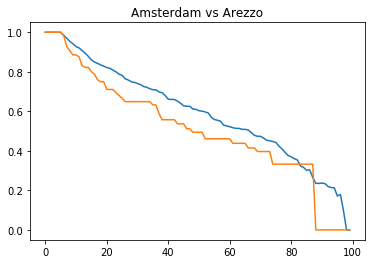

---------------------   Amsterdam  vs.  Barcelona   ---------------------
Discrete Frechet distance:  0.42630972224085434 



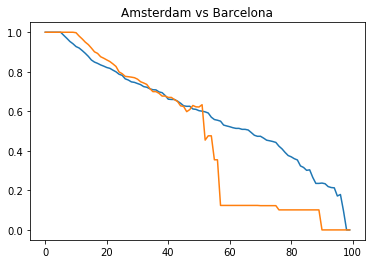

---------------------   Amsterdam  vs.  Beijing   ---------------------
Discrete Frechet distance:  0.513686322687443 



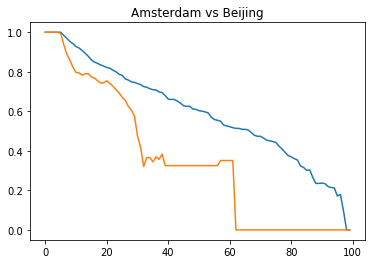

---------------------   Amsterdam  vs.  Berlin   ---------------------
Discrete Frechet distance:  0.4997313268150423 



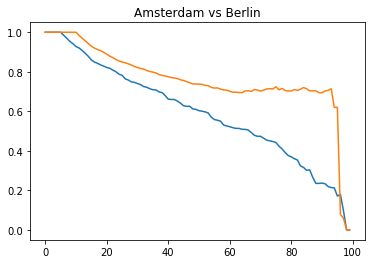

---------------------   Amsterdam  vs.  Bologna   ---------------------
Discrete Frechet distance:  0.17910431260074292 



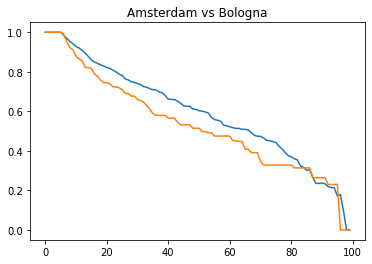

---------------------   Amsterdam  vs.  Bordeaux   ---------------------
Discrete Frechet distance:  0.09889519454935158 



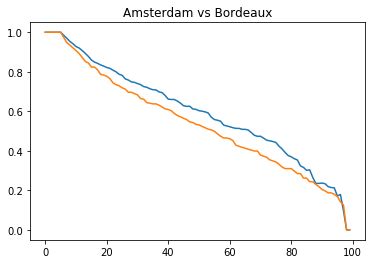

---------------------   Amsterdam  vs.  Boston   ---------------------
Discrete Frechet distance:  0.21438225976665634 



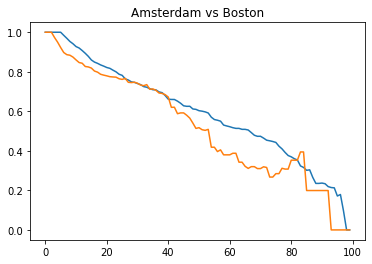

---------------------   Amsterdam  vs.  Bremen   ---------------------
Discrete Frechet distance:  1.2500781568760966 



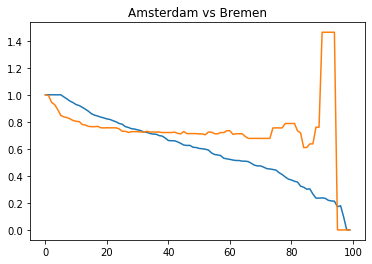

---------------------   Amsterdam  vs.  Brno   ---------------------
Discrete Frechet distance:  0.26107080431803614 



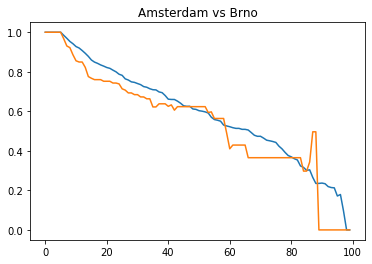

---------------------   Amsterdam  vs.  Budapest   ---------------------
Discrete Frechet distance:  0.17910431260074292 



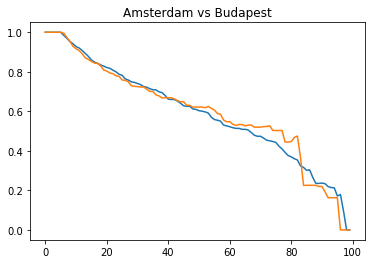

---------------------   Amsterdam  vs.  Buenos_Aires   ---------------------
Discrete Frechet distance:  0.54134497889828 



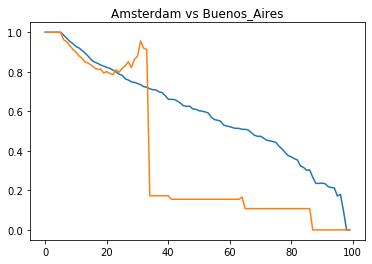

---------------------   Amsterdam  vs.  Busan   ---------------------
Discrete Frechet distance:  2.1866352735227927 



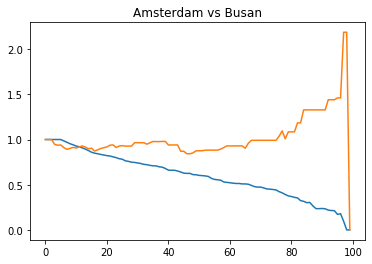

---------------------   Amsterdam  vs.  Denver   ---------------------
Discrete Frechet distance:  0.2008984014511057 



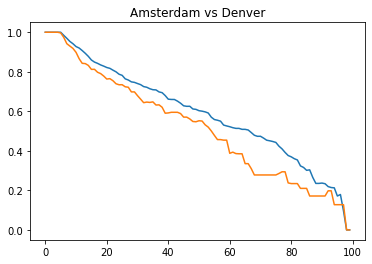

---------------------   Amsterdam  vs.  Dublin   ---------------------
Discrete Frechet distance:  0.14835220956413123 



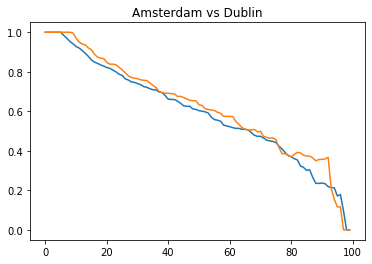

---------------------   Amsterdam  vs.  Edinburgh   ---------------------
Discrete Frechet distance:  0.2054118855002861 



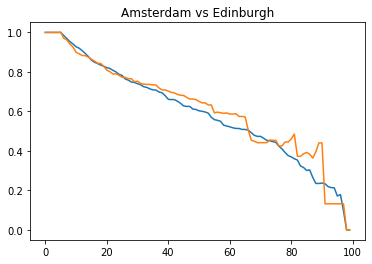

---------------------   Amsterdam  vs.  Florence   ---------------------
Discrete Frechet distance:  0.33154095679163564 



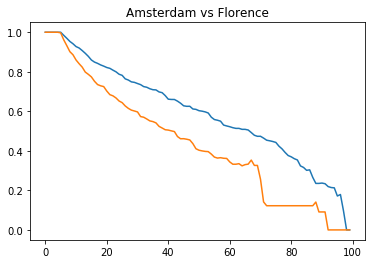

---------------------   Amsterdam  vs.  Los_Angeles   ---------------------
Discrete Frechet distance:  0.3488045599861864 



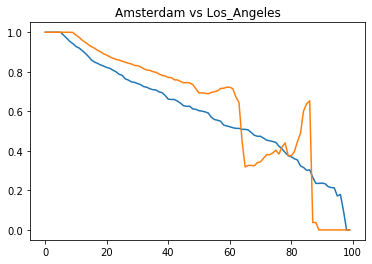

---------------------   Amsterdam  vs.  Lyon   ---------------------
Discrete Frechet distance:  0.0985383900031959 



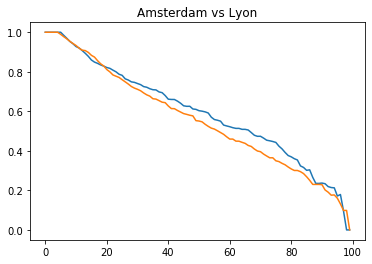

---------------------   Amsterdam  vs.  Madrid   ---------------------
Discrete Frechet distance:  0.13530497605467848 



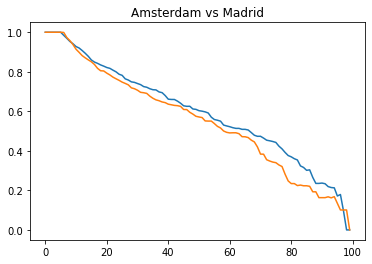

---------------------   Amsterdam  vs.  Moscow   ---------------------
Discrete Frechet distance:  0.3658592815495649 



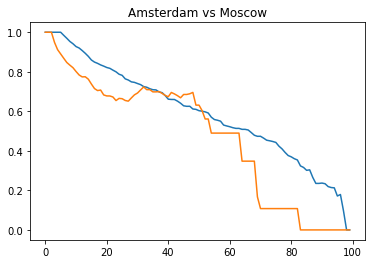

---------------------   Amsterdam  vs.  Palermo   ---------------------
Discrete Frechet distance:  0.7922409883620597 



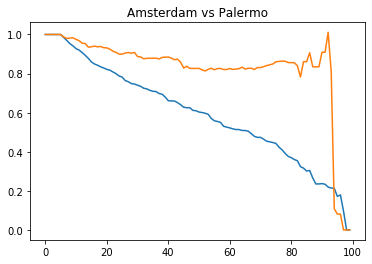

---------------------   Amsterdam  vs.  Paris   ---------------------
Discrete Frechet distance:  0.17440835477706368 



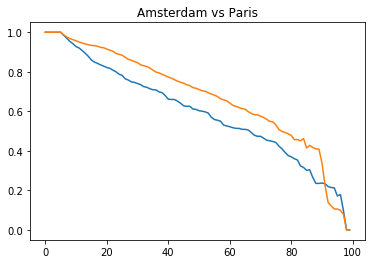

---------------------   Amsterdam  vs.  Porto   ---------------------
Discrete Frechet distance:  1.1302447103957727 



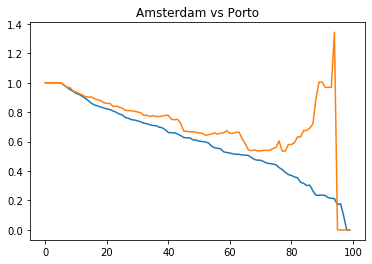

---------------------   Amsterdam  vs.  Prague   ---------------------
Discrete Frechet distance:  0.16216975509913295 



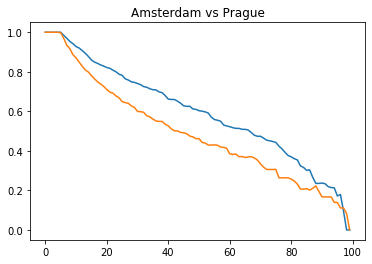

---------------------   Amsterdam  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.24976160295446326 



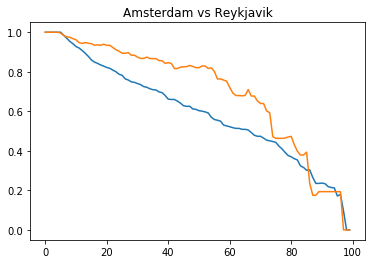

---------------------   Amsterdam  vs.  Riga   ---------------------
Discrete Frechet distance:  0.3210523032298966 



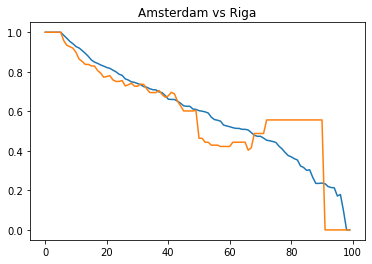

---------------------   Amsterdam  vs.  Rio   ---------------------
Discrete Frechet distance:  1.5435730693520089 



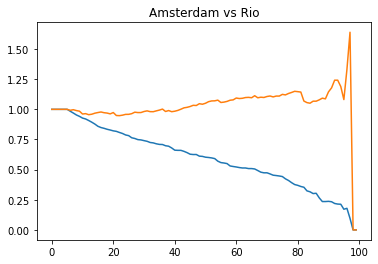

---------------------   Amsterdam  vs.  Rome   ---------------------
Discrete Frechet distance:  0.13367655221822422 



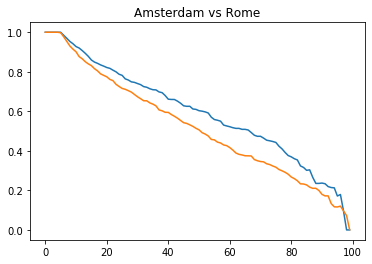

---------------------   Amsterdam  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.7117603856702248 



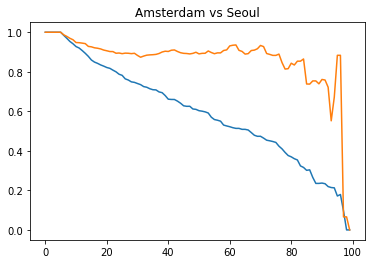

---------------------   Amsterdam  vs.  Siena   ---------------------
Discrete Frechet distance:  0.13999061672059449 



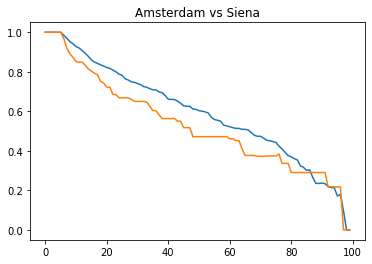

---------------------   Amsterdam  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.19034037077663307 



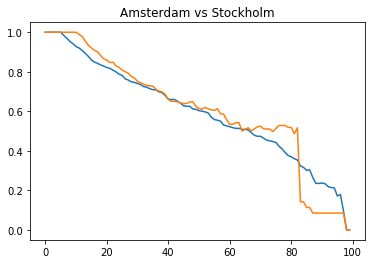

---------------------   Amsterdam  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.8059652952707208 



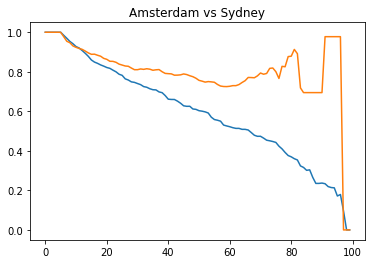

---------------------   Amsterdam  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.14165742439435974 



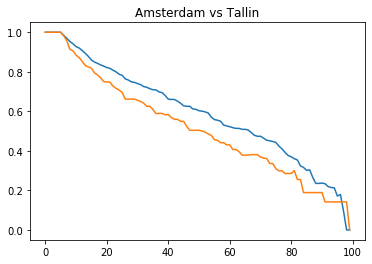

---------------------   Amsterdam  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.31608005703450887 



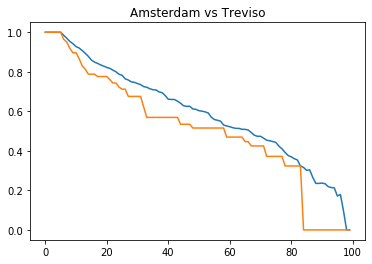

---------------------   Amsterdam  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.14304222100456887 



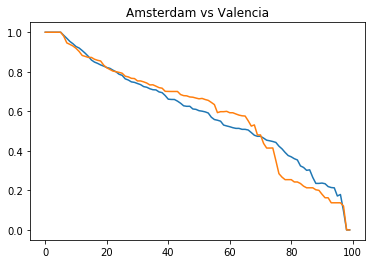

---------------------   Amsterdam  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.2187757254306032 



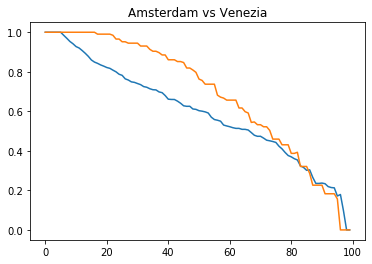

---------------------   Amsterdam  vs.  Verona   ---------------------
Discrete Frechet distance:  0.1587023682425636 



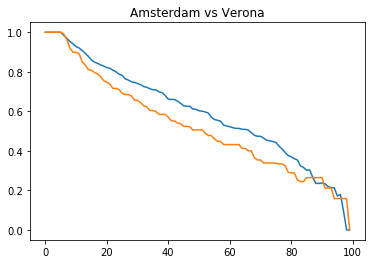

---------------------   Amsterdam  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.19686815852585549 



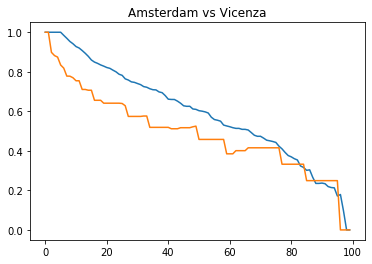

---------------------   Amsterdam  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.6420700108526782 



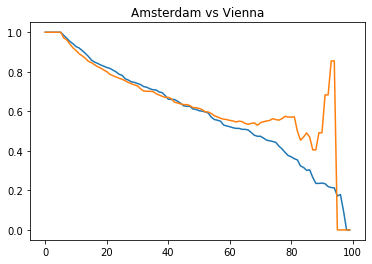

---------------------   Amsterdam  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.2582072447818784 



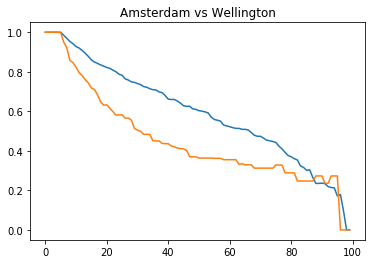

---------------------   Amsterdam  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.27822093569338213 



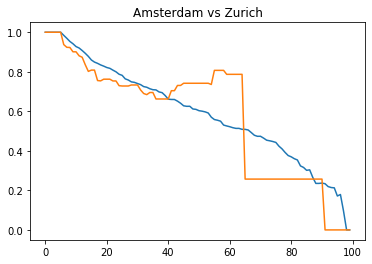

---------------------   Amsterdam  vs.  Milan   ---------------------
Discrete Frechet distance:  0.08278184062774185 



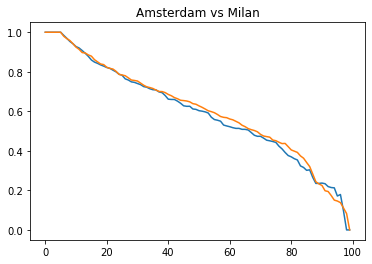

---------------------   Amsterdam  vs.  London   ---------------------
Discrete Frechet distance:  0.11834687349692063 



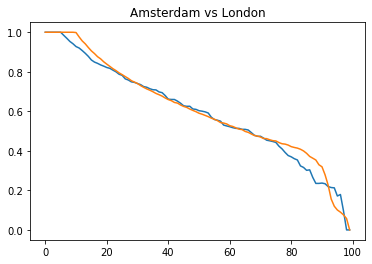

---------------------   Amsterdam  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.4879477517671496 



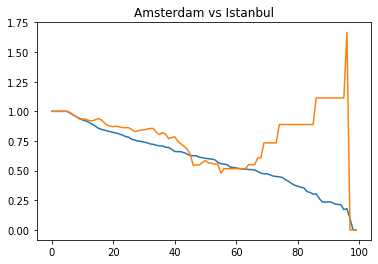

---------------------   Amsterdam  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.32362513132397175 



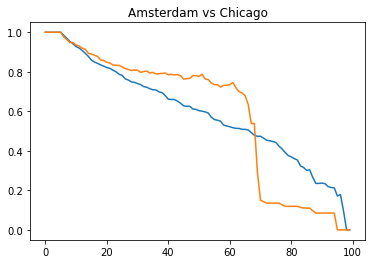

---------------------   Amsterdam  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.20251456668781864 



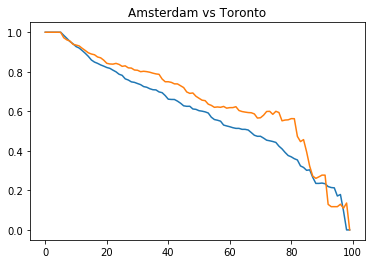

---------------------   Amsterdam  vs.  Munich   ---------------------
Discrete Frechet distance:  0.17653249954782763 



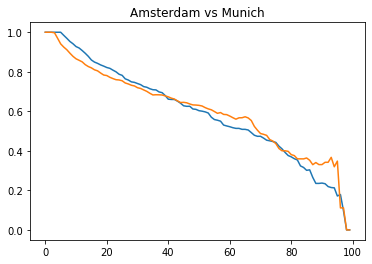

---------------------   Arezzo  vs.  Arezzo   ---------------------
Discrete Frechet distance:  0.0 



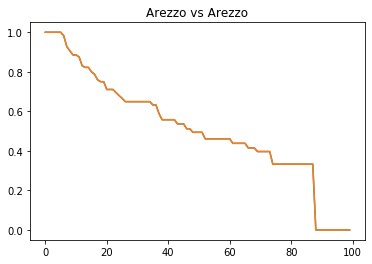

---------------------   Arezzo  vs.  Barcelona   ---------------------
Discrete Frechet distance:  0.33701001624821236 



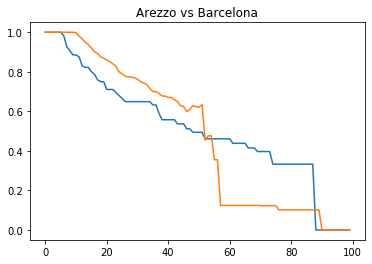

---------------------   Arezzo  vs.  Beijing   ---------------------
Discrete Frechet distance:  0.4380592578921534 



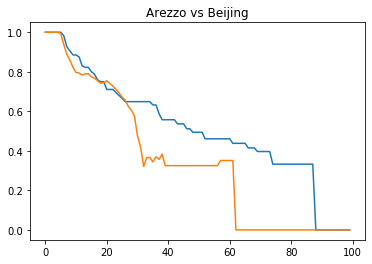

---------------------   Arezzo  vs.  Berlin   ---------------------
Discrete Frechet distance:  0.7141135865816987 



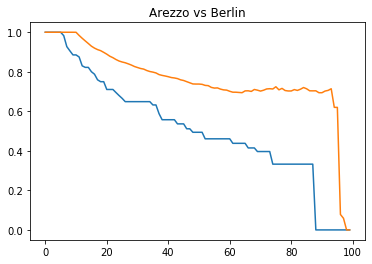

---------------------   Arezzo  vs.  Bologna   ---------------------
Discrete Frechet distance:  0.26416498722833176 



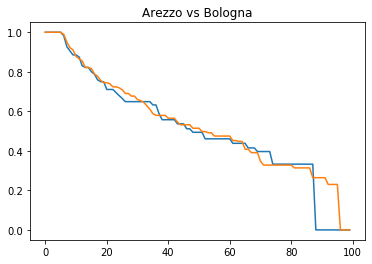

---------------------   Arezzo  vs.  Bordeaux   ---------------------
Discrete Frechet distance:  0.2300119103604309 



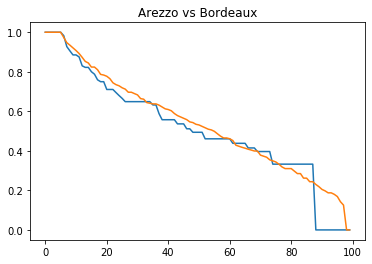

---------------------   Arezzo  vs.  Boston   ---------------------
Discrete Frechet distance:  0.19927143795066096 



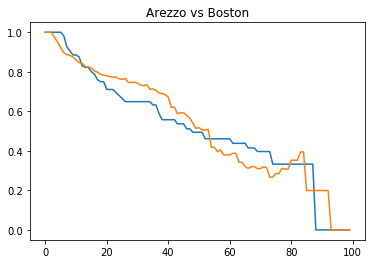

---------------------   Arezzo  vs.  Bremen   ---------------------
Discrete Frechet distance:  1.4629207548535066 



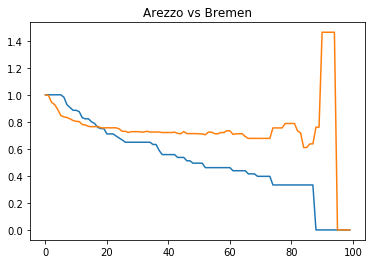

---------------------   Arezzo  vs.  Brno   ---------------------
Discrete Frechet distance:  0.49637978089058 



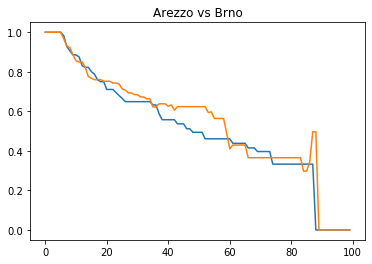

---------------------   Arezzo  vs.  Budapest   ---------------------
Discrete Frechet distance:  0.22560399416654264 



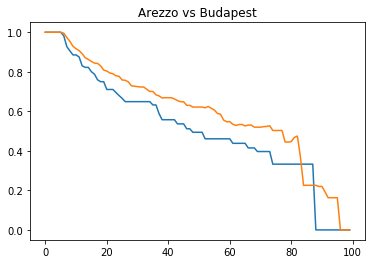

---------------------   Arezzo  vs.  Buenos_Aires   ---------------------
Discrete Frechet distance:  0.47601071960167274 



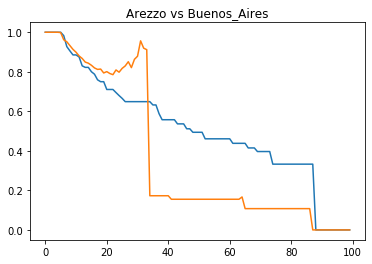

---------------------   Arezzo  vs.  Busan   ---------------------
Discrete Frechet distance:  2.1866352735227927 



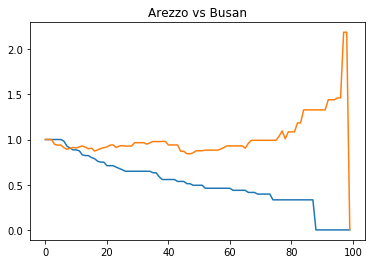

---------------------   Arezzo  vs.  Denver   ---------------------
Discrete Frechet distance:  0.1978516857031274 



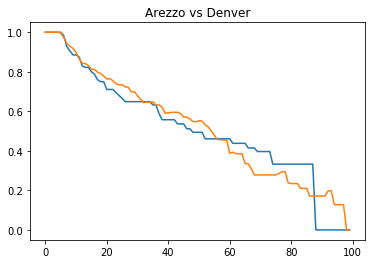

---------------------   Arezzo  vs.  Dublin   ---------------------
Discrete Frechet distance:  0.3676371271195406 



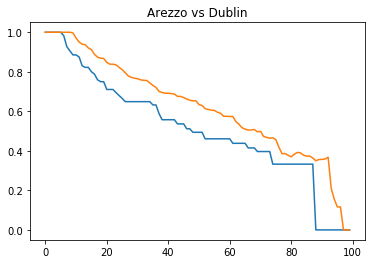

---------------------   Arezzo  vs.  Edinburgh   ---------------------
Discrete Frechet distance:  0.44072086207282996 



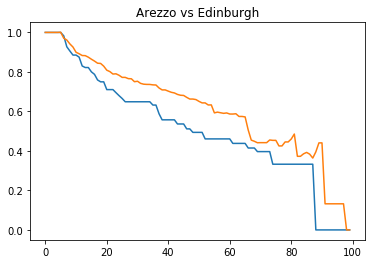

---------------------   Arezzo  vs.  Florence   ---------------------
Discrete Frechet distance:  0.2741662679804937 



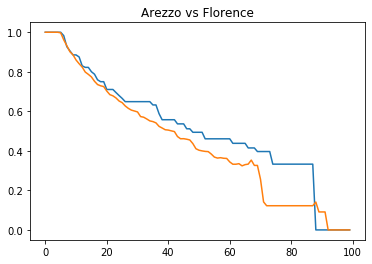

---------------------   Arezzo  vs.  Los_Angeles   ---------------------
Discrete Frechet distance:  0.3200018255194473 



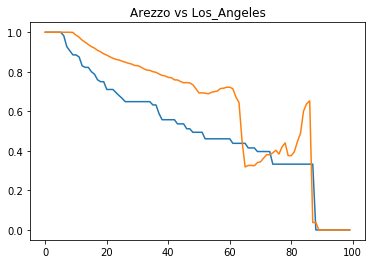

---------------------   Arezzo  vs.  Lyon   ---------------------
Discrete Frechet distance:  0.23017057074330372 



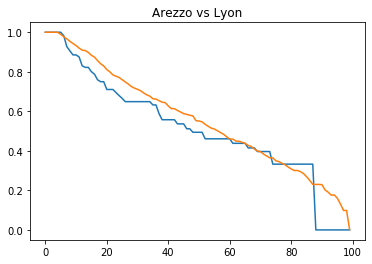

---------------------   Arezzo  vs.  Madrid   ---------------------
Discrete Frechet distance:  0.19277798318706907 



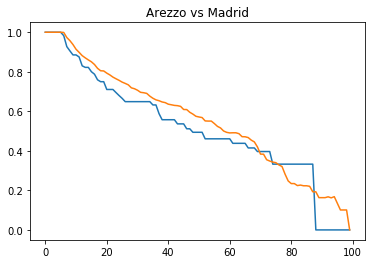

---------------------   Arezzo  vs.  Moscow   ---------------------
Discrete Frechet distance:  0.3326854866904326 



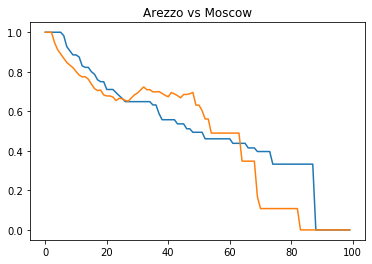

---------------------   Arezzo  vs.  Palermo   ---------------------
Discrete Frechet distance:  1.011525905917469 



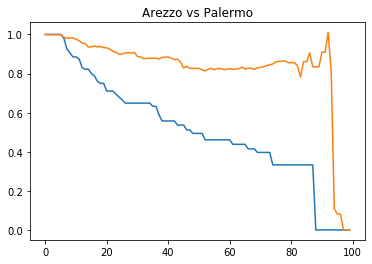

---------------------   Arezzo  vs.  Paris   ---------------------
Discrete Frechet distance:  0.4097173313496075 



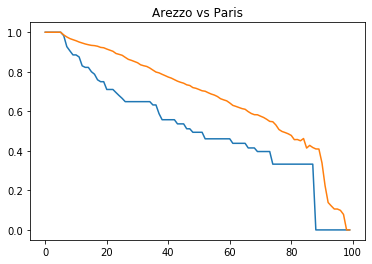

---------------------   Arezzo  vs.  Porto   ---------------------
Discrete Frechet distance:  1.3430873083731827 



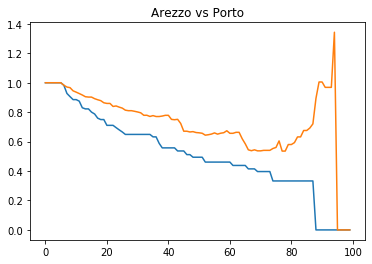

---------------------   Arezzo  vs.  Prague   ---------------------
Discrete Frechet distance:  0.22254563592163915 



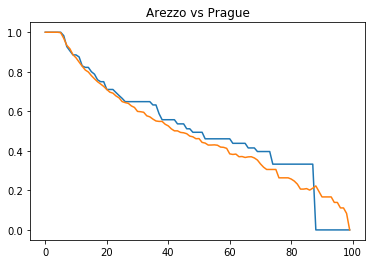

---------------------   Arezzo  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.3684460711403446 



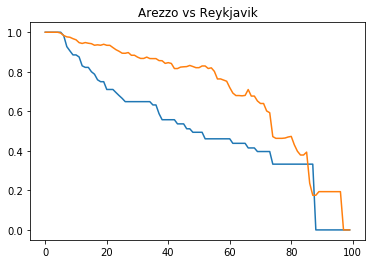

---------------------   Arezzo  vs.  Riga   ---------------------
Discrete Frechet distance:  0.5563612798024404 



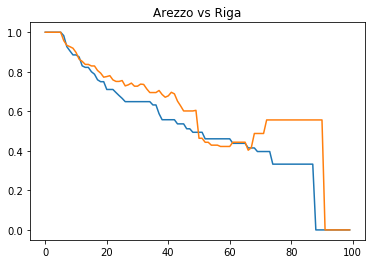

---------------------   Arezzo  vs.  Rio   ---------------------
Discrete Frechet distance:  1.639445486183051 



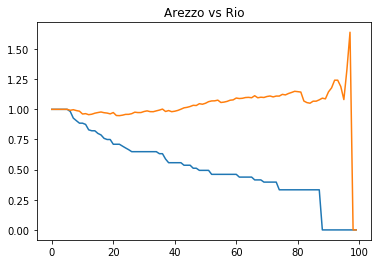

---------------------   Arezzo  vs.  Rome   ---------------------
Discrete Frechet distance:  0.21072137754091896 



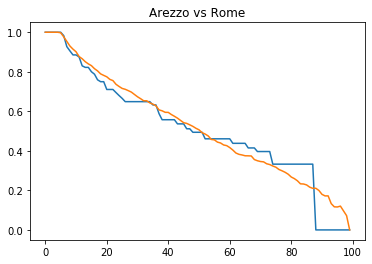

---------------------   Arezzo  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.8833447012990394 



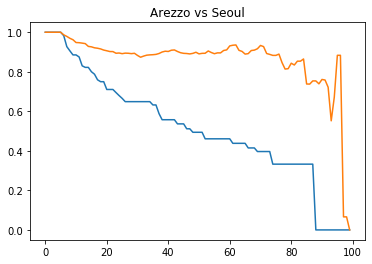

---------------------   Arezzo  vs.  Siena   ---------------------
Discrete Frechet distance:  0.29024749433081465 



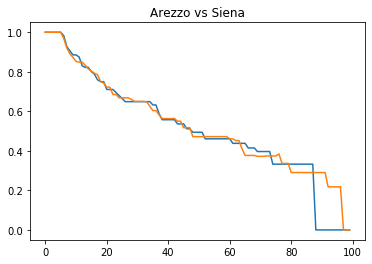

---------------------   Arezzo  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.2475287006052048 



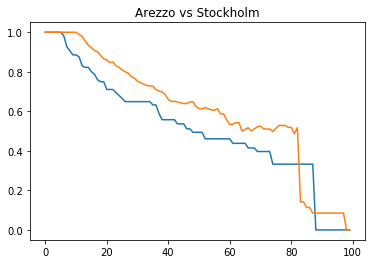

---------------------   Arezzo  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.9775496108995354 



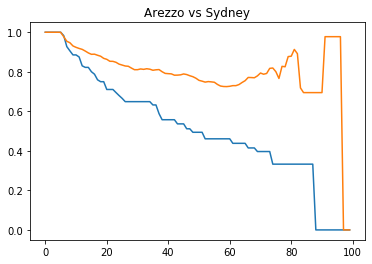

---------------------   Arezzo  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.18887656585922125 



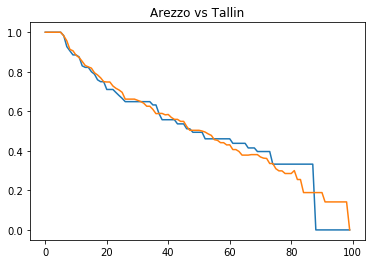

---------------------   Arezzo  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.3326854866904326 



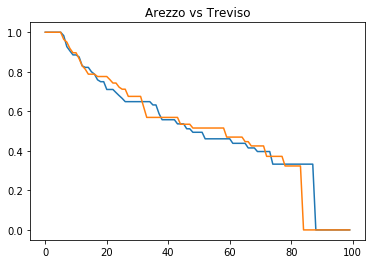

---------------------   Arezzo  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.20308192412804946 



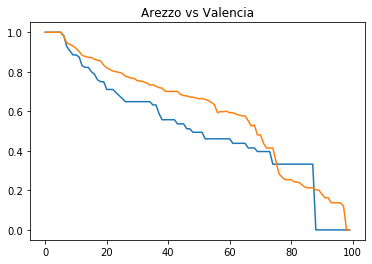

---------------------   Arezzo  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.32771069352017035 



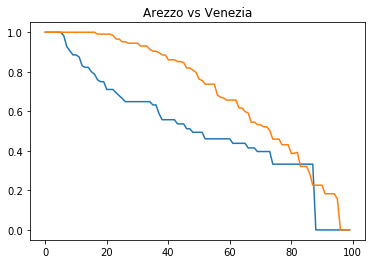

---------------------   Arezzo  vs.  Verona   ---------------------
Discrete Frechet distance:  0.2645039470710336 



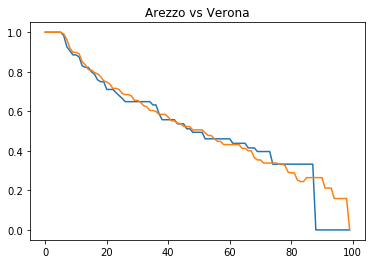

---------------------   Arezzo  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.24926778410034237 



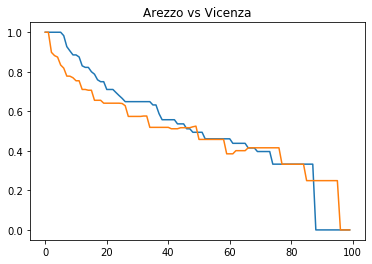

---------------------   Arezzo  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.8549126088300883 



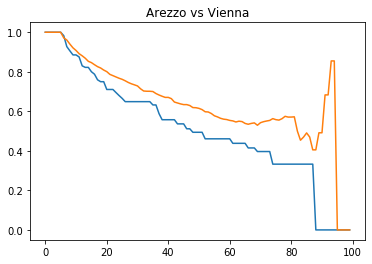

---------------------   Arezzo  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.2729872854290622 



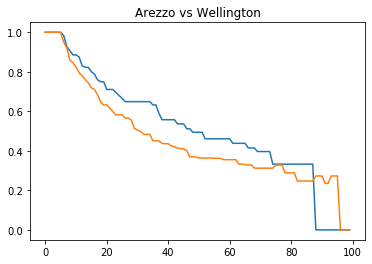

---------------------   Arezzo  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.3490187732839809 



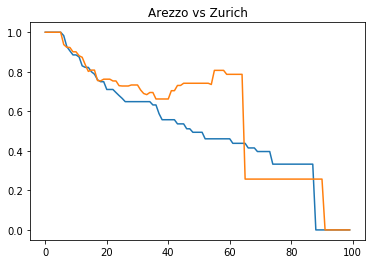

---------------------   Arezzo  vs.  Milan   ---------------------
Discrete Frechet distance:  0.24378419077091137 



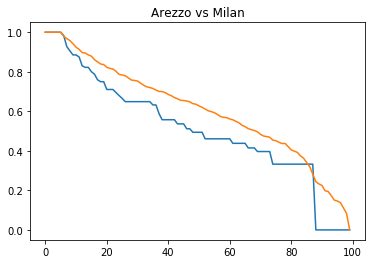

---------------------   Arezzo  vs.  London   ---------------------
Discrete Frechet distance:  0.3536558500694645 



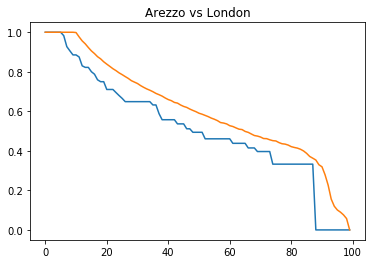

---------------------   Arezzo  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.6670520643678925 



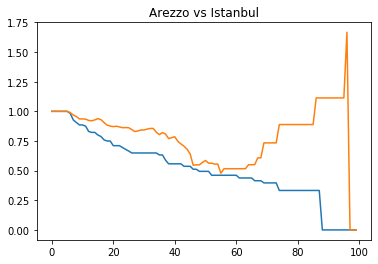

---------------------   Arezzo  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.3080119523044934 



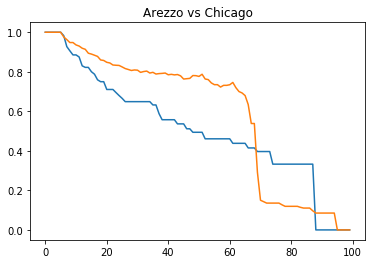

---------------------   Arezzo  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.2771986325114767 



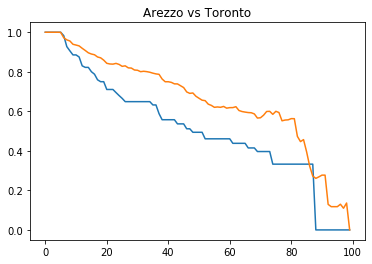

---------------------   Arezzo  vs.  Munich   ---------------------
Discrete Frechet distance:  0.3671130278414978 



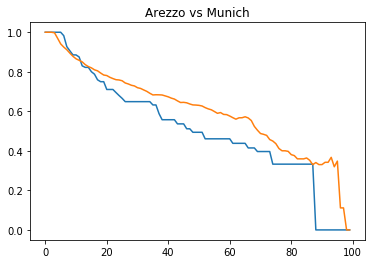

---------------------   Barcelona  vs.  Barcelona   ---------------------
Discrete Frechet distance:  0.0 



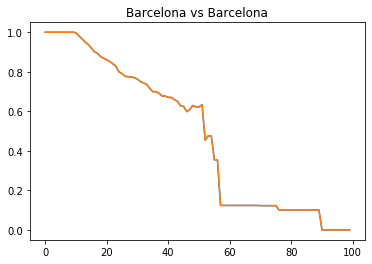

---------------------   Barcelona  vs.  Beijing   ---------------------
Discrete Frechet distance:  0.422471516917734 



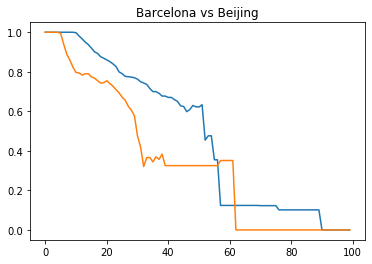

---------------------   Barcelona  vs.  Berlin   ---------------------
Discrete Frechet distance:  0.7141135865816987 



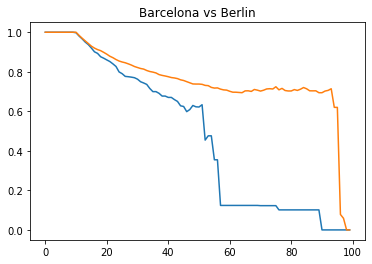

---------------------   Barcelona  vs.  Bologna   ---------------------
Discrete Frechet distance:  0.35101140452062957 



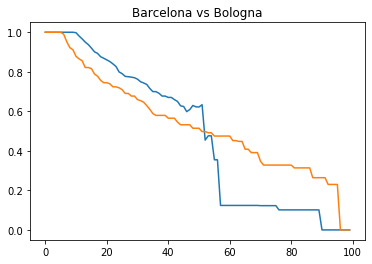

---------------------   Barcelona  vs.  Bordeaux   ---------------------
Discrete Frechet distance:  0.3503864391530697 



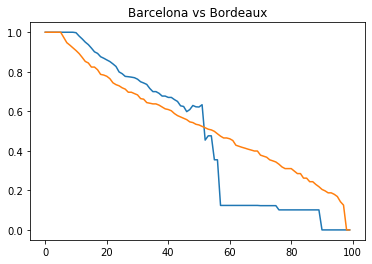

---------------------   Barcelona  vs.  Boston   ---------------------
Discrete Frechet distance:  0.2931062205088295 



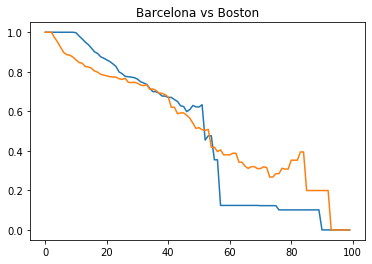

---------------------   Barcelona  vs.  Bremen   ---------------------
Discrete Frechet distance:  1.4629207548535066 



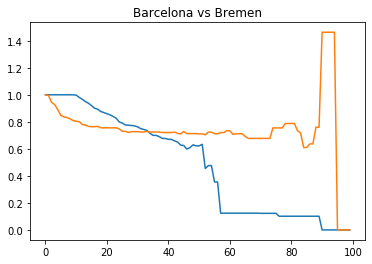

---------------------   Barcelona  vs.  Brno   ---------------------
Discrete Frechet distance:  0.4398935519187294 



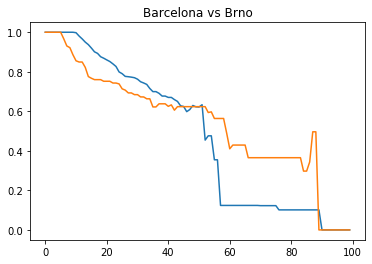

---------------------   Barcelona  vs.  Budapest   ---------------------
Discrete Frechet distance:  0.46099673300338345 



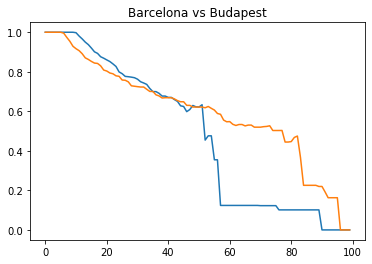

---------------------   Barcelona  vs.  Buenos_Aires   ---------------------
Discrete Frechet distance:  0.5425222187232548 



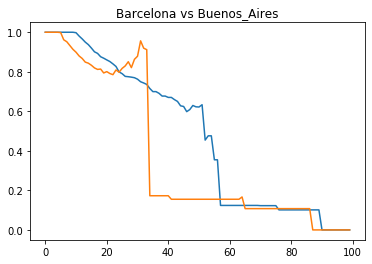

---------------------   Barcelona  vs.  Busan   ---------------------
Discrete Frechet distance:  2.1866352735227927 



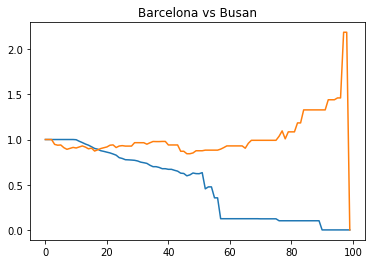

---------------------   Barcelona  vs.  Denver   ---------------------
Discrete Frechet distance:  0.33306216654263204 



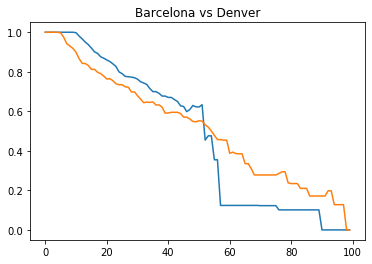

---------------------   Barcelona  vs.  Dublin   ---------------------
Discrete Frechet distance:  0.4661955133982339 



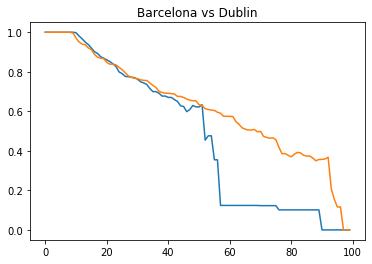

---------------------   Barcelona  vs.  Edinburgh   ---------------------
Discrete Frechet distance:  0.469432135792007 



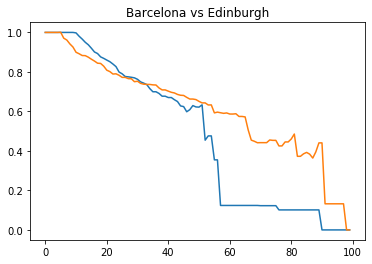

---------------------   Barcelona  vs.  Florence   ---------------------
Discrete Frechet distance:  0.2415009910912499 



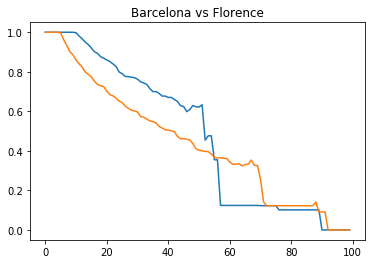

---------------------   Barcelona  vs.  Los_Angeles   ---------------------
Discrete Frechet distance:  0.5982620884695344 



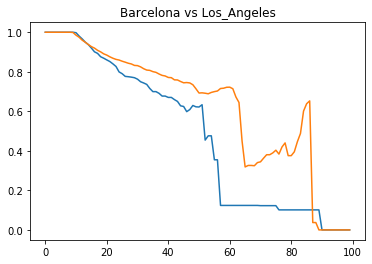

---------------------   Barcelona  vs.  Lyon   ---------------------
Discrete Frechet distance:  0.3687782526616597 



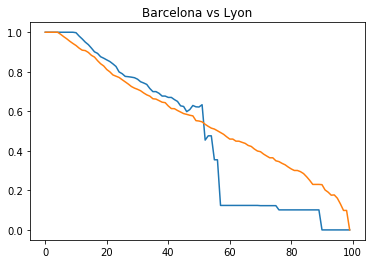

---------------------   Barcelona  vs.  Madrid   ---------------------
Discrete Frechet distance:  0.3919557957235839 



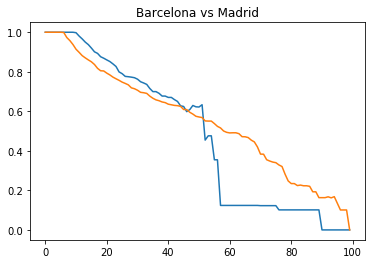

---------------------   Barcelona  vs.  Moscow   ---------------------
Discrete Frechet distance:  0.3659074754627834 



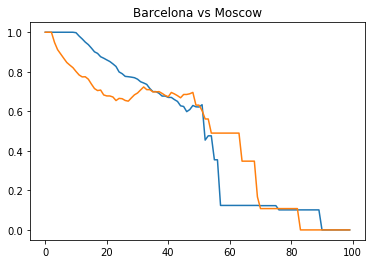

---------------------   Barcelona  vs.  Palermo   ---------------------
Discrete Frechet distance:  1.011525905917469 



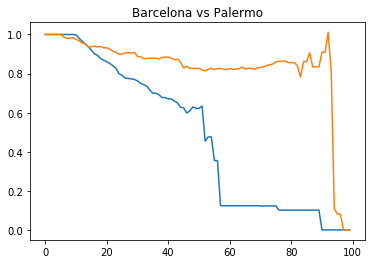

---------------------   Barcelona  vs.  Paris   ---------------------
Discrete Frechet distance:  0.5398846562794655 



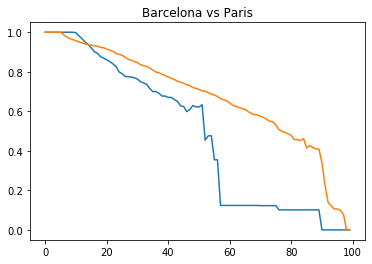

---------------------   Barcelona  vs.  Porto   ---------------------
Discrete Frechet distance:  1.3430873083731827 



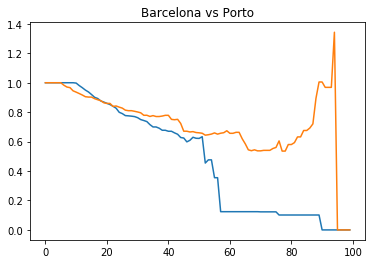

---------------------   Barcelona  vs.  Prague   ---------------------
Discrete Frechet distance:  0.29520725488144595 



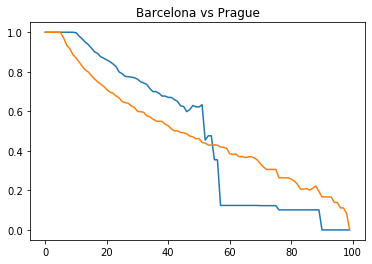

---------------------   Barcelona  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.6400723310853906 



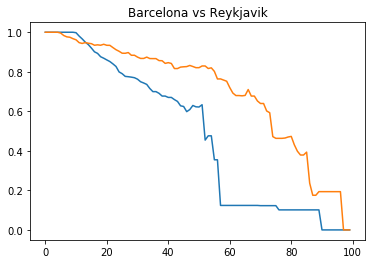

---------------------   Barcelona  vs.  Riga   ---------------------
Discrete Frechet distance:  0.5563612798024404 



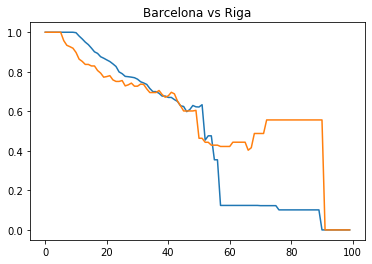

---------------------   Barcelona  vs.  Rio   ---------------------
Discrete Frechet distance:  1.639445486183051 



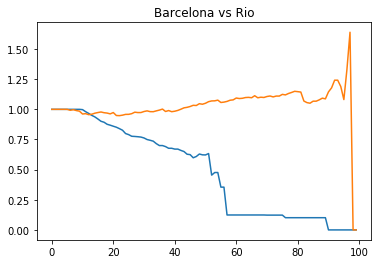

---------------------   Barcelona  vs.  Rome   ---------------------
Discrete Frechet distance:  0.31601850346366644 



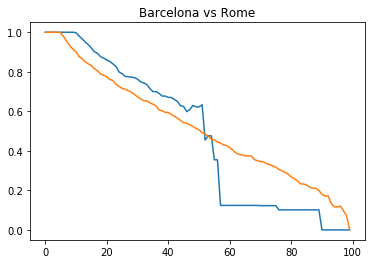

---------------------   Barcelona  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.8833447012990394 



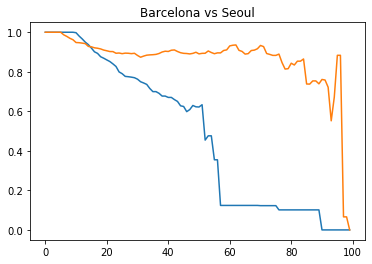

---------------------   Barcelona  vs.  Siena   ---------------------
Discrete Frechet distance:  0.34797245178013214 



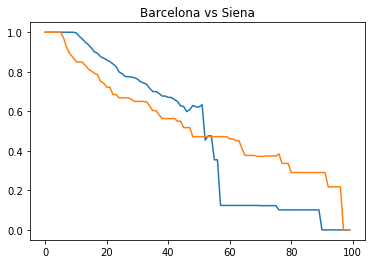

---------------------   Barcelona  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.4631980993738361 



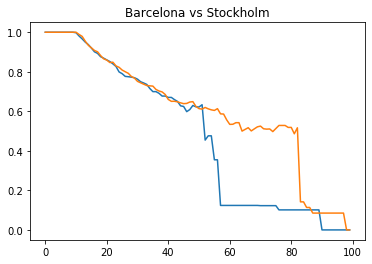

---------------------   Barcelona  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.9775496108995354 



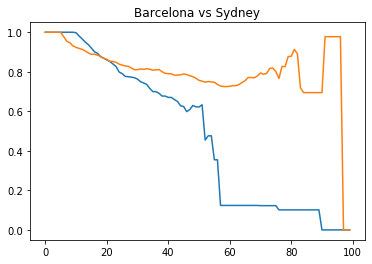

---------------------   Barcelona  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.3174780524326591 



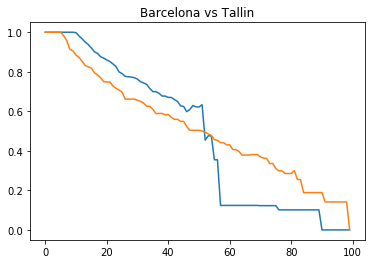

---------------------   Barcelona  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.39160532059502334 



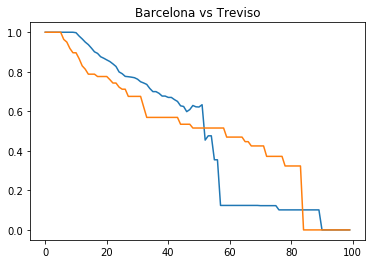

---------------------   Barcelona  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.4759758532495649 



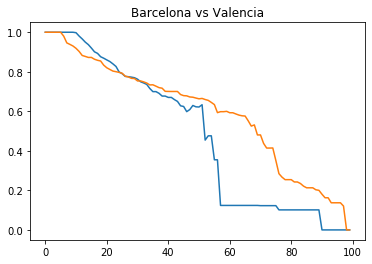

---------------------   Barcelona  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.5478400980298068 



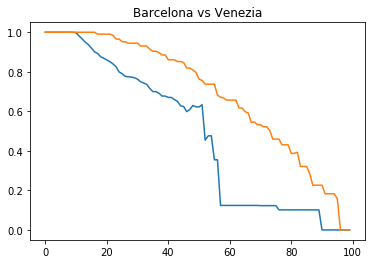

---------------------   Barcelona  vs.  Verona   ---------------------
Discrete Frechet distance:  0.3241722925722653 



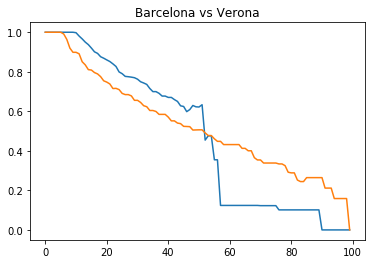

---------------------   Barcelona  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.33393823543350876 



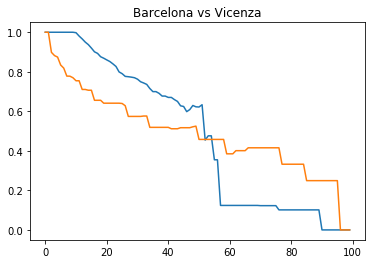

---------------------   Barcelona  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.8549126088300883 



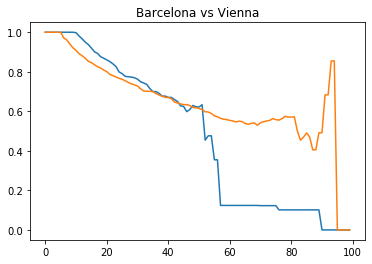

---------------------   Barcelona  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.2729872854290622 



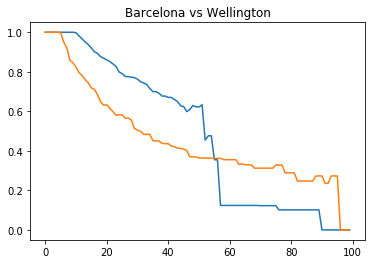

---------------------   Barcelona  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.6833003179852639 



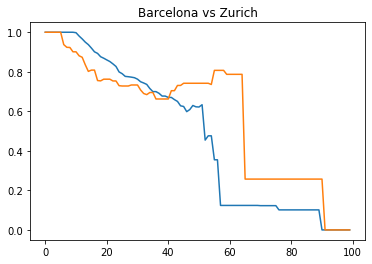

---------------------   Barcelona  vs.  Milan   ---------------------
Discrete Frechet distance:  0.4499012777179759 



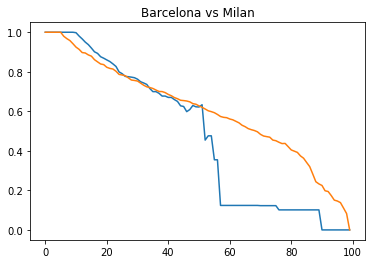

---------------------   Barcelona  vs.  London   ---------------------
Discrete Frechet distance:  0.41926253498632576 



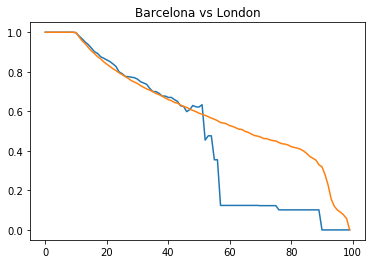

---------------------   Barcelona  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.6670520643678925 



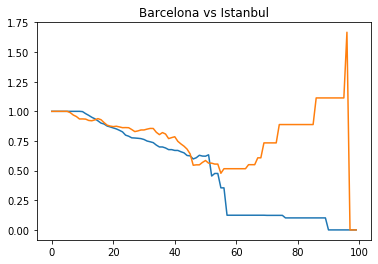

---------------------   Barcelona  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.6222019744254248 



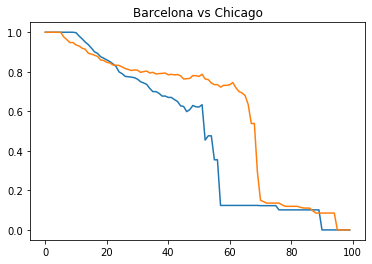

---------------------   Barcelona  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.5007864321977757 



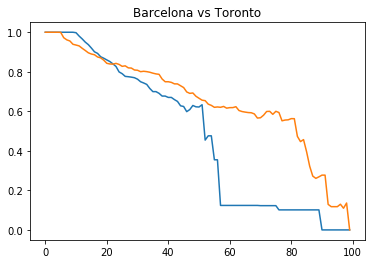

---------------------   Barcelona  vs.  Munich   ---------------------
Discrete Frechet distance:  0.4698355181542028 



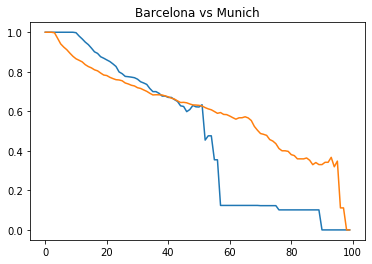

---------------------   Beijing  vs.  Beijing   ---------------------
Discrete Frechet distance:  0.0 



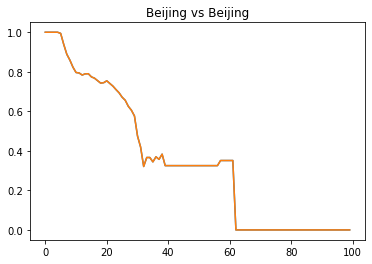

---------------------   Beijing  vs.  Berlin   ---------------------
Discrete Frechet distance:  0.7242287359621051 



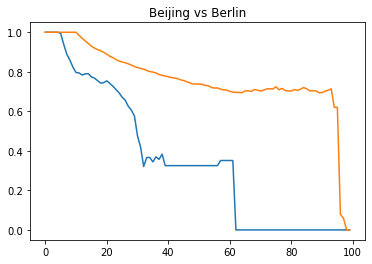

---------------------   Beijing  vs.  Bologna   ---------------------
Discrete Frechet distance:  0.4517037956615158 



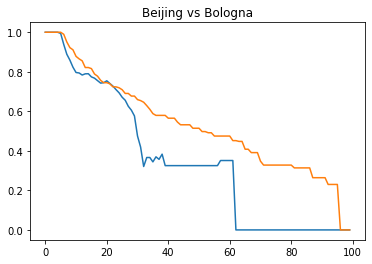

---------------------   Beijing  vs.  Bordeaux   ---------------------
Discrete Frechet distance:  0.4284370225640341 



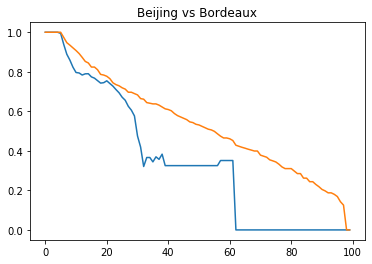

---------------------   Beijing  vs.  Boston   ---------------------
Discrete Frechet distance:  0.40882001742128227 



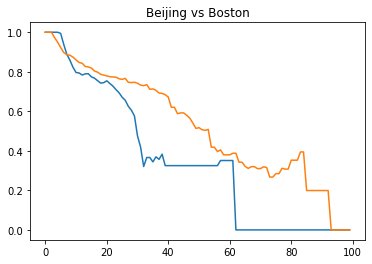

---------------------   Beijing  vs.  Bremen   ---------------------
Discrete Frechet distance:  1.4629207548535066 



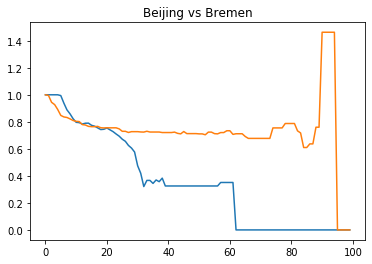

---------------------   Beijing  vs.  Brno   ---------------------
Discrete Frechet distance:  0.49637978089058 



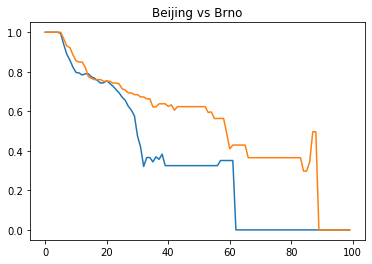

---------------------   Beijing  vs.  Budapest   ---------------------
Discrete Frechet distance:  0.5332801969143562 



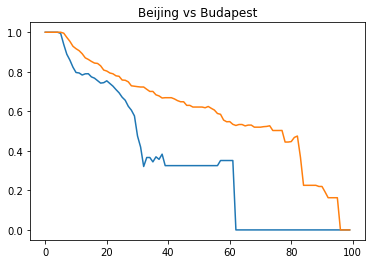

---------------------   Beijing  vs.  Buenos_Aires   ---------------------
Discrete Frechet distance:  0.5986985487958267 



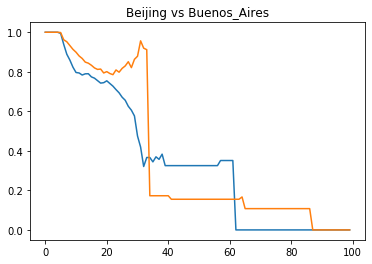

---------------------   Beijing  vs.  Busan   ---------------------
Discrete Frechet distance:  2.1866352735227927 



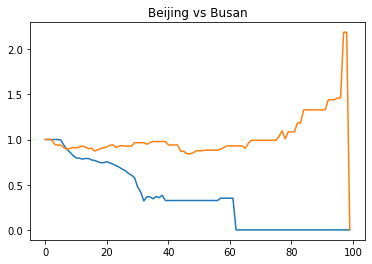

---------------------   Beijing  vs.  Denver   ---------------------
Discrete Frechet distance:  0.38610591943526706 



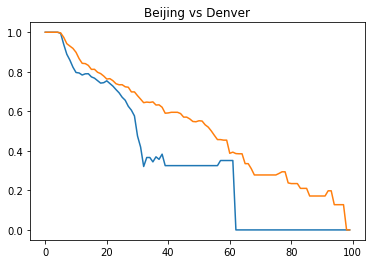

---------------------   Beijing  vs.  Dublin   ---------------------
Discrete Frechet distance:  0.54790022902097 



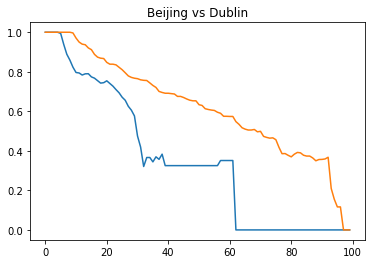

---------------------   Beijing  vs.  Edinburgh   ---------------------
Discrete Frechet distance:  0.5882027734200718 



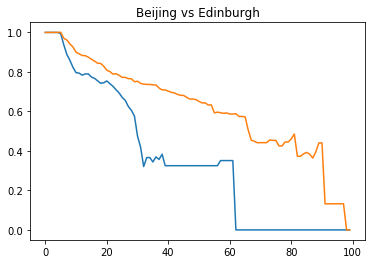

---------------------   Beijing  vs.  Florence   ---------------------
Discrete Frechet distance:  0.3532390889347729 



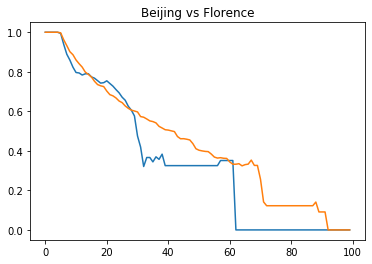

---------------------   Beijing  vs.  Los_Angeles   ---------------------
Discrete Frechet distance:  0.6726573469472895 



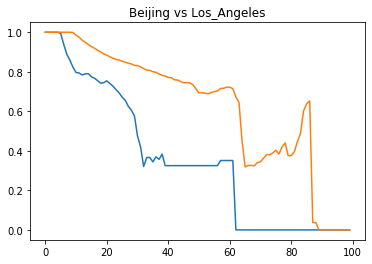

---------------------   Beijing  vs.  Lyon   ---------------------
Discrete Frechet distance:  0.44911978318651585 



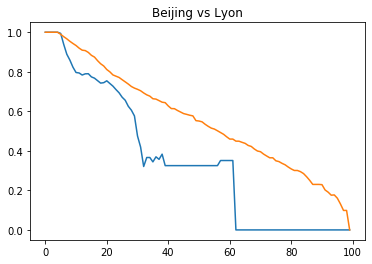

---------------------   Beijing  vs.  Madrid   ---------------------
Discrete Frechet distance:  0.491372908544716 



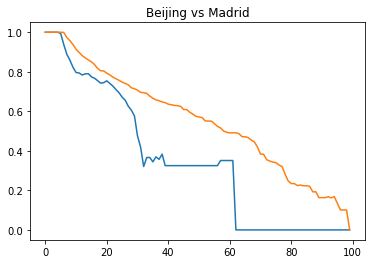

---------------------   Beijing  vs.  Moscow   ---------------------
Discrete Frechet distance:  0.48977671123400535 



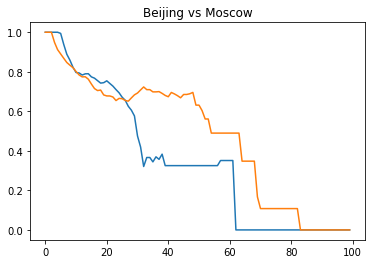

---------------------   Beijing  vs.  Palermo   ---------------------
Discrete Frechet distance:  1.011525905917469 



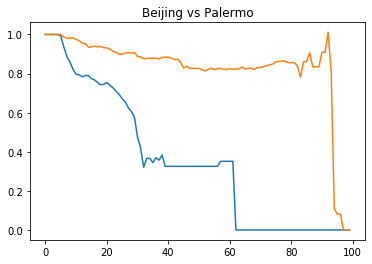

---------------------   Beijing  vs.  Paris   ---------------------
Discrete Frechet distance:  0.6248935172701731 



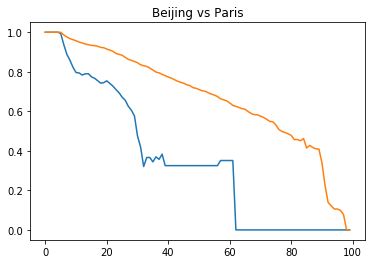

---------------------   Beijing  vs.  Porto   ---------------------
Discrete Frechet distance:  1.3430873083731827 



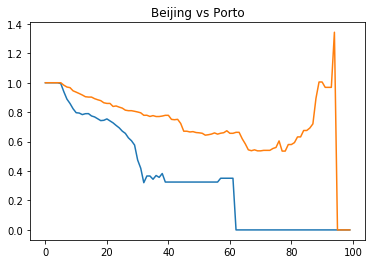

---------------------   Beijing  vs.  Prague   ---------------------
Discrete Frechet distance:  0.3835428010740201 



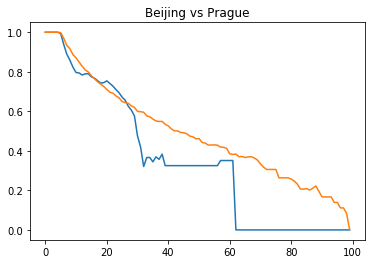

---------------------   Beijing  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.7101389879580936 



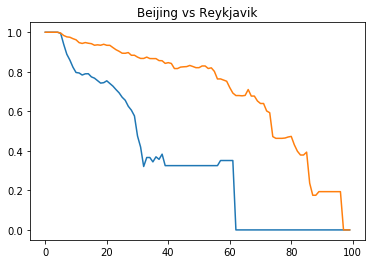

---------------------   Beijing  vs.  Riga   ---------------------
Discrete Frechet distance:  0.5563612798024404 



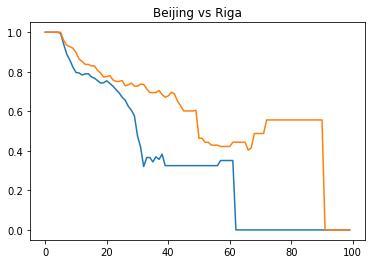

---------------------   Beijing  vs.  Rio   ---------------------
Discrete Frechet distance:  1.639445486183051 



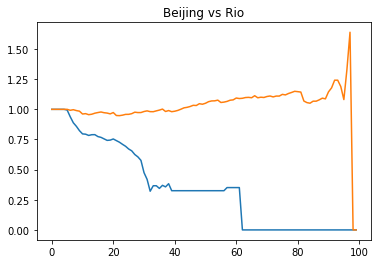

---------------------   Beijing  vs.  Rome   ---------------------
Discrete Frechet distance:  0.3890668116724783 



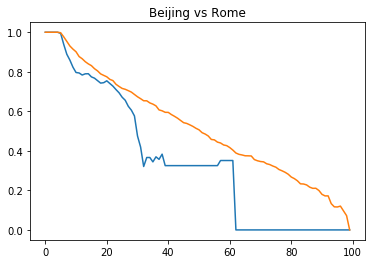

---------------------   Beijing  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.9357491556784816 



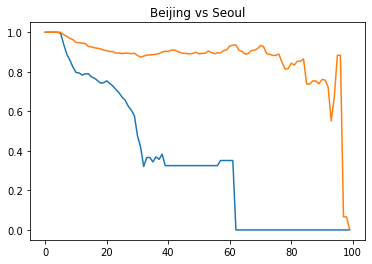

---------------------   Beijing  vs.  Siena   ---------------------
Discrete Frechet distance:  0.45179164227569263 



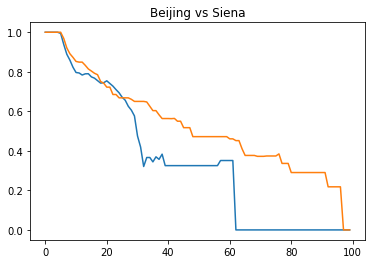

---------------------   Beijing  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.5424971549574292 



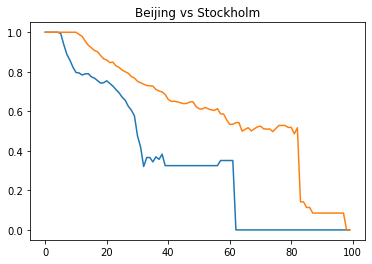

---------------------   Beijing  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.9775496108995354 



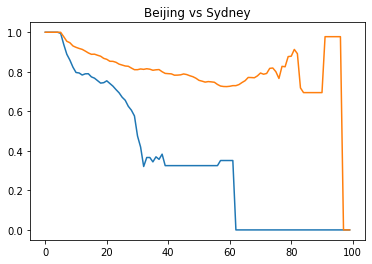

---------------------   Beijing  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.40645300593610506 



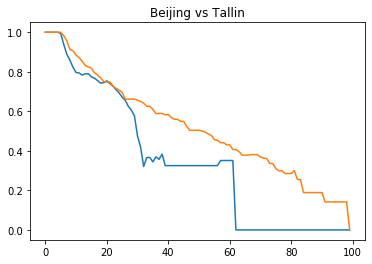

---------------------   Beijing  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.4695791824523047 



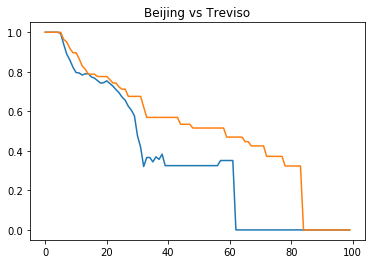

---------------------   Beijing  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.5865475575953805 



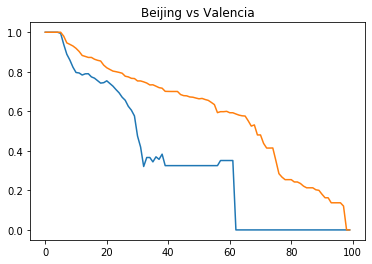

---------------------   Beijing  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.656650370883064 



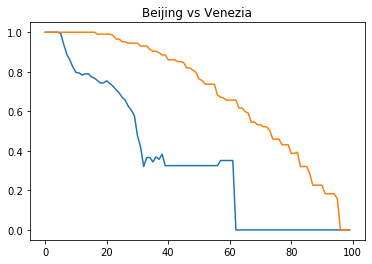

---------------------   Beijing  vs.  Verona   ---------------------
Discrete Frechet distance:  0.43171251610063854 



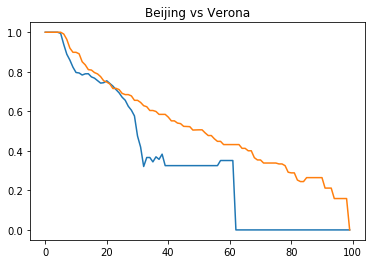

---------------------   Beijing  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.41544630683390393 



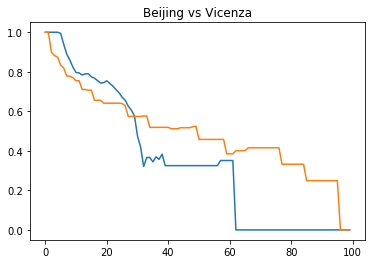

---------------------   Beijing  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.8549126088300883 



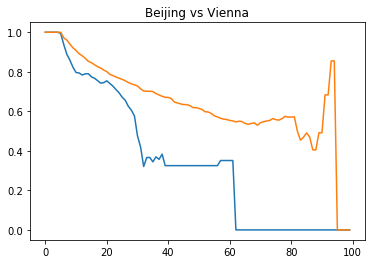

---------------------   Beijing  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.3551698037751094 



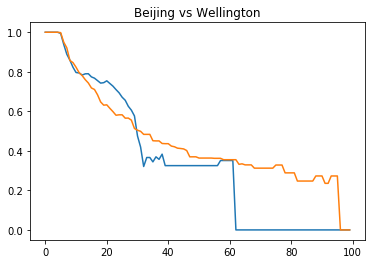

---------------------   Beijing  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.7870780311761343 



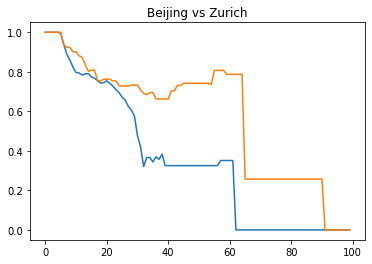

---------------------   Beijing  vs.  Milan   ---------------------
Discrete Frechet distance:  0.5493869127597876 



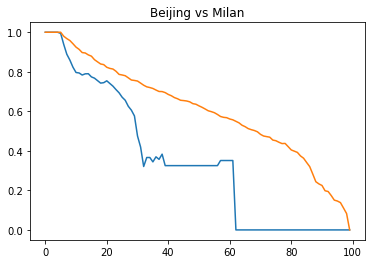

---------------------   Beijing  vs.  London   ---------------------
Discrete Frechet distance:  0.5162886580150056 



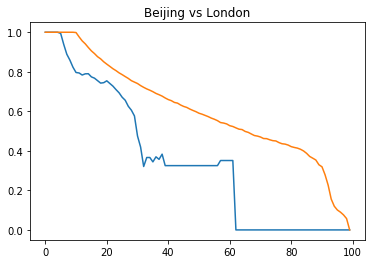

---------------------   Beijing  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.6670520643678925 



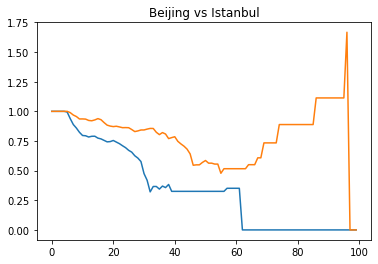

---------------------   Beijing  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.7195478044713369 



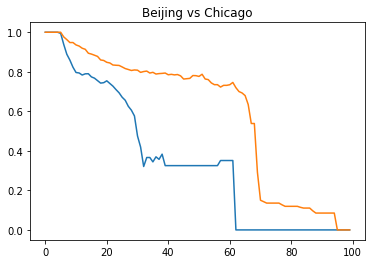

---------------------   Beijing  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.6232751138780047 



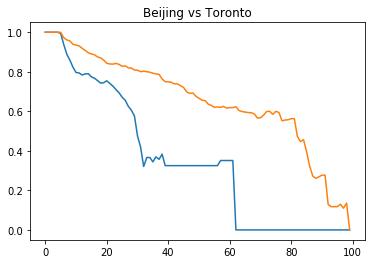

---------------------   Beijing  vs.  Munich   ---------------------
Discrete Frechet distance:  0.5723661009957736 



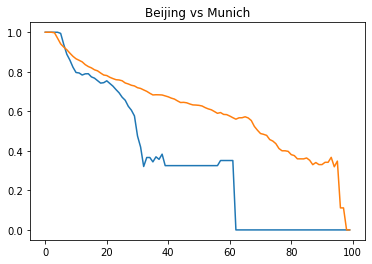

---------------------   Berlin  vs.  Berlin   ---------------------
Discrete Frechet distance:  0.0 



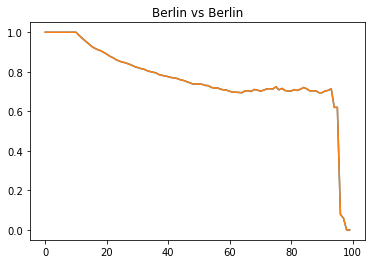

---------------------   Berlin  vs.  Bologna   ---------------------
Discrete Frechet distance:  0.4840647497670131 



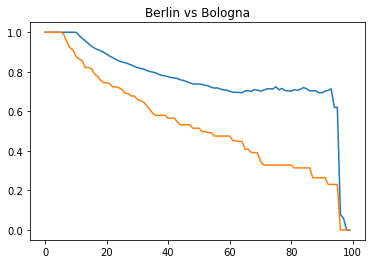

---------------------   Berlin  vs.  Bordeaux   ---------------------
Discrete Frechet distance:  0.5265589135899024 



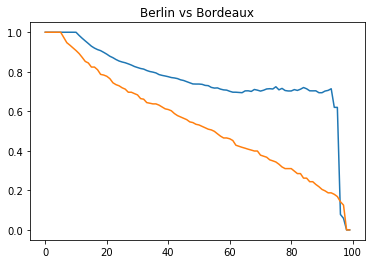

---------------------   Berlin  vs.  Boston   ---------------------
Discrete Frechet distance:  0.7141135865816987 



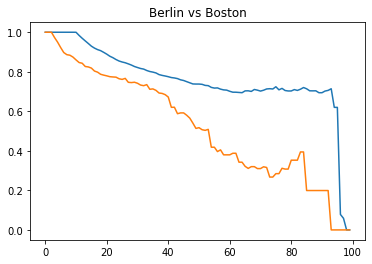

---------------------   Berlin  vs.  Bremen   ---------------------
Discrete Frechet distance:  0.8429692089586858 



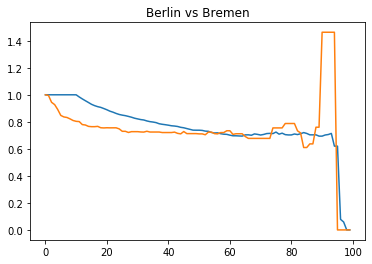

---------------------   Berlin  vs.  Brno   ---------------------
Discrete Frechet distance:  0.7141135865816987 



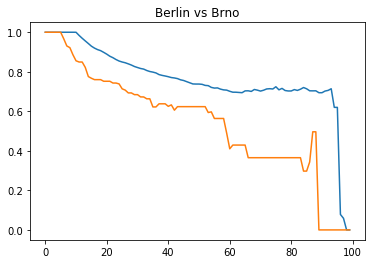

---------------------   Berlin  vs.  Budapest   ---------------------
Discrete Frechet distance:  0.5512592629326692 



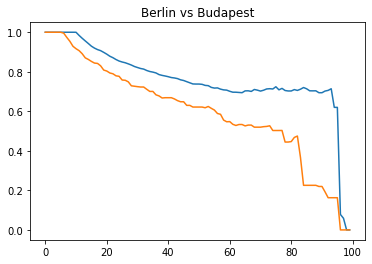

---------------------   Berlin  vs.  Buenos_Aires   ---------------------
Discrete Frechet distance:  0.7141135865816987 



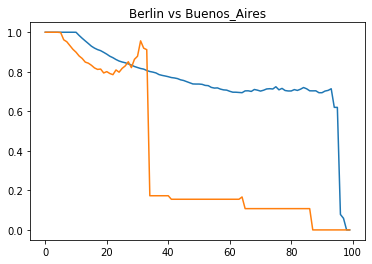

---------------------   Berlin  vs.  Busan   ---------------------
Discrete Frechet distance:  2.1866352735227927 



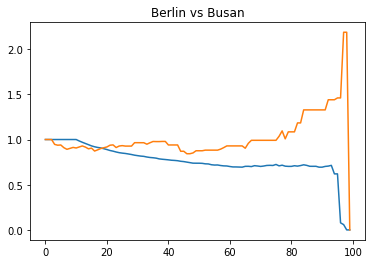

---------------------   Berlin  vs.  Denver   ---------------------
Discrete Frechet distance:  0.5321903942928454 



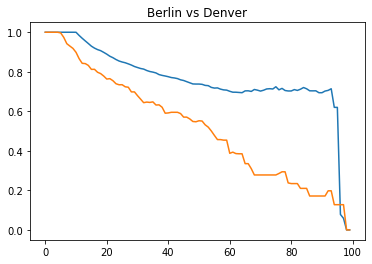

---------------------   Berlin  vs.  Dublin   ---------------------
Discrete Frechet distance:  0.5043536478148354 



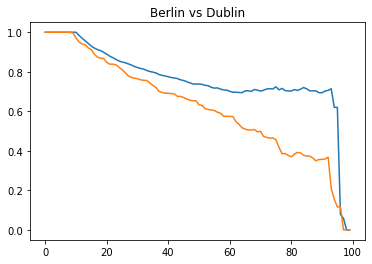

---------------------   Berlin  vs.  Edinburgh   ---------------------
Discrete Frechet distance:  0.5818973279598338 



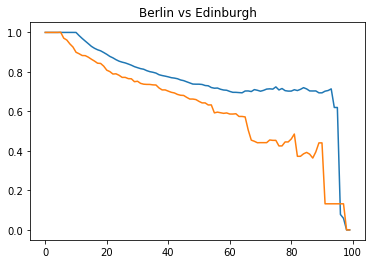

---------------------   Berlin  vs.  Florence   ---------------------
Discrete Frechet distance:  0.7141135865816987 



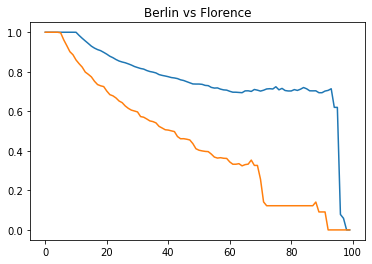

---------------------   Berlin  vs.  Los_Angeles   ---------------------
Discrete Frechet distance:  0.7141135865816987 



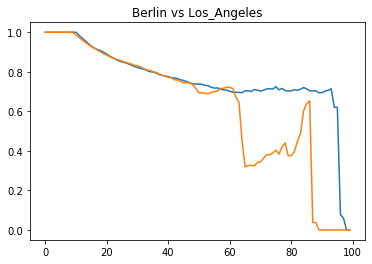

---------------------   Berlin  vs.  Lyon   ---------------------
Discrete Frechet distance:  0.5383817243759321 



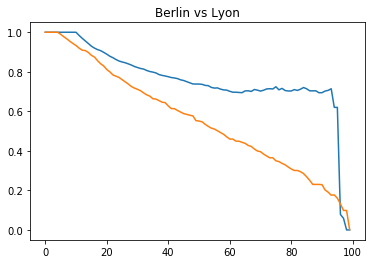

---------------------   Berlin  vs.  Madrid   ---------------------
Discrete Frechet distance:  0.5519188634883077 



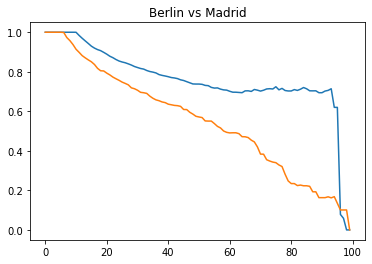

---------------------   Berlin  vs.  Moscow   ---------------------
Discrete Frechet distance:  0.7203314046483233 



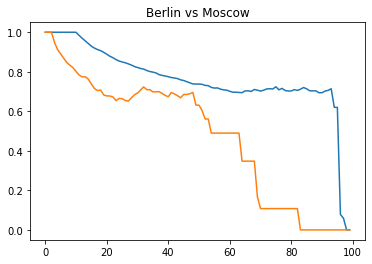

---------------------   Berlin  vs.  Palermo   ---------------------
Discrete Frechet distance:  0.5389978096498974 



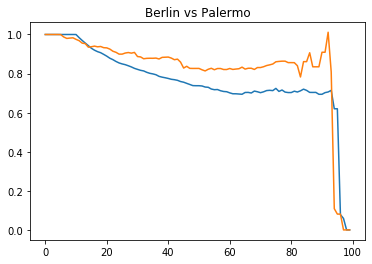

---------------------   Berlin  vs.  Paris   ---------------------
Discrete Frechet distance:  0.5925446659392141 



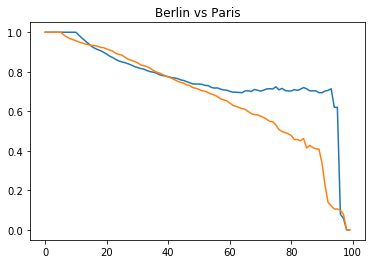

---------------------   Berlin  vs.  Porto   ---------------------
Discrete Frechet distance:  0.7231357624783619 



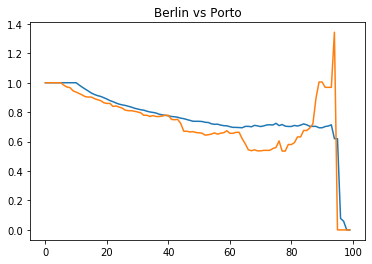

---------------------   Berlin  vs.  Prague   ---------------------
Discrete Frechet distance:  0.5472043596404679 



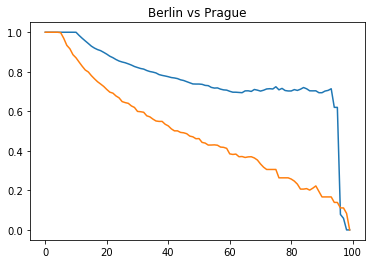

---------------------   Berlin  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.5284059807884984 



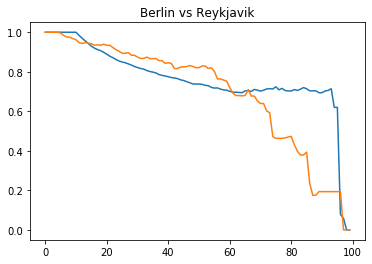

---------------------   Berlin  vs.  Riga   ---------------------
Discrete Frechet distance:  0.7141135865816987 



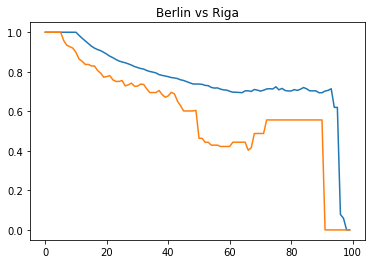

---------------------   Berlin  vs.  Rio   ---------------------
Discrete Frechet distance:  1.5807748399241188 



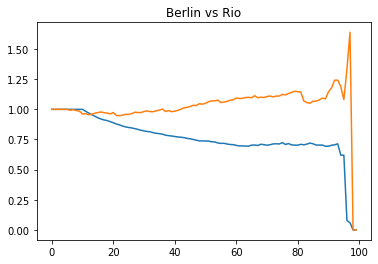

---------------------   Berlin  vs.  Rome   ---------------------
Discrete Frechet distance:  0.5810963707035202 



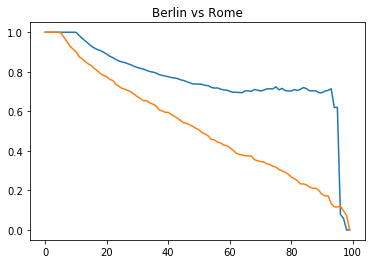

---------------------   Berlin  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.805117172953812 



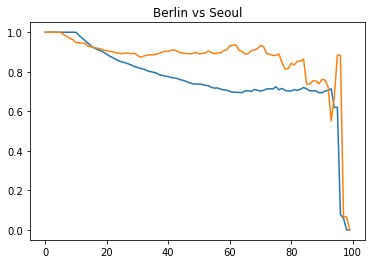

---------------------   Berlin  vs.  Siena   ---------------------
Discrete Frechet distance:  0.49610596527180995 



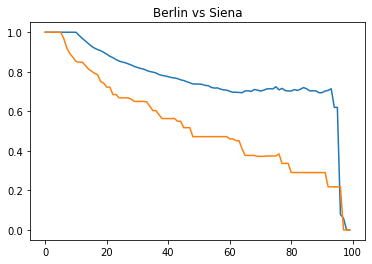

---------------------   Berlin  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.6289568004964708 



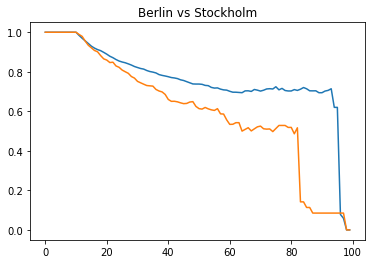

---------------------   Berlin  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.899322082554308 



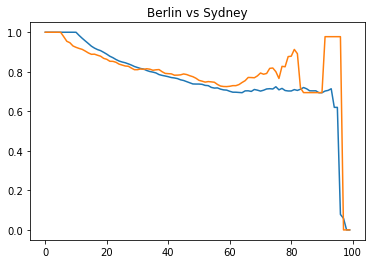

---------------------   Berlin  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.572456162187339 



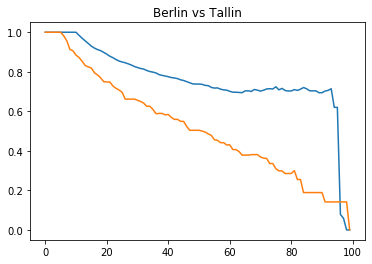

---------------------   Berlin  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.7203314046483233 



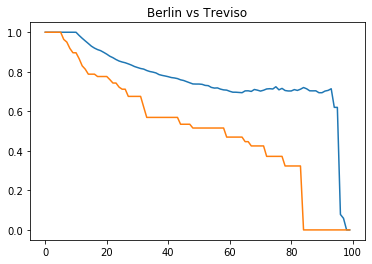

---------------------   Berlin  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.5768638689517952 



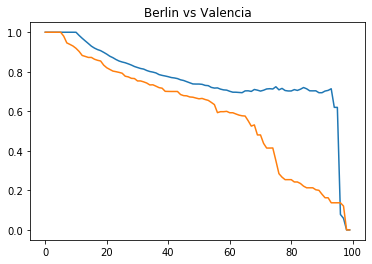

---------------------   Berlin  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.5312327841180973 



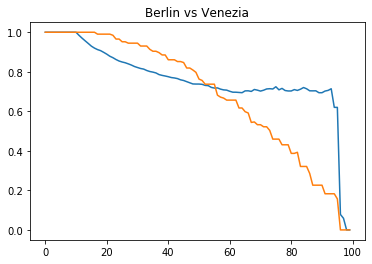

---------------------   Berlin  vs.  Verona   ---------------------
Discrete Frechet distance:  0.5025104289249054 



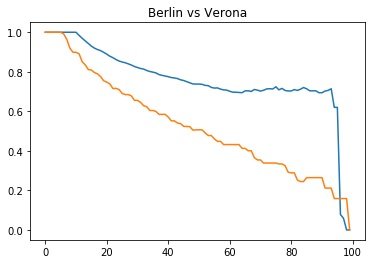

---------------------   Berlin  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.4648458024813563 



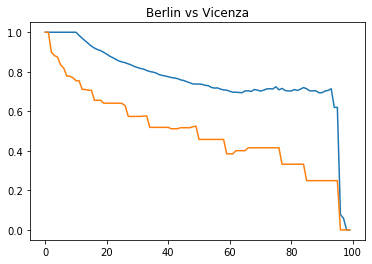

---------------------   Berlin  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.6199515458948208 



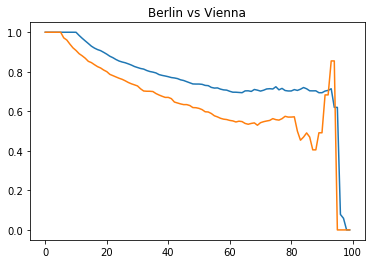

---------------------   Berlin  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.4730785277568067 



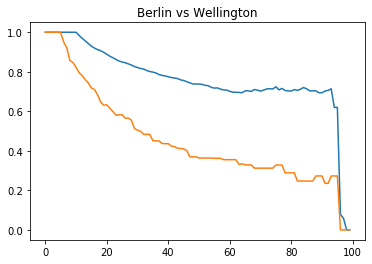

---------------------   Berlin  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.7141135865816987 



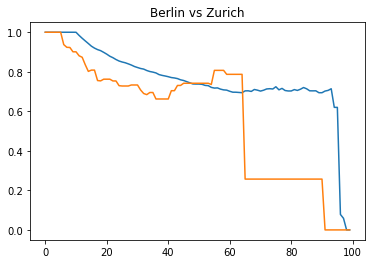

---------------------   Berlin  vs.  Milan   ---------------------
Discrete Frechet distance:  0.5401747781904702 



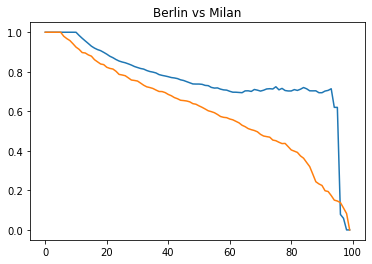

---------------------   Berlin  vs.  London   ---------------------
Discrete Frechet distance:  0.5581022169511838 



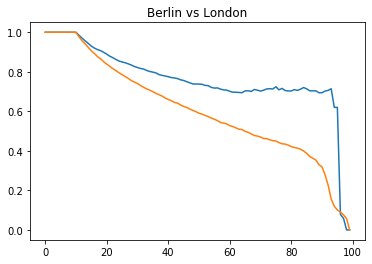

---------------------   Berlin  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.447901756261997 



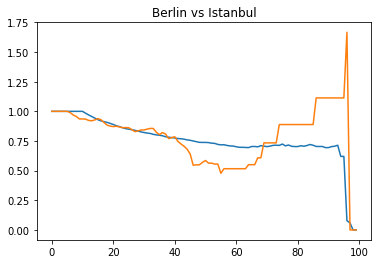

---------------------   Berlin  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.6288239538078458 



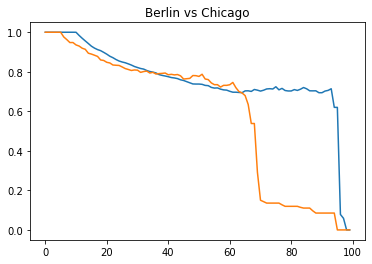

---------------------   Berlin  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.5964919152124316 



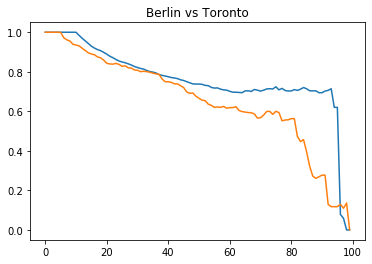

---------------------   Berlin  vs.  Munich   ---------------------
Discrete Frechet distance:  0.37351681774661266 



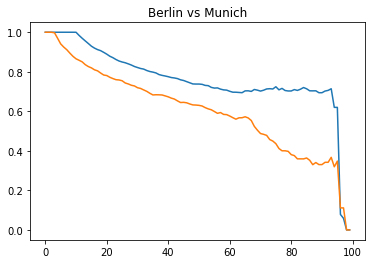

---------------------   Bologna  vs.  Bologna   ---------------------
Discrete Frechet distance:  0.0 



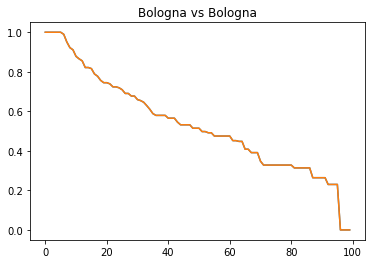

---------------------   Bologna  vs.  Bordeaux   ---------------------
Discrete Frechet distance:  0.14263585075083046 



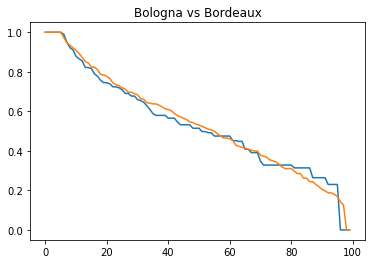

---------------------   Bologna  vs.  Boston   ---------------------
Discrete Frechet distance:  0.23004883681468558 



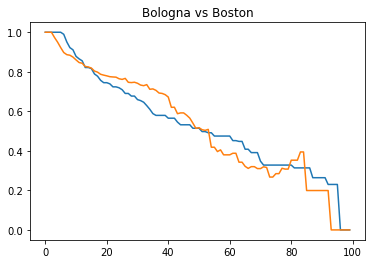

---------------------   Bologna  vs.  Bremen   ---------------------
Discrete Frechet distance:  1.232871918038821 



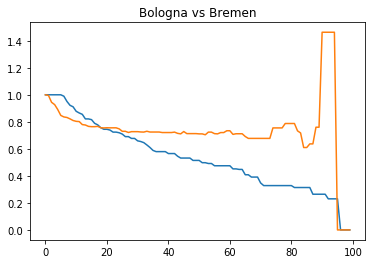

---------------------   Bologna  vs.  Brno   ---------------------
Discrete Frechet distance:  0.26416498722833176 



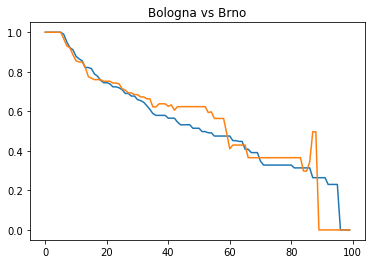

---------------------   Bologna  vs.  Budapest   ---------------------
Discrete Frechet distance:  0.19875796548383878 



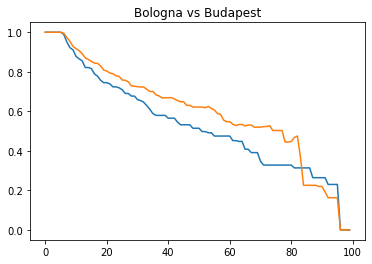

---------------------   Bologna  vs.  Buenos_Aires   ---------------------
Discrete Frechet distance:  0.43732291326472095 



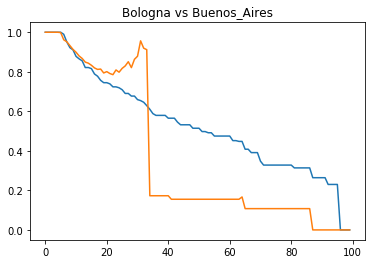

---------------------   Bologna  vs.  Busan   ---------------------
Discrete Frechet distance:  2.1866352735227927 



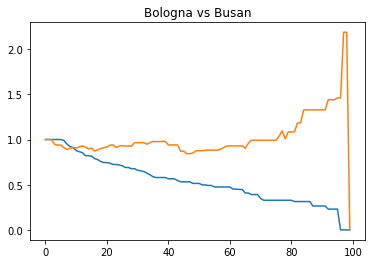

---------------------   Bologna  vs.  Denver   ---------------------
Discrete Frechet distance:  0.14219978645956902 



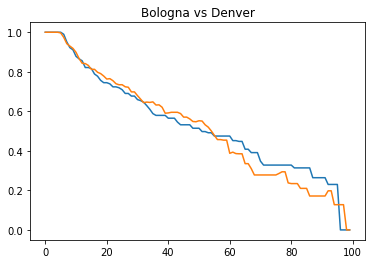

---------------------   Bologna  vs.  Dublin   ---------------------
Discrete Frechet distance:  0.15111786579002306 



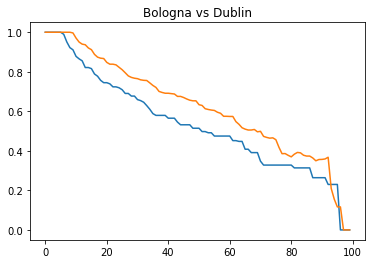

---------------------   Bologna  vs.  Edinburgh   ---------------------
Discrete Frechet distance:  0.1765558748444982 



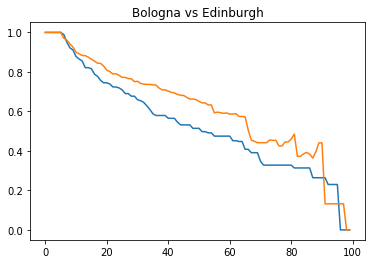

---------------------   Bologna  vs.  Florence   ---------------------
Discrete Frechet distance:  0.23004883681468558 



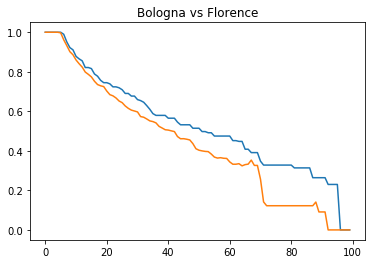

---------------------   Bologna  vs.  Los_Angeles   ---------------------
Discrete Frechet distance:  0.33892829065479885 



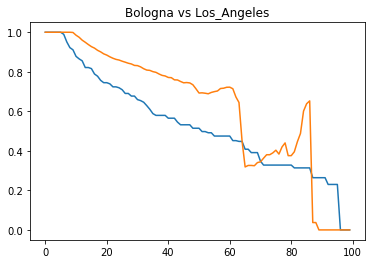

---------------------   Bologna  vs.  Lyon   ---------------------
Discrete Frechet distance:  0.13138452000427456 



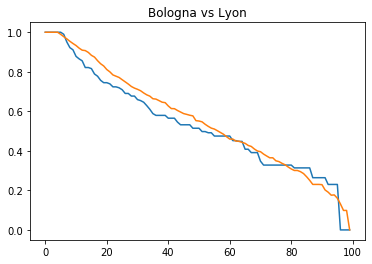

---------------------   Bologna  vs.  Madrid   ---------------------
Discrete Frechet distance:  0.10094974988808753 



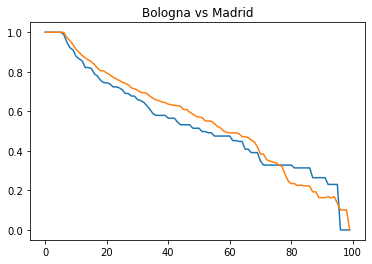

---------------------   Bologna  vs.  Moscow   ---------------------
Discrete Frechet distance:  0.313759021555081 



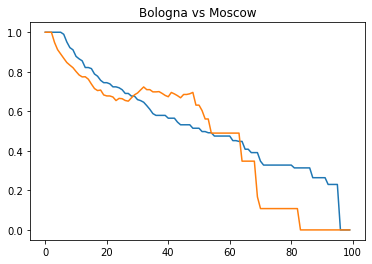

---------------------   Bologna  vs.  Palermo   ---------------------
Discrete Frechet distance:  0.7814770691027835 



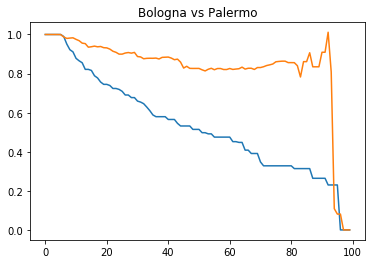

---------------------   Bologna  vs.  Paris   ---------------------
Discrete Frechet distance:  0.24092595363303576 



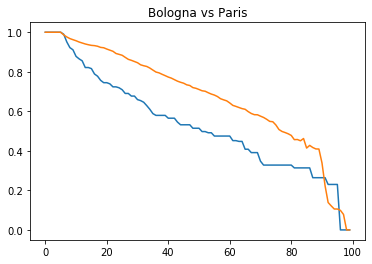

---------------------   Bologna  vs.  Porto   ---------------------
Discrete Frechet distance:  1.1130384715584971 



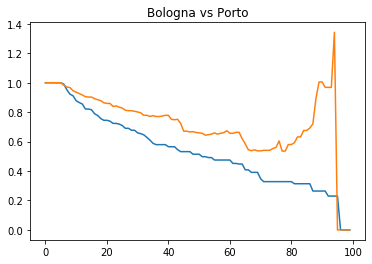

---------------------   Bologna  vs.  Prague   ---------------------
Discrete Frechet distance:  0.11234950627263443 



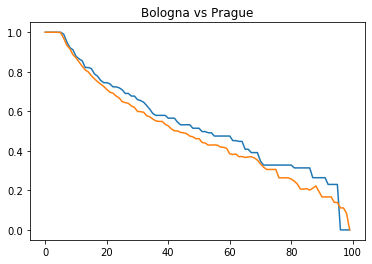

---------------------   Bologna  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.33177925717449835 



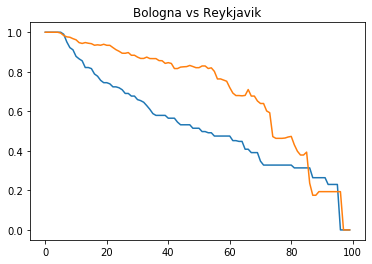

---------------------   Bologna  vs.  Riga   ---------------------
Discrete Frechet distance:  0.2921962925741087 



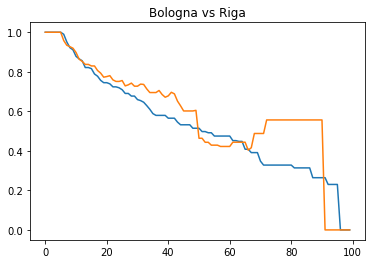

---------------------   Bologna  vs.  Rio   ---------------------
Discrete Frechet distance:  1.639445486183051 



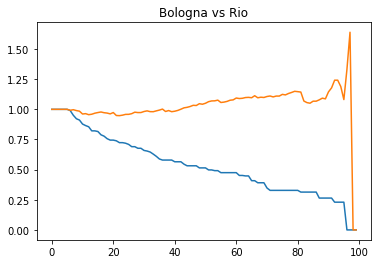

---------------------   Bologna  vs.  Rome   ---------------------
Discrete Frechet distance:  0.12035459490252898 



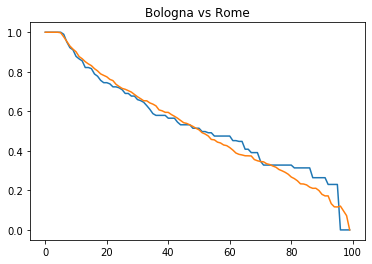

---------------------   Bologna  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.8833447012990394 



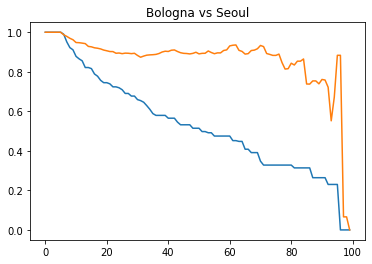

---------------------   Bologna  vs.  Siena   ---------------------
Discrete Frechet distance:  0.21800762130988874 



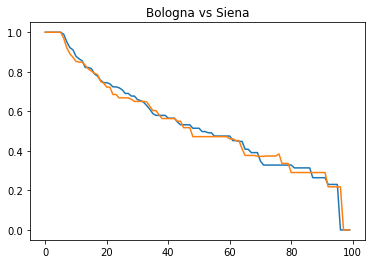

---------------------   Bologna  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.20285881402903466 



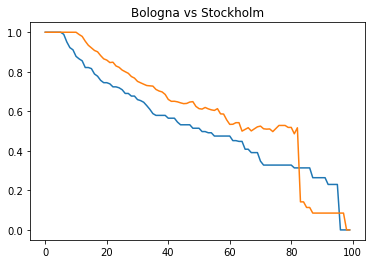

---------------------   Bologna  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.9775496108995354 



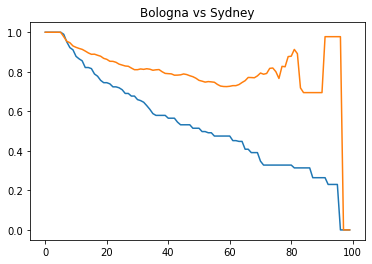

---------------------   Bologna  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.14165742439435974 



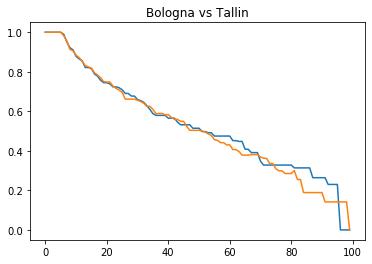

---------------------   Bologna  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.313759021555081 



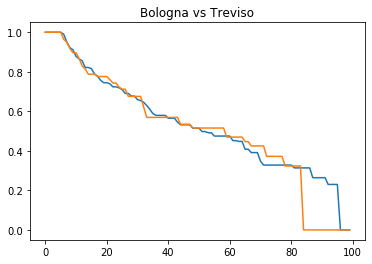

---------------------   Bologna  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.16785695457973354 



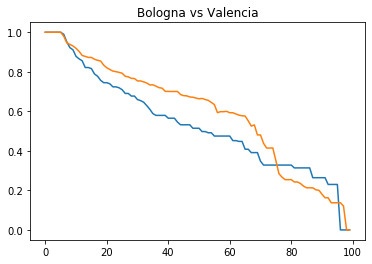

---------------------   Bologna  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.3244296607987657 



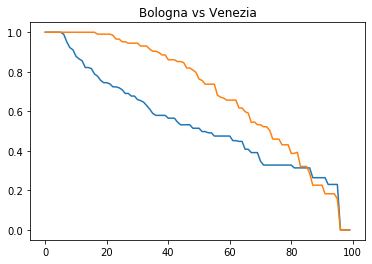

---------------------   Bologna  vs.  Verona   ---------------------
Discrete Frechet distance:  0.1587023682425636 



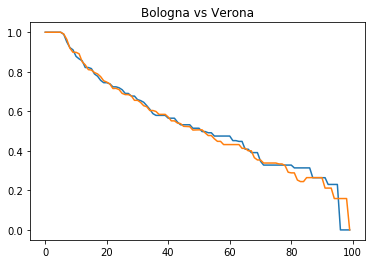

---------------------   Bologna  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.17271066610211105 



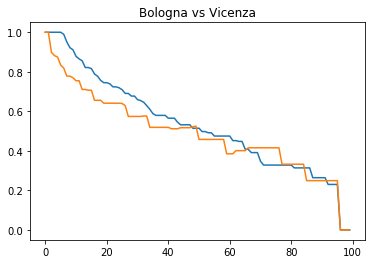

---------------------   Bologna  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.6248637720154028 



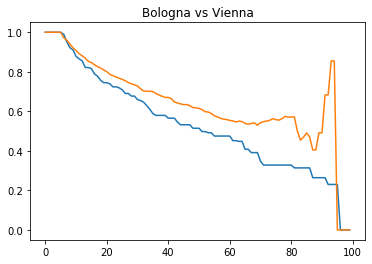

---------------------   Bologna  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.16394974350581681 



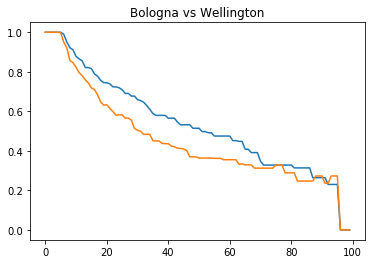

---------------------   Bologna  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.33929209841875335 



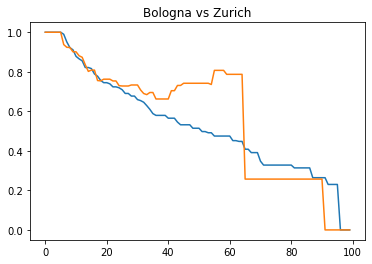

---------------------   Bologna  vs.  Milan   ---------------------
Discrete Frechet distance:  0.14705735260343872 



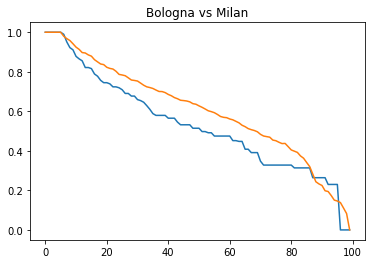

---------------------   Bologna  vs.  London   ---------------------
Discrete Frechet distance:  0.13431050772410807 



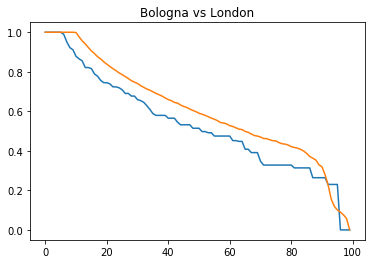

---------------------   Bologna  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.6670520643678925 



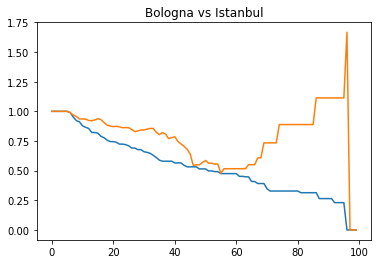

---------------------   Bologna  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.294367414535131 



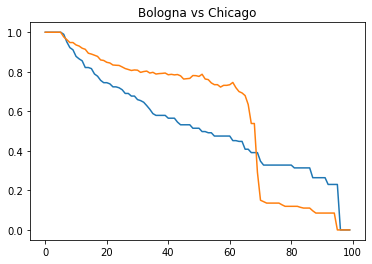

---------------------   Bologna  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.2720448348148448 



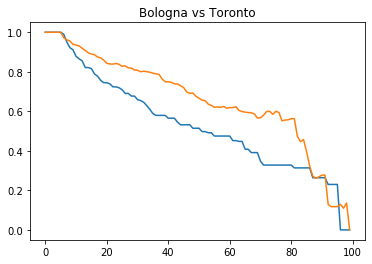

---------------------   Bologna  vs.  Munich   ---------------------
Discrete Frechet distance:  0.1641279504981536 



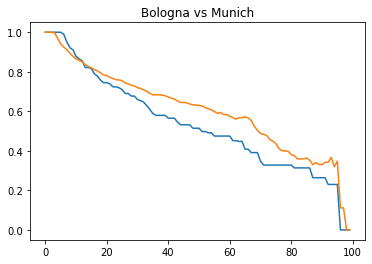

---------------------   Bordeaux  vs.  Bordeaux   ---------------------
Discrete Frechet distance:  0.0 



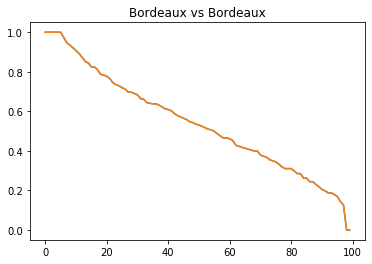

---------------------   Bordeaux  vs.  Boston   ---------------------
Discrete Frechet distance:  0.1875546729917963 



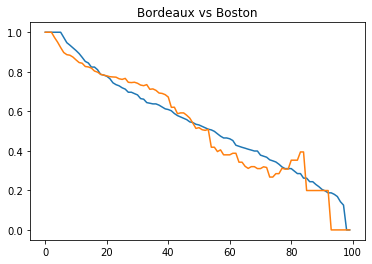

---------------------   Bordeaux  vs.  Bremen   ---------------------
Discrete Frechet distance:  1.2829183396693533 



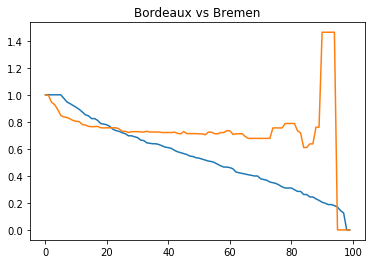

---------------------   Bordeaux  vs.  Brno   ---------------------
Discrete Frechet distance:  0.2663678705301491 



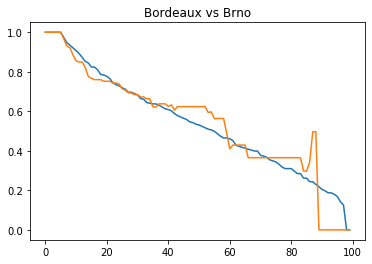

---------------------   Bordeaux  vs.  Budapest   ---------------------
Discrete Frechet distance:  0.18989654042948284 



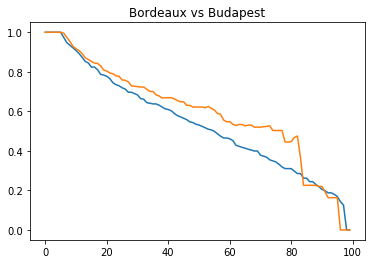

---------------------   Bordeaux  vs.  Buenos_Aires   ---------------------
Discrete Frechet distance:  0.46805102580438784 



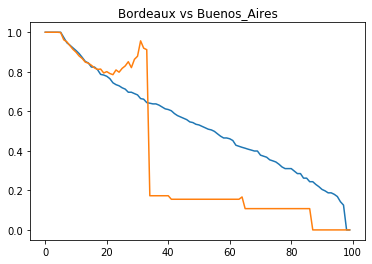

---------------------   Bordeaux  vs.  Busan   ---------------------
Discrete Frechet distance:  2.1866352735227927 



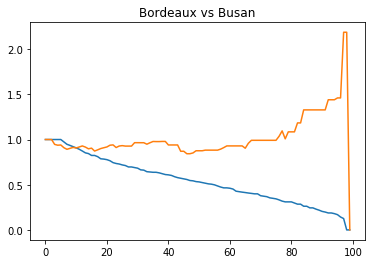

---------------------   Bordeaux  vs.  Denver   ---------------------
Discrete Frechet distance:  0.12114664066373193 



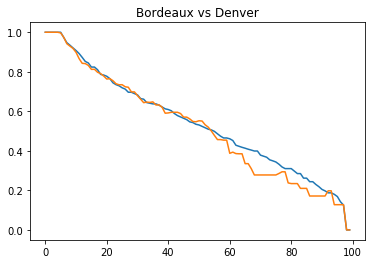

---------------------   Bordeaux  vs.  Dublin   ---------------------
Discrete Frechet distance:  0.18008245412774432 



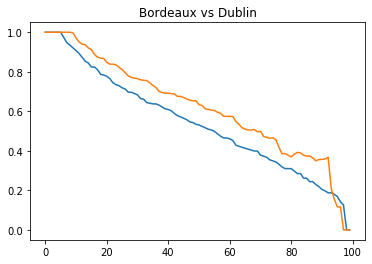

---------------------   Bordeaux  vs.  Edinburgh   ---------------------
Discrete Frechet distance:  0.23580740393314226 



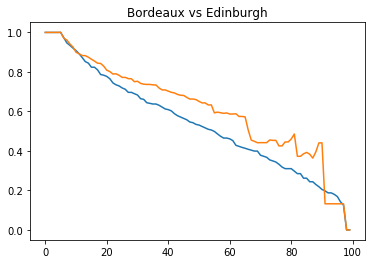

---------------------   Bordeaux  vs.  Florence   ---------------------
Discrete Frechet distance:  0.24539731550341923 



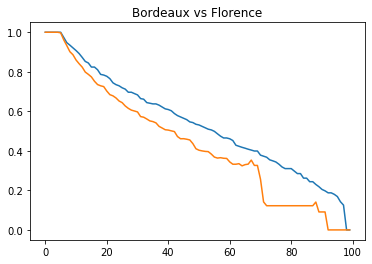

---------------------   Bordeaux  vs.  Los_Angeles   ---------------------
Discrete Frechet distance:  0.40879058863554585 



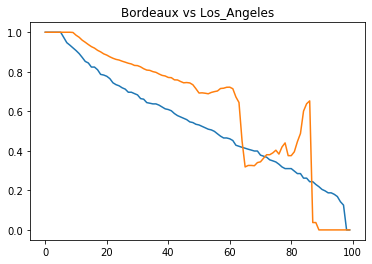

---------------------   Bordeaux  vs.  Lyon   ---------------------
Discrete Frechet distance:  0.0985383900031959 



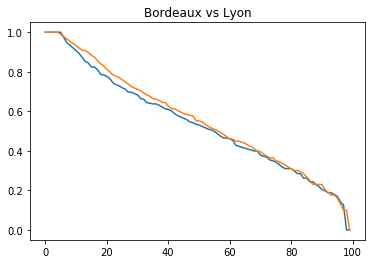

---------------------   Bordeaux  vs.  Madrid   ---------------------
Discrete Frechet distance:  0.10091321879285955 



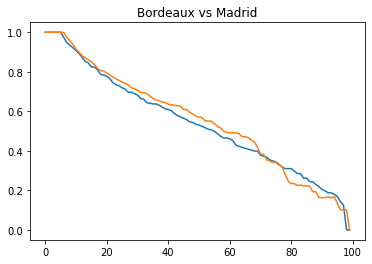

---------------------   Bordeaux  vs.  Moscow   ---------------------
Discrete Frechet distance:  0.284985556809783 



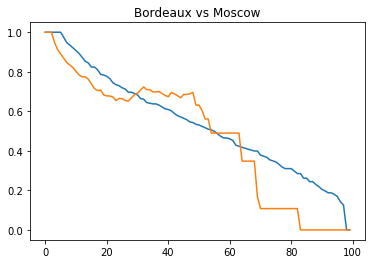

---------------------   Bordeaux  vs.  Palermo   ---------------------
Discrete Frechet distance:  0.8239712329256728 



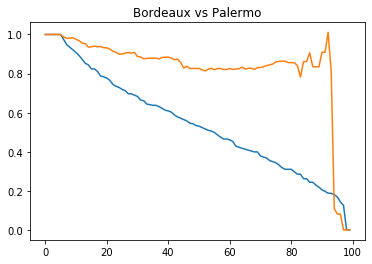

---------------------   Bordeaux  vs.  Paris   ---------------------
Discrete Frechet distance:  0.20045580848999012 



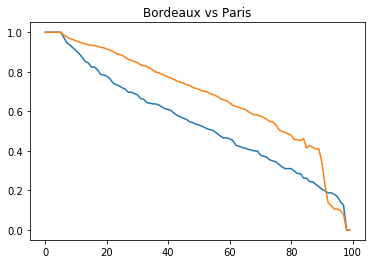

---------------------   Bordeaux  vs.  Porto   ---------------------
Discrete Frechet distance:  1.1630848931890294 



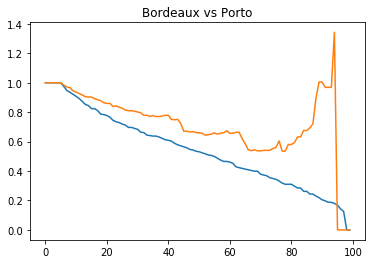

---------------------   Bordeaux  vs.  Prague   ---------------------
Discrete Frechet distance:  0.09150719843165978 



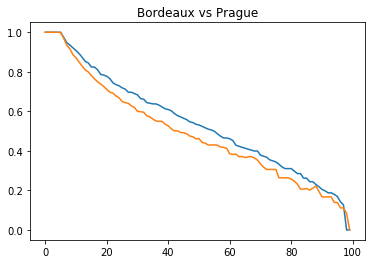

---------------------   Bordeaux  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.3140185724297413 



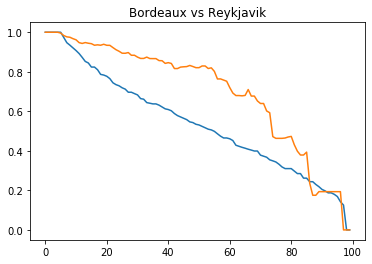

---------------------   Bordeaux  vs.  Riga   ---------------------
Discrete Frechet distance:  0.35144782166275274 



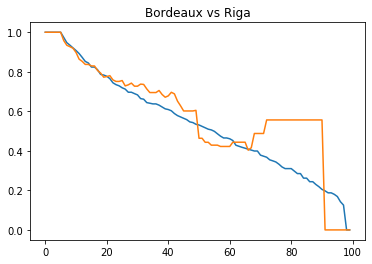

---------------------   Bordeaux  vs.  Rio   ---------------------
Discrete Frechet distance:  1.5138861607650287 



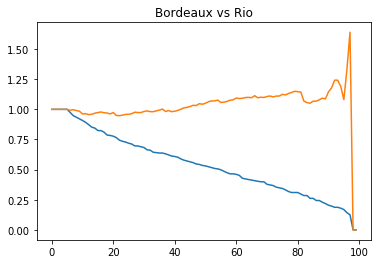

---------------------   Bordeaux  vs.  Rome   ---------------------
Discrete Frechet distance:  0.07221275694146573 



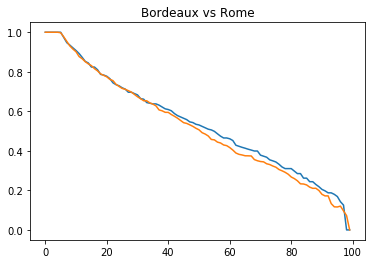

---------------------   Bordeaux  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.7407088505482089 



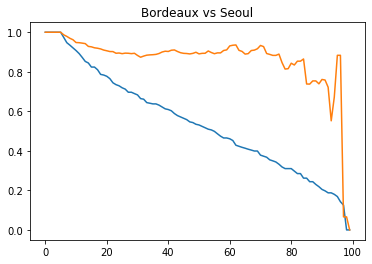

---------------------   Bordeaux  vs.  Siena   ---------------------
Discrete Frechet distance:  0.12555932541802228 



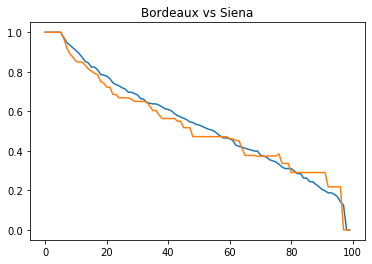

---------------------   Bordeaux  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.23163227877433268 



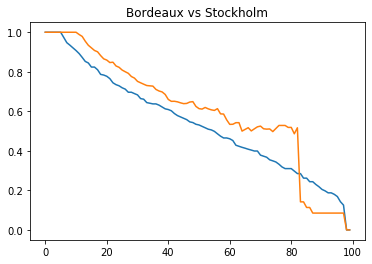

---------------------   Bordeaux  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.8349137601487049 



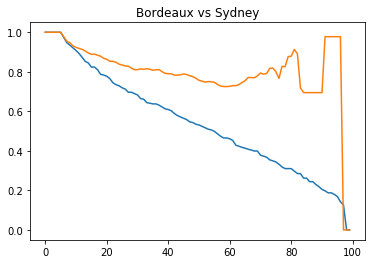

---------------------   Bordeaux  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.14165742439435974 



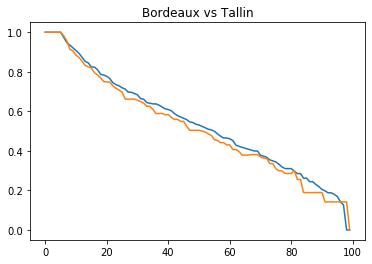

---------------------   Bordeaux  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.26191182772332555 



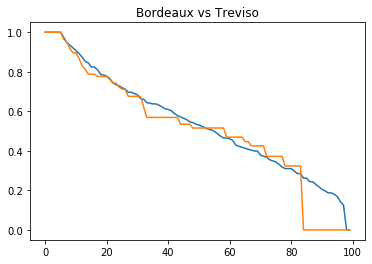

---------------------   Bordeaux  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.16280464772916214 



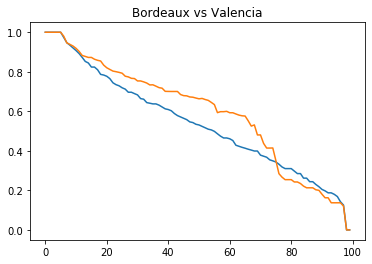

---------------------   Bordeaux  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.2861130833996054 



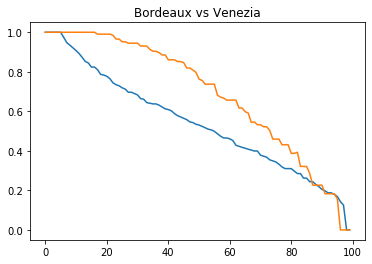

---------------------   Bordeaux  vs.  Verona   ---------------------
Discrete Frechet distance:  0.1587023682425636 



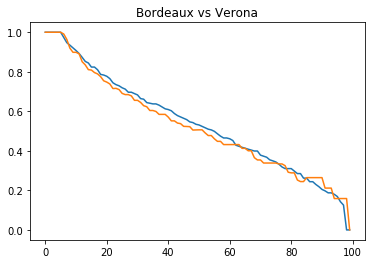

---------------------   Bordeaux  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.16909337153722948 



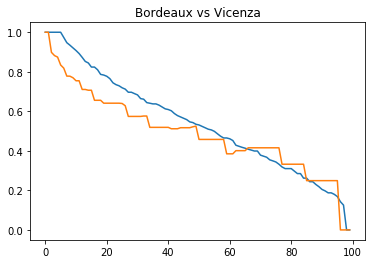

---------------------   Bordeaux  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.674910193645935 



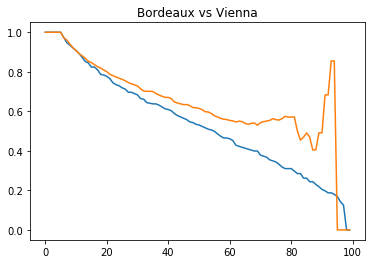

---------------------   Bordeaux  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.18726193447764133 



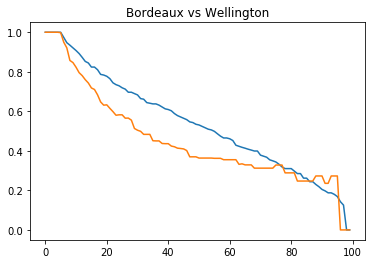

---------------------   Bordeaux  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.36922680546589753 



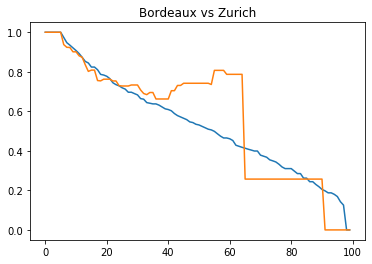

---------------------   Bordeaux  vs.  Milan   ---------------------
Discrete Frechet distance:  0.12739601162297937 



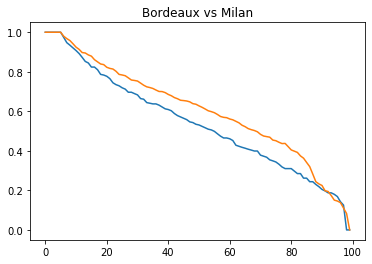

---------------------   Bordeaux  vs.  London   ---------------------
Discrete Frechet distance:  0.13763076807095526 



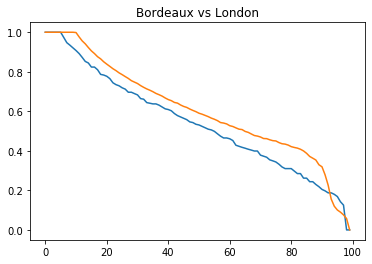

---------------------   Bordeaux  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.524416213617062 



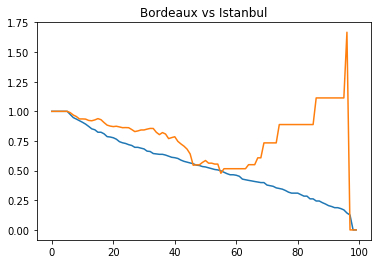

---------------------   Bordeaux  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.29387064214315745 



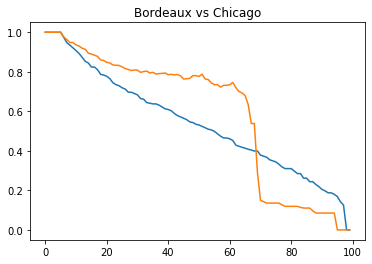

---------------------   Bordeaux  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.2651706203420569 



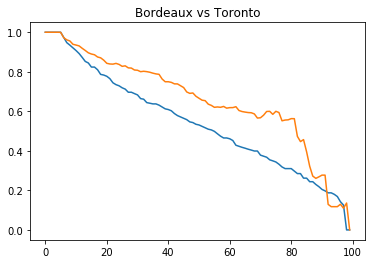

---------------------   Bordeaux  vs.  Munich   ---------------------
Discrete Frechet distance:  0.1795583548497015 



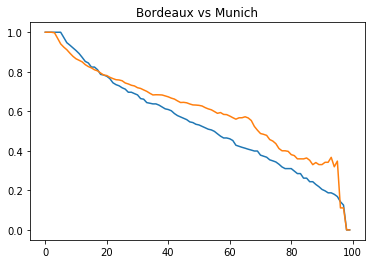

---------------------   Boston  vs.  Boston   ---------------------
Discrete Frechet distance:  0.0 



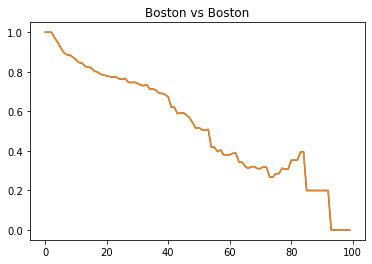

---------------------   Boston  vs.  Bremen   ---------------------
Discrete Frechet distance:  1.4629207548535066 



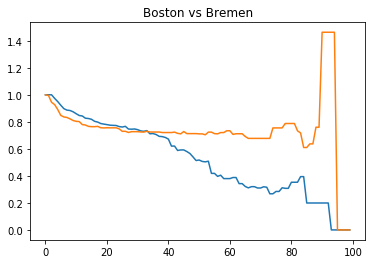

---------------------   Boston  vs.  Brno   ---------------------
Discrete Frechet distance:  0.29710834293991906 



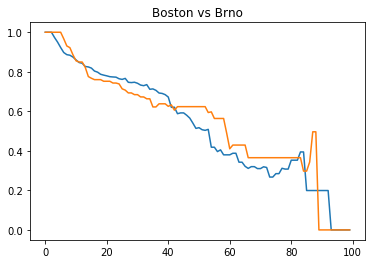

---------------------   Boston  vs.  Budapest   ---------------------
Discrete Frechet distance:  0.25941761494834464 



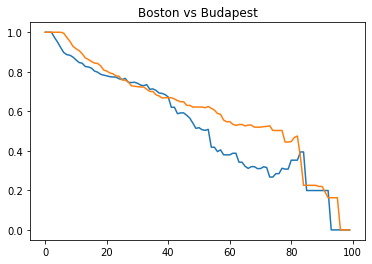

---------------------   Boston  vs.  Buenos_Aires   ---------------------
Discrete Frechet distance:  0.5404868082810086 



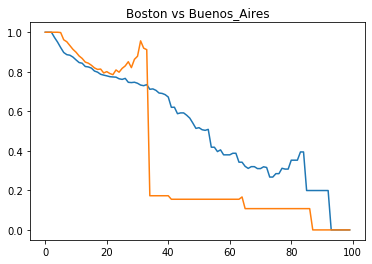

---------------------   Boston  vs.  Busan   ---------------------
Discrete Frechet distance:  2.1866352735227927 



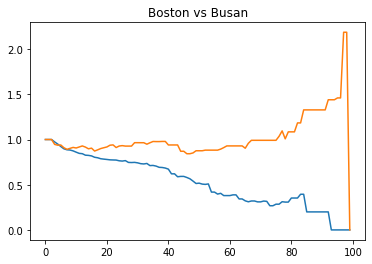

---------------------   Boston  vs.  Denver   ---------------------
Discrete Frechet distance:  0.1978516857031274 



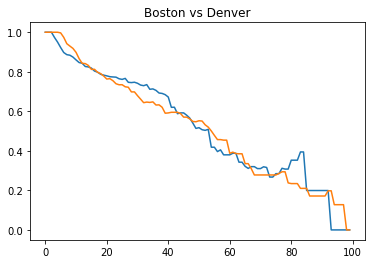

---------------------   Boston  vs.  Dublin   ---------------------
Discrete Frechet distance:  0.20975993876686333 



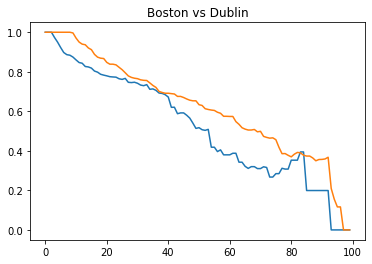

---------------------   Boston  vs.  Edinburgh   ---------------------
Discrete Frechet distance:  0.25061034031713275 



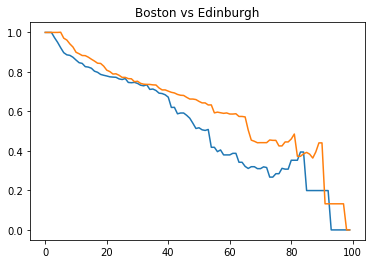

---------------------   Boston  vs.  Florence   ---------------------
Discrete Frechet distance:  0.2720744107298414 



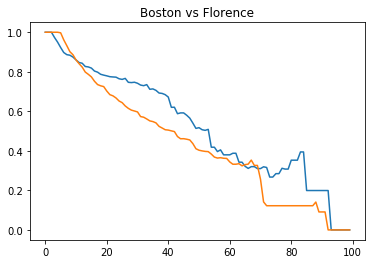

---------------------   Boston  vs.  Los_Angeles   ---------------------
Discrete Frechet distance:  0.4534158742592189 



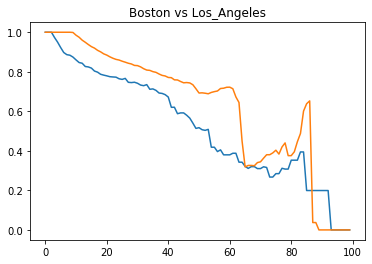

---------------------   Boston  vs.  Lyon   ---------------------
Discrete Frechet distance:  0.1770190755048407 



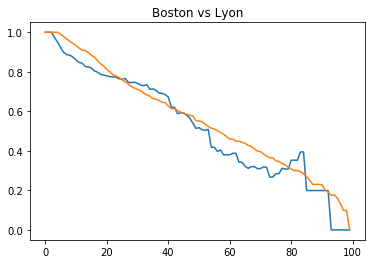

---------------------   Boston  vs.  Madrid   ---------------------
Discrete Frechet distance:  0.17112432722373597 



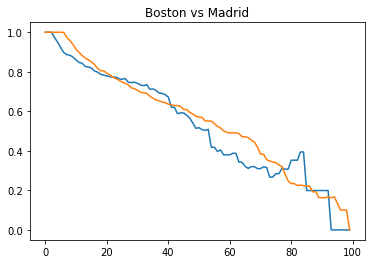

---------------------   Boston  vs.  Moscow   ---------------------
Discrete Frechet distance:  0.3944339681902365 



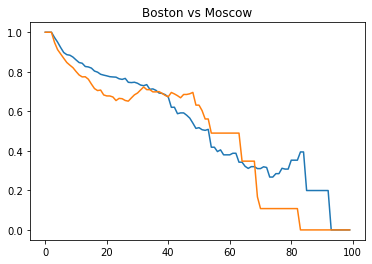

---------------------   Boston  vs.  Palermo   ---------------------
Discrete Frechet distance:  0.8122544679668081 



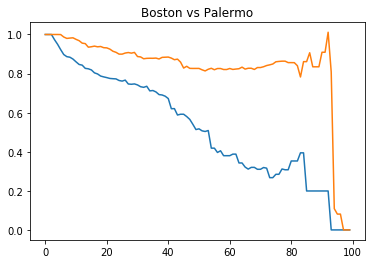

---------------------   Boston  vs.  Paris   ---------------------
Discrete Frechet distance:  0.2886825609134496 



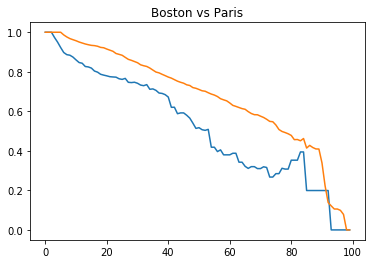

---------------------   Boston  vs.  Porto   ---------------------
Discrete Frechet distance:  1.3430873083731827 



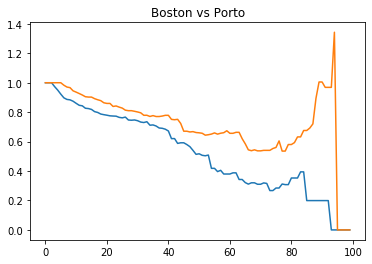

---------------------   Boston  vs.  Prague   ---------------------
Discrete Frechet distance:  0.18798253188865555 



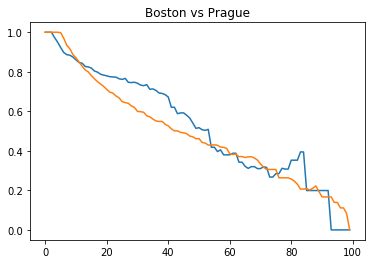

---------------------   Boston  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.40160198445496964 



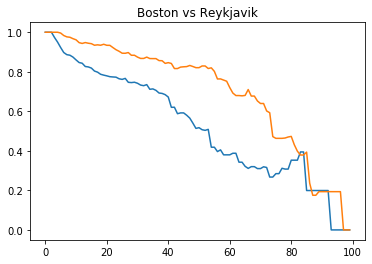

---------------------   Boston  vs.  Riga   ---------------------
Discrete Frechet distance:  0.3570898418517795 



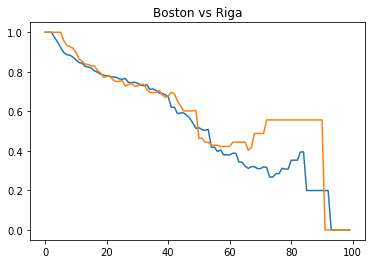

---------------------   Boston  vs.  Rio   ---------------------
Discrete Frechet distance:  1.639445486183051 



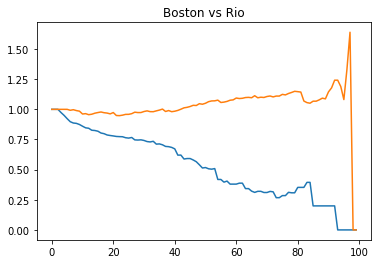

---------------------   Boston  vs.  Rome   ---------------------
Discrete Frechet distance:  0.16214854969256204 



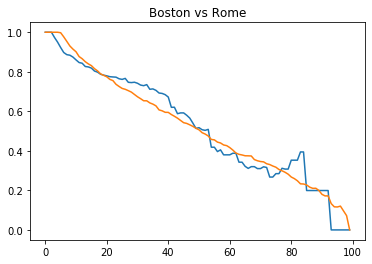

---------------------   Boston  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.8833447012990394 



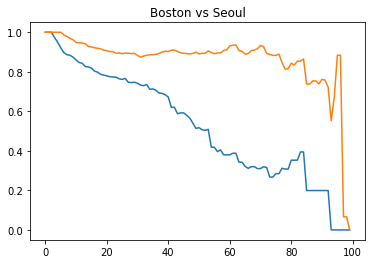

---------------------   Boston  vs.  Siena   ---------------------
Discrete Frechet distance:  0.21800762130988874 



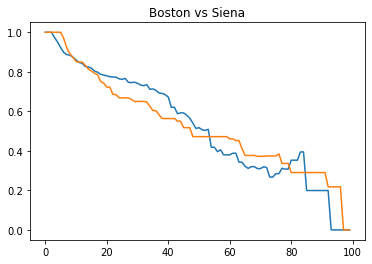

---------------------   Boston  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.2525059913813885 



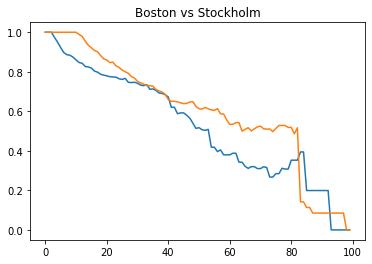

---------------------   Boston  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.9775496108995354 



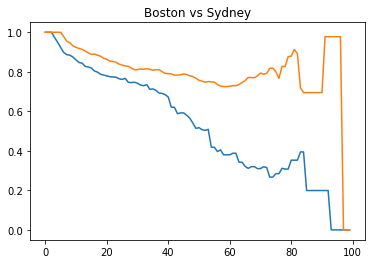

---------------------   Boston  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.20555740233101527 



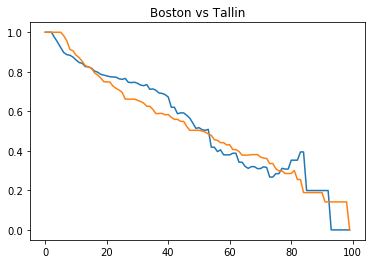

---------------------   Boston  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.3944339681902365 



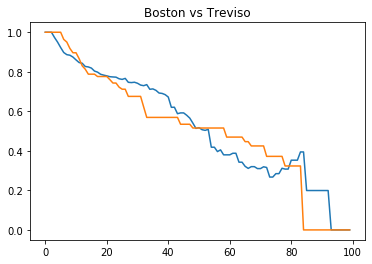

---------------------   Boston  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.2545048738525382 



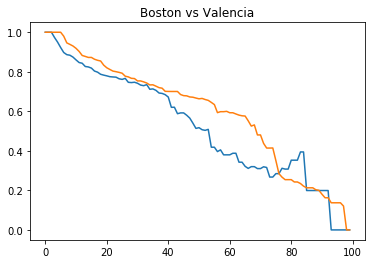

---------------------   Boston  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.3188154365875231 



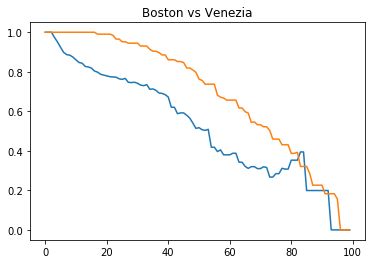

---------------------   Boston  vs.  Verona   ---------------------
Discrete Frechet distance:  0.21160315765679333 



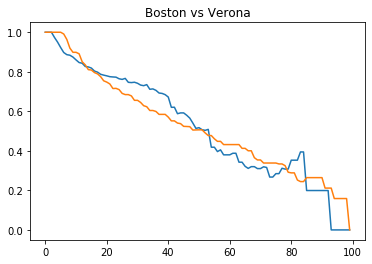

---------------------   Boston  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.24926778410034237 



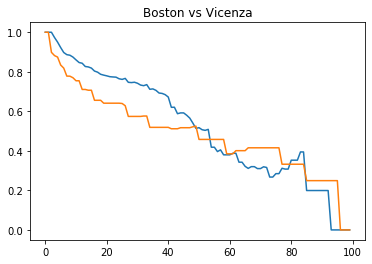

---------------------   Boston  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.8549126088300883 



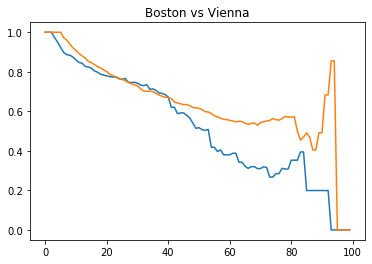

---------------------   Boston  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.2729080575924564 



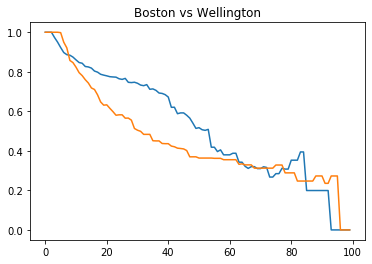

---------------------   Boston  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.44447948005587967 



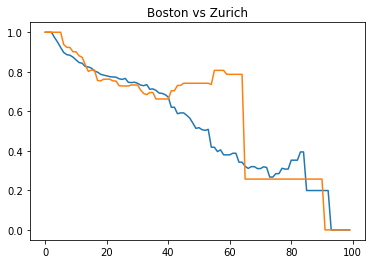

---------------------   Boston  vs.  Milan   ---------------------
Discrete Frechet distance:  0.20184532006111877 



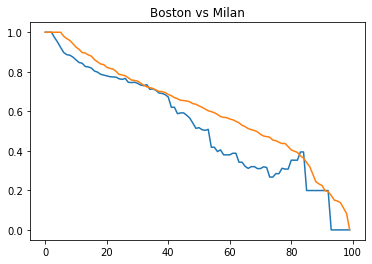

---------------------   Boston  vs.  London   ---------------------
Discrete Frechet distance:  0.1886761696513578 



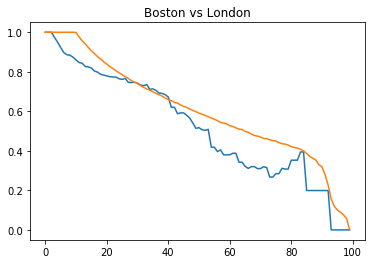

---------------------   Boston  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.6670520643678925 



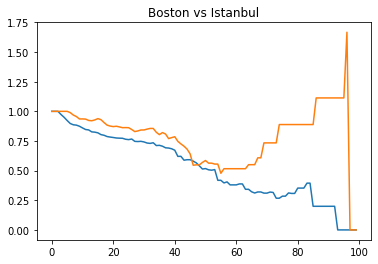

---------------------   Boston  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.3582682210206459 



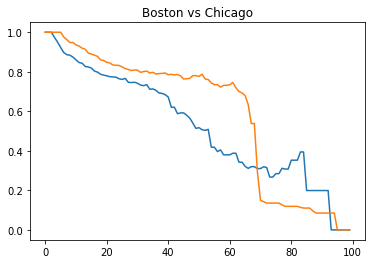

---------------------   Boston  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.33254339112622283 



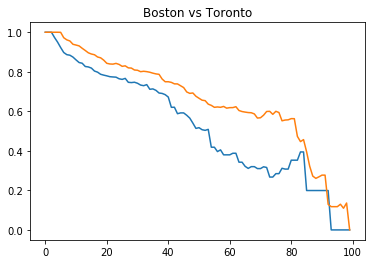

---------------------   Boston  vs.  Munich   ---------------------
Discrete Frechet distance:  0.3671130278414978 



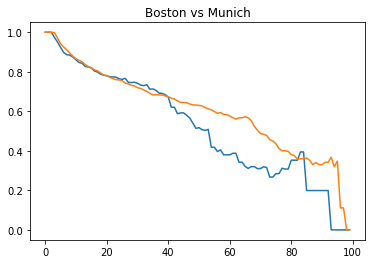

---------------------   Bremen  vs.  Bremen   ---------------------
Discrete Frechet distance:  0.0 



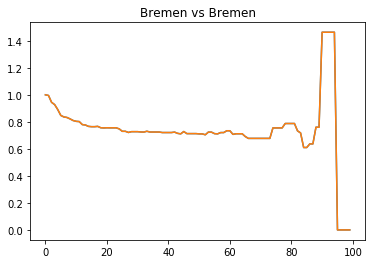

---------------------   Bremen  vs.  Brno   ---------------------
Discrete Frechet distance:  1.4629207548535066 



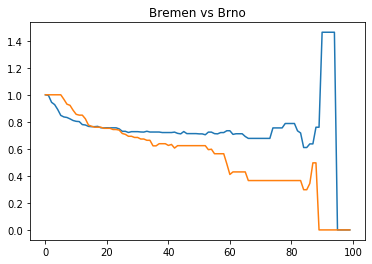

---------------------   Bremen  vs.  Budapest   ---------------------
Discrete Frechet distance:  1.3000664312044772 



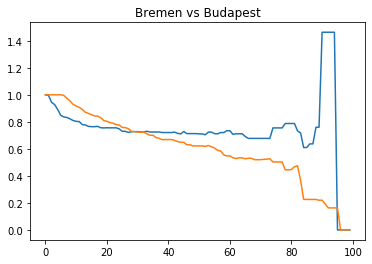

---------------------   Bremen  vs.  Buenos_Aires   ---------------------
Discrete Frechet distance:  1.4629207548535066 



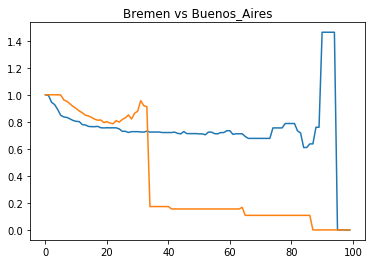

---------------------   Bremen  vs.  Busan   ---------------------
Discrete Frechet distance:  2.1866352735227927 



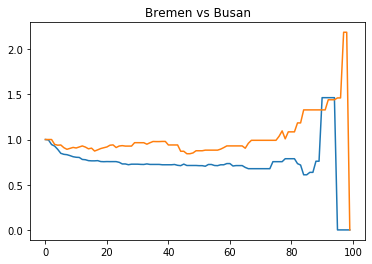

---------------------   Bremen  vs.  Denver   ---------------------
Discrete Frechet distance:  1.3352866190843888 



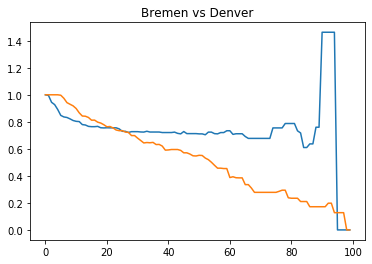

---------------------   Bremen  vs.  Dublin   ---------------------
Discrete Frechet distance:  1.3077752620824614 



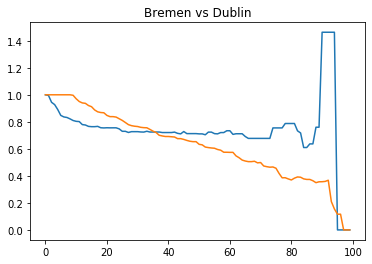

---------------------   Bremen  vs.  Edinburgh   ---------------------
Discrete Frechet distance:  1.3307044962316419 



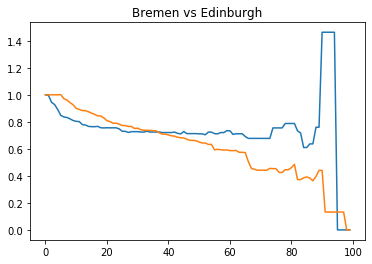

---------------------   Bremen  vs.  Florence   ---------------------
Discrete Frechet distance:  1.4629207548535066 



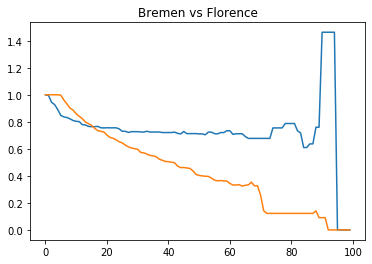

---------------------   Bremen  vs.  Los_Angeles   ---------------------
Discrete Frechet distance:  1.4629207548535066 



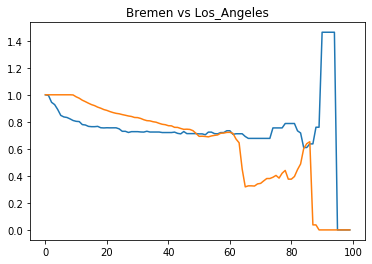

---------------------   Bremen  vs.  Lyon   ---------------------
Discrete Frechet distance:  1.2871888926477402 



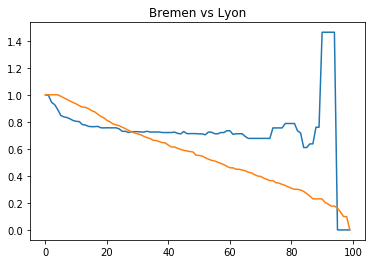

---------------------   Bremen  vs.  Madrid   ---------------------
Discrete Frechet distance:  1.3007260317601155 



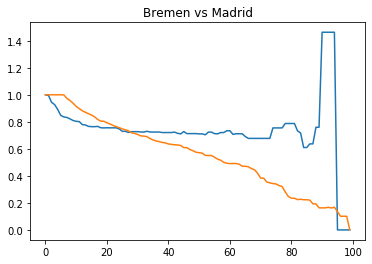

---------------------   Bremen  vs.  Moscow   ---------------------
Discrete Frechet distance:  1.4629207548535066 



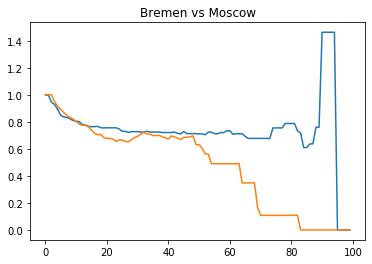

---------------------   Bremen  vs.  Palermo   ---------------------
Discrete Frechet distance:  1.1951596831678806 



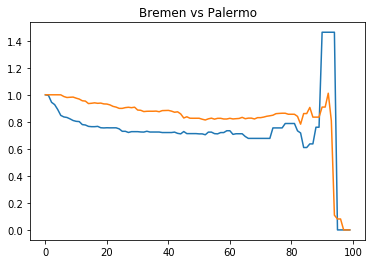

---------------------   Bremen  vs.  Paris   ---------------------
Discrete Frechet distance:  1.3571617425269267 



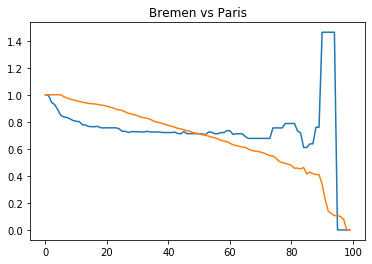

---------------------   Bremen  vs.  Porto   ---------------------
Discrete Frechet distance:  0.49428583640889734 



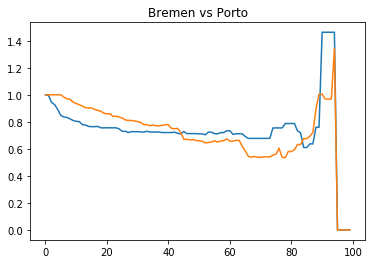

---------------------   Bremen  vs.  Prague   ---------------------
Discrete Frechet distance:  1.3238297324024866 



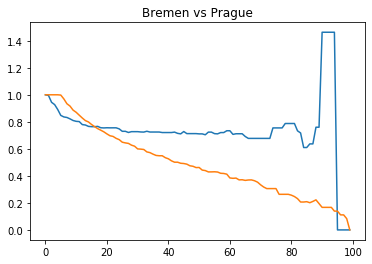

---------------------   Bremen  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  1.2693810585542902 



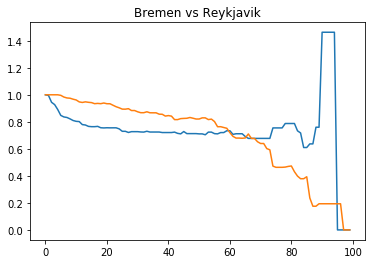

---------------------   Bremen  vs.  Riga   ---------------------
Discrete Frechet distance:  1.4629207548535066 



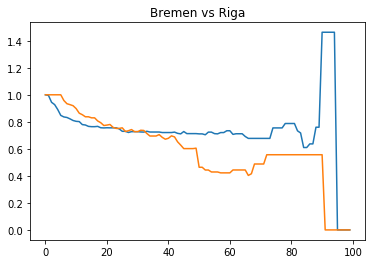

---------------------   Bremen  vs.  Rio   ---------------------
Discrete Frechet distance:  1.639445486183051 



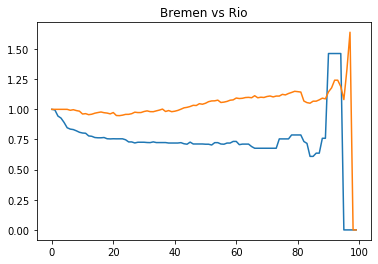

---------------------   Bremen  vs.  Rome   ---------------------
Discrete Frechet distance:  1.346129745890416 



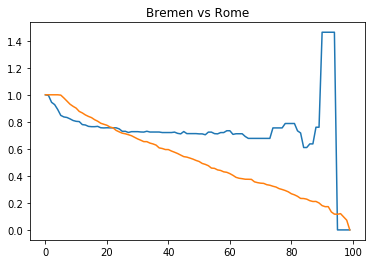

---------------------   Bremen  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.9110093726873166 



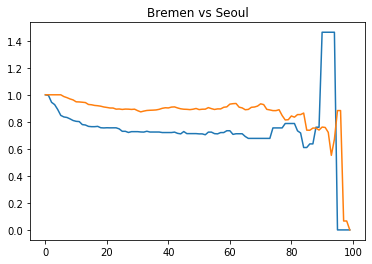

---------------------   Bremen  vs.  Siena   ---------------------
Discrete Frechet distance:  1.2449131335436179 



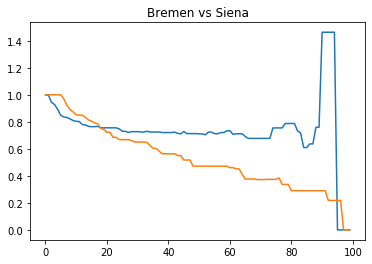

---------------------   Bremen  vs.  Stockholm   ---------------------
Discrete Frechet distance:  1.3777639687682788 



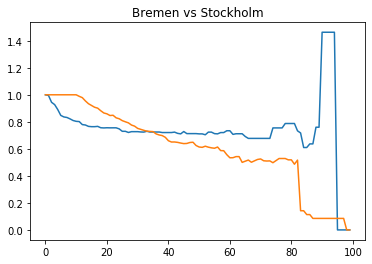

---------------------   Bremen  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.9775496108995354 



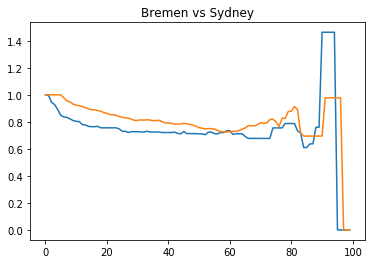

---------------------   Bremen  vs.  Tallin   ---------------------
Discrete Frechet distance:  1.3212633304591468 



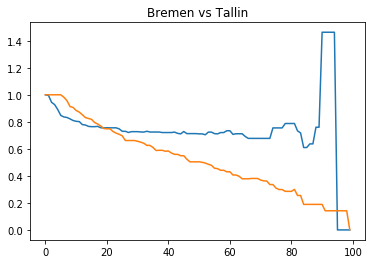

---------------------   Bremen  vs.  Treviso   ---------------------
Discrete Frechet distance:  1.4629207548535066 



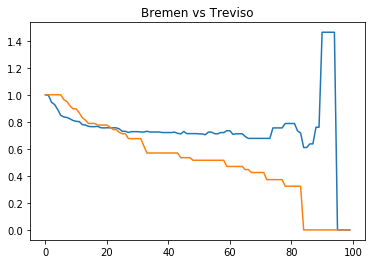

---------------------   Bremen  vs.  Valencia   ---------------------
Discrete Frechet distance:  1.3256710372236031 



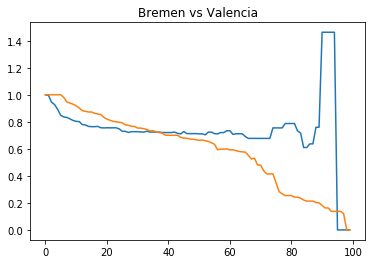

---------------------   Bremen  vs.  Venezia   ---------------------
Discrete Frechet distance:  1.2800399523899053 



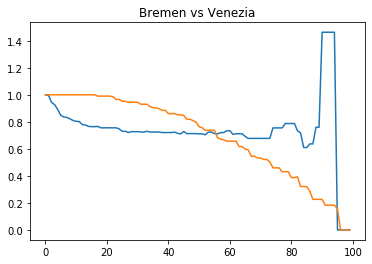

---------------------   Bremen  vs.  Verona   ---------------------
Discrete Frechet distance:  1.304218386610943 



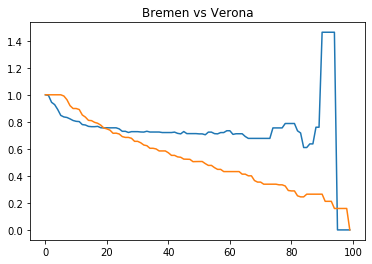

---------------------   Bremen  vs.  Vicenza   ---------------------
Discrete Frechet distance:  1.2136529707531643 



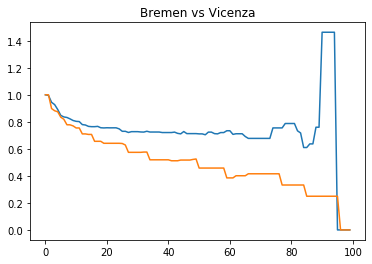

---------------------   Bremen  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.9715314498496566 



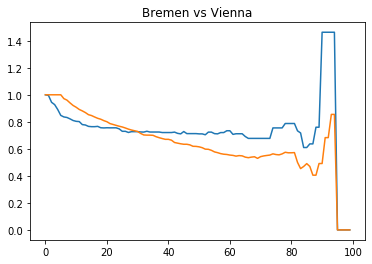

---------------------   Bremen  vs.  Wellington   ---------------------
Discrete Frechet distance:  1.2272927071644382 



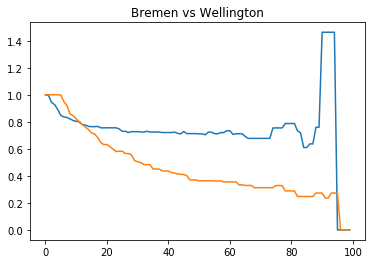

---------------------   Bremen  vs.  Zurich   ---------------------
Discrete Frechet distance:  1.4629207548535066 



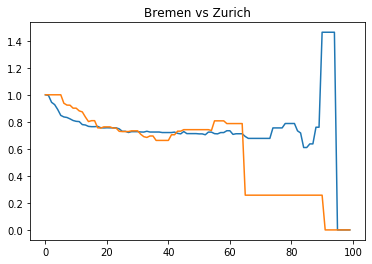

---------------------   Bremen  vs.  Milan   ---------------------
Discrete Frechet distance:  1.3121386834360897 



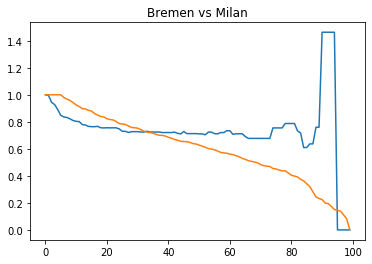

---------------------   Bremen  vs.  London   ---------------------
Discrete Frechet distance:  1.3430649578526603 



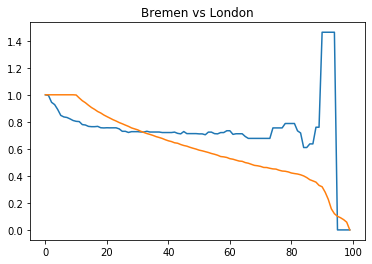

---------------------   Bremen  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.6670520643678925 



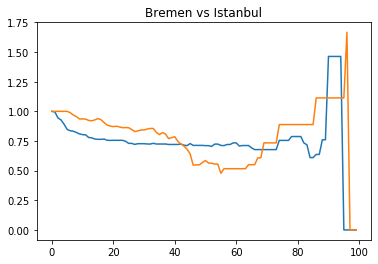

---------------------   Bremen  vs.  Chicago   ---------------------
Discrete Frechet distance:  1.3776311220796538 



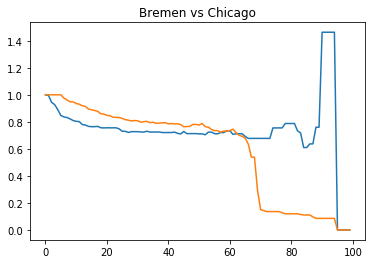

---------------------   Bremen  vs.  Toronto   ---------------------
Discrete Frechet distance:  1.3452990834842395 



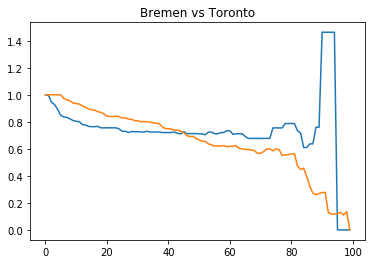

---------------------   Bremen  vs.  Munich   ---------------------
Discrete Frechet distance:  1.1434809644581154 



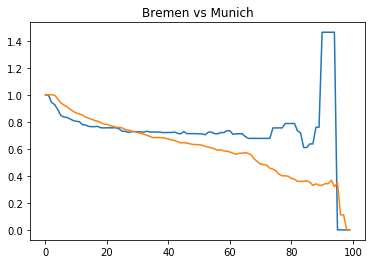

---------------------   Brno  vs.  Brno   ---------------------
Discrete Frechet distance:  0.0 



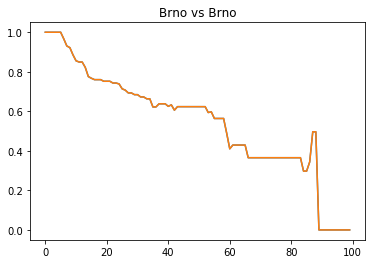

---------------------   Brno  vs.  Budapest   ---------------------
Discrete Frechet distance:  0.27077578672403735 



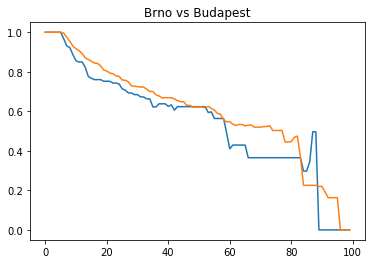

---------------------   Brno  vs.  Buenos_Aires   ---------------------
Discrete Frechet distance:  0.49637978089058 



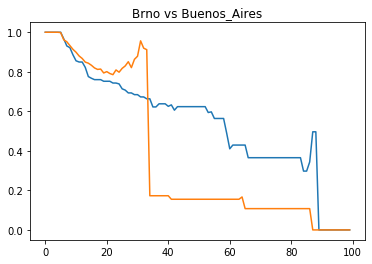

---------------------   Brno  vs.  Busan   ---------------------
Discrete Frechet distance:  2.1866352735227927 



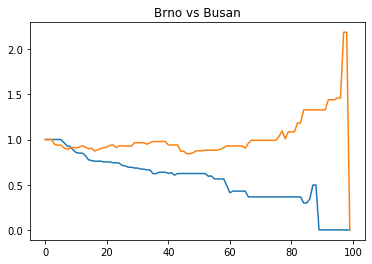

---------------------   Brno  vs.  Denver   ---------------------
Discrete Frechet distance:  0.324820545795068 



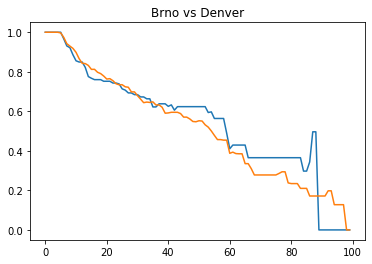

---------------------   Brno  vs.  Dublin   ---------------------
Discrete Frechet distance:  0.3676371271195406 



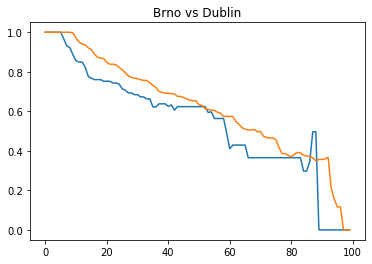

---------------------   Brno  vs.  Edinburgh   ---------------------
Discrete Frechet distance:  0.44072086207282996 



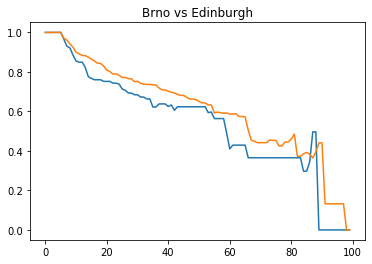

---------------------   Brno  vs.  Florence   ---------------------
Discrete Frechet distance:  0.3740202234301848 



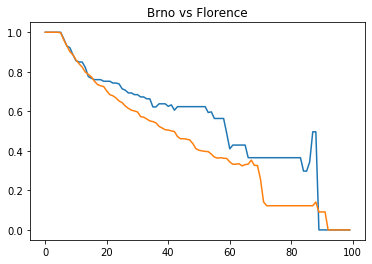

---------------------   Brno  vs.  Los_Angeles   ---------------------
Discrete Frechet distance:  0.4591479171626369 



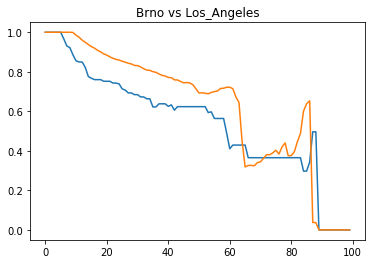

---------------------   Brno  vs.  Lyon   ---------------------
Discrete Frechet distance:  0.2662092101472763 



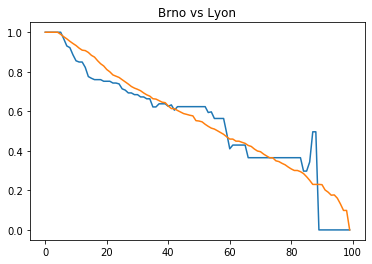

---------------------   Brno  vs.  Madrid   ---------------------
Discrete Frechet distance:  0.3036017977035109 



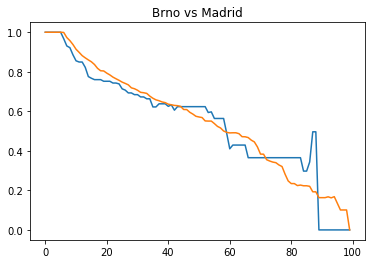

---------------------   Brno  vs.  Moscow   ---------------------
Discrete Frechet distance:  0.49637978089058 



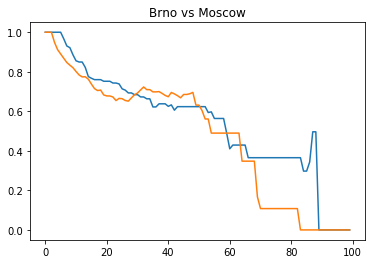

---------------------   Brno  vs.  Palermo   ---------------------
Discrete Frechet distance:  1.011525905917469 



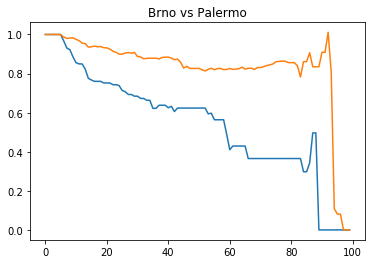

---------------------   Brno  vs.  Paris   ---------------------
Discrete Frechet distance:  0.4091489186686956 



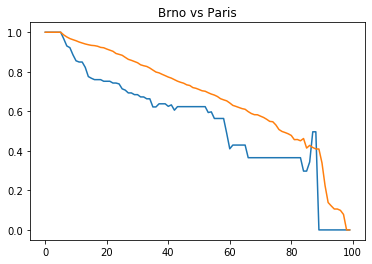

---------------------   Brno  vs.  Porto   ---------------------
Discrete Frechet distance:  1.3430873083731827 



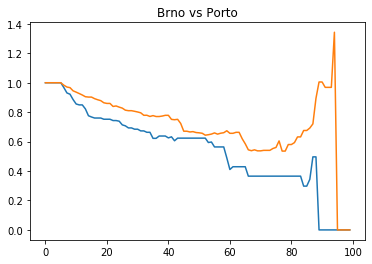

---------------------   Brno  vs.  Prague   ---------------------
Discrete Frechet distance:  0.2854306631923382 



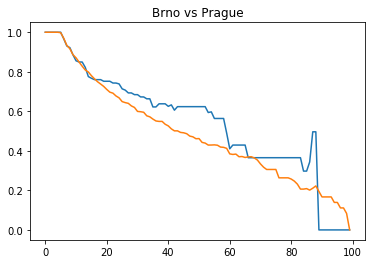

---------------------   Brno  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.3448242819967044 



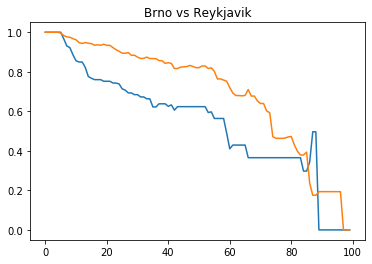

---------------------   Brno  vs.  Riga   ---------------------
Discrete Frechet distance:  0.5563612798024404 



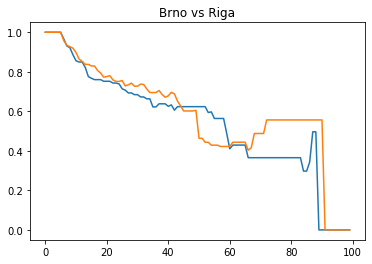

---------------------   Brno  vs.  Rio   ---------------------
Discrete Frechet distance:  1.639445486183051 



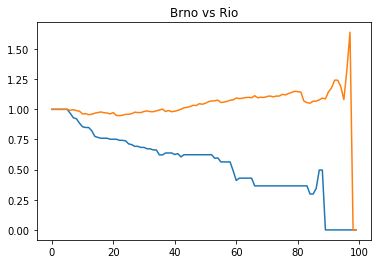

---------------------   Brno  vs.  Rome   ---------------------
Discrete Frechet distance:  0.2860453981334211 



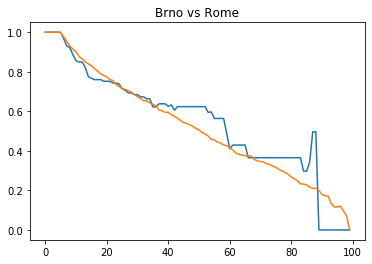

---------------------   Brno  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.8833447012990394 



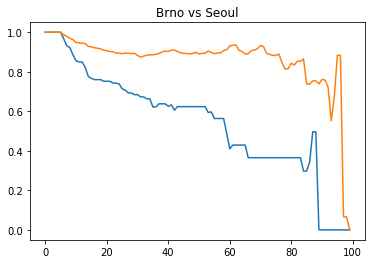

---------------------   Brno  vs.  Siena   ---------------------
Discrete Frechet distance:  0.29024749433081465 



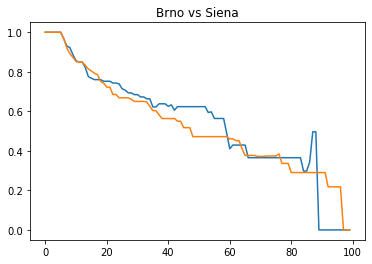

---------------------   Brno  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.4112229948053522 



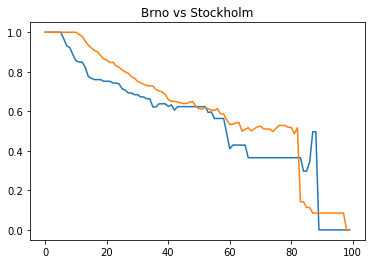

---------------------   Brno  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.9775496108995354 



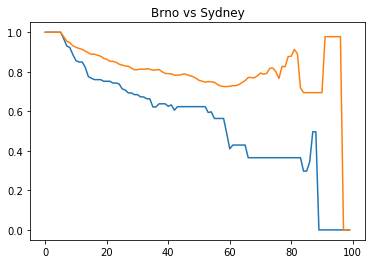

---------------------   Brno  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.30750321503135875 



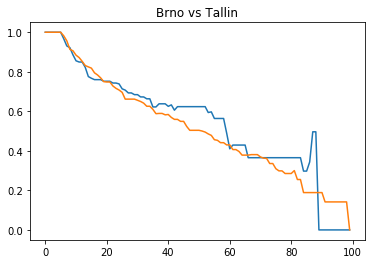

---------------------   Brno  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.49637978089058 



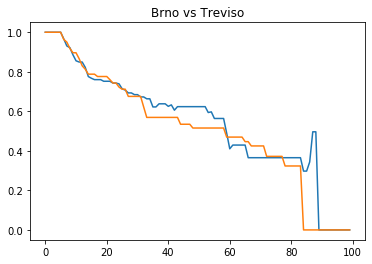

---------------------   Brno  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.2932978567625305 



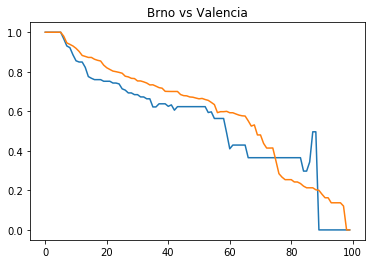

---------------------   Brno  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.28170777089735244 



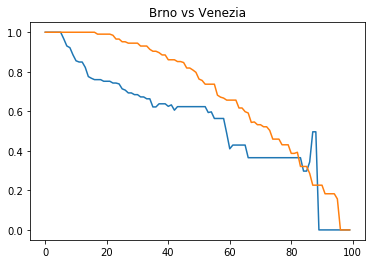

---------------------   Brno  vs.  Verona   ---------------------
Discrete Frechet distance:  0.2645039470710336 



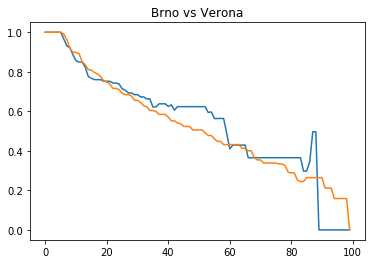

---------------------   Brno  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.24926778410034237 



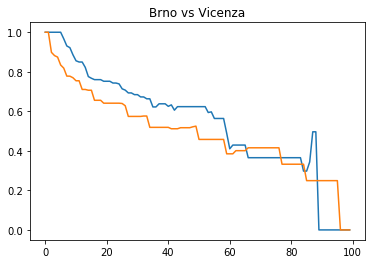

---------------------   Brno  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.8549126088300883 



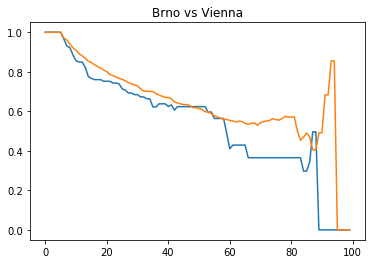

---------------------   Brno  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.2729872854290622 



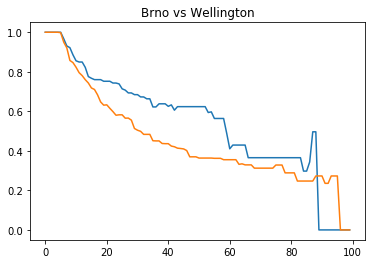

---------------------   Brno  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.37665943537450464 



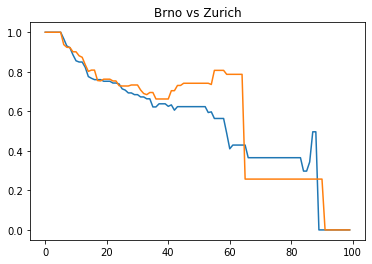

---------------------   Brno  vs.  Milan   ---------------------
Discrete Frechet distance:  0.2525955901196686 



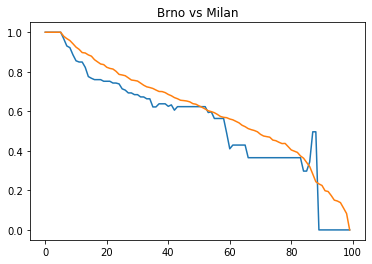

---------------------   Brno  vs.  London   ---------------------
Discrete Frechet distance:  0.3296887834708291 



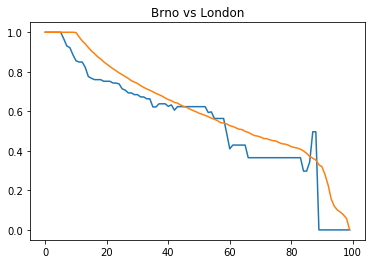

---------------------   Brno  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.6670520643678925 



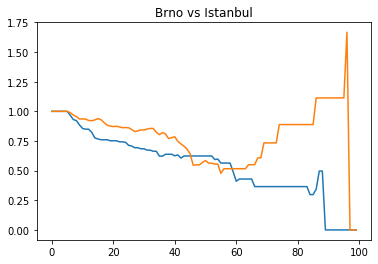

---------------------   Brno  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.4110901481167271 



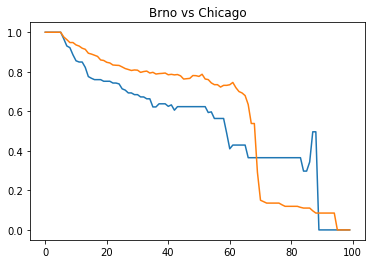

---------------------   Brno  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.2771986325114767 



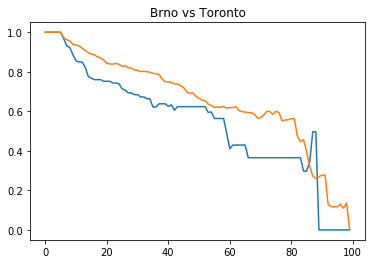

---------------------   Brno  vs.  Munich   ---------------------
Discrete Frechet distance:  0.3671130278414978 



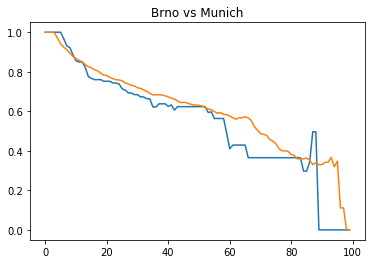

---------------------   Budapest  vs.  Budapest   ---------------------
Discrete Frechet distance:  0.0 



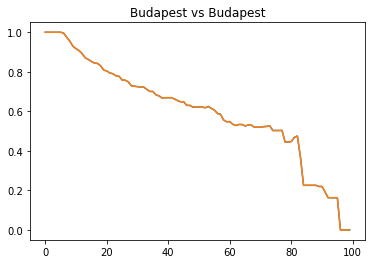

---------------------   Budapest  vs.  Buenos_Aires   ---------------------
Discrete Frechet distance:  0.5276804285452328 



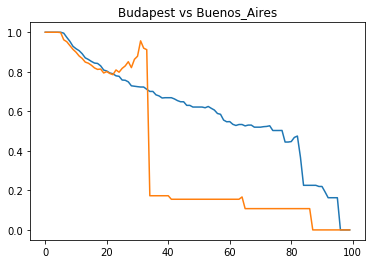

---------------------   Budapest  vs.  Busan   ---------------------
Discrete Frechet distance:  2.1866352735227927 



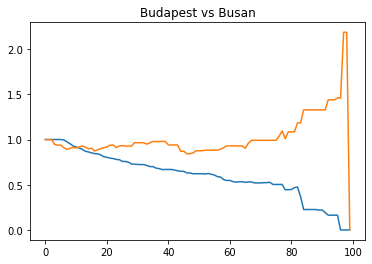

---------------------   Budapest  vs.  Denver   ---------------------
Discrete Frechet distance:  0.24876830737196576 



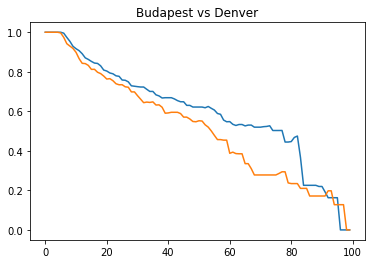

---------------------   Budapest  vs.  Dublin   ---------------------
Discrete Frechet distance:  0.20478280347051123 



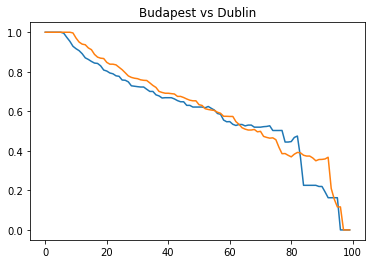

---------------------   Budapest  vs.  Edinburgh   ---------------------
Discrete Frechet distance:  0.22091069307308794 



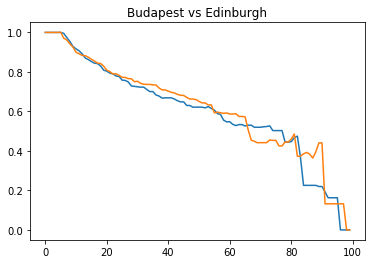

---------------------   Budapest  vs.  Florence   ---------------------
Discrete Frechet distance:  0.40441436432653133 



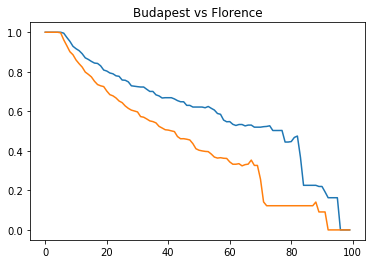

---------------------   Budapest  vs.  Los_Angeles   ---------------------
Discrete Frechet distance:  0.4270833180433372 



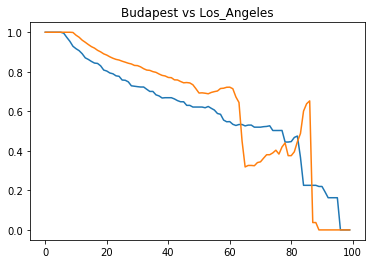

---------------------   Budapest  vs.  Lyon   ---------------------
Discrete Frechet distance:  0.17414061484221022 



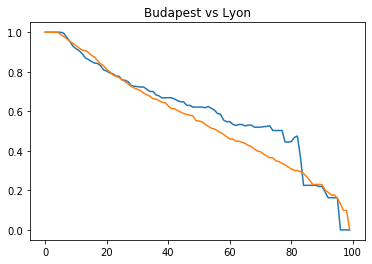

---------------------   Budapest  vs.  Madrid   ---------------------
Discrete Frechet distance:  0.25051762314627635 



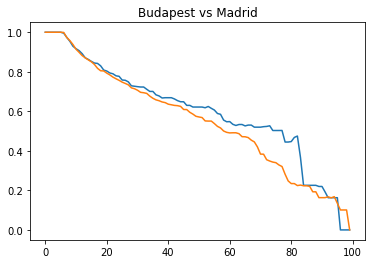

---------------------   Budapest  vs.  Moscow   ---------------------
Discrete Frechet distance:  0.41891211861822175 



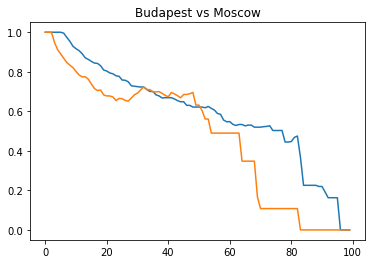

---------------------   Budapest  vs.  Palermo   ---------------------
Discrete Frechet distance:  0.8486715822684396 



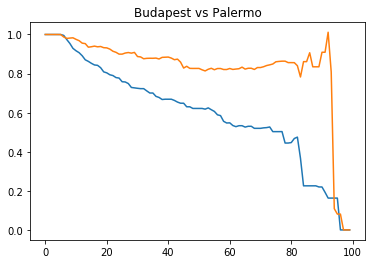

---------------------   Budapest  vs.  Paris   ---------------------
Discrete Frechet distance:  0.23676364204677303 



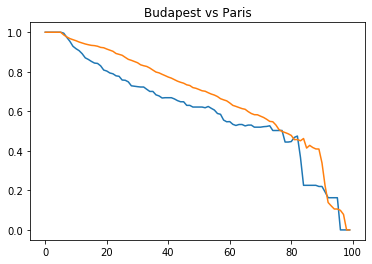

---------------------   Budapest  vs.  Porto   ---------------------
Discrete Frechet distance:  1.1802329847241533 



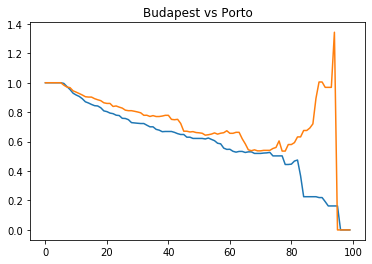

---------------------   Budapest  vs.  Prague   ---------------------
Discrete Frechet distance:  0.24334634047971337 



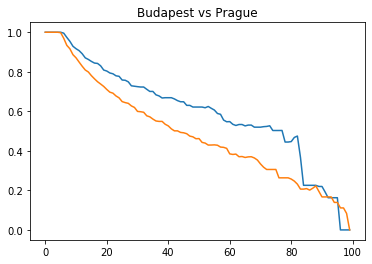

---------------------   Budapest  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.21133865950804198 



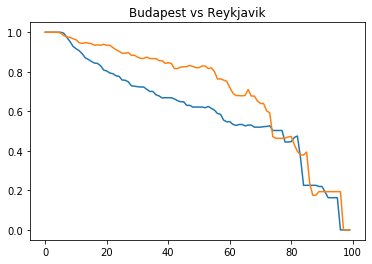

---------------------   Budapest  vs.  Riga   ---------------------
Discrete Frechet distance:  0.3365511108026984 



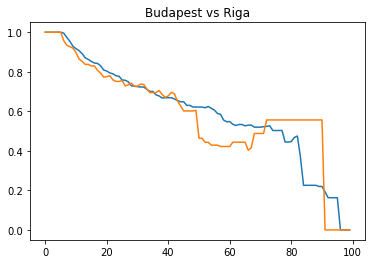

---------------------   Budapest  vs.  Rio   ---------------------
Discrete Frechet distance:  1.639445486183051 



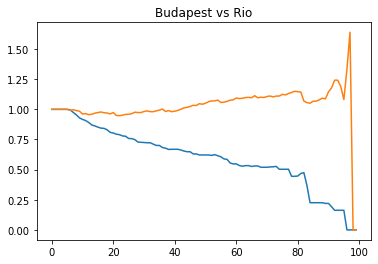

---------------------   Budapest  vs.  Rome   ---------------------
Discrete Frechet distance:  0.2262208430583395 



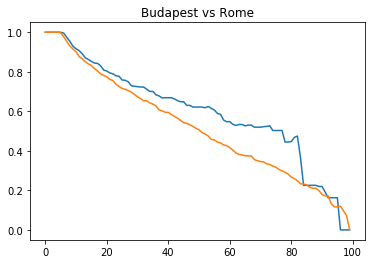

---------------------   Budapest  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.8833447012990394 



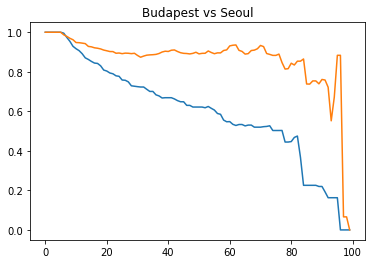

---------------------   Budapest  vs.  Siena   ---------------------
Discrete Frechet distance:  0.21800762130988874 



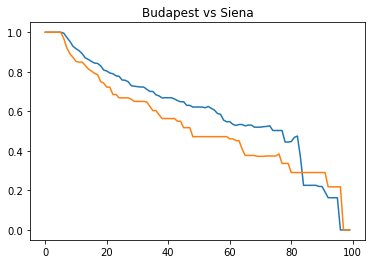

---------------------   Budapest  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.22509318791858465 



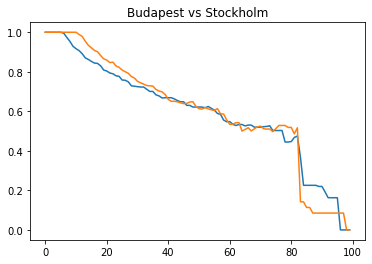

---------------------   Budapest  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.9775496108995354 



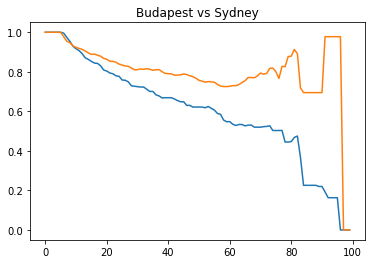

---------------------   Budapest  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.21989112272142924 



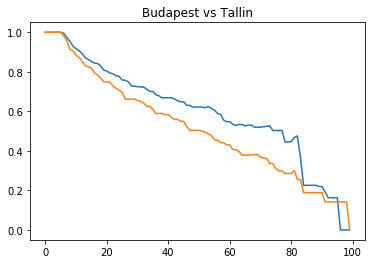

---------------------   Budapest  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.22560399416654264 



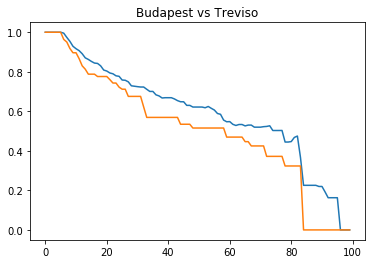

---------------------   Budapest  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.23621820175216157 



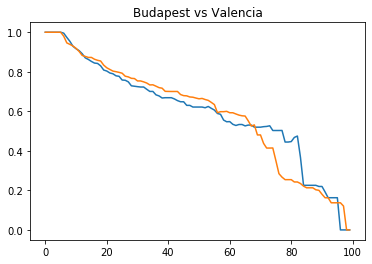

---------------------   Budapest  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.22045467696113208 



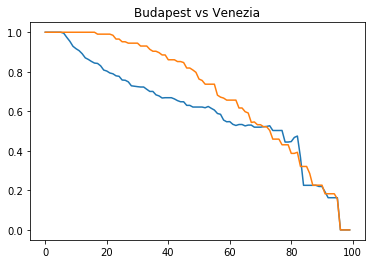

---------------------   Budapest  vs.  Verona   ---------------------
Discrete Frechet distance:  0.222514226385937 



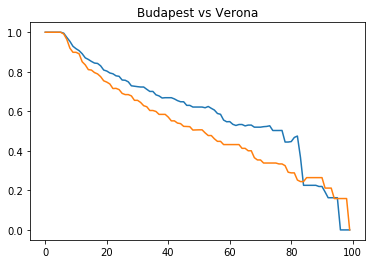

---------------------   Budapest  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.19570547965331442 



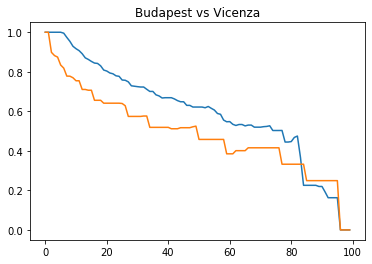

---------------------   Budapest  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.6920582851810589 



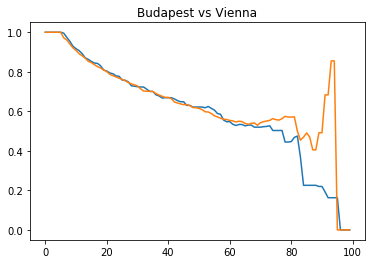

---------------------   Budapest  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.26100214737734473 



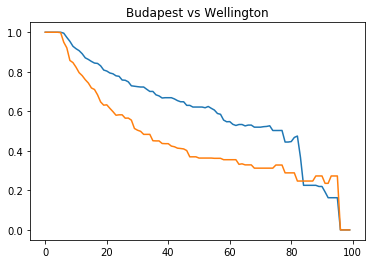

---------------------   Budapest  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.27321200545233043 



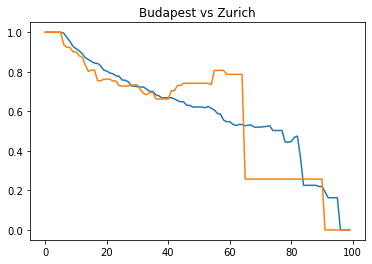

---------------------   Budapest  vs.  Milan   ---------------------
Discrete Frechet distance:  0.13819697420149235 



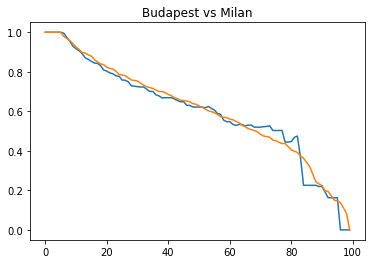

---------------------   Budapest  vs.  London   ---------------------
Discrete Frechet distance:  0.17393860162773817 



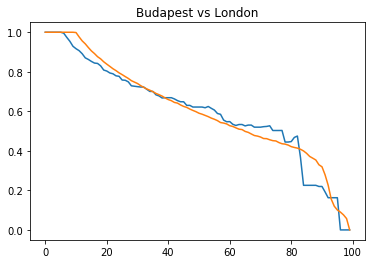

---------------------   Budapest  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.6670520643678925 



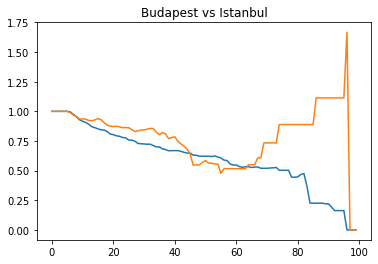

---------------------   Budapest  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.3910796676223469 



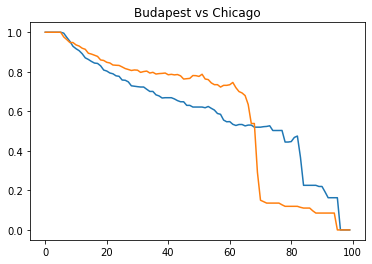

---------------------   Budapest  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.23123435971653516 



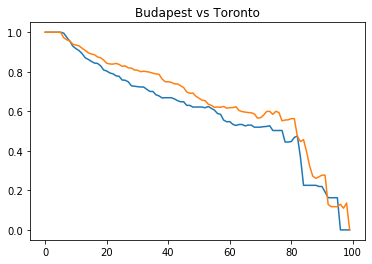

---------------------   Budapest  vs.  Munich   ---------------------
Discrete Frechet distance:  0.20425870419246842 



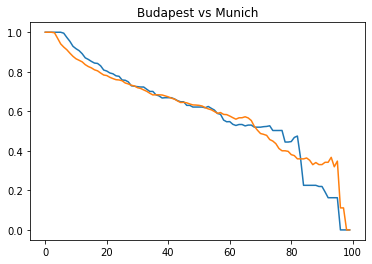

---------------------   Buenos_Aires  vs.  Buenos_Aires   ---------------------
Discrete Frechet distance:  0.0 



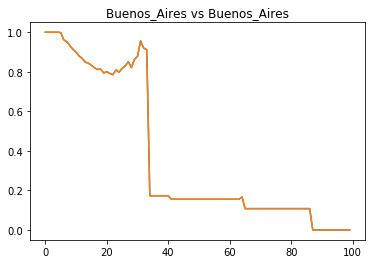

---------------------   Buenos_Aires  vs.  Busan   ---------------------
Discrete Frechet distance:  2.1866352735227927 



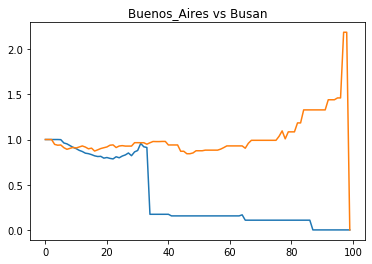

---------------------   Buenos_Aires  vs.  Denver   ---------------------
Discrete Frechet distance:  0.4748677472603551 



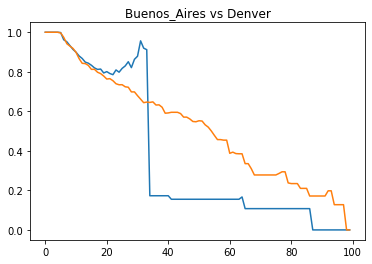

---------------------   Buenos_Aires  vs.  Dublin   ---------------------
Discrete Frechet distance:  0.5708301753162646 



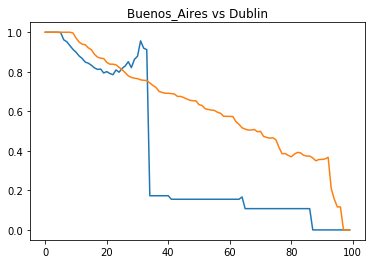

---------------------   Buenos_Aires  vs.  Edinburgh   ---------------------
Discrete Frechet distance:  0.5637897424123459 



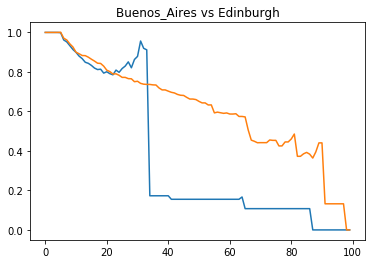

---------------------   Buenos_Aires  vs.  Florence   ---------------------
Discrete Frechet distance:  0.3831560855716539 



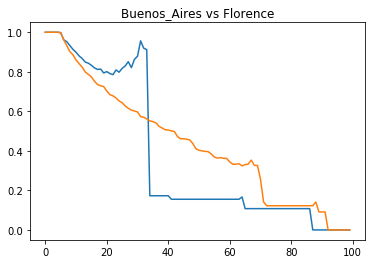

---------------------   Buenos_Aires  vs.  Los_Angeles   ---------------------
Discrete Frechet distance:  0.6342476815093728 



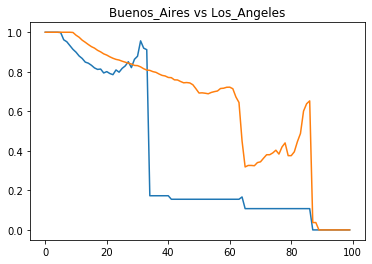

---------------------   Buenos_Aires  vs.  Lyon   ---------------------
Discrete Frechet distance:  0.5038840793771605 



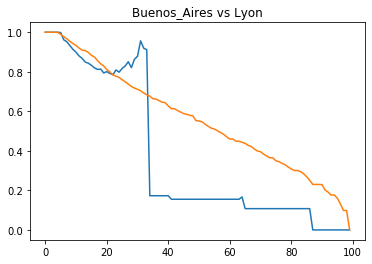

---------------------   Buenos_Aires  vs.  Madrid   ---------------------
Discrete Frechet distance:  0.5039011125123344 



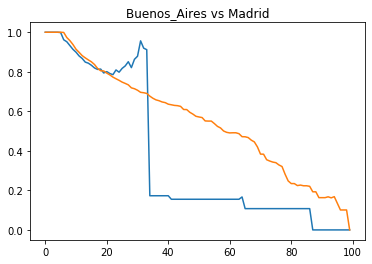

---------------------   Buenos_Aires  vs.  Moscow   ---------------------
Discrete Frechet distance:  0.5405061911258915 



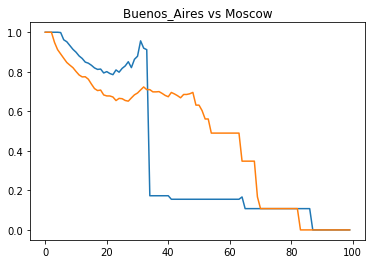

---------------------   Buenos_Aires  vs.  Palermo   ---------------------
Discrete Frechet distance:  1.011525905917469 



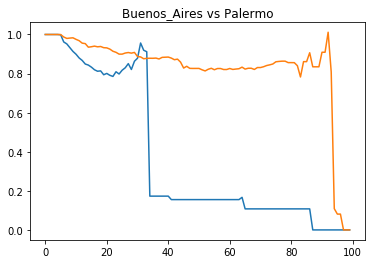

---------------------   Buenos_Aires  vs.  Paris   ---------------------
Discrete Frechet distance:  0.6460057554085679 



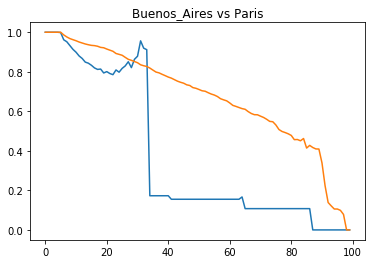

---------------------   Buenos_Aires  vs.  Porto   ---------------------
Discrete Frechet distance:  1.3430873083731827 



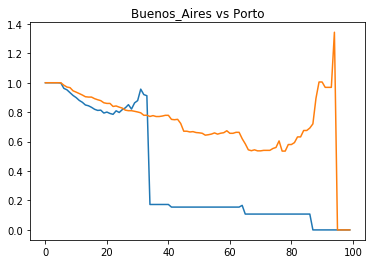

---------------------   Buenos_Aires  vs.  Prague   ---------------------
Discrete Frechet distance:  0.39916523911394874 



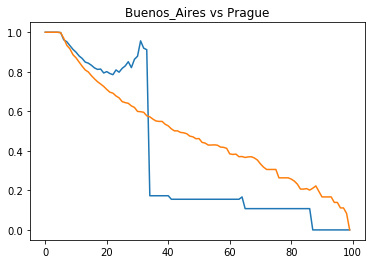

---------------------   Buenos_Aires  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.6940722680478875 



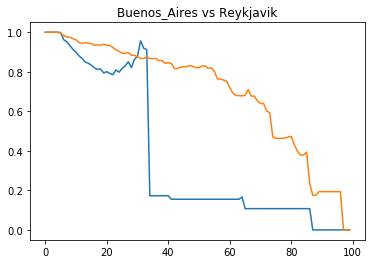

---------------------   Buenos_Aires  vs.  Riga   ---------------------
Discrete Frechet distance:  0.5563612798024404 



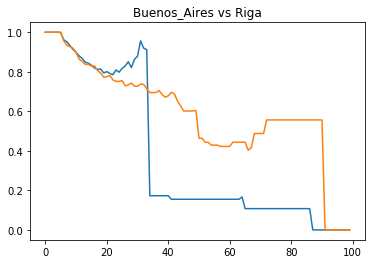

---------------------   Buenos_Aires  vs.  Rio   ---------------------
Discrete Frechet distance:  1.639445486183051 



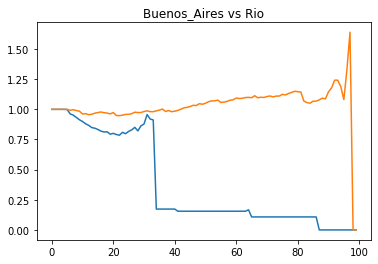

---------------------   Buenos_Aires  vs.  Rome   ---------------------
Discrete Frechet distance:  0.4696993860020504 



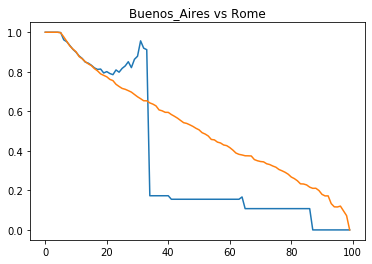

---------------------   Buenos_Aires  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.8833447012990394 



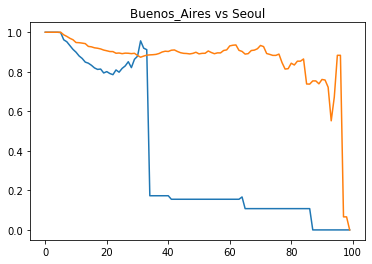

---------------------   Buenos_Aires  vs.  Siena   ---------------------
Discrete Frechet distance:  0.4525812644332934 



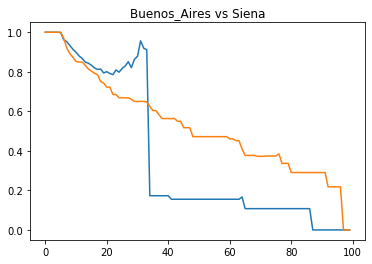

---------------------   Buenos_Aires  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.556025694773981 



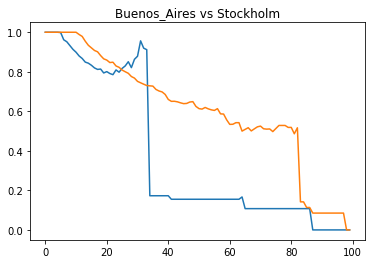

---------------------   Buenos_Aires  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.9775496108995354 



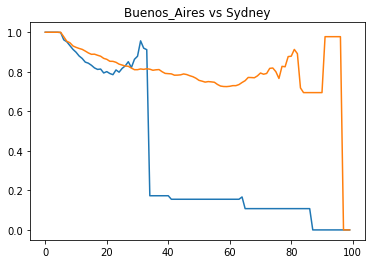

---------------------   Buenos_Aires  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.45280861850871057 



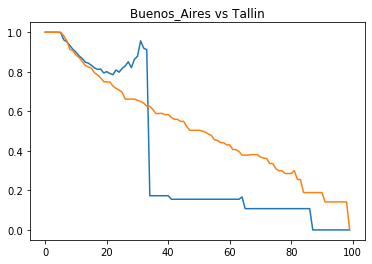

---------------------   Buenos_Aires  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.41408432880205687 



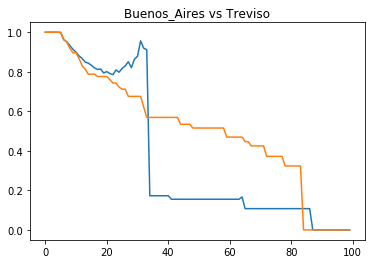

---------------------   Buenos_Aires  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.5612647640212467 



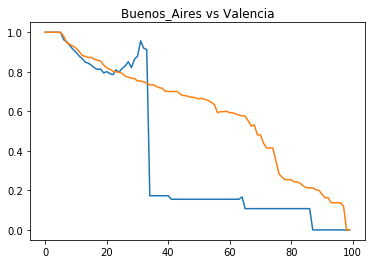

---------------------   Buenos_Aires  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.7406536360917464 



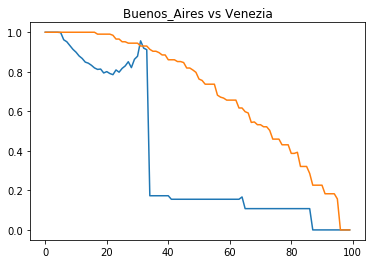

---------------------   Buenos_Aires  vs.  Verona   ---------------------
Discrete Frechet distance:  0.4312535657481664 



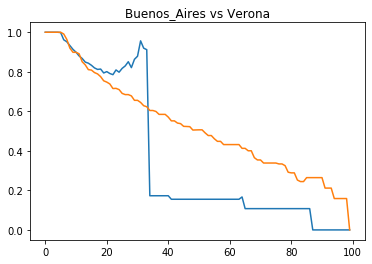

---------------------   Buenos_Aires  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.382306923287016 



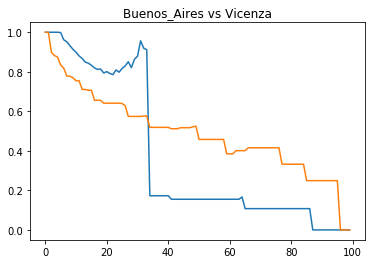

---------------------   Buenos_Aires  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.8549126088300883 



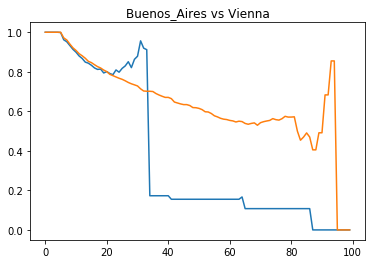

---------------------   Buenos_Aires  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.45769169362768725 



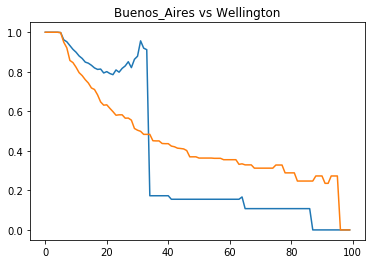

---------------------   Buenos_Aires  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.6520695647860282 



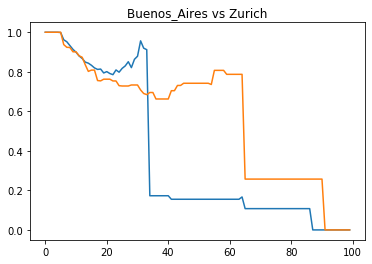

---------------------   Buenos_Aires  vs.  Milan   ---------------------
Discrete Frechet distance:  0.5473981800437844 



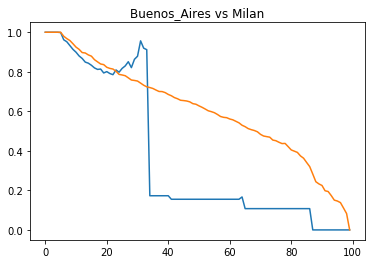

---------------------   Buenos_Aires  vs.  London   ---------------------
Discrete Frechet distance:  0.5338708573691353 



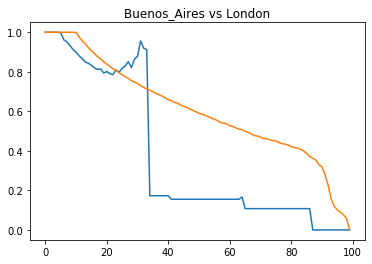

---------------------   Buenos_Aires  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.6670520643678925 



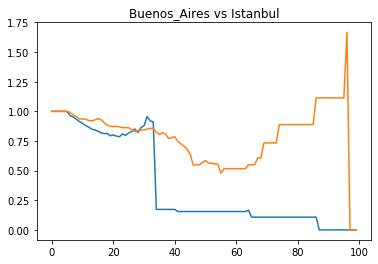

---------------------   Buenos_Aires  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.6324022533301106 



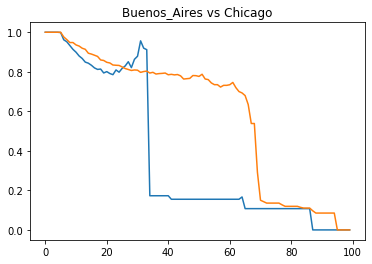

---------------------   Buenos_Aires  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.624795575015226 



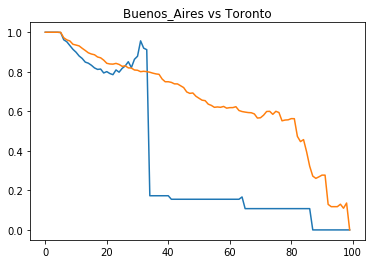

---------------------   Buenos_Aires  vs.  Munich   ---------------------
Discrete Frechet distance:  0.5184281292519034 



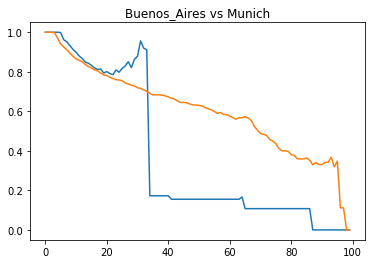

---------------------   Busan  vs.  Busan   ---------------------
Discrete Frechet distance:  0.0 



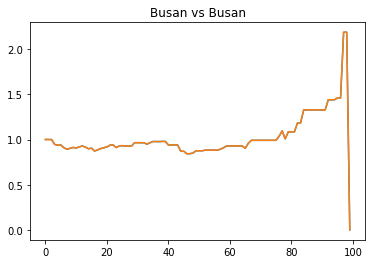

---------------------   Busan  vs.  Denver   ---------------------
Discrete Frechet distance:  2.1866352735227927 



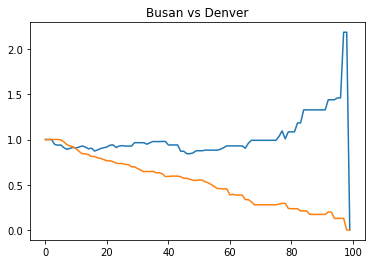

---------------------   Busan  vs.  Dublin   ---------------------
Discrete Frechet distance:  2.1866352735227927 



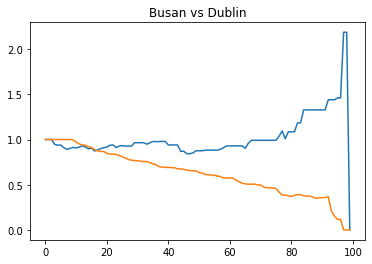

---------------------   Busan  vs.  Edinburgh   ---------------------
Discrete Frechet distance:  2.1866352735227927 



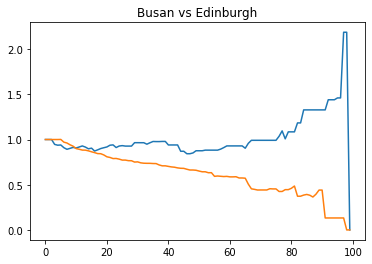

---------------------   Busan  vs.  Florence   ---------------------
Discrete Frechet distance:  2.1866352735227927 



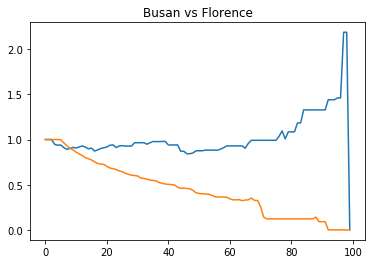

---------------------   Busan  vs.  Los_Angeles   ---------------------
Discrete Frechet distance:  2.1866352735227927 



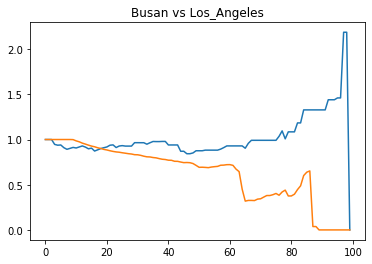

---------------------   Busan  vs.  Lyon   ---------------------
Discrete Frechet distance:  2.0880968835195968 



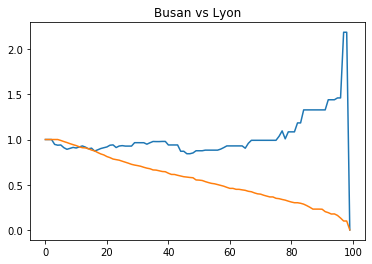

---------------------   Busan  vs.  Madrid   ---------------------
Discrete Frechet distance:  2.085722054729933 



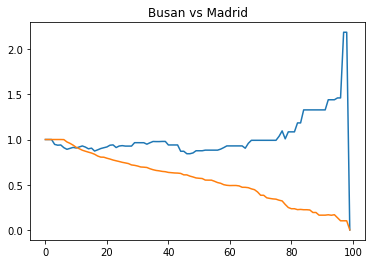

---------------------   Busan  vs.  Moscow   ---------------------
Discrete Frechet distance:  2.1866352735227927 



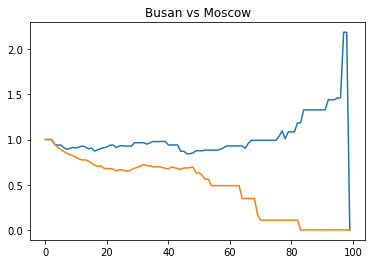

---------------------   Busan  vs.  Palermo   ---------------------
Discrete Frechet distance:  2.1866352735227927 



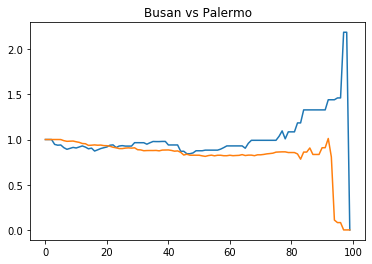

---------------------   Busan  vs.  Paris   ---------------------
Discrete Frechet distance:  2.1866352735227927 



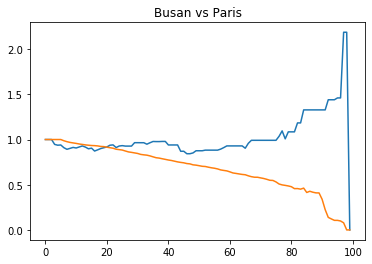

---------------------   Busan  vs.  Porto   ---------------------
Discrete Frechet distance:  2.1866352735227927 



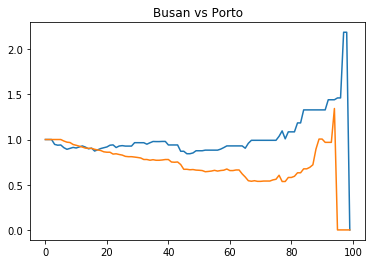

---------------------   Busan  vs.  Prague   ---------------------
Discrete Frechet distance:  2.1031806600522005 



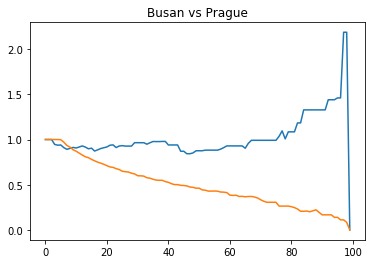

---------------------   Busan  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  2.1866352735227927 



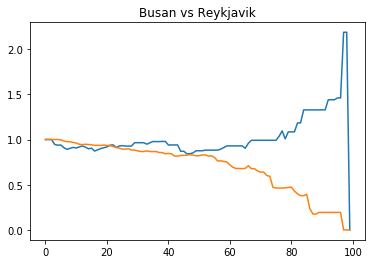

---------------------   Busan  vs.  Riga   ---------------------
Discrete Frechet distance:  2.1866352735227927 



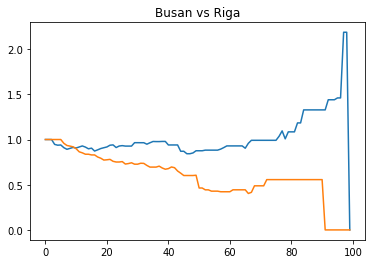

---------------------   Busan  vs.  Rio   ---------------------
Discrete Frechet distance:  1.1399195863607712 



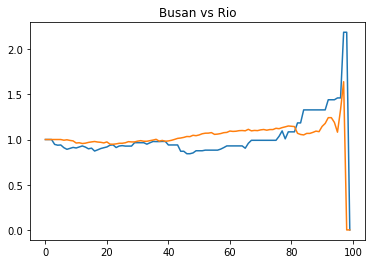

---------------------   Busan  vs.  Rome   ---------------------
Discrete Frechet distance:  2.114422516581327 



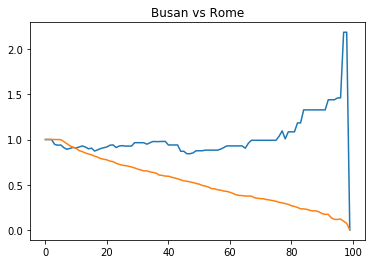

---------------------   Busan  vs.  Seoul   ---------------------
Discrete Frechet distance:  2.1206285649288454 



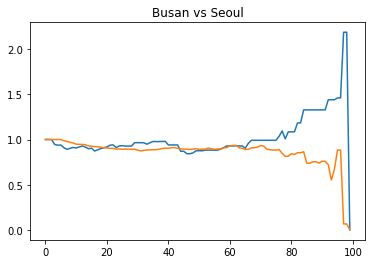

---------------------   Busan  vs.  Siena   ---------------------
Discrete Frechet distance:  2.1866352735227927 



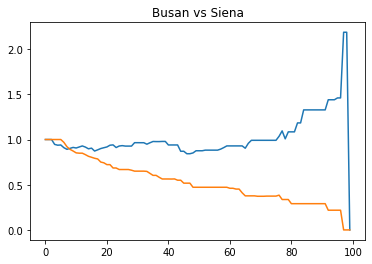

---------------------   Busan  vs.  Stockholm   ---------------------
Discrete Frechet distance:  2.1866352735227927 



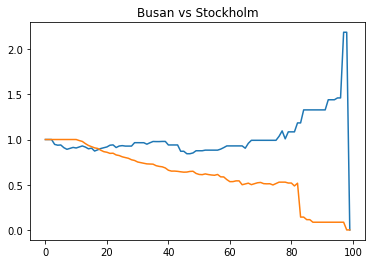

---------------------   Busan  vs.  Sydney   ---------------------
Discrete Frechet distance:  2.1866352735227927 



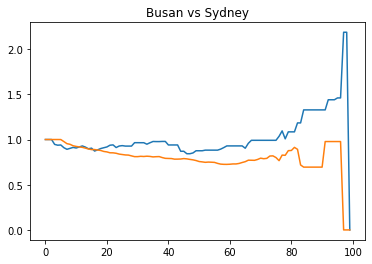

---------------------   Busan  vs.  Tallin   ---------------------
Discrete Frechet distance:  2.044977849128433 



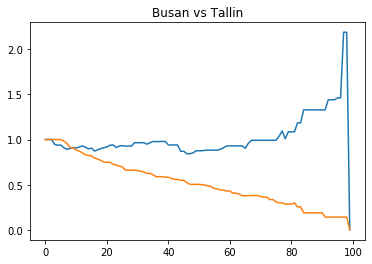

---------------------   Busan  vs.  Treviso   ---------------------
Discrete Frechet distance:  2.1866352735227927 



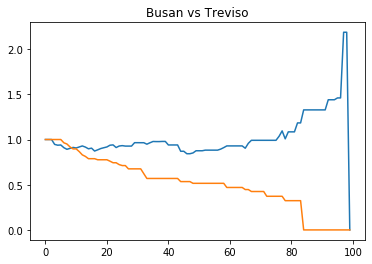

---------------------   Busan  vs.  Valencia   ---------------------
Discrete Frechet distance:  2.1866352735227927 



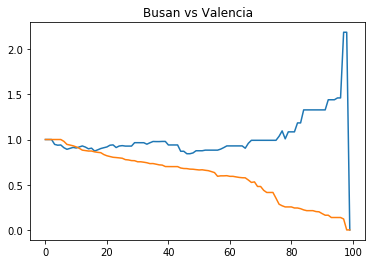

---------------------   Busan  vs.  Venezia   ---------------------
Discrete Frechet distance:  2.1866352735227927 



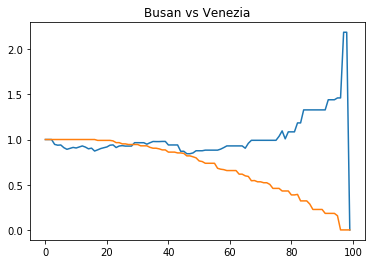

---------------------   Busan  vs.  Verona   ---------------------
Discrete Frechet distance:  2.0279329052802293 



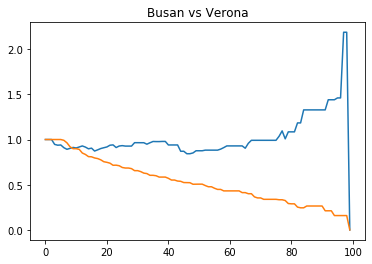

---------------------   Busan  vs.  Vicenza   ---------------------
Discrete Frechet distance:  2.1866352735227927 



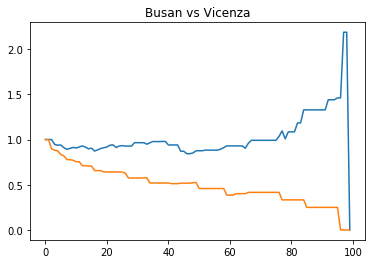

---------------------   Busan  vs.  Vienna   ---------------------
Discrete Frechet distance:  2.1866352735227927 



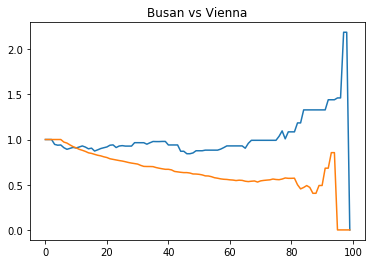

---------------------   Busan  vs.  Wellington   ---------------------
Discrete Frechet distance:  2.1866352735227927 



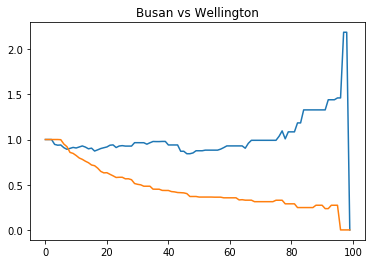

---------------------   Busan  vs.  Zurich   ---------------------
Discrete Frechet distance:  2.1866352735227927 



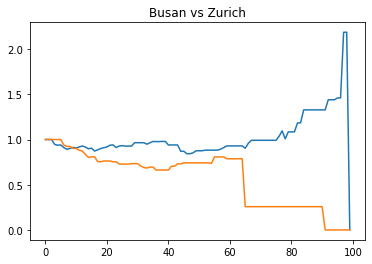

---------------------   Busan  vs.  Milan   ---------------------
Discrete Frechet distance:  2.103853432895051 



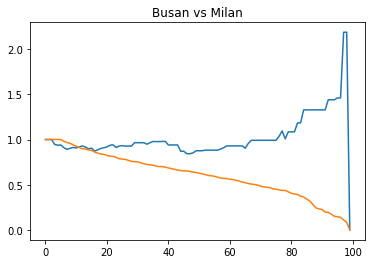

---------------------   Busan  vs.  London   ---------------------
Discrete Frechet distance:  2.129337385268464 



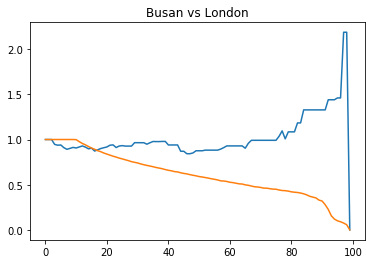

---------------------   Busan  vs.  Istanbul   ---------------------
Discrete Frechet distance:  2.0663897771804103 



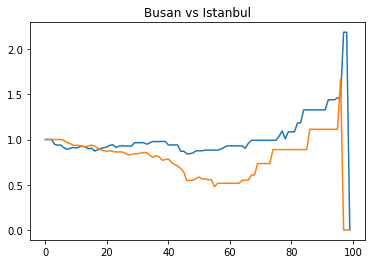

---------------------   Busan  vs.  Chicago   ---------------------
Discrete Frechet distance:  2.1866352735227927 



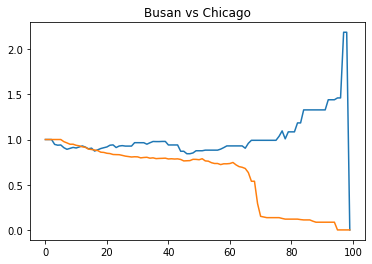

---------------------   Busan  vs.  Toronto   ---------------------
Discrete Frechet distance:  2.076905150979913 



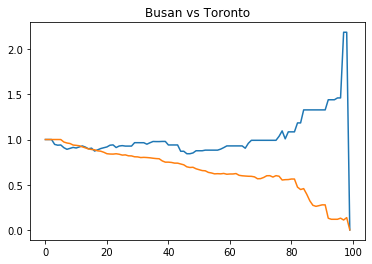

---------------------   Busan  vs.  Munich   ---------------------
Discrete Frechet distance:  2.1866352735227927 



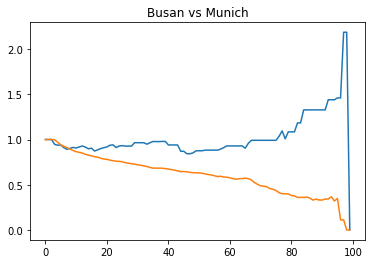

---------------------   Denver  vs.  Denver   ---------------------
Discrete Frechet distance:  0.0 



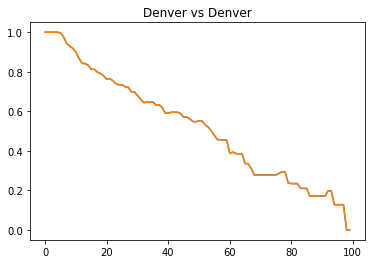

---------------------   Denver  vs.  Dublin   ---------------------
Discrete Frechet distance:  0.2301038354877668 



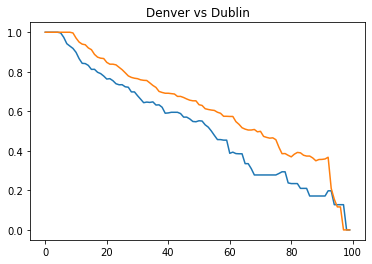

---------------------   Denver  vs.  Edinburgh   ---------------------
Discrete Frechet distance:  0.26916162697731794 



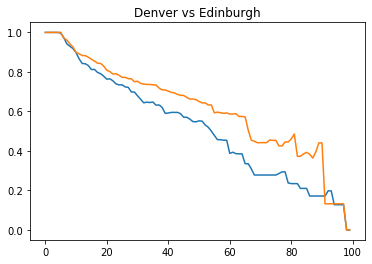

---------------------   Denver  vs.  Florence   ---------------------
Discrete Frechet distance:  0.1978516857031274 



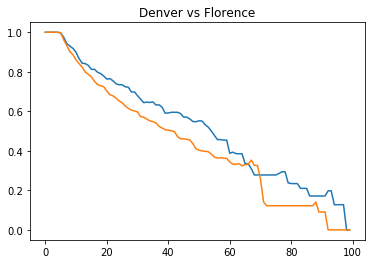

---------------------   Denver  vs.  Los_Angeles   ---------------------
Discrete Frechet distance:  0.4811280771143679 



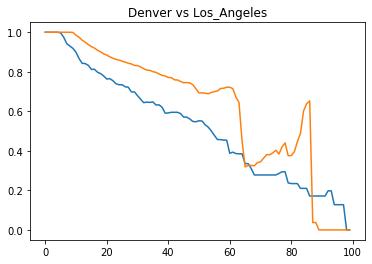

---------------------   Denver  vs.  Lyon   ---------------------
Discrete Frechet distance:  0.1312760468655258 



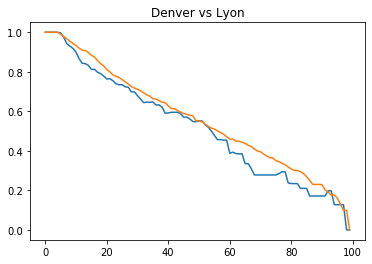

---------------------   Denver  vs.  Madrid   ---------------------
Discrete Frechet distance:  0.16716237380786297 



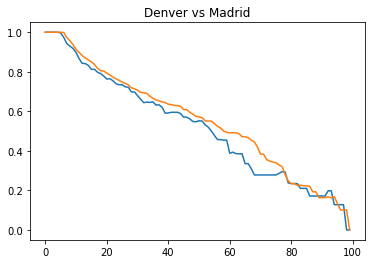

---------------------   Denver  vs.  Moscow   ---------------------
Discrete Frechet distance:  0.21012844847344478 



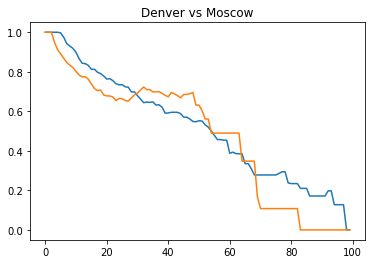

---------------------   Denver  vs.  Palermo   ---------------------
Discrete Frechet distance:  0.8136742202143417 



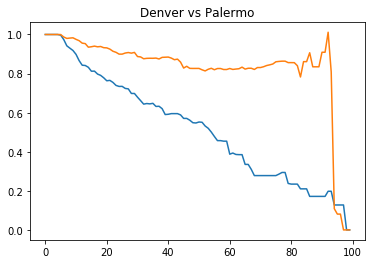

---------------------   Denver  vs.  Paris   ---------------------
Discrete Frechet distance:  0.3049201343628928 



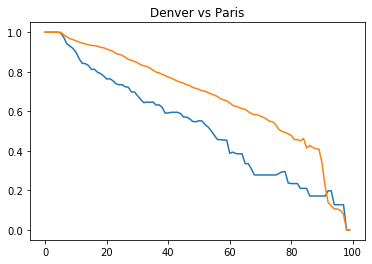

---------------------   Denver  vs.  Porto   ---------------------
Discrete Frechet distance:  1.215453172604065 



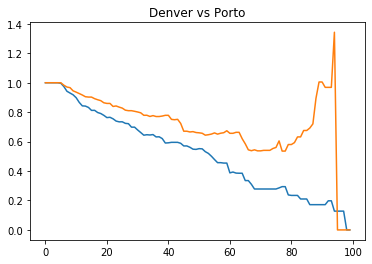

---------------------   Denver  vs.  Prague   ---------------------
Discrete Frechet distance:  0.10802968554783055 



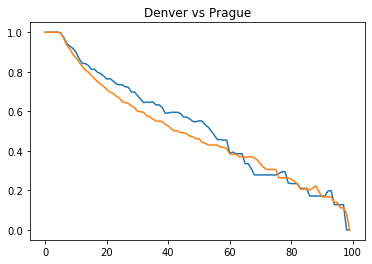

---------------------   Denver  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.3991582165279076 



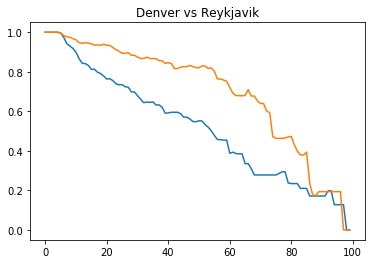

---------------------   Denver  vs.  Riga   ---------------------
Discrete Frechet distance:  0.38480204470692847 



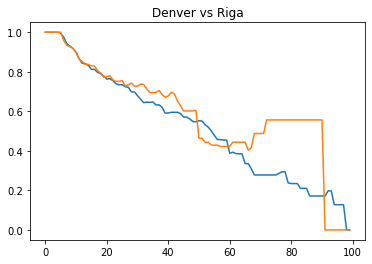

---------------------   Denver  vs.  Rio   ---------------------
Discrete Frechet distance:  1.5118113504139332 



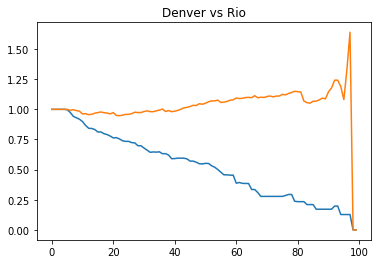

---------------------   Denver  vs.  Rome   ---------------------
Discrete Frechet distance:  0.07792846826341876 



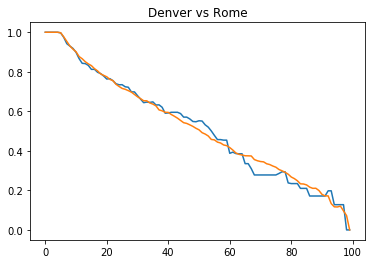

---------------------   Denver  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.7557105655299217 



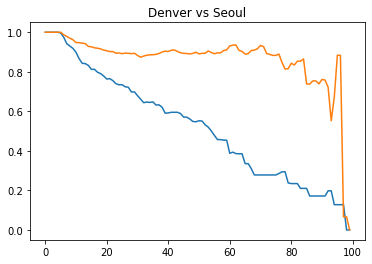

---------------------   Denver  vs.  Siena   ---------------------
Discrete Frechet distance:  0.12763413576911772 



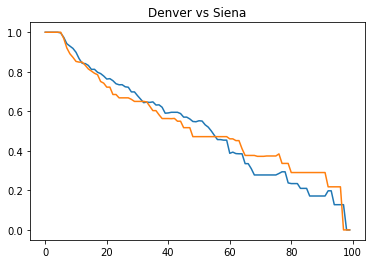

---------------------   Denver  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.28417122941132805 



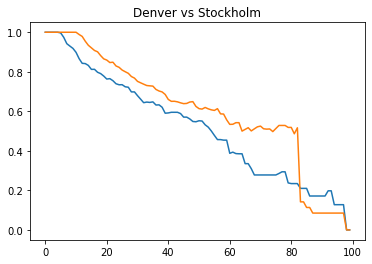

---------------------   Denver  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.8499154751304177 



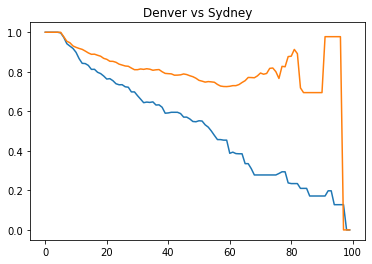

---------------------   Denver  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.14165742439435974 



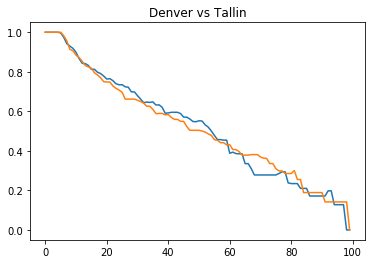

---------------------   Denver  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.21012844847344478 



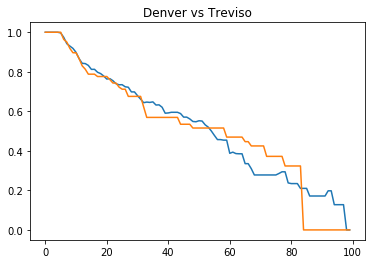

---------------------   Denver  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.2532084310218644 



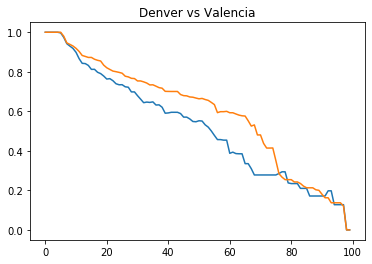

---------------------   Denver  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.2947348536656156 



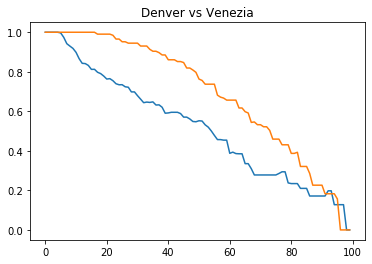

---------------------   Denver  vs.  Verona   ---------------------
Discrete Frechet distance:  0.1587023682425636 



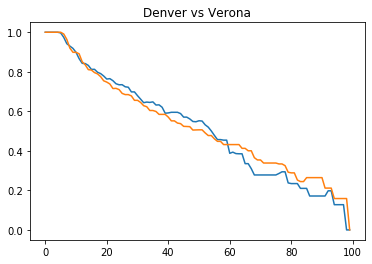

---------------------   Denver  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.1639385112881927 



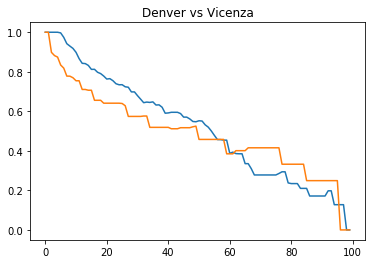

---------------------   Denver  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.7272784730609706 



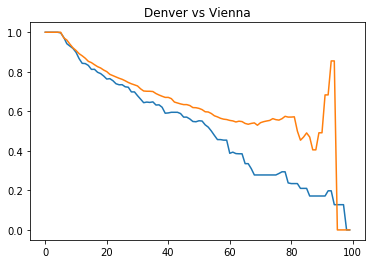

---------------------   Denver  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.1966731453453643 



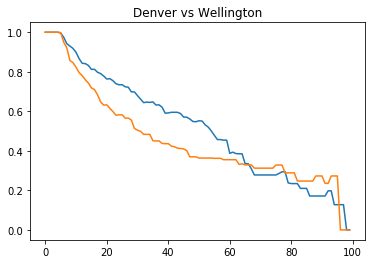

---------------------   Denver  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.4019189441551526 



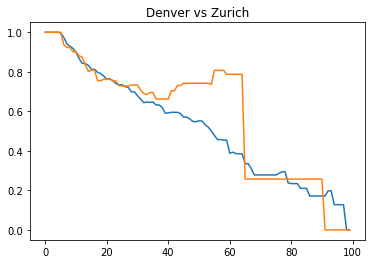

---------------------   Denver  vs.  Milan   ---------------------
Discrete Frechet distance:  0.22482985566677327 



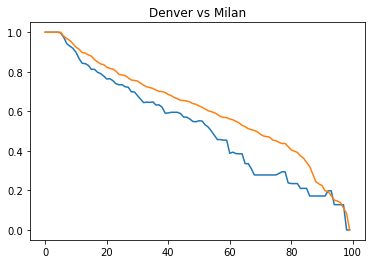

---------------------   Denver  vs.  London   ---------------------
Discrete Frechet distance:  0.20009836410124252 



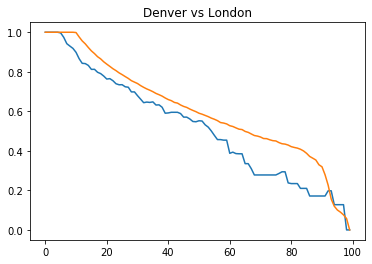

---------------------   Denver  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.5394179285987748 



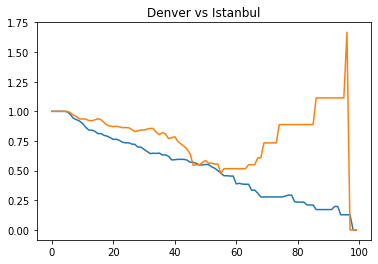

---------------------   Denver  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.35267950379499285 



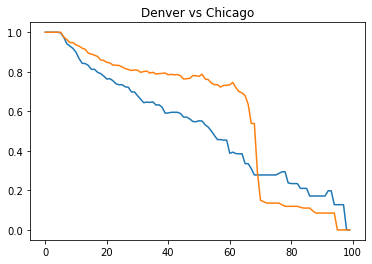

---------------------   Denver  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.3285814002396243 



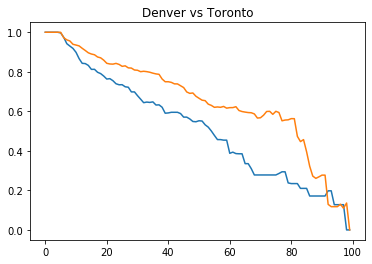

---------------------   Denver  vs.  Munich   ---------------------
Discrete Frechet distance:  0.24572429124936757 



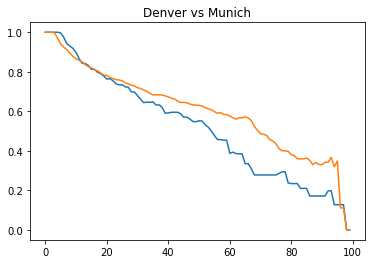

---------------------   Dublin  vs.  Dublin   ---------------------
Discrete Frechet distance:  0.0 



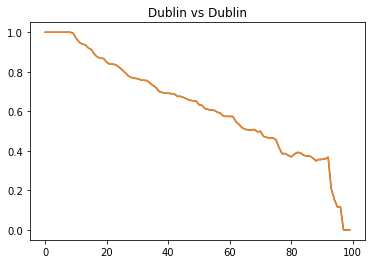

---------------------   Dublin  vs.  Edinburgh   ---------------------
Discrete Frechet distance:  0.23542086849767582 



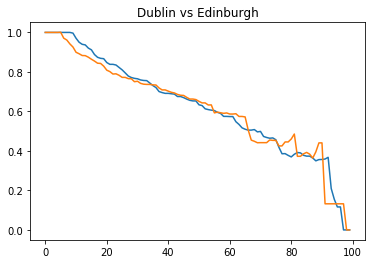

---------------------   Dublin  vs.  Florence   ---------------------
Discrete Frechet distance:  0.3676371271195406 



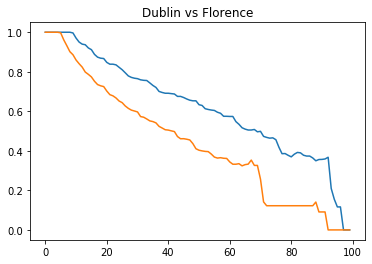

---------------------   Dublin  vs.  Los_Angeles   ---------------------
Discrete Frechet distance:  0.3676371271195406 



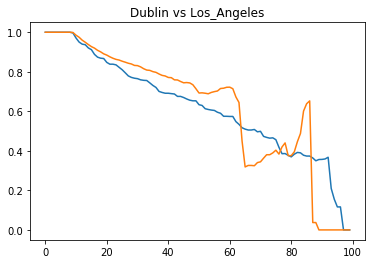

---------------------   Dublin  vs.  Lyon   ---------------------
Discrete Frechet distance:  0.17665337783022173 



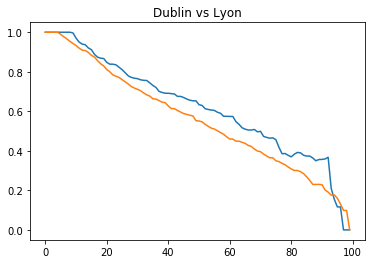

---------------------   Dublin  vs.  Madrid   ---------------------
Discrete Frechet distance:  0.2001727748021041 



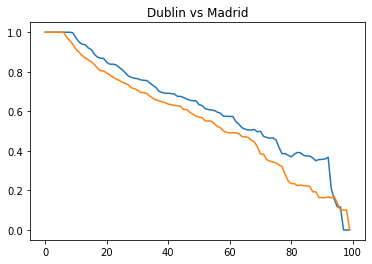

---------------------   Dublin  vs.  Moscow   ---------------------
Discrete Frechet distance:  0.3908490733181757 



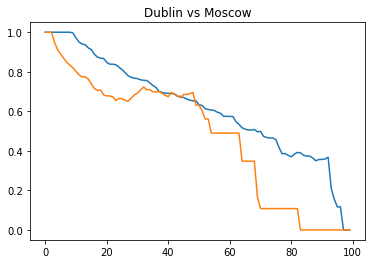

---------------------   Dublin  vs.  Palermo   ---------------------
Discrete Frechet distance:  0.6438887787979284 



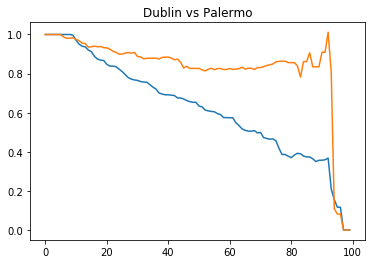

---------------------   Dublin  vs.  Paris   ---------------------
Discrete Frechet distance:  0.22905865141918733 



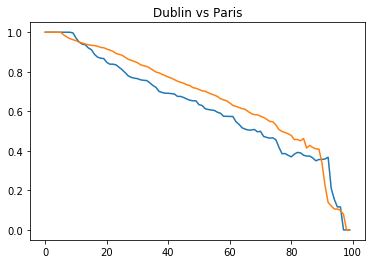

---------------------   Dublin  vs.  Porto   ---------------------
Discrete Frechet distance:  1.1879418156021375 



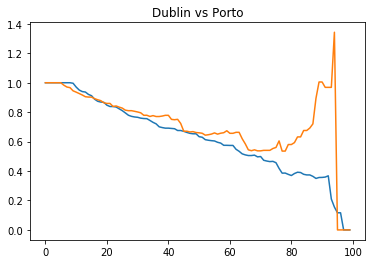

---------------------   Dublin  vs.  Prague   ---------------------
Discrete Frechet distance:  0.20072790017830983 



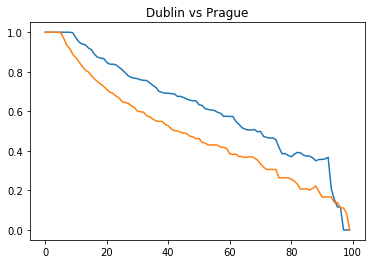

---------------------   Dublin  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.21611195419339324 



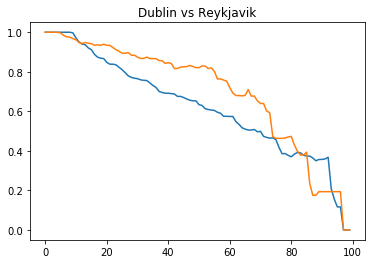

---------------------   Dublin  vs.  Riga   ---------------------
Discrete Frechet distance:  0.3676371271195406 



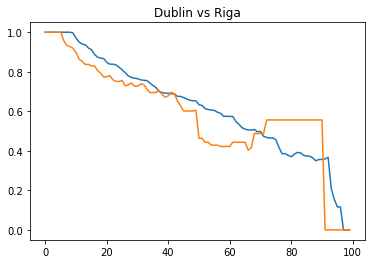

---------------------   Dublin  vs.  Rio   ---------------------
Discrete Frechet distance:  1.639445486183051 



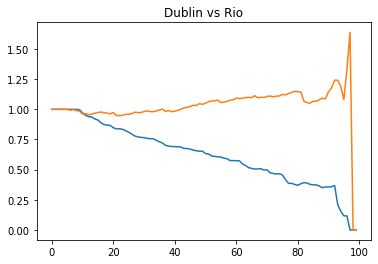

---------------------   Dublin  vs.  Rome   ---------------------
Discrete Frechet distance:  0.19540584632849994 



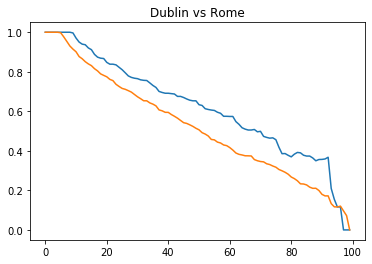

---------------------   Dublin  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.7669855817207671 



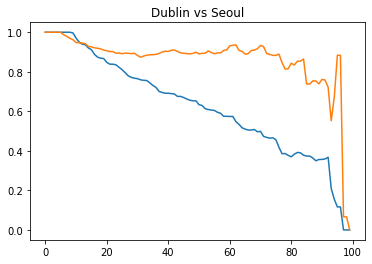

---------------------   Dublin  vs.  Siena   ---------------------
Discrete Frechet distance:  0.18130381775025034 



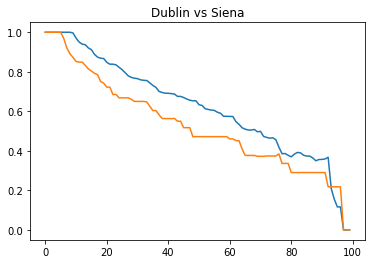

---------------------   Dublin  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.28248034103431285 



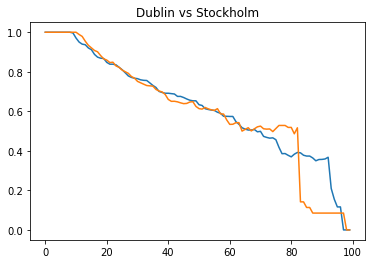

---------------------   Dublin  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.8611904913212631 



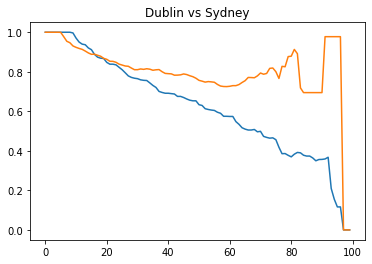

---------------------   Dublin  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.22597970272518086 



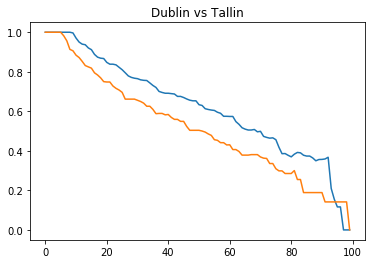

---------------------   Dublin  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.3778318737723254 



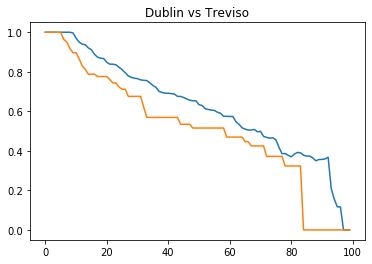

---------------------   Dublin  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.20501567790015007 



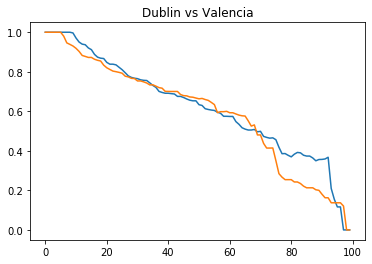

---------------------   Dublin  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.1962371208675875 



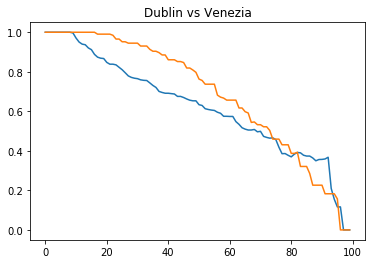

---------------------   Dublin  vs.  Verona   ---------------------
Discrete Frechet distance:  0.1587023682425636 



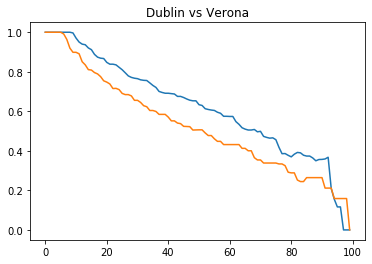

---------------------   Dublin  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.2322892275751265 



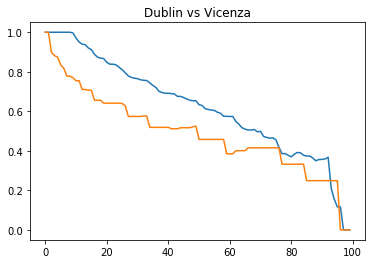

---------------------   Dublin  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.6997671160590432 



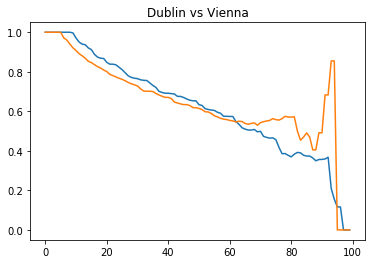

---------------------   Dublin  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.28651060108077714 



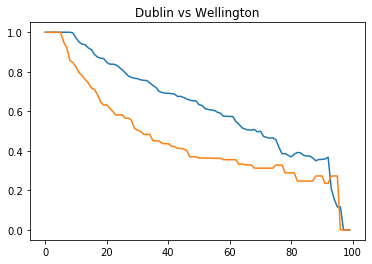

---------------------   Dublin  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.3676371271195406 



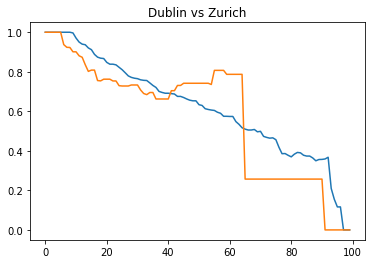

---------------------   Dublin  vs.  Milan   ---------------------
Discrete Frechet distance:  0.1733612946980087 



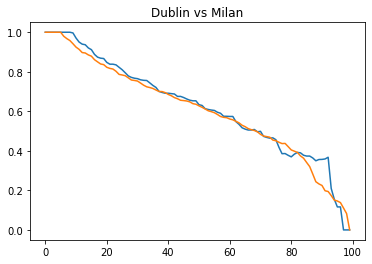

---------------------   Dublin  vs.  London   ---------------------
Discrete Frechet distance:  0.14108463869318402 



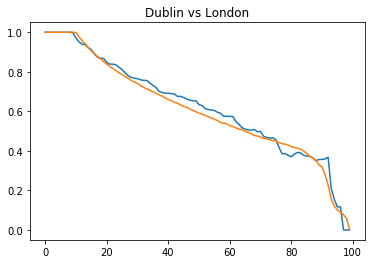

---------------------   Dublin  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.5506929447896203 



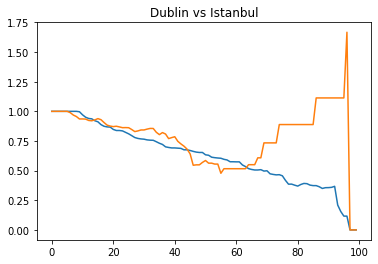

---------------------   Dublin  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.3486149230925826 



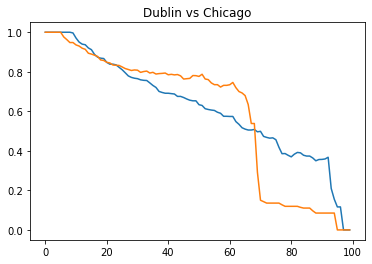

---------------------   Dublin  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.23839516330152918 



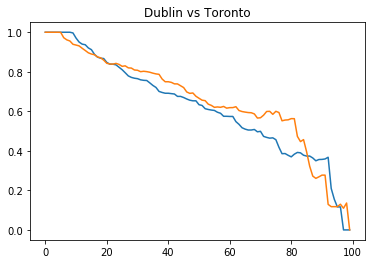

---------------------   Dublin  vs.  Munich   ---------------------
Discrete Frechet distance:  0.23175769559837 



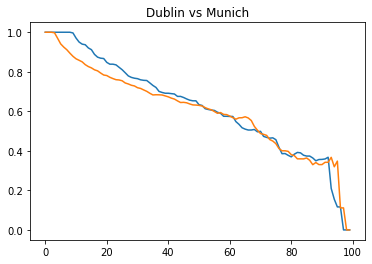

---------------------   Edinburgh  vs.  Edinburgh   ---------------------
Discrete Frechet distance:  0.0 



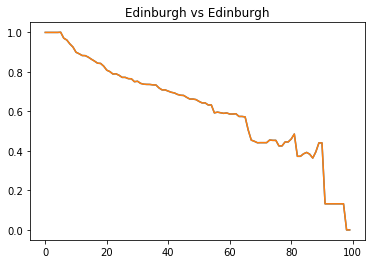

---------------------   Edinburgh  vs.  Florence   ---------------------
Discrete Frechet distance:  0.36310407378792076 



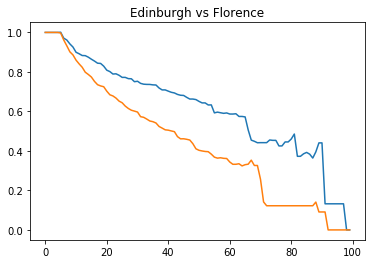

---------------------   Edinburgh  vs.  Los_Angeles   ---------------------
Discrete Frechet distance:  0.44072086207282996 



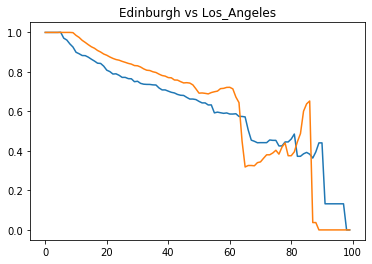

---------------------   Edinburgh  vs.  Lyon   ---------------------
Discrete Frechet distance:  0.21174944019609018 



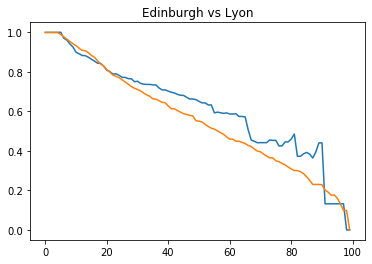

---------------------   Edinburgh  vs.  Madrid   ---------------------
Discrete Frechet distance:  0.2775056247325857 



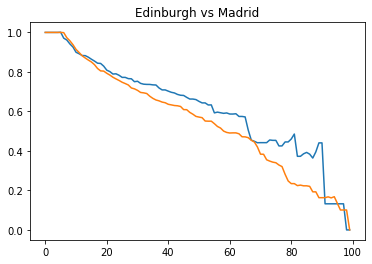

---------------------   Edinburgh  vs.  Moscow   ---------------------
Discrete Frechet distance:  0.44072086207282996 



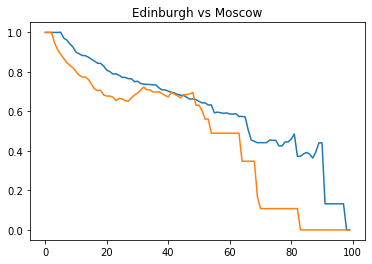

---------------------   Edinburgh  vs.  Palermo   ---------------------
Discrete Frechet distance:  0.8793096472956042 



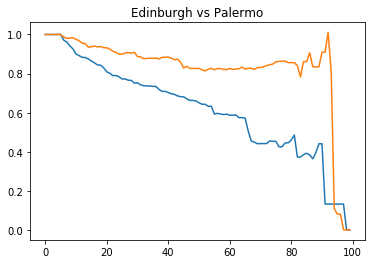

---------------------   Edinburgh  vs.  Paris   ---------------------
Discrete Frechet distance:  0.14113894626421442 



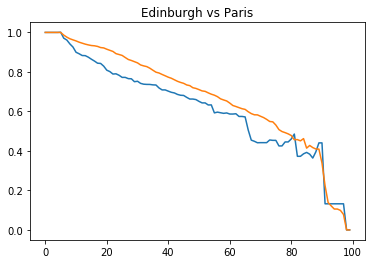

---------------------   Edinburgh  vs.  Porto   ---------------------
Discrete Frechet distance:  1.210871049751318 



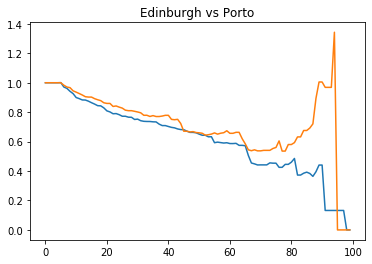

---------------------   Edinburgh  vs.  Prague   ---------------------
Discrete Frechet distance:  0.2738116351315992 



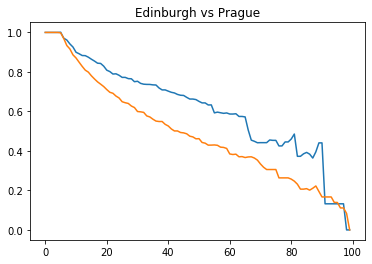

---------------------   Edinburgh  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.2471226994235223 



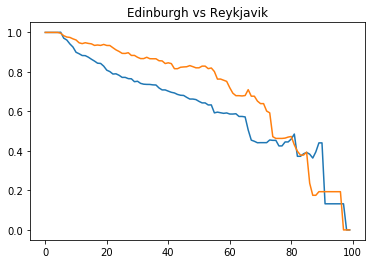

---------------------   Edinburgh  vs.  Riga   ---------------------
Discrete Frechet distance:  0.2042211980706572 



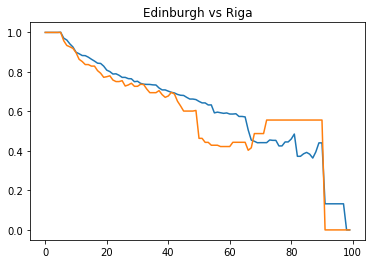

---------------------   Edinburgh  vs.  Rio   ---------------------
Discrete Frechet distance:  1.5072292275611863 



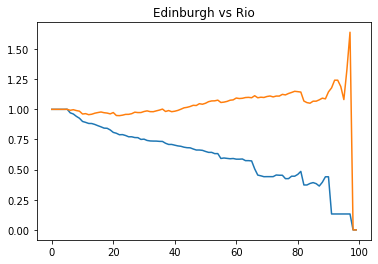

---------------------   Edinburgh  vs.  Rome   ---------------------
Discrete Frechet distance:  0.26081035395723157 



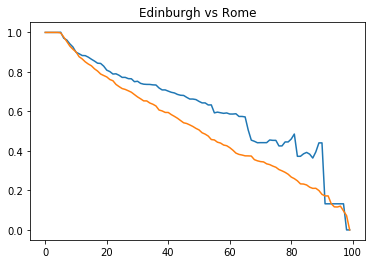

---------------------   Edinburgh  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.7511284426771746 



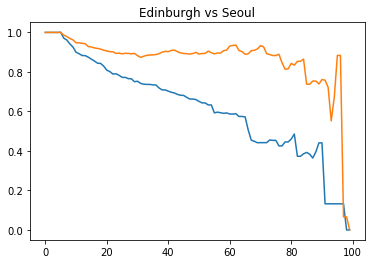

---------------------   Edinburgh  vs.  Siena   ---------------------
Discrete Frechet distance:  0.19541884243373148 



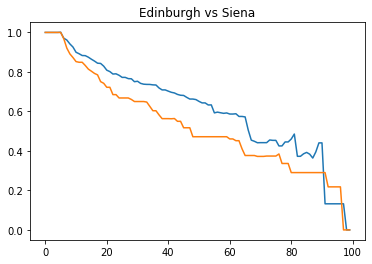

---------------------   Edinburgh  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.3555640759876022 



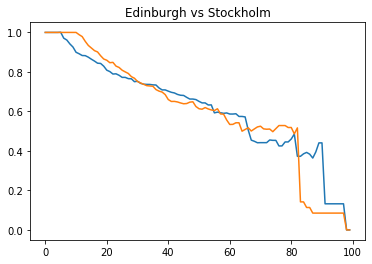

---------------------   Edinburgh  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.8453333522776706 



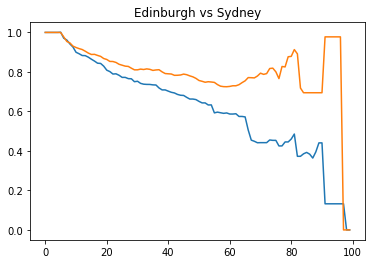

---------------------   Edinburgh  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.2518442962136087 



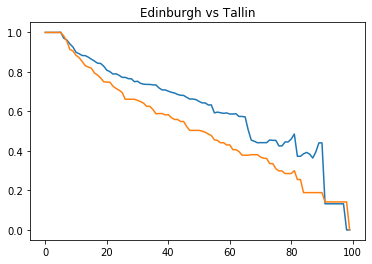

---------------------   Edinburgh  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.44072086207282996 



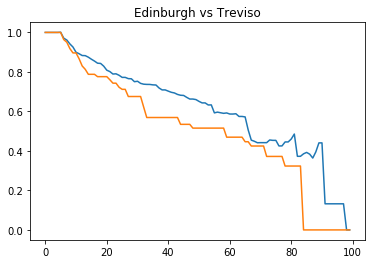

---------------------   Edinburgh  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.26021221599911926 



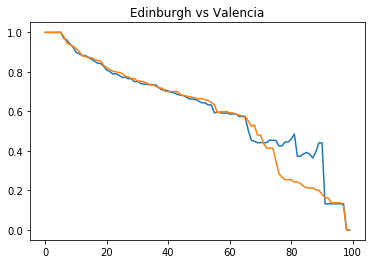

---------------------   Edinburgh  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.21441562857179625 



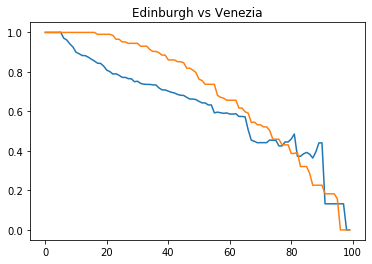

---------------------   Edinburgh  vs.  Verona   ---------------------
Discrete Frechet distance:  0.19685476962340098 



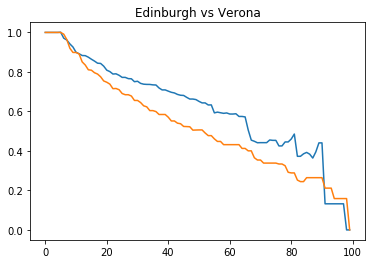

---------------------   Edinburgh  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.21780607880649083 



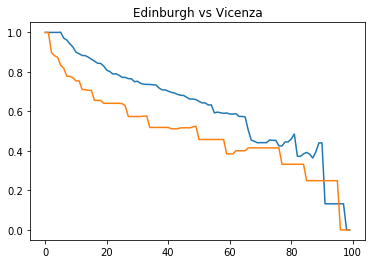

---------------------   Edinburgh  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.7226963502082235 



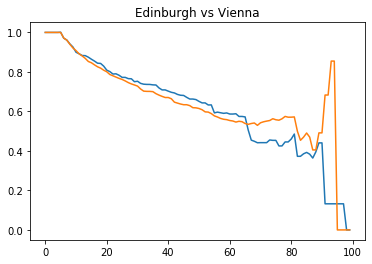

---------------------   Edinburgh  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.2929694697562239 



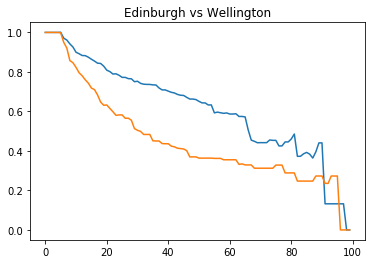

---------------------   Edinburgh  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.3151028335938448 



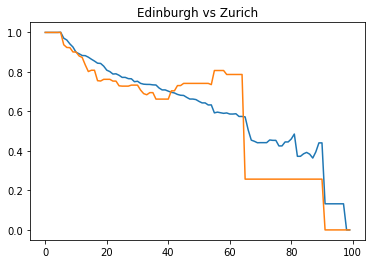

---------------------   Edinburgh  vs.  Milan   ---------------------
Discrete Frechet distance:  0.21586193616727958 



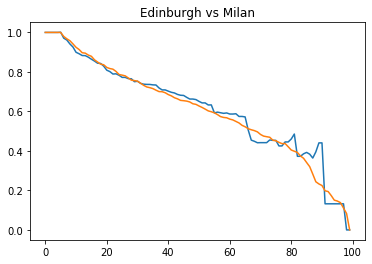

---------------------   Edinburgh  vs.  London   ---------------------
Discrete Frechet distance:  0.14669213047375165 



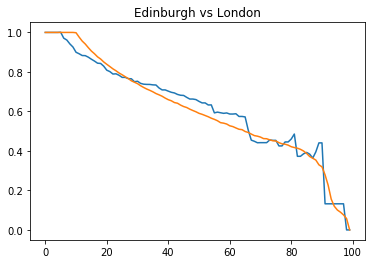

---------------------   Edinburgh  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.5348358057460278 



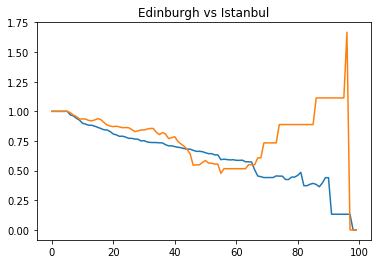

---------------------   Edinburgh  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.36611150972683115 



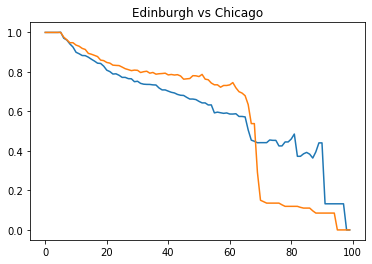

---------------------   Edinburgh  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.1721976125625464 



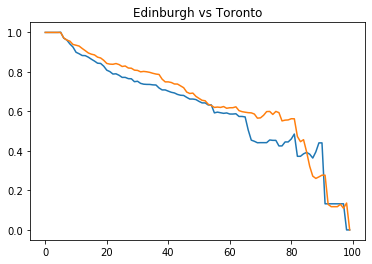

---------------------   Edinburgh  vs.  Munich   ---------------------
Discrete Frechet distance:  0.234896769219633 



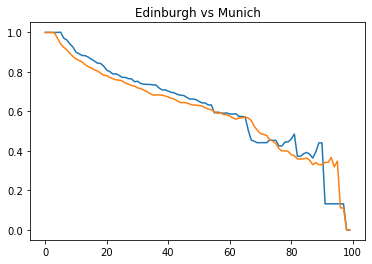

---------------------   Florence  vs.  Florence   ---------------------
Discrete Frechet distance:  0.0 



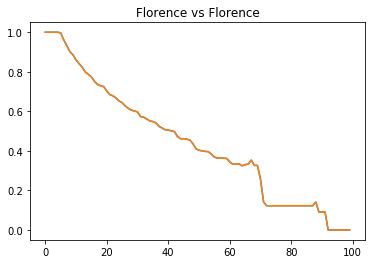

---------------------   Florence  vs.  Los_Angeles   ---------------------
Discrete Frechet distance:  0.5303277547494847 



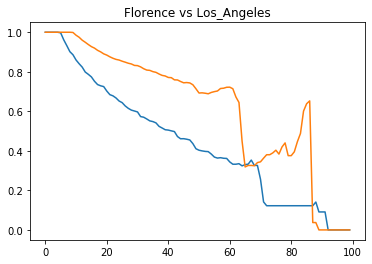

---------------------   Florence  vs.  Lyon   ---------------------
Discrete Frechet distance:  0.25165188774338343 



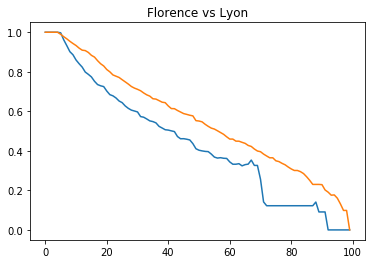

---------------------   Florence  vs.  Madrid   ---------------------
Discrete Frechet distance:  0.24150693186107497 



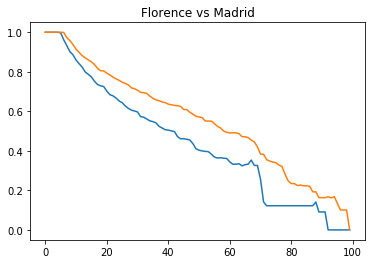

---------------------   Florence  vs.  Moscow   ---------------------
Discrete Frechet distance:  0.2590039104793794 



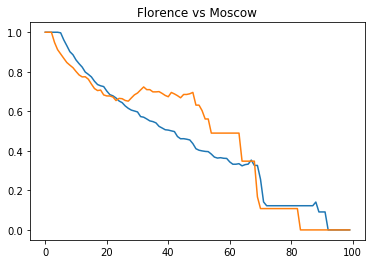

---------------------   Florence  vs.  Palermo   ---------------------
Discrete Frechet distance:  1.011525905917469 



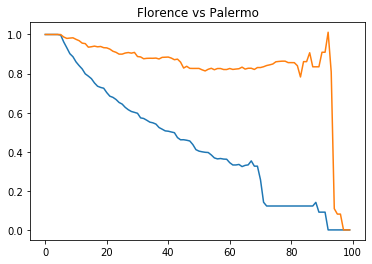

---------------------   Florence  vs.  Paris   ---------------------
Discrete Frechet distance:  0.43740935695091643 



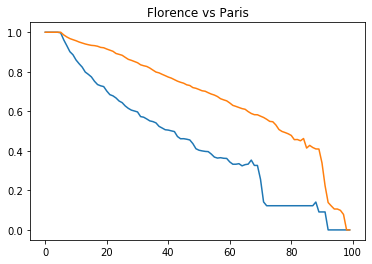

---------------------   Florence  vs.  Porto   ---------------------
Discrete Frechet distance:  1.3430873083731827 



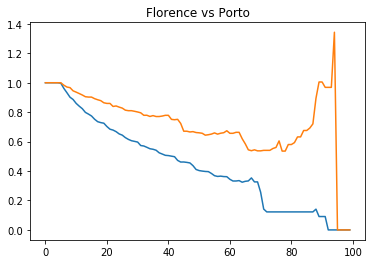

---------------------   Florence  vs.  Prague   ---------------------
Discrete Frechet distance:  0.18346451518273235 



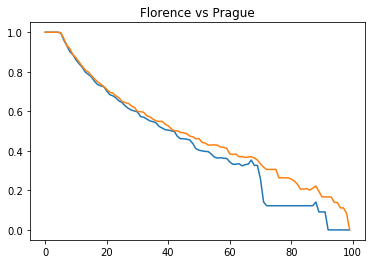

---------------------   Florence  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.49795263849175836 



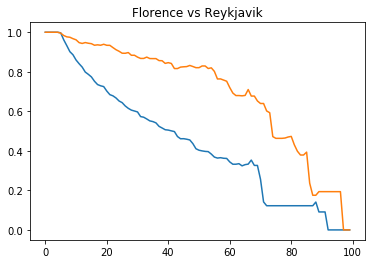

---------------------   Florence  vs.  Riga   ---------------------
Discrete Frechet distance:  0.4654363756385827 



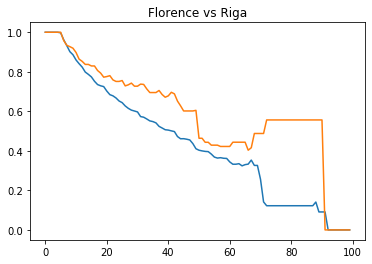

---------------------   Florence  vs.  Rio   ---------------------
Discrete Frechet distance:  1.639445486183051 



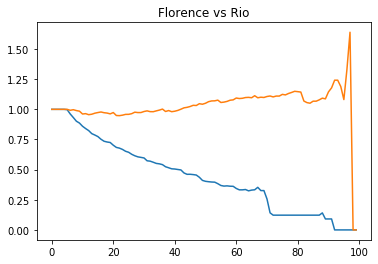

---------------------   Florence  vs.  Rome   ---------------------
Discrete Frechet distance:  0.21232765034826137 



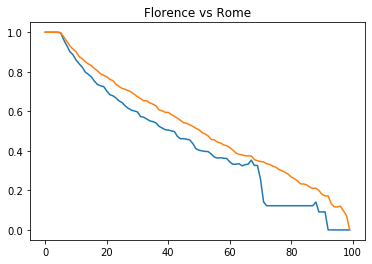

---------------------   Florence  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.8833447012990394 



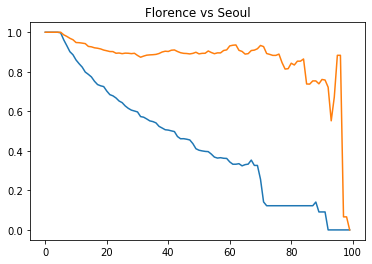

---------------------   Florence  vs.  Siena   ---------------------
Discrete Frechet distance:  0.26220283722264137 



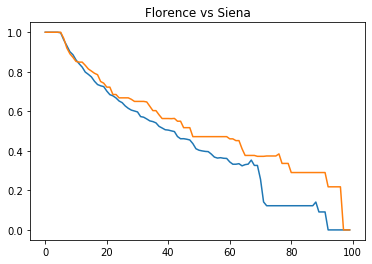

---------------------   Florence  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.4061038176017675 



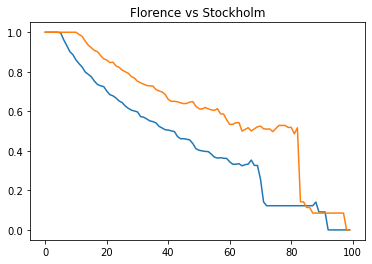

---------------------   Florence  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.9775496108995354 



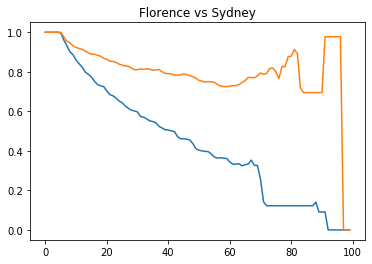

---------------------   Florence  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.23923681373317132 



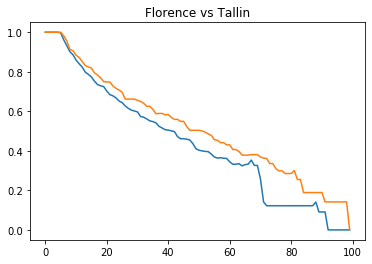

---------------------   Florence  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.28328797207604123 



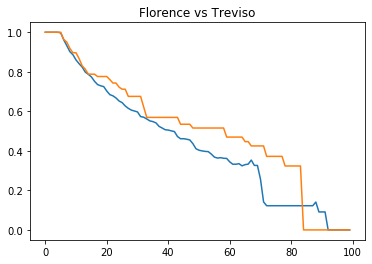

---------------------   Florence  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.2962479532697894 



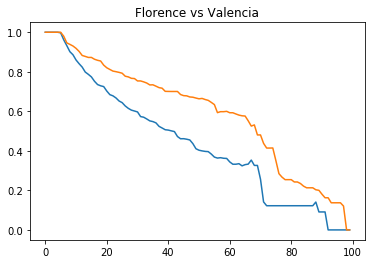

---------------------   Florence  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.39947990497138697 



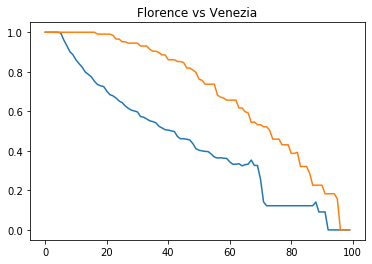

---------------------   Florence  vs.  Verona   ---------------------
Discrete Frechet distance:  0.21603433952582143 



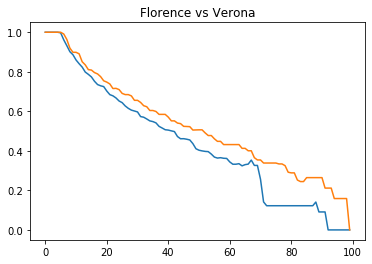

---------------------   Florence  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.29308674937350876 



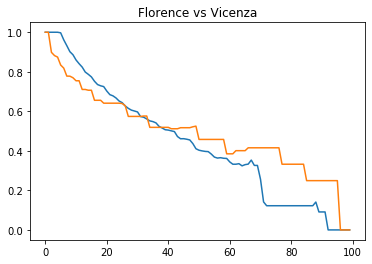

---------------------   Florence  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.8549126088300883 



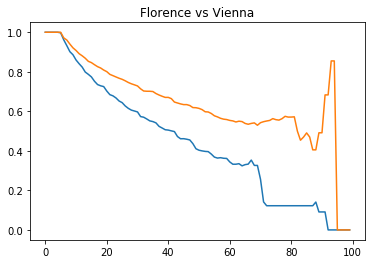

---------------------   Florence  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.2729080575924564 



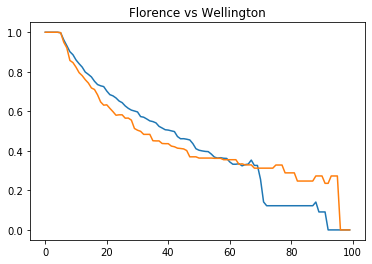

---------------------   Florence  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.4629848177101233 



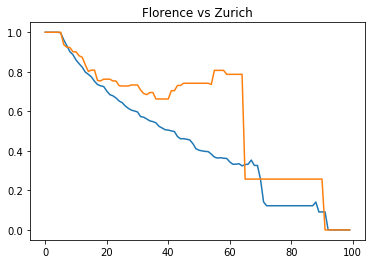

---------------------   Florence  vs.  Milan   ---------------------
Discrete Frechet distance:  0.34965071726416574 



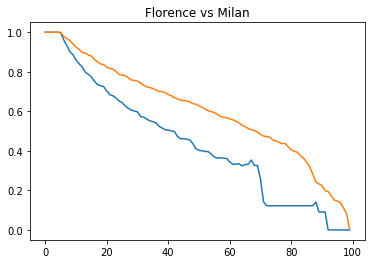

---------------------   Florence  vs.  London   ---------------------
Discrete Frechet distance:  0.33937546705185284 



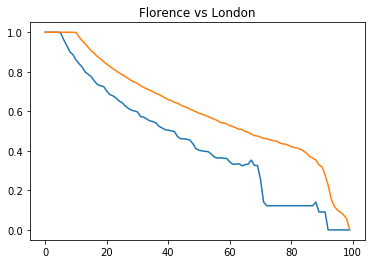

---------------------   Florence  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.6670520643678925 



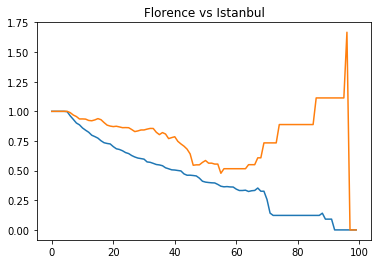

---------------------   Florence  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.4137595099061017 



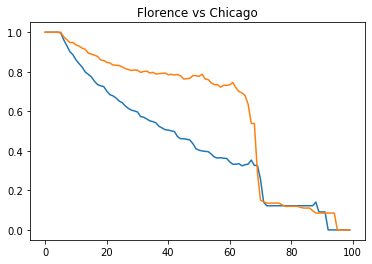

---------------------   Florence  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.47770123365753736 



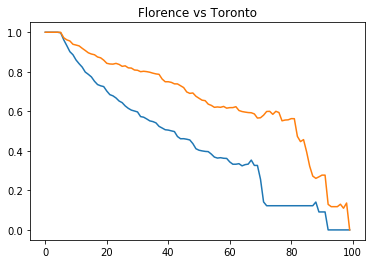

---------------------   Florence  vs.  Munich   ---------------------
Discrete Frechet distance:  0.3671130278414978 



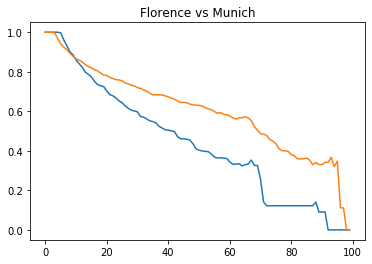

---------------------   Los_Angeles  vs.  Los_Angeles   ---------------------
Discrete Frechet distance:  0.0 



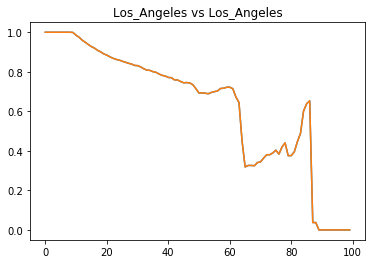

---------------------   Los_Angeles  vs.  Lyon   ---------------------
Discrete Frechet distance:  0.4018042014052573 



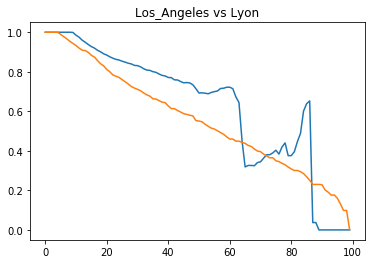

---------------------   Los_Angeles  vs.  Madrid   ---------------------
Discrete Frechet distance:  0.4321377596823506 



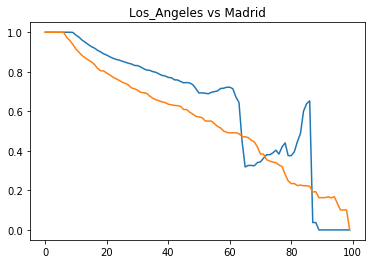

---------------------   Los_Angeles  vs.  Moscow   ---------------------
Discrete Frechet distance:  0.6526873122098799 



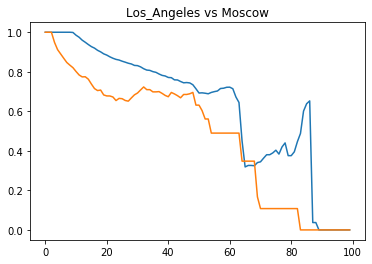

---------------------   Los_Angeles  vs.  Palermo   ---------------------
Discrete Frechet distance:  1.011525905917469 



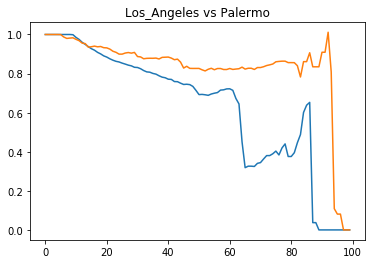

---------------------   Los_Angeles  vs.  Paris   ---------------------
Discrete Frechet distance:  0.4091489186686956 



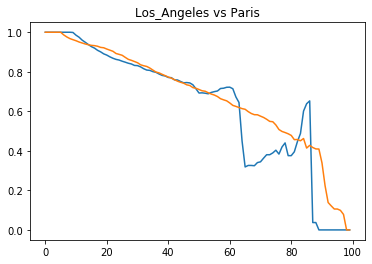

---------------------   Los_Angeles  vs.  Porto   ---------------------
Discrete Frechet distance:  1.3430873083731827 



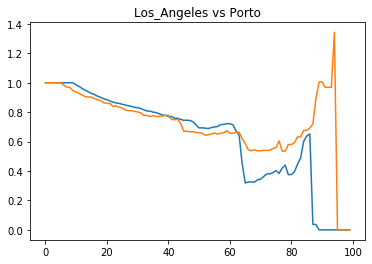

---------------------   Los_Angeles  vs.  Prague   ---------------------
Discrete Frechet distance:  0.4512777969274333 



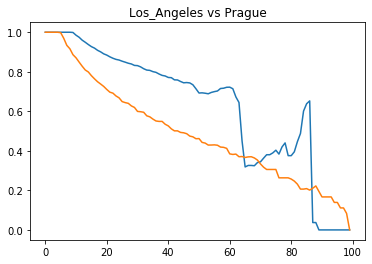

---------------------   Los_Angeles  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.41637080961412004 



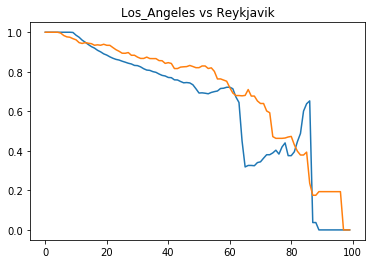

---------------------   Los_Angeles  vs.  Riga   ---------------------
Discrete Frechet distance:  0.5563612798024404 



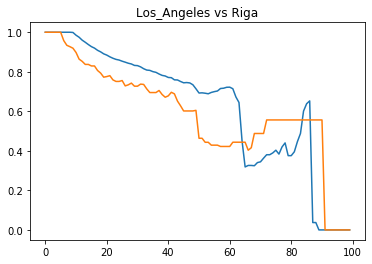

---------------------   Los_Angeles  vs.  Rio   ---------------------
Discrete Frechet distance:  1.639445486183051 



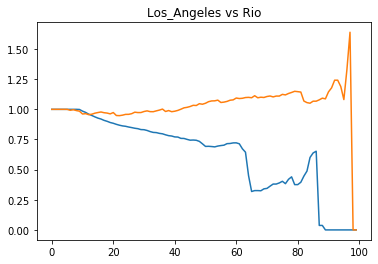

---------------------   Los_Angeles  vs.  Rome   ---------------------
Discrete Frechet distance:  0.4363160064095355 



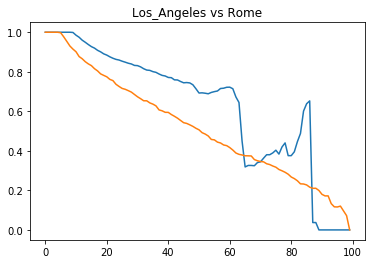

---------------------   Los_Angeles  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.8833447012990394 



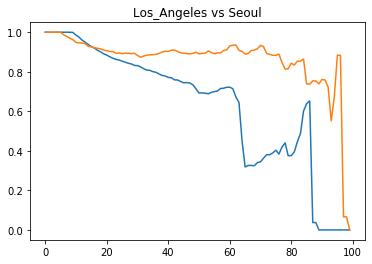

---------------------   Los_Angeles  vs.  Siena   ---------------------
Discrete Frechet distance:  0.3624398178790652 



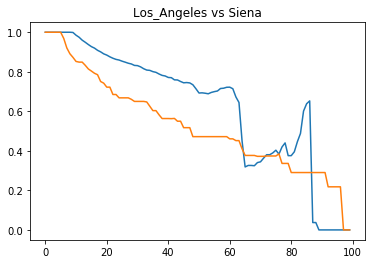

---------------------   Los_Angeles  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.5391449307628194 



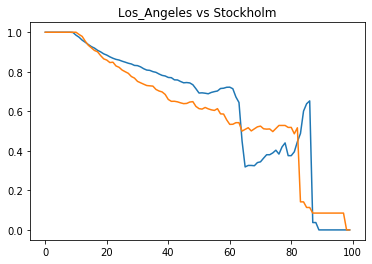

---------------------   Los_Angeles  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.9775496108995354 



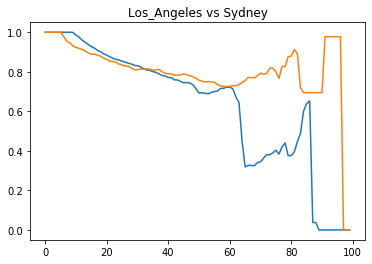

---------------------   Los_Angeles  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.4638107463506586 



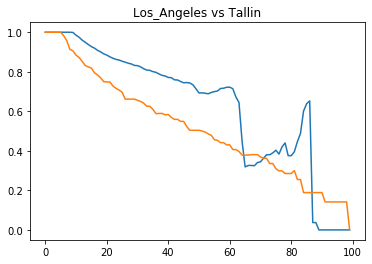

---------------------   Los_Angeles  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.6526873122098799 



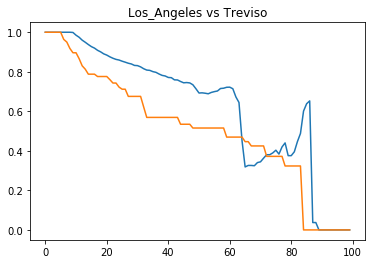

---------------------   Los_Angeles  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.4396048267870259 



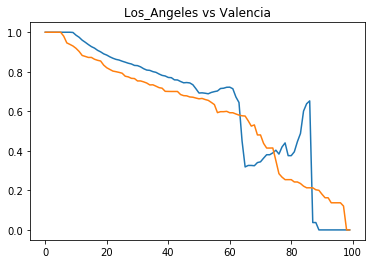

---------------------   Los_Angeles  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.36702933047081054 



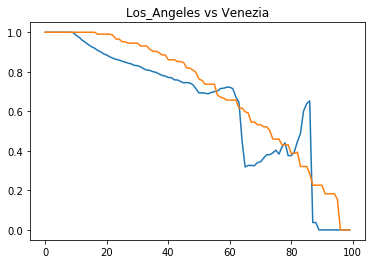

---------------------   Los_Angeles  vs.  Verona   ---------------------
Discrete Frechet distance:  0.38818336513884627 



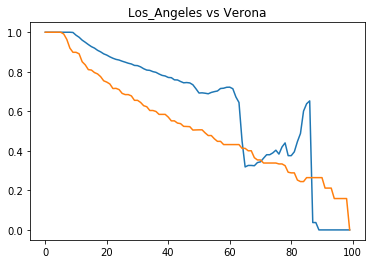

---------------------   Los_Angeles  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.4034195281095375 



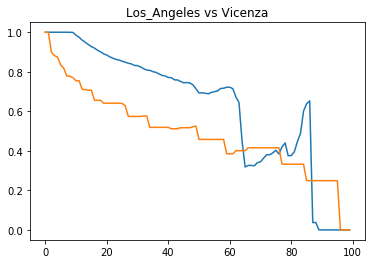

---------------------   Los_Angeles  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.8549126088300883 



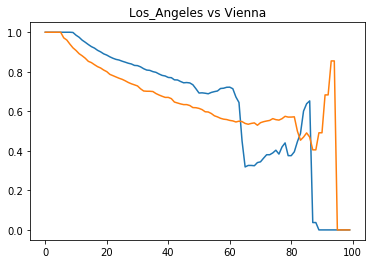

---------------------   Los_Angeles  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.4054344353183632 



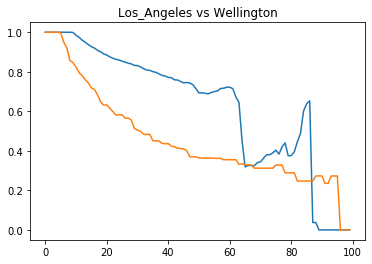

---------------------   Los_Angeles  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.3955895742617766 



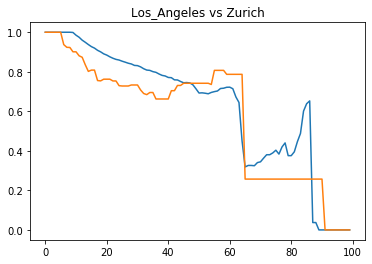

---------------------   Los_Angeles  vs.  Milan   ---------------------
Discrete Frechet distance:  0.33227292501168715 



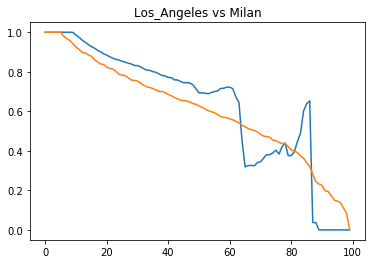

---------------------   Los_Angeles  vs.  London   ---------------------
Discrete Frechet distance:  0.3296887834708291 



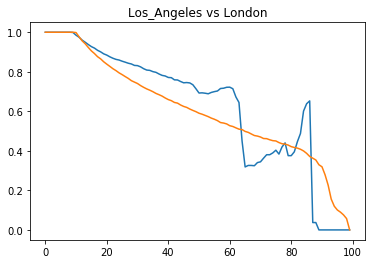

---------------------   Los_Angeles  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.6670520643678925 



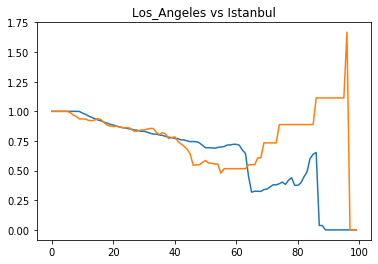

---------------------   Los_Angeles  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.5421460129264803 



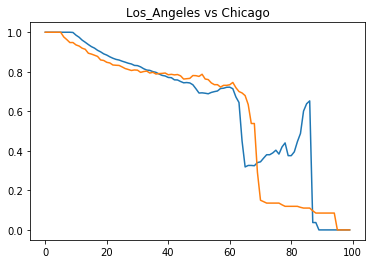

---------------------   Los_Angeles  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.330575006352428 



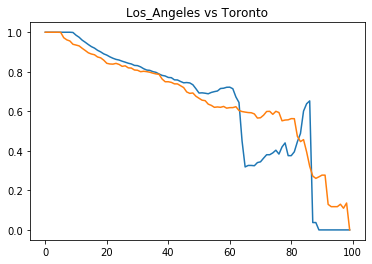

---------------------   Los_Angeles  vs.  Munich   ---------------------
Discrete Frechet distance:  0.3671130278414978 



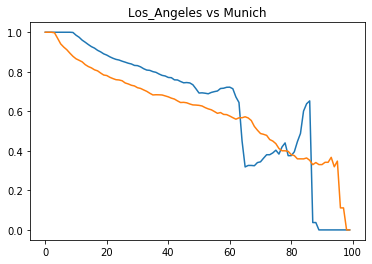

---------------------   Lyon  vs.  Lyon   ---------------------
Discrete Frechet distance:  0.0 



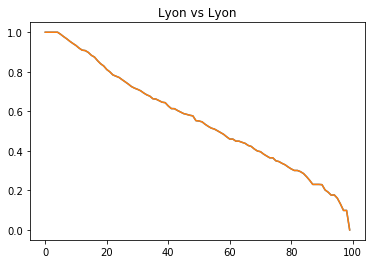

---------------------   Lyon  vs.  Madrid   ---------------------
Discrete Frechet distance:  0.0763770083040661 



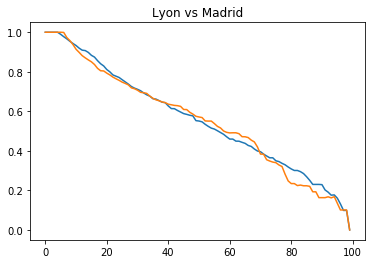

---------------------   Lyon  vs.  Moscow   ---------------------
Discrete Frechet distance:  0.29471467713527355 



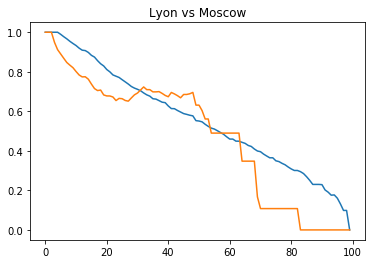

---------------------   Lyon  vs.  Palermo   ---------------------
Discrete Frechet distance:  0.8205421566281501 



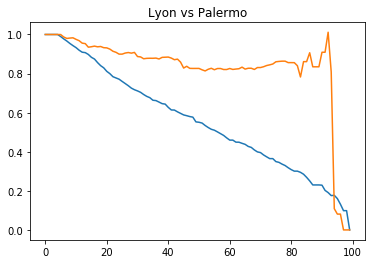

---------------------   Lyon  vs.  Paris   ---------------------
Discrete Frechet distance:  0.18674075416280672 



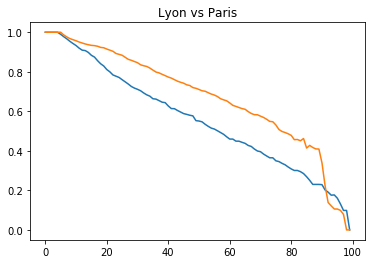

---------------------   Lyon  vs.  Porto   ---------------------
Discrete Frechet distance:  1.166068232868342 



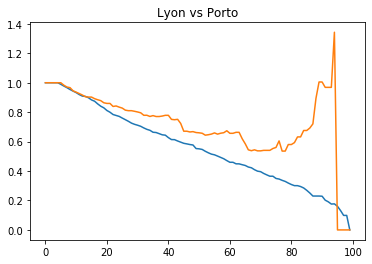

---------------------   Lyon  vs.  Prague   ---------------------
Discrete Frechet distance:  0.11216983352589338 



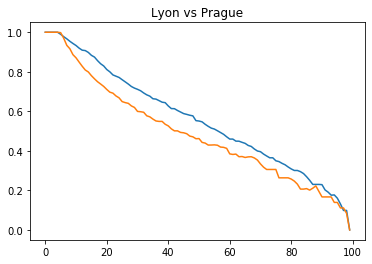

---------------------   Lyon  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.30505924590943223 



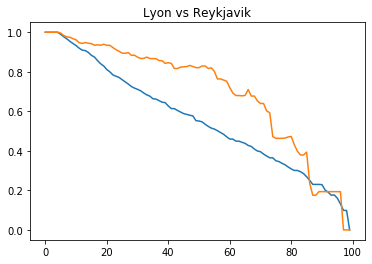

---------------------   Lyon  vs.  Riga   ---------------------
Discrete Frechet distance:  0.32738985792570063 



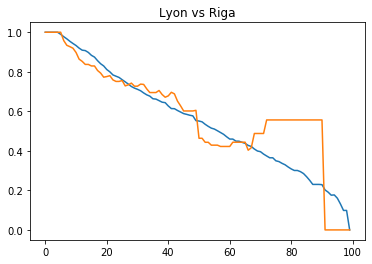

---------------------   Lyon  vs.  Rio   ---------------------
Discrete Frechet distance:  1.540907096179855 



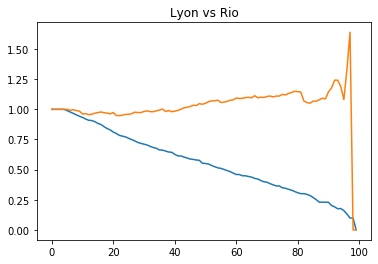

---------------------   Lyon  vs.  Rome   ---------------------
Discrete Frechet distance:  0.06651465417949787 



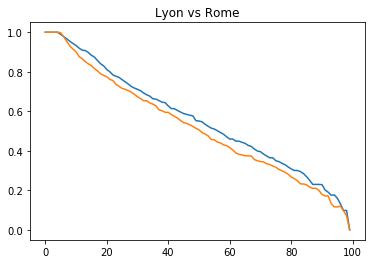

---------------------   Lyon  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.7519601812947648 



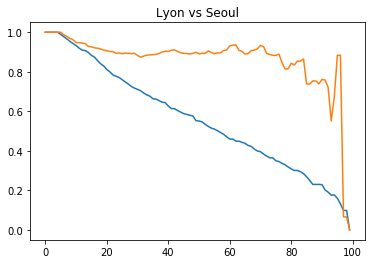

---------------------   Lyon  vs.  Siena   ---------------------
Discrete Frechet distance:  0.10516065689184789 



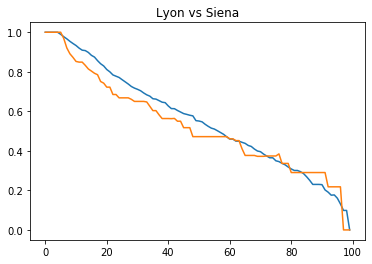

---------------------   Lyon  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.21587635318706005 



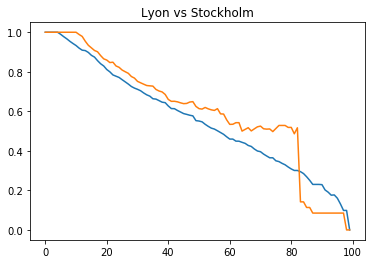

---------------------   Lyon  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.8461650908952608 



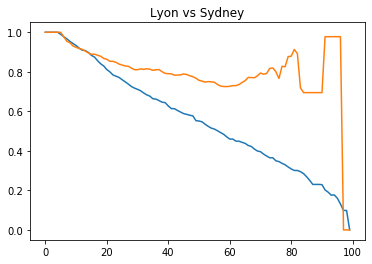

---------------------   Lyon  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.09614667605904031 



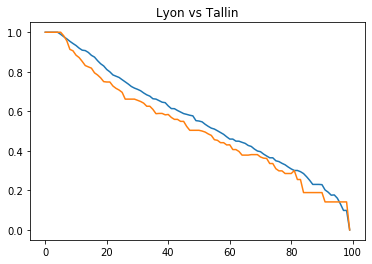

---------------------   Lyon  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.28502324191826156 



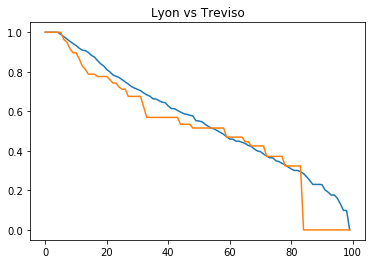

---------------------   Lyon  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.13821545752657038 



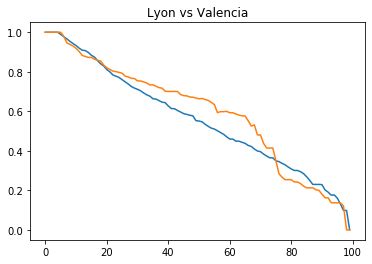

---------------------   Lyon  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.25821631918203614 



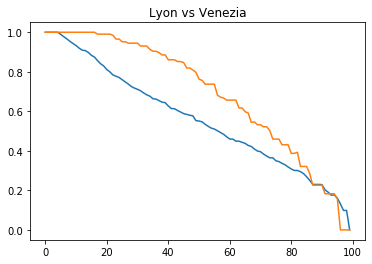

---------------------   Lyon  vs.  Verona   ---------------------
Discrete Frechet distance:  0.08704505807775731 



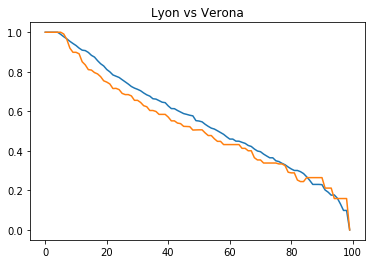

---------------------   Lyon  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.21856050693749163 



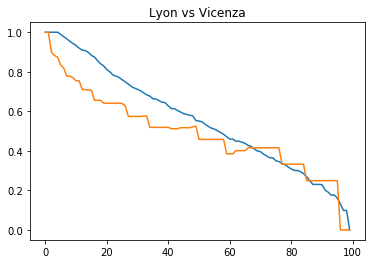

---------------------   Lyon  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.6791807466243218 



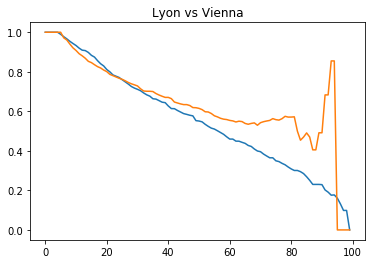

---------------------   Lyon  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.21255440748239818 



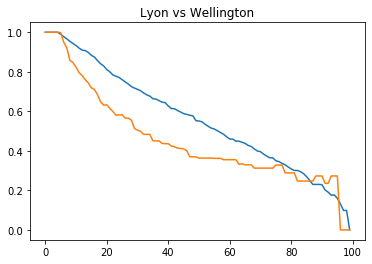

---------------------   Lyon  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.3439961491770439 



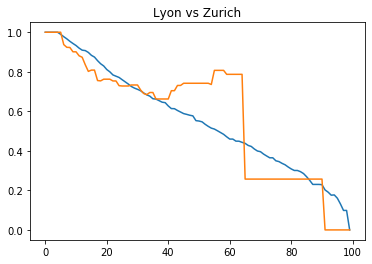

---------------------   Lyon  vs.  Milan   ---------------------
Discrete Frechet distance:  0.10813915391472034 



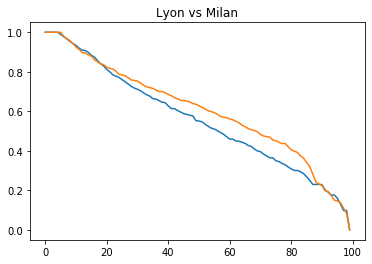

---------------------   Lyon  vs.  London   ---------------------
Discrete Frechet distance:  0.13267127902644948 



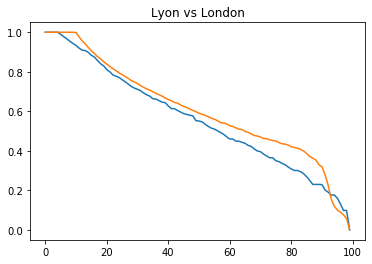

---------------------   Lyon  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.535667544363618 



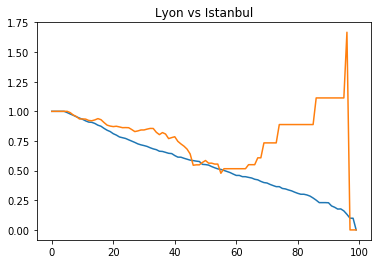

---------------------   Lyon  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.286537770876641 



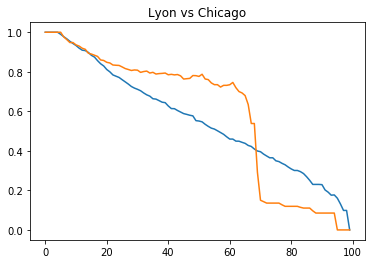

---------------------   Lyon  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.26201426309777004 



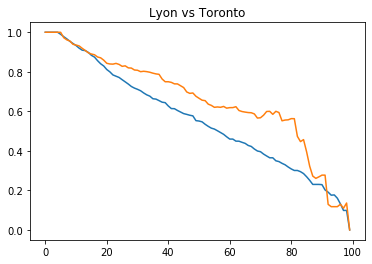

---------------------   Lyon  vs.  Munich   ---------------------
Discrete Frechet distance:  0.1913811656357313 



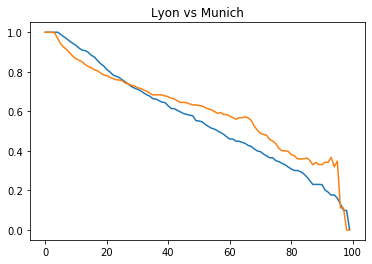

---------------------   Madrid  vs.  Madrid   ---------------------
Discrete Frechet distance:  0.0 



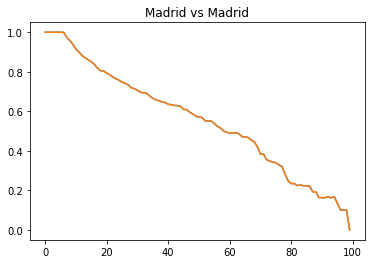

---------------------   Madrid  vs.  Moscow   ---------------------
Discrete Frechet distance:  0.27564096800505883 



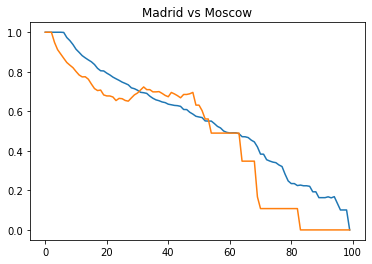

---------------------   Madrid  vs.  Palermo   ---------------------
Discrete Frechet distance:  0.8440615536000325 



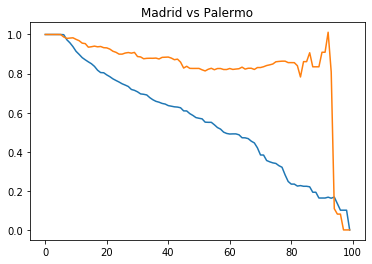

---------------------   Madrid  vs.  Paris   ---------------------
Discrete Frechet distance:  0.2459336813284514 



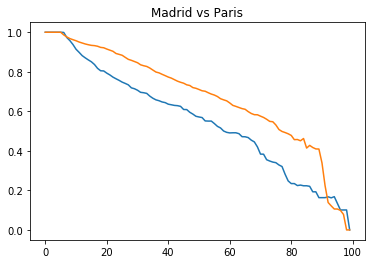

---------------------   Madrid  vs.  Porto   ---------------------
Discrete Frechet distance:  1.1748986103851036 



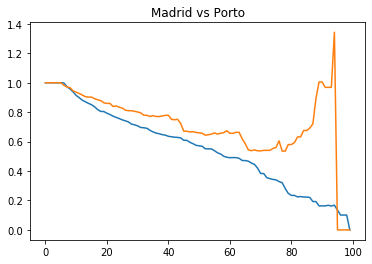

---------------------   Madrid  vs.  Prague   ---------------------
Discrete Frechet distance:  0.13182688083443672 



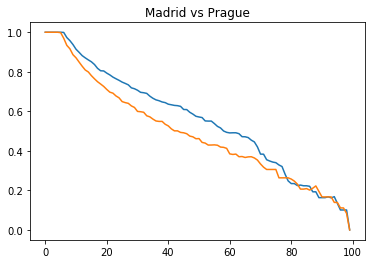

---------------------   Madrid  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.27794953413583745 



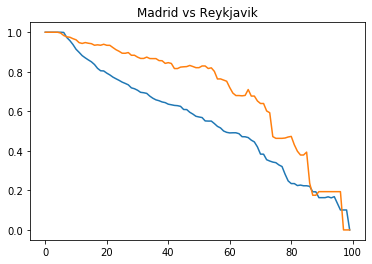

---------------------   Madrid  vs.  Riga   ---------------------
Discrete Frechet distance:  0.3931460424621962 



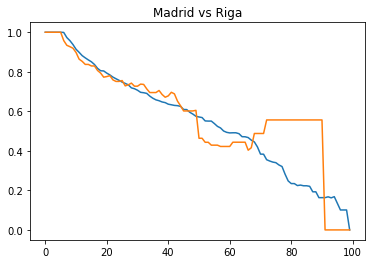

---------------------   Madrid  vs.  Rio   ---------------------
Discrete Frechet distance:  1.5385322673901913 



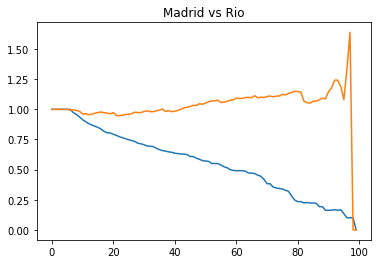

---------------------   Madrid  vs.  Rome   ---------------------
Discrete Frechet distance:  0.10450049674609574 



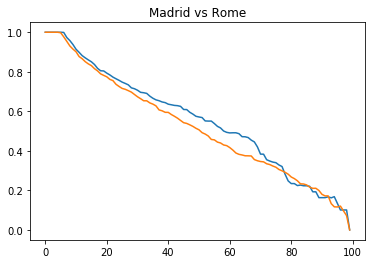

---------------------   Madrid  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.7824314825061799 



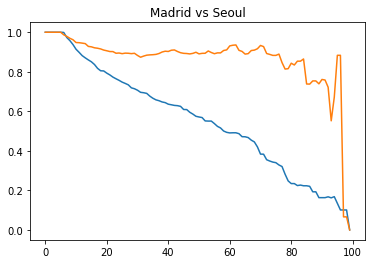

---------------------   Madrid  vs.  Siena   ---------------------
Discrete Frechet distance:  0.1270322569905704 



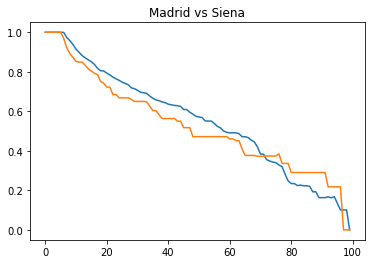

---------------------   Madrid  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.29225336149112613 



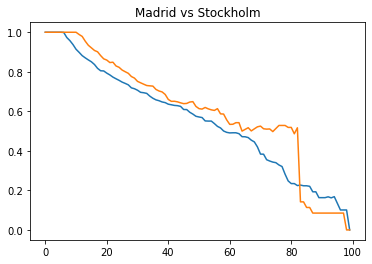

---------------------   Madrid  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.8766363921066759 



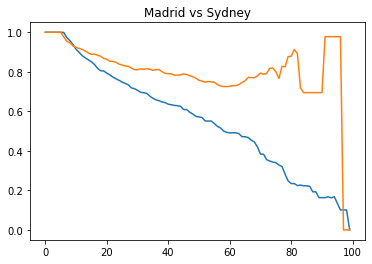

---------------------   Madrid  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.09329532671651214 



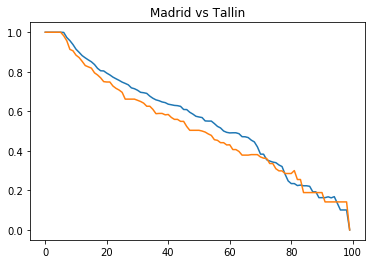

---------------------   Madrid  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.22330964096650055 



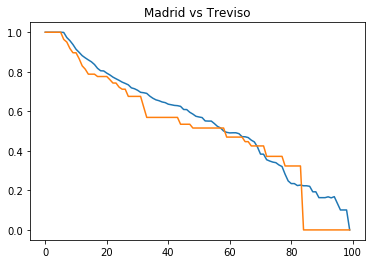

---------------------   Madrid  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.10829220053770483 



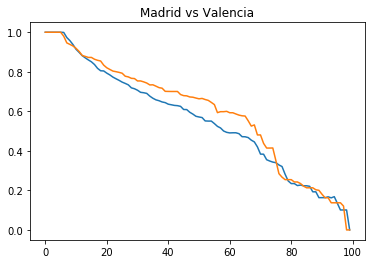

---------------------   Madrid  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.2458910944689544 



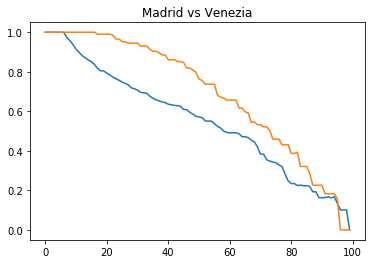

---------------------   Madrid  vs.  Verona   ---------------------
Discrete Frechet distance:  0.10128870973078935 



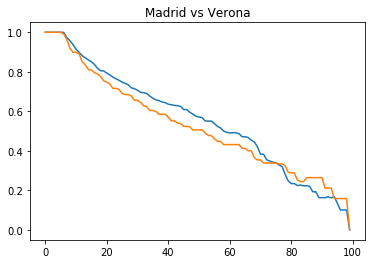

---------------------   Madrid  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.19503187815817757 



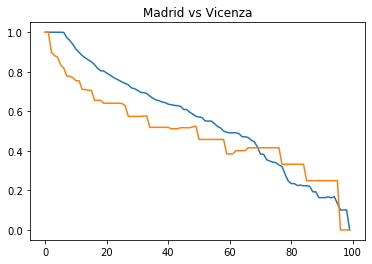

---------------------   Madrid  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.6927178857366973 



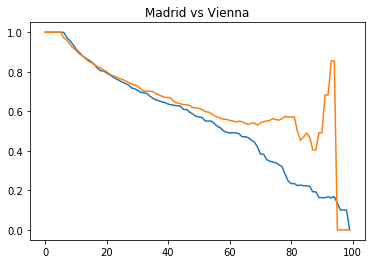

---------------------   Madrid  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.22536568340575597 



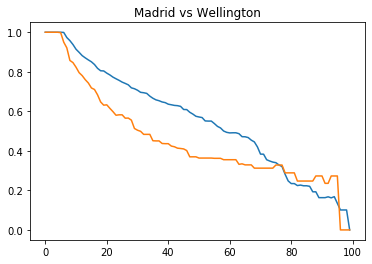

---------------------   Madrid  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.3153788333943155 



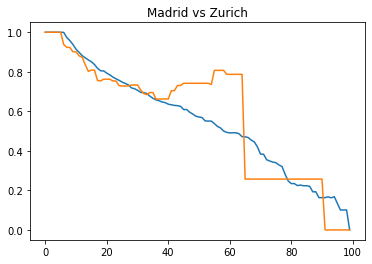

---------------------   Madrid  vs.  Milan   ---------------------
Discrete Frechet distance:  0.17345260853601557 



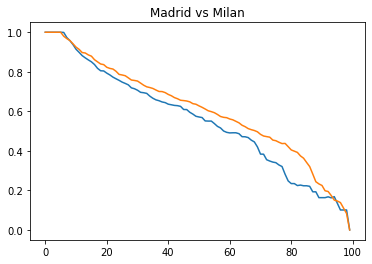

---------------------   Madrid  vs.  London   ---------------------
Discrete Frechet distance:  0.1894628358405769 



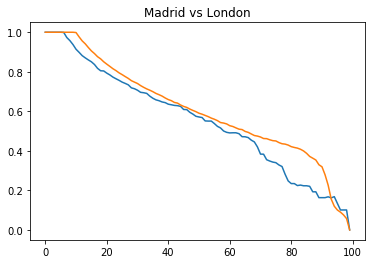

---------------------   Madrid  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.566138845575033 



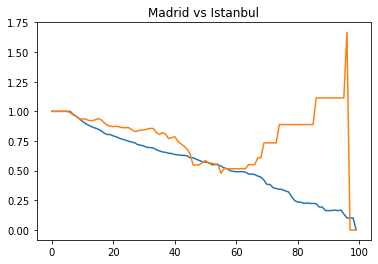

---------------------   Madrid  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.2546983016519308 



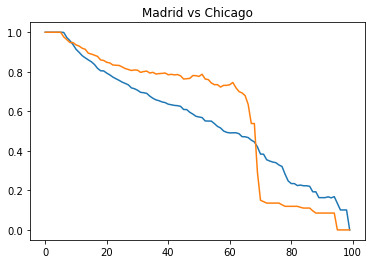

---------------------   Madrid  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.32856094195284724 



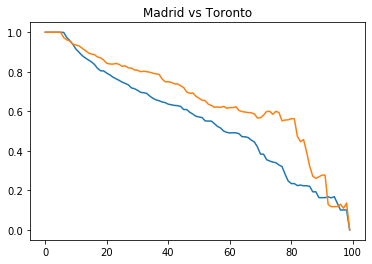

---------------------   Madrid  vs.  Munich   ---------------------
Discrete Frechet distance:  0.21356585678617626 



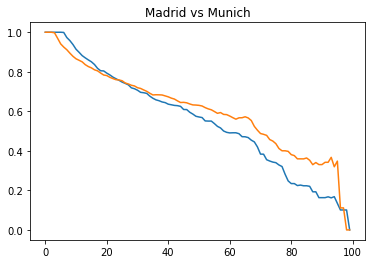

---------------------   Moscow  vs.  Moscow   ---------------------
Discrete Frechet distance:  0.0 



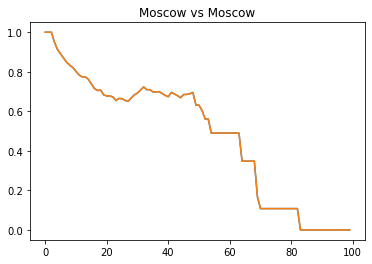

---------------------   Moscow  vs.  Palermo   ---------------------
Discrete Frechet distance:  1.011525905917469 



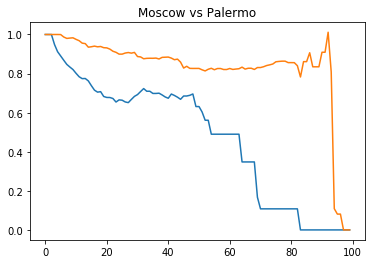

---------------------   Moscow  vs.  Paris   ---------------------
Discrete Frechet distance:  0.4676628625703525 



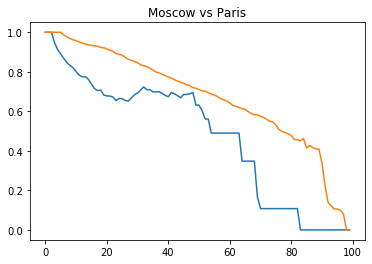

---------------------   Moscow  vs.  Porto   ---------------------
Discrete Frechet distance:  1.3430873083731827 



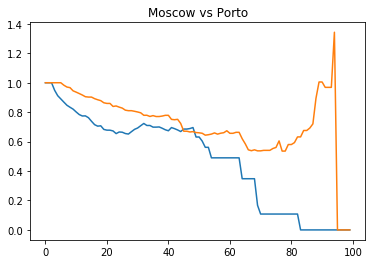

---------------------   Moscow  vs.  Prague   ---------------------
Discrete Frechet distance:  0.22584327866137427 



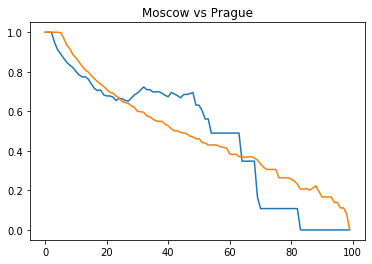

---------------------   Moscow  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.5316600269761272 



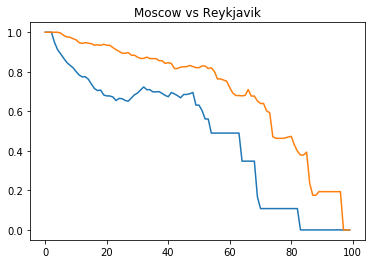

---------------------   Moscow  vs.  Riga   ---------------------
Discrete Frechet distance:  0.5563612798024404 



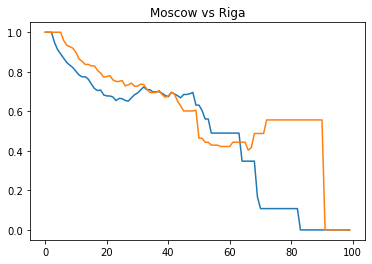

---------------------   Moscow  vs.  Rio   ---------------------
Discrete Frechet distance:  1.639445486183051 



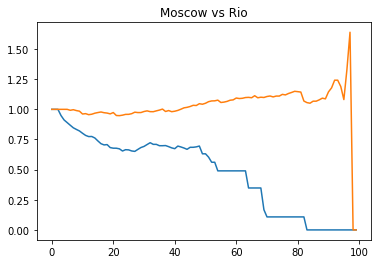

---------------------   Moscow  vs.  Rome   ---------------------
Discrete Frechet distance:  0.23808996123833615 



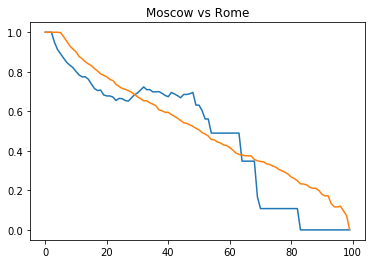

---------------------   Moscow  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.8833447012990394 



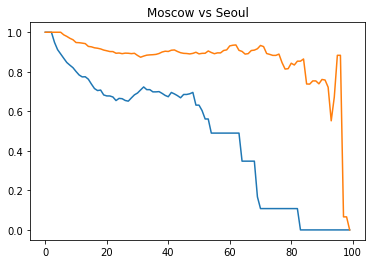

---------------------   Moscow  vs.  Siena   ---------------------
Discrete Frechet distance:  0.29024749433081465 



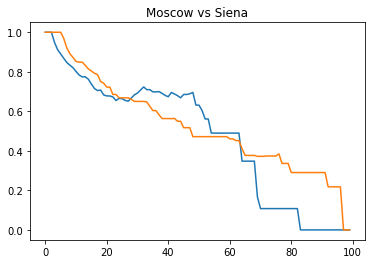

---------------------   Moscow  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.4206015718934579 



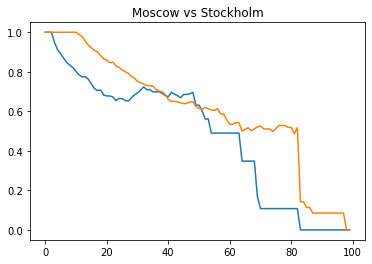

---------------------   Moscow  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.9775496108995354 



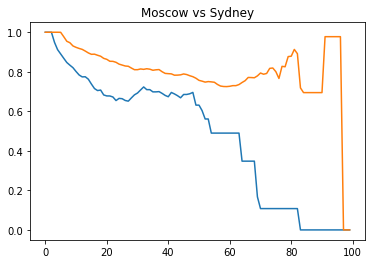

---------------------   Moscow  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.26110399587981054 



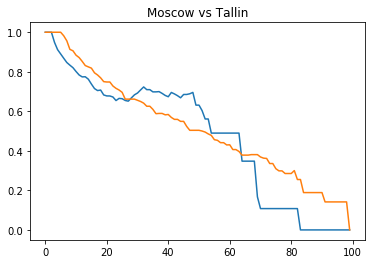

---------------------   Moscow  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.3234823035415169 



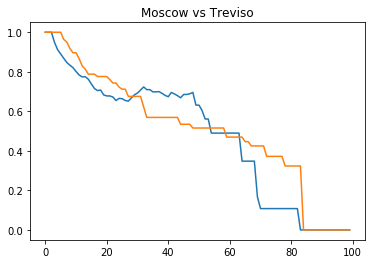

---------------------   Moscow  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.37262054512950565 



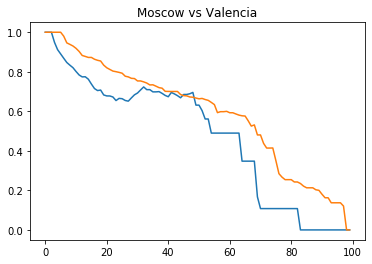

---------------------   Moscow  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.4243802359441936 



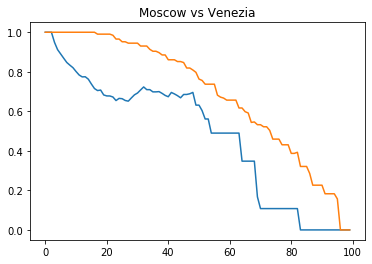

---------------------   Moscow  vs.  Verona   ---------------------
Discrete Frechet distance:  0.2645039470710336 



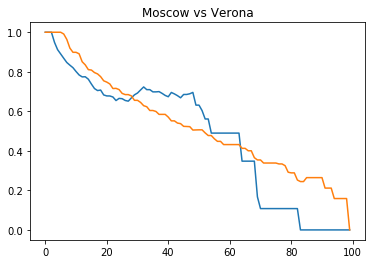

---------------------   Moscow  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.33235704546712314 



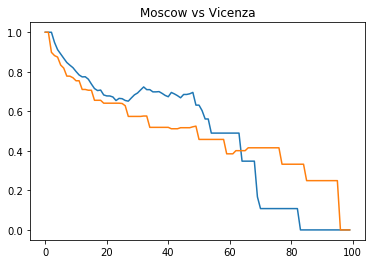

---------------------   Moscow  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.8549126088300883 



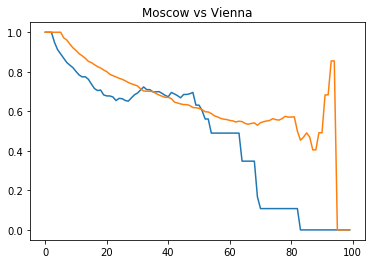

---------------------   Moscow  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.3258140737795307 



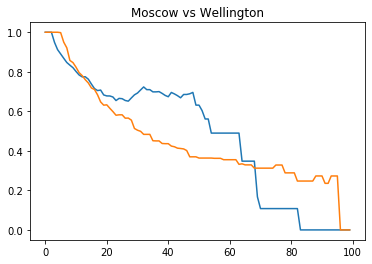

---------------------   Moscow  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.4392461939060372 



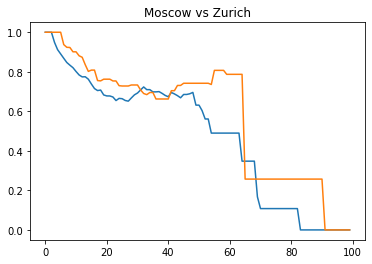

---------------------   Moscow  vs.  Milan   ---------------------
Discrete Frechet distance:  0.37556317977933884 



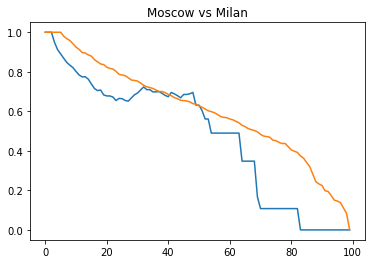

---------------------   Moscow  vs.  London   ---------------------
Discrete Frechet distance:  0.4080404545184155 



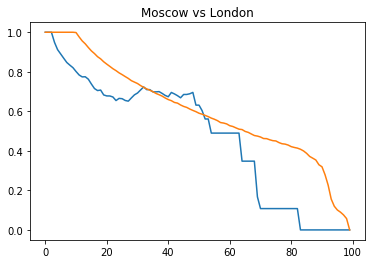

---------------------   Moscow  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.6670520643678925 



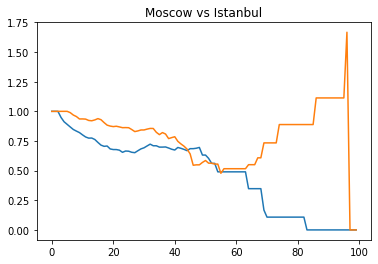

---------------------   Moscow  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.3450584887953792 



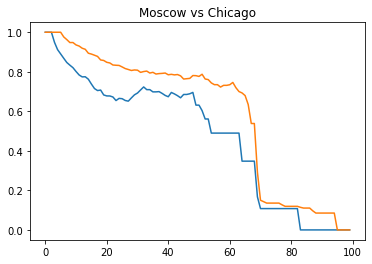

---------------------   Moscow  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.4921989879492278 



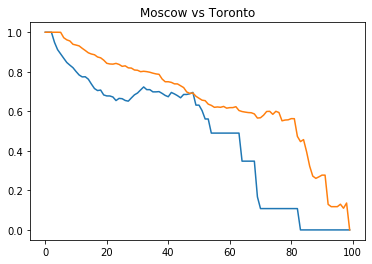

---------------------   Moscow  vs.  Munich   ---------------------
Discrete Frechet distance:  0.37981382936740155 



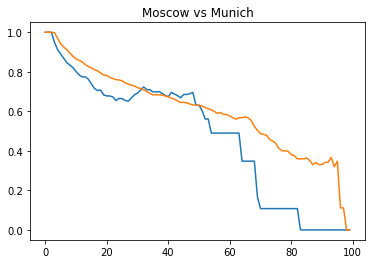

---------------------   Palermo  vs.  Palermo   ---------------------
Discrete Frechet distance:  0.0 



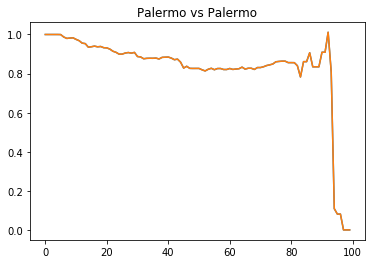

---------------------   Palermo  vs.  Paris   ---------------------
Discrete Frechet distance:  0.8729474302171157 



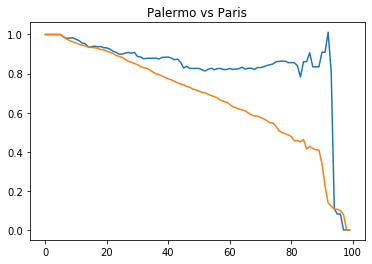

---------------------   Palermo  vs.  Porto   ---------------------
Discrete Frechet distance:  1.1339744591415075 



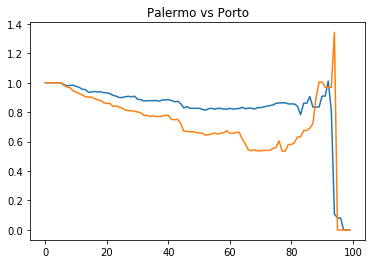

---------------------   Palermo  vs.  Prague   ---------------------
Discrete Frechet distance:  0.8446166789762383 



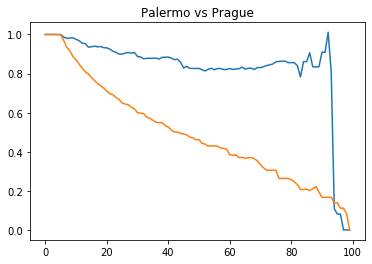

---------------------   Palermo  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.8179277432681614 



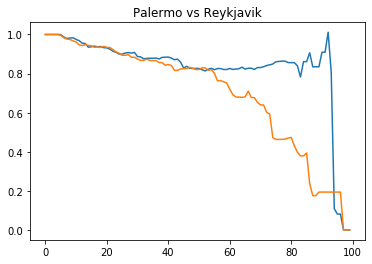

---------------------   Palermo  vs.  Riga   ---------------------
Discrete Frechet distance:  1.011525905917469 



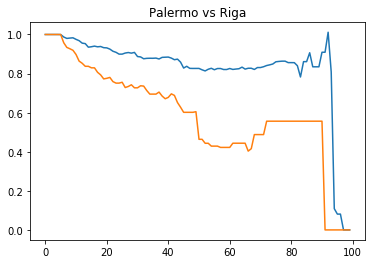

---------------------   Palermo  vs.  Rio   ---------------------
Discrete Frechet distance:  1.639445486183051 



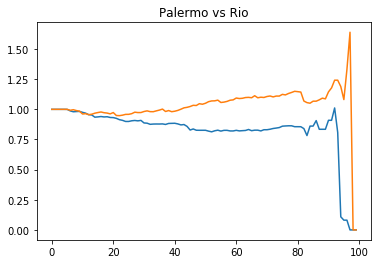

---------------------   Palermo  vs.  Rome   ---------------------
Discrete Frechet distance:  0.8392946251264284 



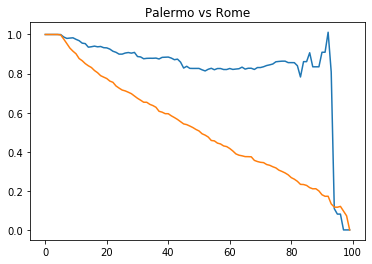

---------------------   Palermo  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.802390965054116 



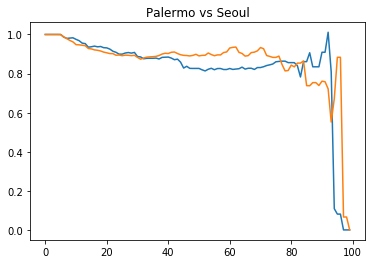

---------------------   Palermo  vs.  Siena   ---------------------
Discrete Frechet distance:  0.7935182846075803 



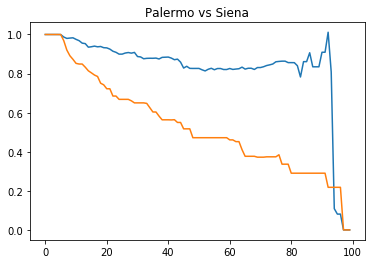

---------------------   Palermo  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.9263691198322412 



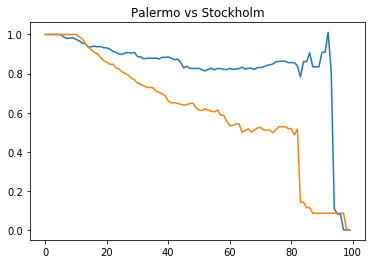

---------------------   Palermo  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.896595874654612 



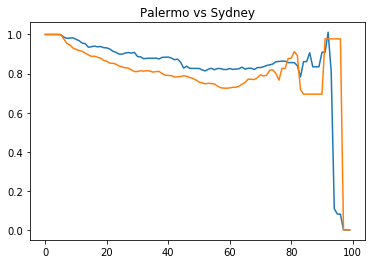

---------------------   Palermo  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.8698684815231092 



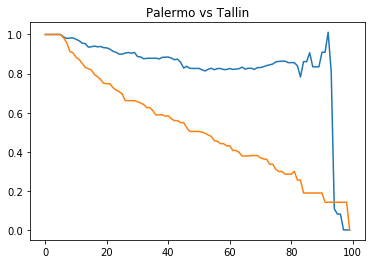

---------------------   Palermo  vs.  Treviso   ---------------------
Discrete Frechet distance:  1.011525905917469 



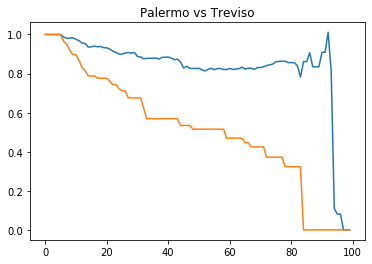

---------------------   Palermo  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.8489044566980786 



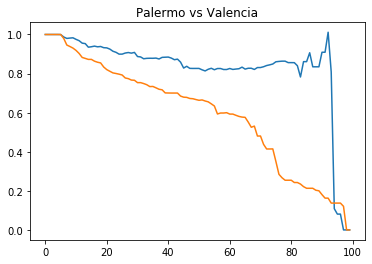

---------------------   Palermo  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.8286451034538677 



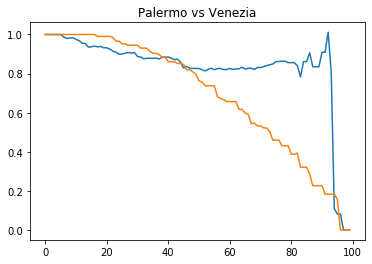

---------------------   Palermo  vs.  Verona   ---------------------
Discrete Frechet distance:  0.7999227482606757 



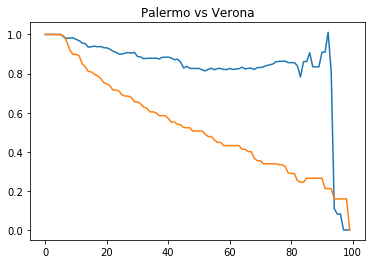

---------------------   Palermo  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.7622581218171267 



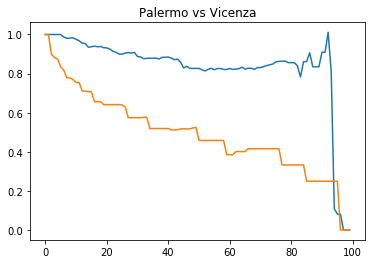

---------------------   Palermo  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.7462208037098856 



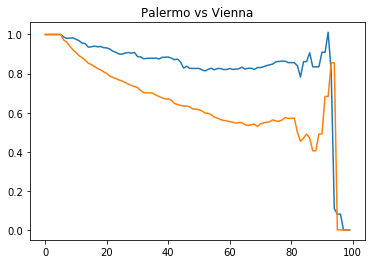

---------------------   Palermo  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.7758978582284006 



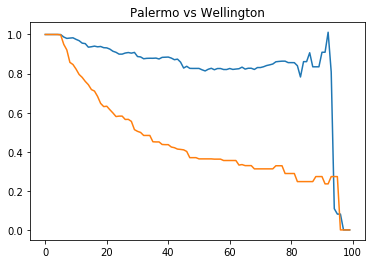

---------------------   Palermo  vs.  Zurich   ---------------------
Discrete Frechet distance:  1.011525905917469 



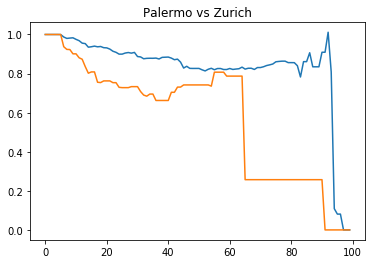

---------------------   Palermo  vs.  Milan   ---------------------
Discrete Frechet distance:  0.8172500734959371 



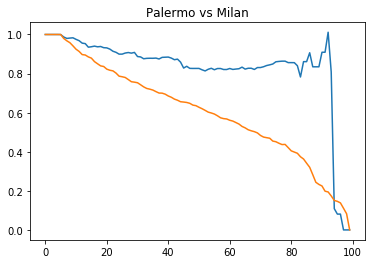

---------------------   Palermo  vs.  London   ---------------------
Discrete Frechet distance:  0.7849734174911125 



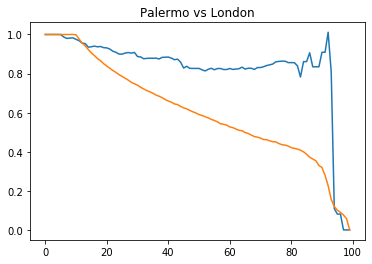

---------------------   Palermo  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.586098328122969 



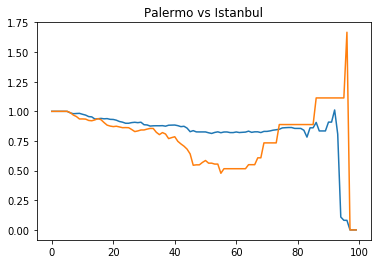

---------------------   Palermo  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.9262362731436162 



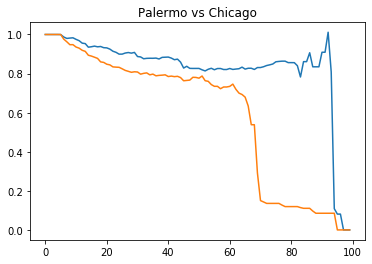

---------------------   Palermo  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.8822839420994576 



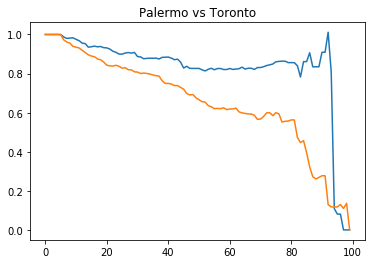

---------------------   Palermo  vs.  Munich   ---------------------
Discrete Frechet distance:  0.669457779630279 



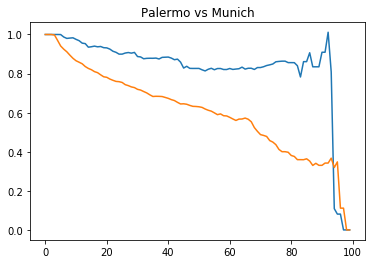

---------------------   Paris  vs.  Paris   ---------------------
Discrete Frechet distance:  0.0 



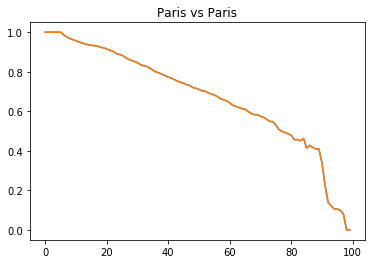

---------------------   Paris  vs.  Porto   ---------------------
Discrete Frechet distance:  1.2373282960466028 



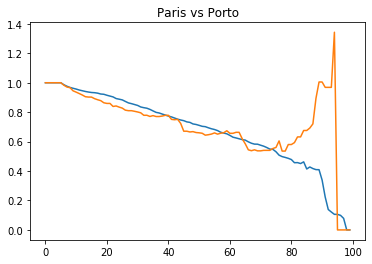

---------------------   Paris  vs.  Prague   ---------------------
Discrete Frechet distance:  0.2647085800389693 



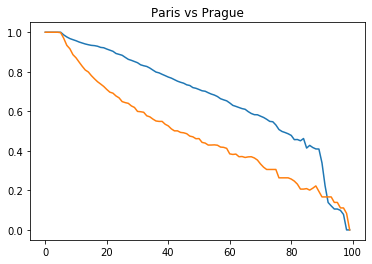

---------------------   Paris  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.24159167735711135 



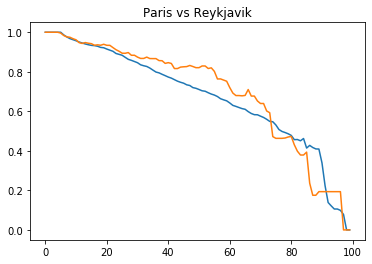

---------------------   Paris  vs.  Riga   ---------------------
Discrete Frechet distance:  0.25846481034203284 



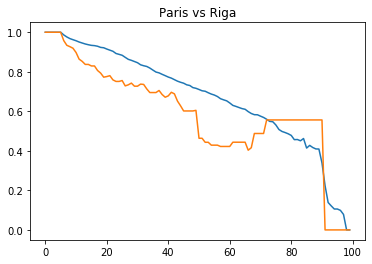

---------------------   Paris  vs.  Rio   ---------------------
Discrete Frechet distance:  1.56109117088541 



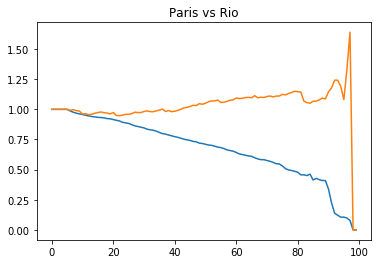

---------------------   Paris  vs.  Rome   ---------------------
Discrete Frechet distance:  0.2368892079794626 



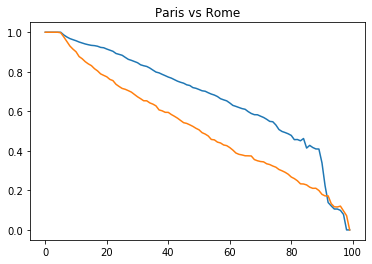

---------------------   Paris  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.7844632126444967 



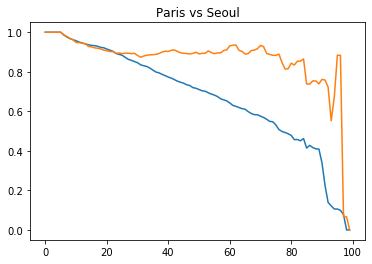

---------------------   Paris  vs.  Siena   ---------------------
Discrete Frechet distance:  0.24815700936750312 



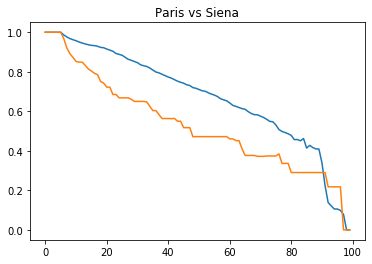

---------------------   Paris  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.3317545388208827 



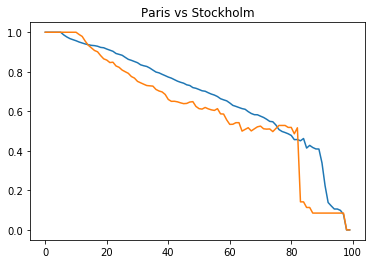

---------------------   Paris  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.8786681222449927 



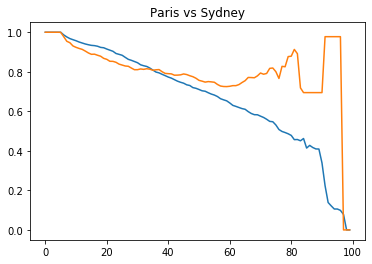

---------------------   Paris  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.2734910703540944 



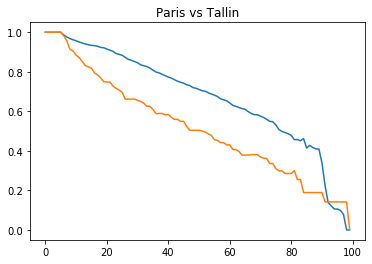

---------------------   Paris  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.46236763621331567 



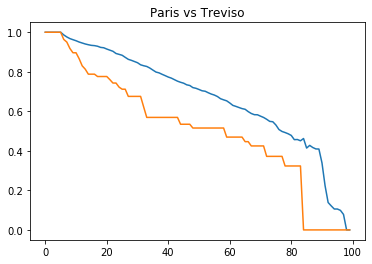

---------------------   Paris  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.2409109798139163 



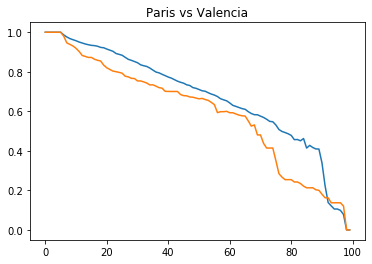

---------------------   Paris  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.19060609140507673 



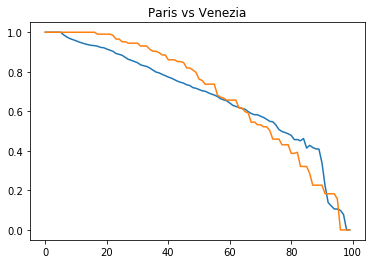

---------------------   Paris  vs.  Verona   ---------------------
Discrete Frechet distance:  0.2305480129499069 



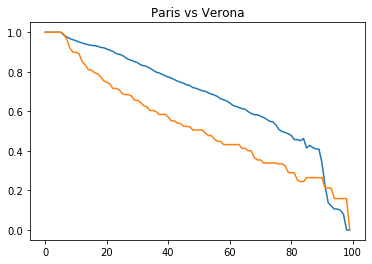

---------------------   Paris  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.3000220918027128 



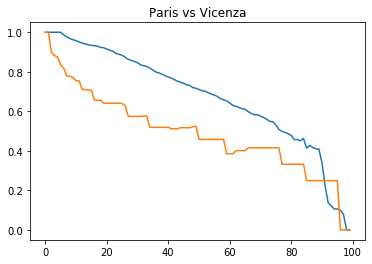

---------------------   Paris  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.7491535965035084 



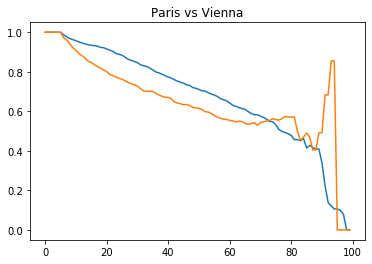

---------------------   Paris  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.36089511898651844 



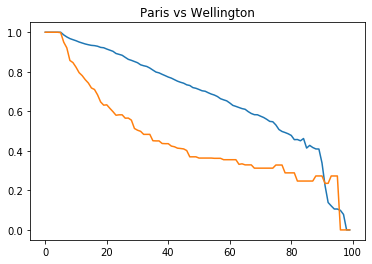

---------------------   Paris  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.35317505419016165 



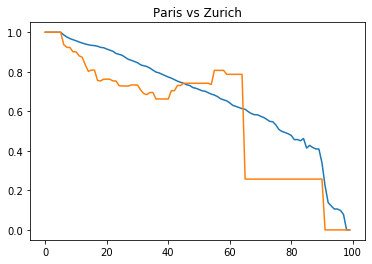

---------------------   Paris  vs.  Milan   ---------------------
Discrete Frechet distance:  0.17639092837369105 



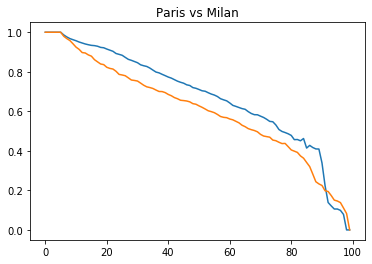

---------------------   Paris  vs.  London   ---------------------
Discrete Frechet distance:  0.12235591492820241 



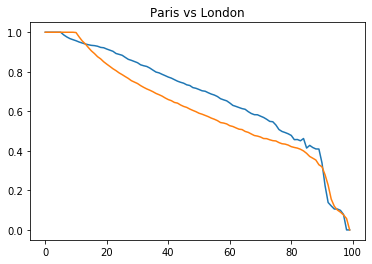

---------------------   Paris  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.56817057571335 



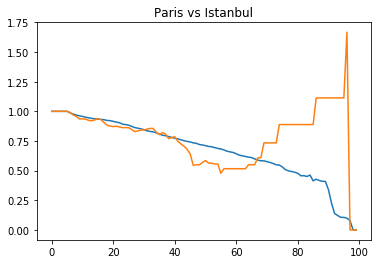

---------------------   Paris  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.4259156860328934 



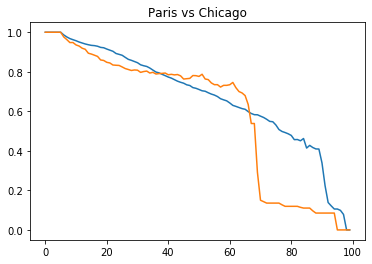

---------------------   Paris  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.14887876143361561 



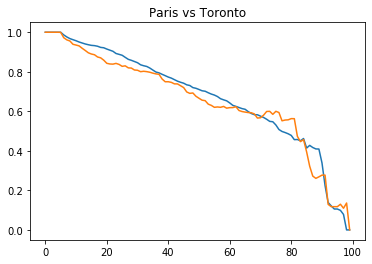

---------------------   Paris  vs.  Munich   ---------------------
Discrete Frechet distance:  0.2455441071990132 



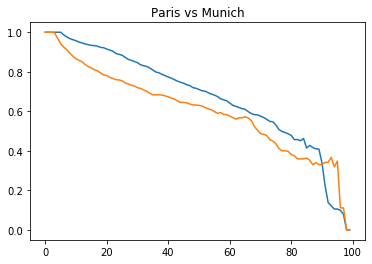

---------------------   Porto  vs.  Porto   ---------------------
Discrete Frechet distance:  0.0 



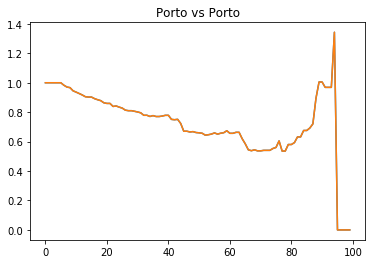

---------------------   Porto  vs.  Prague   ---------------------
Discrete Frechet distance:  1.2039962859221627 



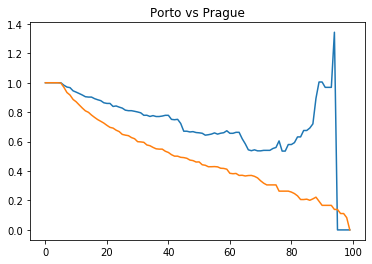

---------------------   Porto  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  1.1495476120739663 



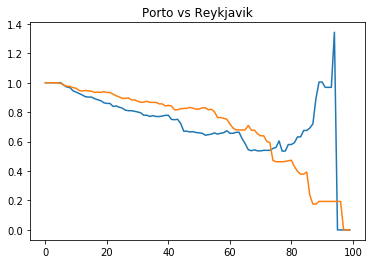

---------------------   Porto  vs.  Riga   ---------------------
Discrete Frechet distance:  1.3430873083731827 



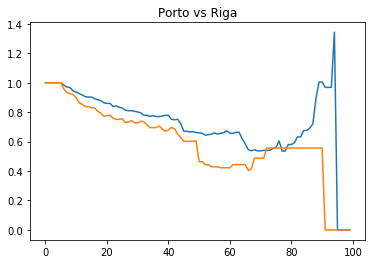

---------------------   Porto  vs.  Rio   ---------------------
Discrete Frechet distance:  1.639445486183051 



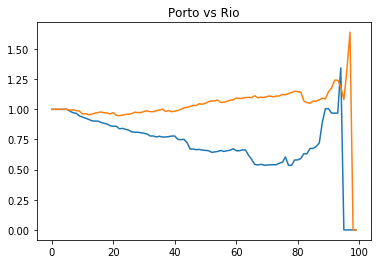

---------------------   Porto  vs.  Rome   ---------------------
Discrete Frechet distance:  1.2262962994100919 



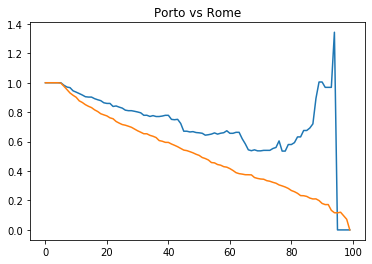

---------------------   Porto  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.8833447012990394 



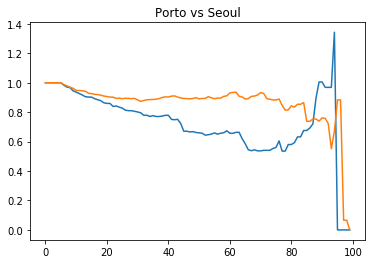

---------------------   Porto  vs.  Siena   ---------------------
Discrete Frechet distance:  1.125079687063294 



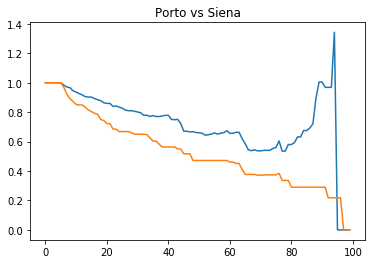

---------------------   Porto  vs.  Stockholm   ---------------------
Discrete Frechet distance:  1.2579305222879549 



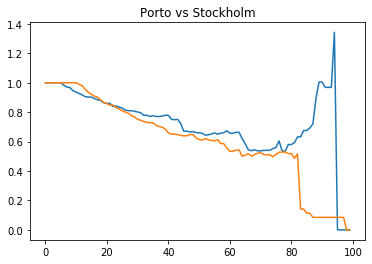

---------------------   Porto  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.9775496108995354 



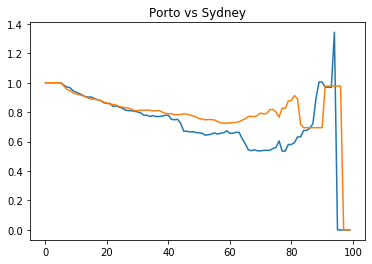

---------------------   Porto  vs.  Tallin   ---------------------
Discrete Frechet distance:  1.2014298839788229 



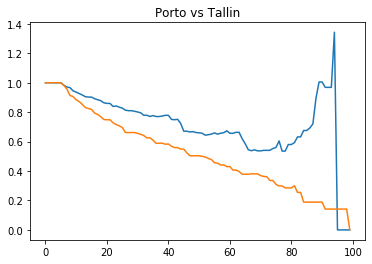

---------------------   Porto  vs.  Treviso   ---------------------
Discrete Frechet distance:  1.3430873083731827 



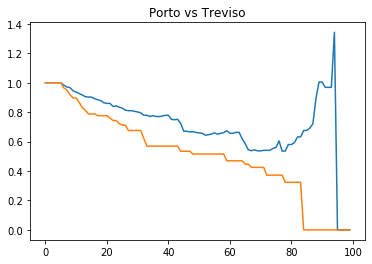

---------------------   Porto  vs.  Valencia   ---------------------
Discrete Frechet distance:  1.2058375907432792 



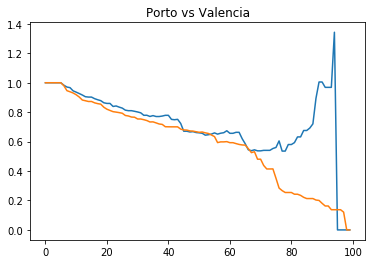

---------------------   Porto  vs.  Venezia   ---------------------
Discrete Frechet distance:  1.1602065059095814 



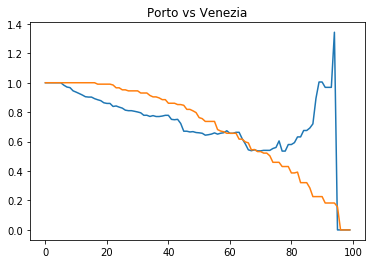

---------------------   Porto  vs.  Verona   ---------------------
Discrete Frechet distance:  1.184384940130619 



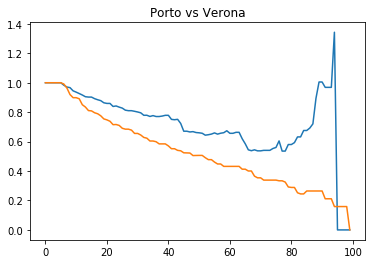

---------------------   Porto  vs.  Vicenza   ---------------------
Discrete Frechet distance:  1.0938195242728403 



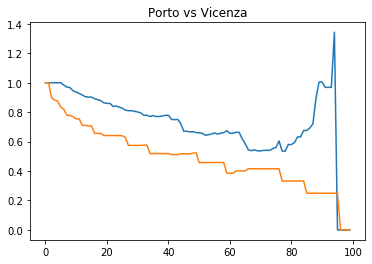

---------------------   Porto  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.5136825104392129 



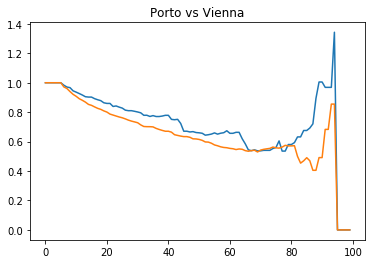

---------------------   Porto  vs.  Wellington   ---------------------
Discrete Frechet distance:  1.0701792507807264 



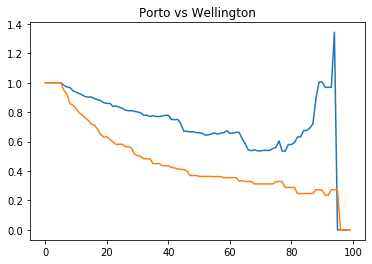

---------------------   Porto  vs.  Zurich   ---------------------
Discrete Frechet distance:  1.3430873083731827 



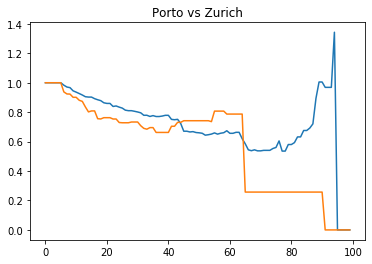

---------------------   Porto  vs.  Milan   ---------------------
Discrete Frechet distance:  1.1923052369557658 



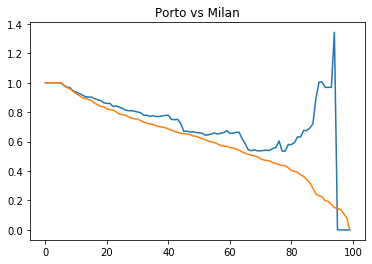

---------------------   Porto  vs.  London   ---------------------
Discrete Frechet distance:  1.2232315113723364 



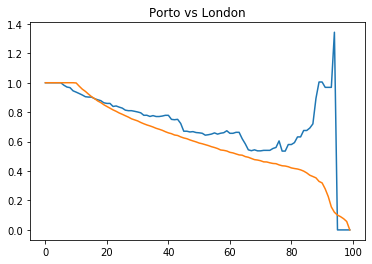

---------------------   Porto  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.6670520643678925 



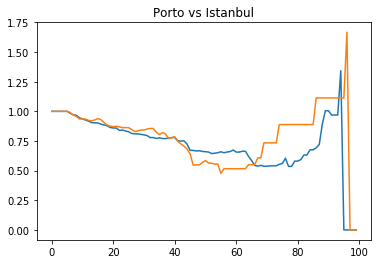

---------------------   Porto  vs.  Chicago   ---------------------
Discrete Frechet distance:  1.2577976755993299 



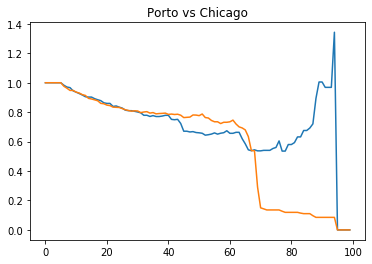

---------------------   Porto  vs.  Toronto   ---------------------
Discrete Frechet distance:  1.2254656370039156 



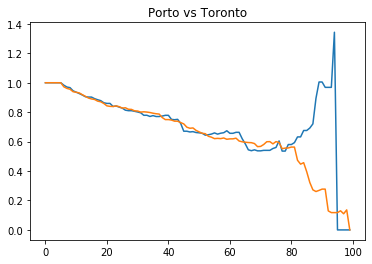

---------------------   Porto  vs.  Munich   ---------------------
Discrete Frechet distance:  1.0236475179777917 



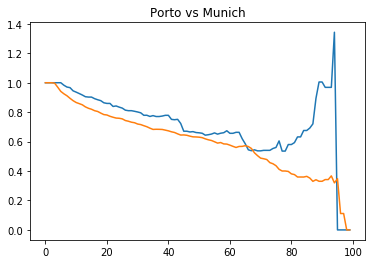

---------------------   Prague  vs.  Prague   ---------------------
Discrete Frechet distance:  0.0 



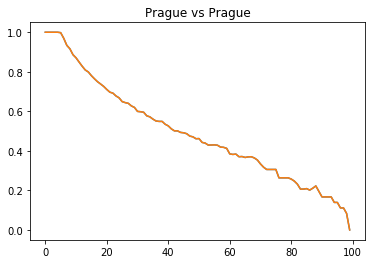

---------------------   Prague  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.39055530766617874 



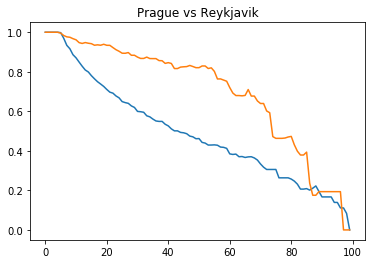

---------------------   Prague  vs.  Riga   ---------------------
Discrete Frechet distance:  0.38945205286120965 



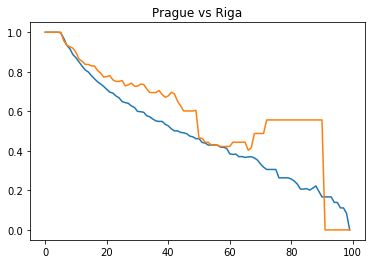

---------------------   Prague  vs.  Rio   ---------------------
Discrete Frechet distance:  1.5281726682222394 



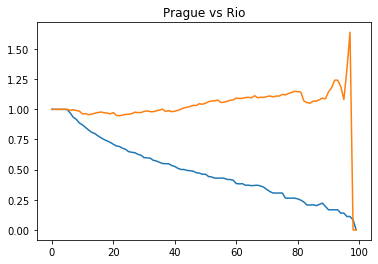

---------------------   Prague  vs.  Rome   ---------------------
Discrete Frechet distance:  0.07638333902557415 



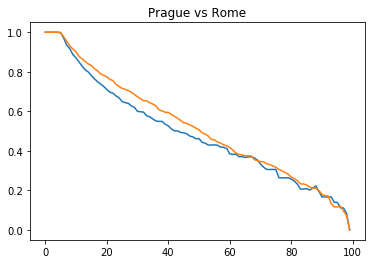

---------------------   Prague  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.7720718833382277 



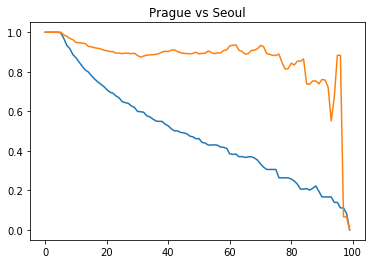

---------------------   Prague  vs.  Siena   ---------------------
Discrete Frechet distance:  0.12333826738958387 



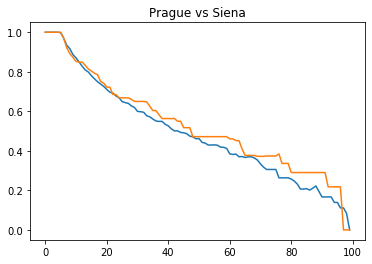

---------------------   Prague  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.2850820788245632 



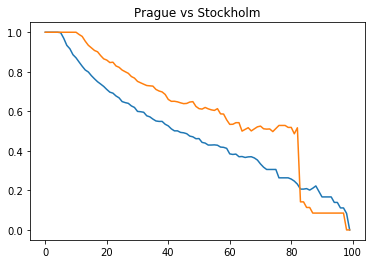

---------------------   Prague  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.8662767929387237 



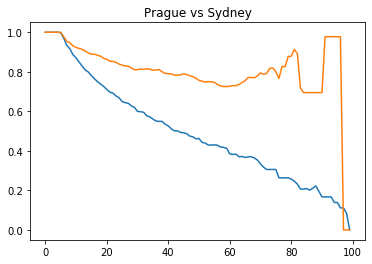

---------------------   Prague  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.0582028109237676 



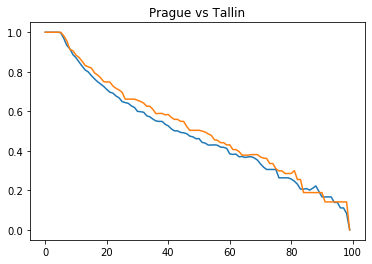

---------------------   Prague  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.22254563592163915 



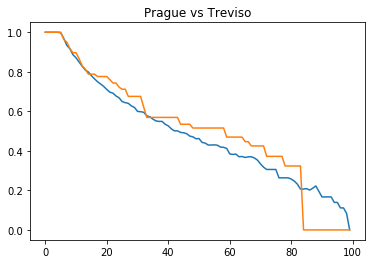

---------------------   Prague  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.22611905191806775 



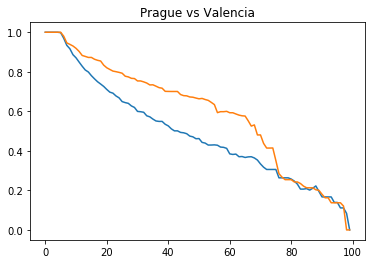

---------------------   Prague  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.3595385385278471 



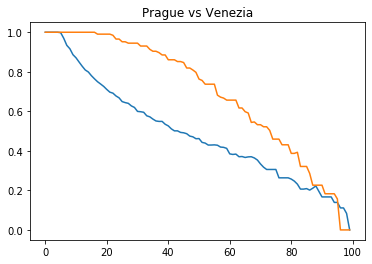

---------------------   Prague  vs.  Verona   ---------------------
Discrete Frechet distance:  0.0975947201298028 



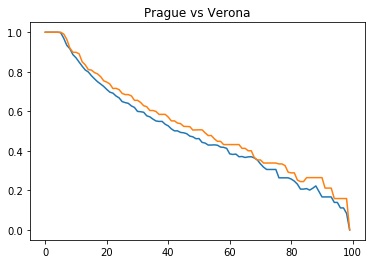

---------------------   Prague  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.16380117458761334 



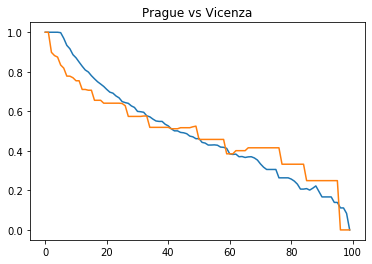

---------------------   Prague  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.7158215863790682 



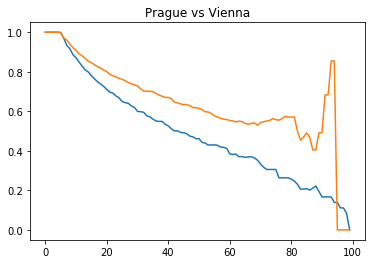

---------------------   Prague  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.1338170351414363 



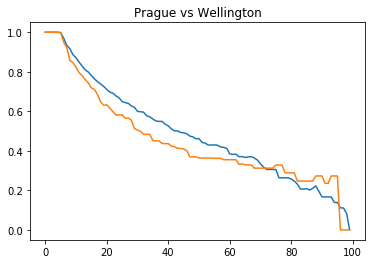

---------------------   Prague  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.4167474607541245 



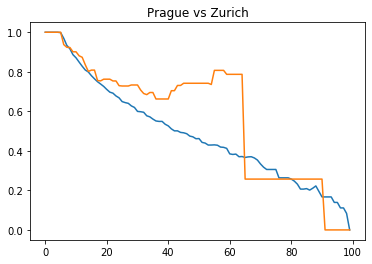

---------------------   Prague  vs.  Milan   ---------------------
Discrete Frechet distance:  0.17996092827998372 



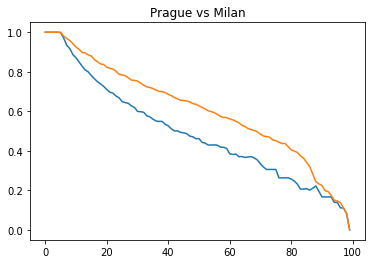

---------------------   Prague  vs.  London   ---------------------
Discrete Frechet distance:  0.2015890182168345 



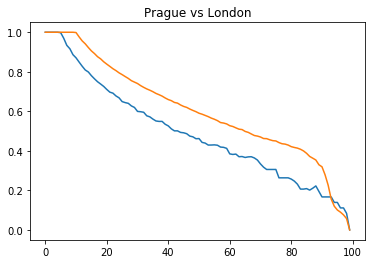

---------------------   Prague  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.555779246407081 



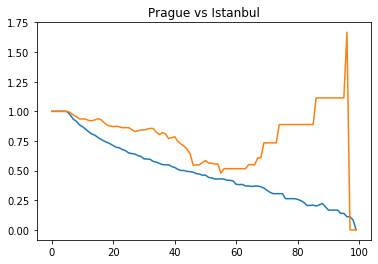

---------------------   Prague  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.36424166909072725 



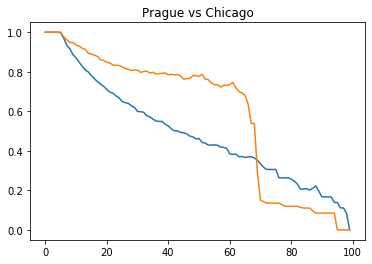

---------------------   Prague  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.3303732622701603 



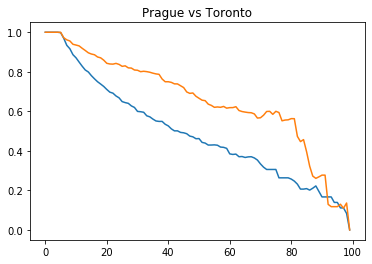

---------------------   Prague  vs.  Munich   ---------------------
Discrete Frechet distance:  0.2090257927256222 



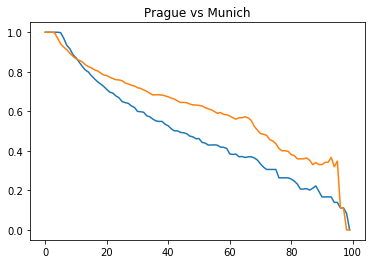

---------------------   Reykjavik  vs.  Reykjavik   ---------------------
Discrete Frechet distance:  0.0 



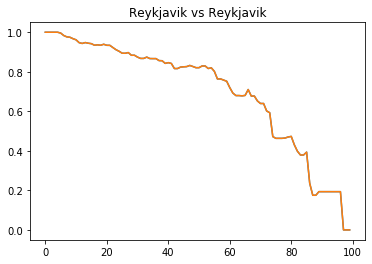

---------------------   Reykjavik  vs.  Riga   ---------------------
Discrete Frechet distance:  0.39120338898103135 



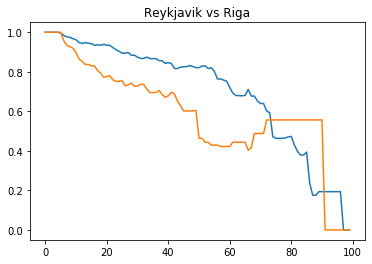

---------------------   Reykjavik  vs.  Rio   ---------------------
Discrete Frechet distance:  1.639445486183051 



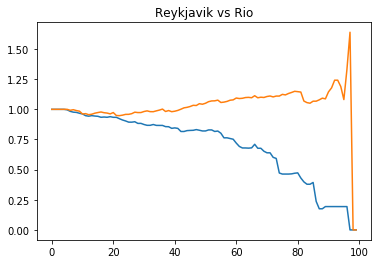

---------------------   Reykjavik  vs.  Rome   ---------------------
Discrete Frechet distance:  0.3623679528725502 



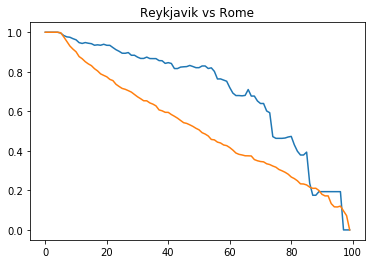

---------------------   Reykjavik  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.6898050049998229 



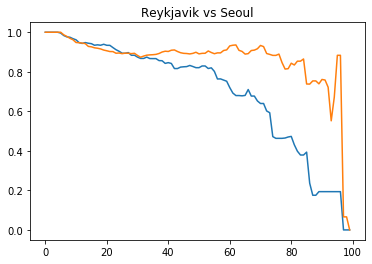

---------------------   Reykjavik  vs.  Siena   ---------------------
Discrete Frechet distance:  0.35748363560842483 



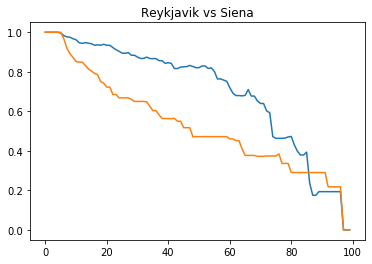

---------------------   Reykjavik  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.2799328763142961 



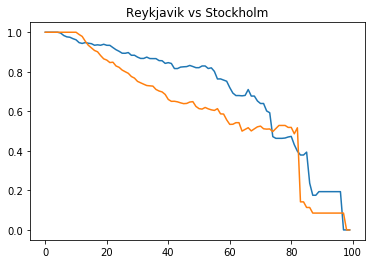

---------------------   Reykjavik  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.7840099146003189 



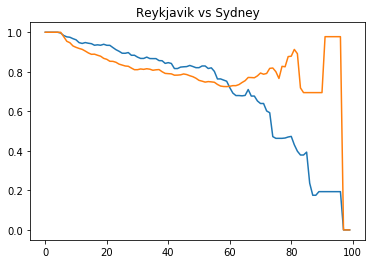

---------------------   Reykjavik  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.3454297975244147 



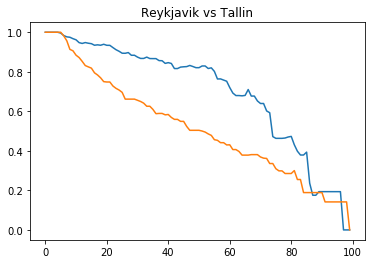

---------------------   Reykjavik  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.39347525776135645 



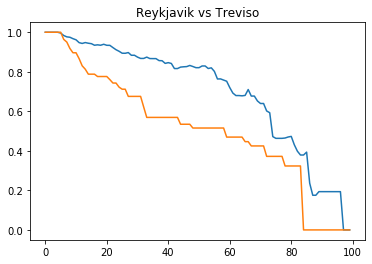

---------------------   Reykjavik  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.21881084652200072 



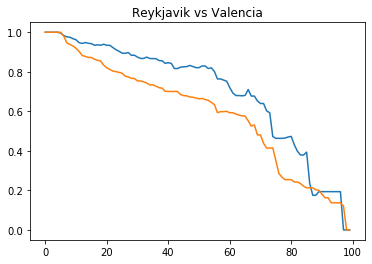

---------------------   Reykjavik  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.1935396962992165 



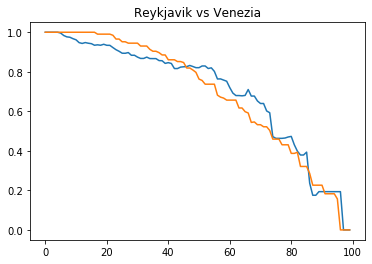

---------------------   Reykjavik  vs.  Verona   ---------------------
Discrete Frechet distance:  0.34252678150059973 



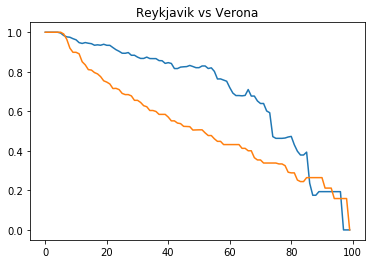

---------------------   Reykjavik  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.3715178519550482 



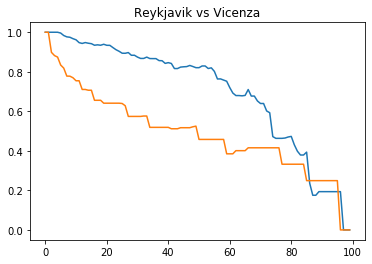

---------------------   Reykjavik  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.6613729125308718 



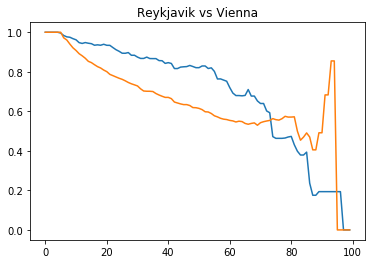

---------------------   Reykjavik  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.46583406491089685 



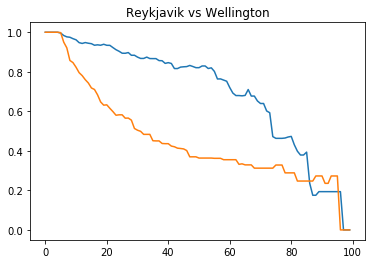

---------------------   Reykjavik  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.45304125000999035 



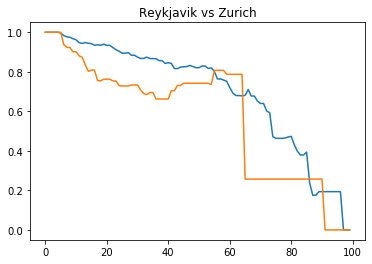

---------------------   Reykjavik  vs.  Milan   ---------------------
Discrete Frechet distance:  0.22163313313028976 



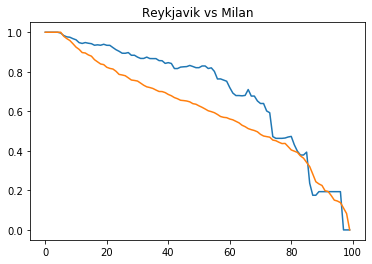

---------------------   Reykjavik  vs.  London   ---------------------
Discrete Frechet distance:  0.2543810136690756 



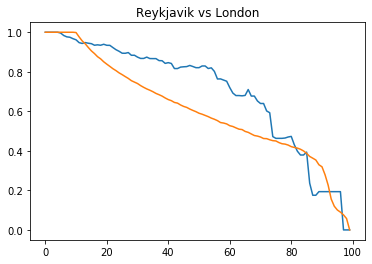

---------------------   Reykjavik  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.4735123680686761 



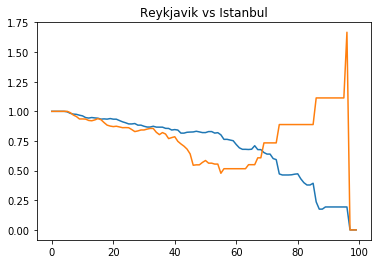

---------------------   Reykjavik  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.49649560624160194 



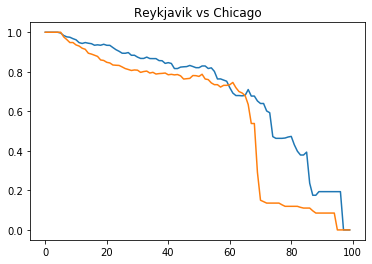

---------------------   Reykjavik  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.18997364440132425 



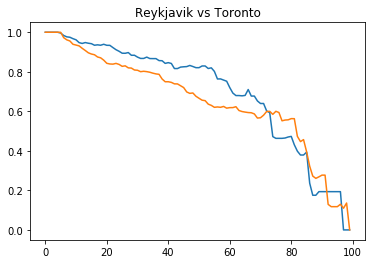

---------------------   Reykjavik  vs.  Munich   ---------------------
Discrete Frechet distance:  0.21226529469298727 



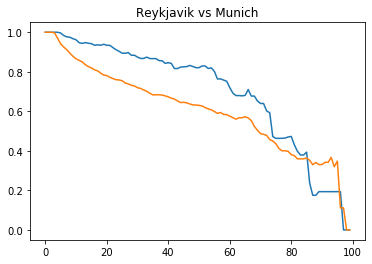

---------------------   Riga  vs.  Riga   ---------------------
Discrete Frechet distance:  0.0 



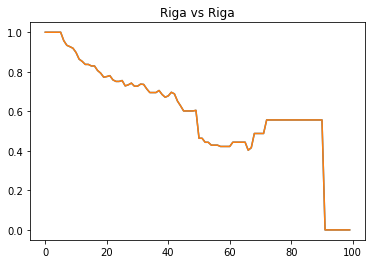

---------------------   Riga  vs.  Rio   ---------------------
Discrete Frechet distance:  1.639445486183051 



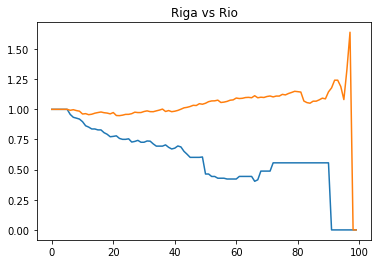

---------------------   Riga  vs.  Rome   ---------------------
Discrete Frechet distance:  0.37645077168684205 



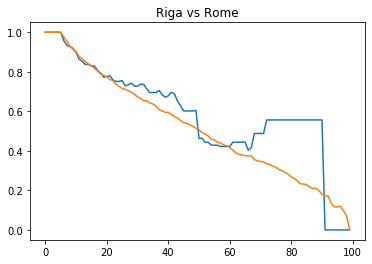

---------------------   Riga  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.8833447012990394 



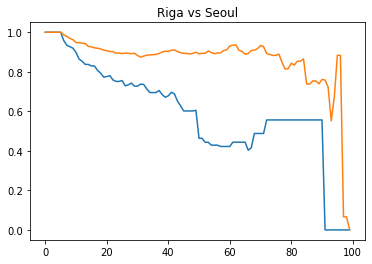

---------------------   Riga  vs.  Siena   ---------------------
Discrete Frechet distance:  0.29024749433081465 



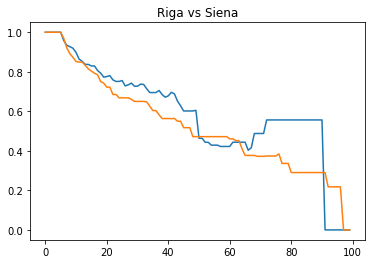

---------------------   Riga  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.4712044937172126 



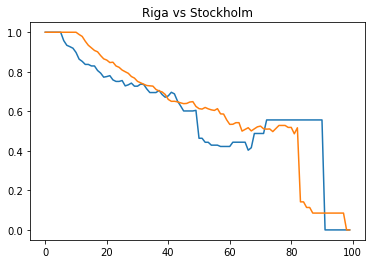

---------------------   Riga  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.9775496108995354 



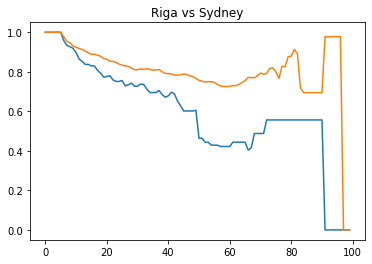

---------------------   Riga  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.3674847139432192 



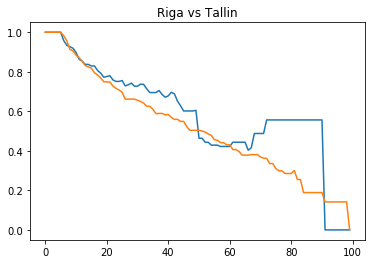

---------------------   Riga  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.5563612798024404 



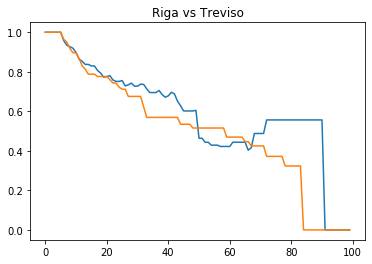

---------------------   Riga  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.3758526337287297 



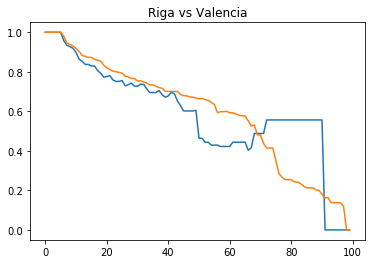

---------------------   Riga  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.3300560463014067 



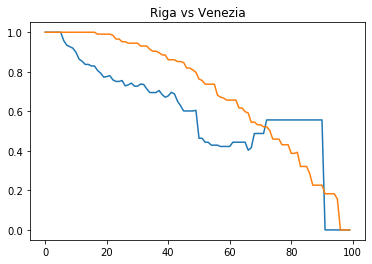

---------------------   Riga  vs.  Verona   ---------------------
Discrete Frechet distance:  0.3118263053533473 



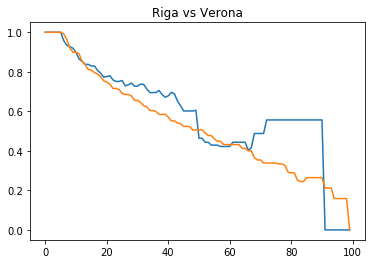

---------------------   Riga  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.3070934957020981 



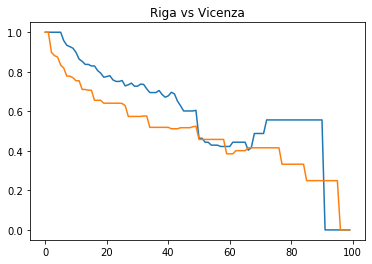

---------------------   Riga  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.8549126088300883 



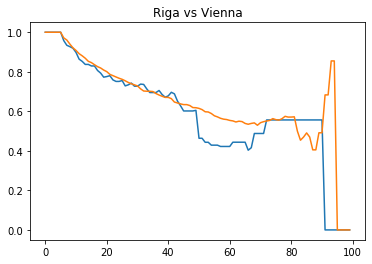

---------------------   Riga  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.3091084029109238 



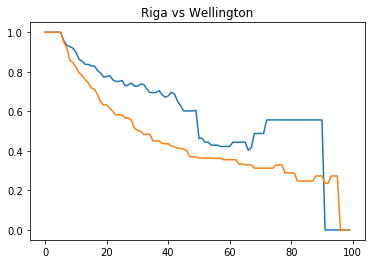

---------------------   Riga  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.3849762548060931 



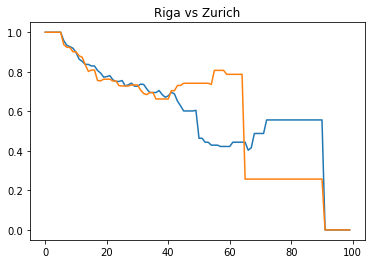

---------------------   Riga  vs.  Milan   ---------------------
Discrete Frechet distance:  0.3315023538968901 



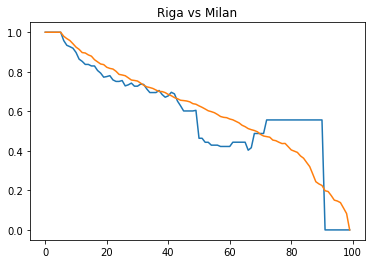

---------------------   Riga  vs.  London   ---------------------
Discrete Frechet distance:  0.27890838909561644 



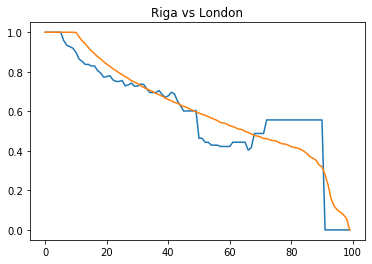

---------------------   Riga  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.6670520643678925 



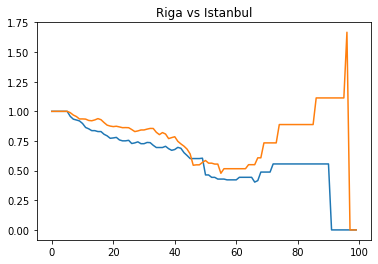

---------------------   Riga  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.47107164702858756 



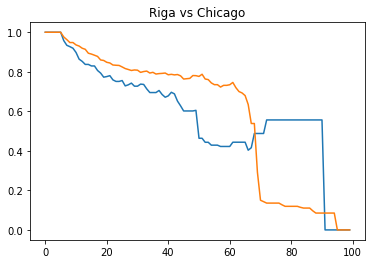

---------------------   Riga  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.2955227098864485 



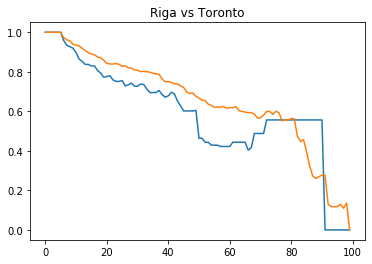

---------------------   Riga  vs.  Munich   ---------------------
Discrete Frechet distance:  0.3671130278414978 



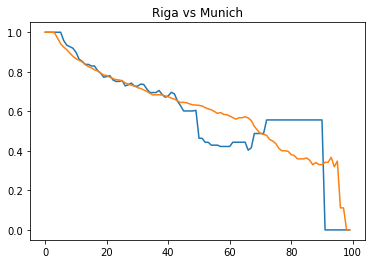

---------------------   Rio  vs.  Rio   ---------------------
Discrete Frechet distance:  0.0 



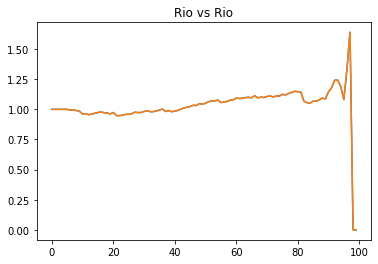

---------------------   Rio  vs.  Rome   ---------------------
Discrete Frechet distance:  1.5431618102610392 



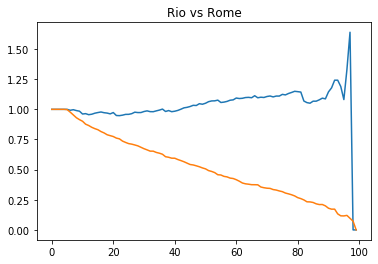

---------------------   Rio  vs.  Seoul   ---------------------
Discrete Frechet distance:  1.2536699712851935 



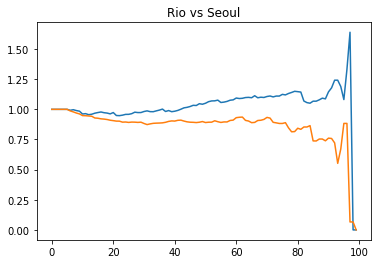

---------------------   Rio  vs.  Siena   ---------------------
Discrete Frechet distance:  1.639445486183051 



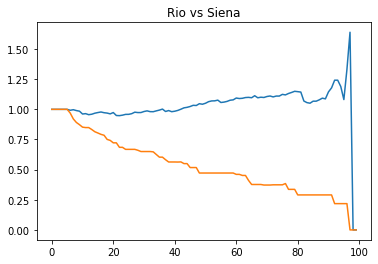

---------------------   Rio  vs.  Stockholm   ---------------------
Discrete Frechet distance:  1.5542887000978232 



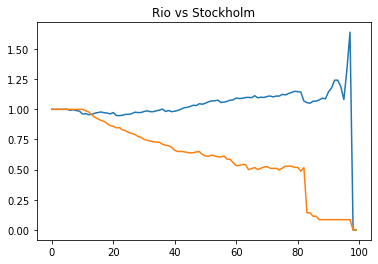

---------------------   Rio  vs.  Sydney   ---------------------
Discrete Frechet distance:  1.1992106360924804 



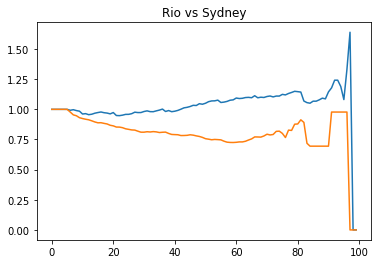

---------------------   Rio  vs.  Tallin   ---------------------
Discrete Frechet distance:  1.4977880617886912 



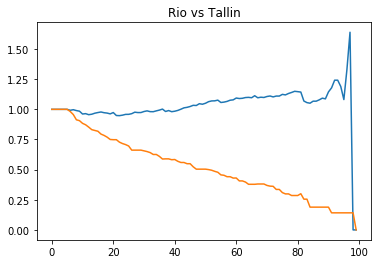

---------------------   Rio  vs.  Treviso   ---------------------
Discrete Frechet distance:  1.639445486183051 



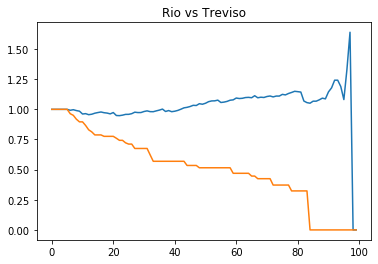

---------------------   Rio  vs.  Valencia   ---------------------
Discrete Frechet distance:  1.518685313818874 



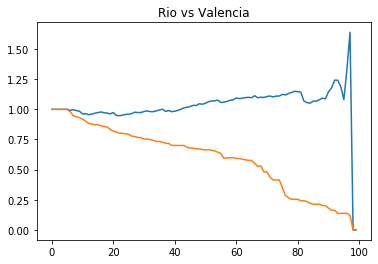

---------------------   Rio  vs.  Venezia   ---------------------
Discrete Frechet distance:  1.639445486183051 



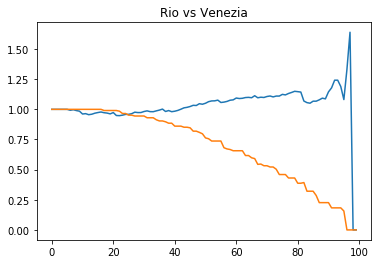

---------------------   Rio  vs.  Verona   ---------------------
Discrete Frechet distance:  1.4807431179404873 



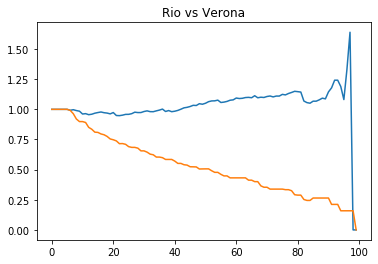

---------------------   Rio  vs.  Vicenza   ---------------------
Discrete Frechet distance:  1.639445486183051 



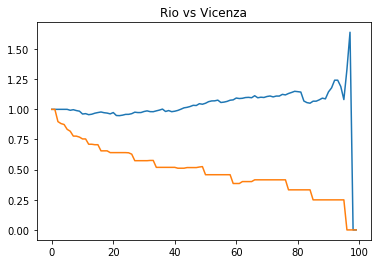

---------------------   Rio  vs.  Vienna   ---------------------
Discrete Frechet distance:  1.639445486183051 



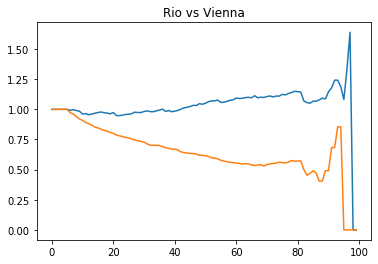

---------------------   Rio  vs.  Wellington   ---------------------
Discrete Frechet distance:  1.639445486183051 



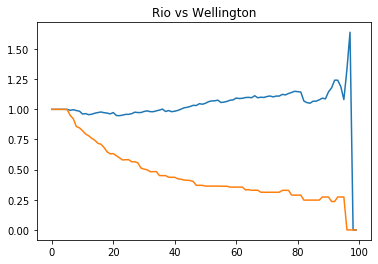

---------------------   Rio  vs.  Zurich   ---------------------
Discrete Frechet distance:  1.639445486183051 



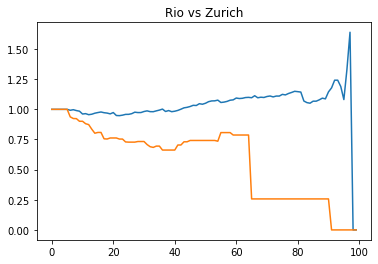

---------------------   Rio  vs.  Milan   ---------------------
Discrete Frechet distance:  1.5286270493096397 



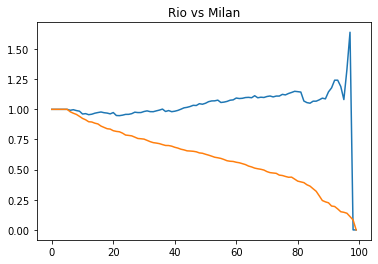

---------------------   Rio  vs.  London   ---------------------
Discrete Frechet distance:  1.5634153890236913 



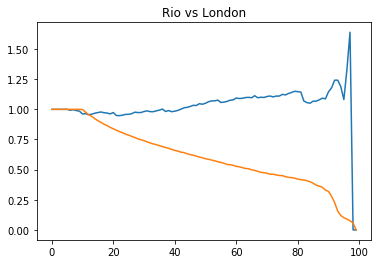

---------------------   Rio  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.0003809890032276 



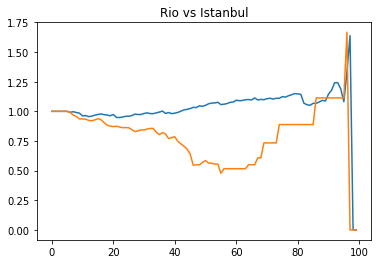

---------------------   Rio  vs.  Chicago   ---------------------
Discrete Frechet distance:  1.639445486183051 



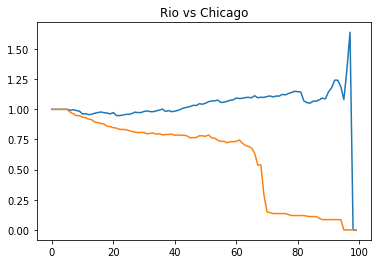

---------------------   Rio  vs.  Toronto   ---------------------
Discrete Frechet distance:  1.5297153636401715 



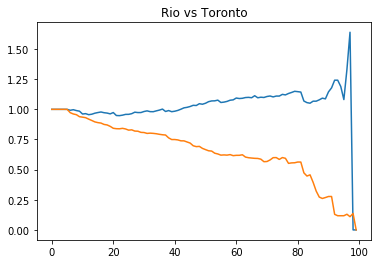

---------------------   Rio  vs.  Munich   ---------------------
Discrete Frechet distance:  1.5280478844271705 



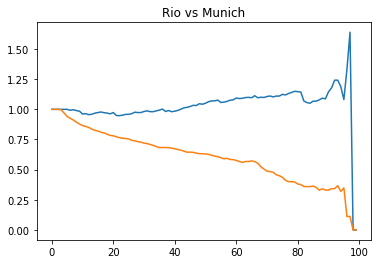

---------------------   Rome  vs.  Rome   ---------------------
Discrete Frechet distance:  0.0 



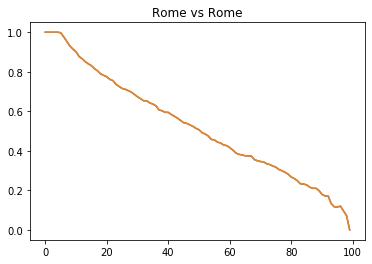

---------------------   Rome  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.7672827345933967 



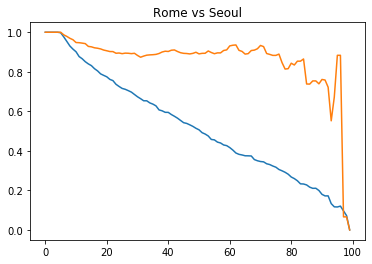

---------------------   Rome  vs.  Siena   ---------------------
Discrete Frechet distance:  0.11818803021446708 



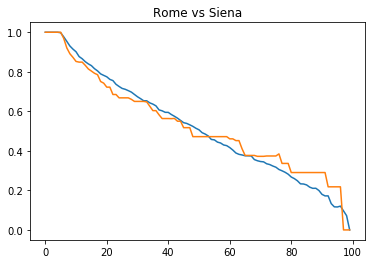

---------------------   Rome  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.26795658140318934 



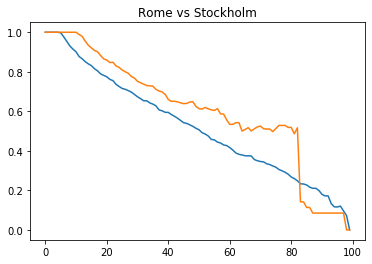

---------------------   Rome  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.8614876441938927 



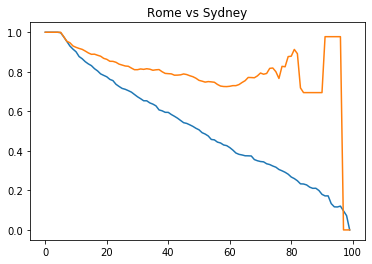

---------------------   Rome  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.06944466745289402 



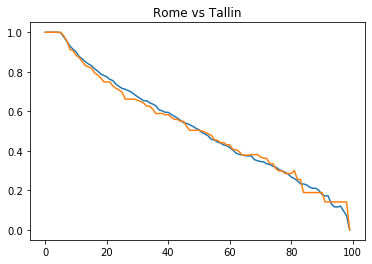

---------------------   Rome  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.23228541849767448 



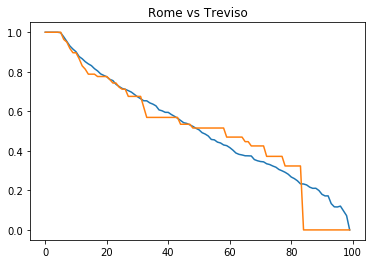

---------------------   Rome  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.20100700660909715 



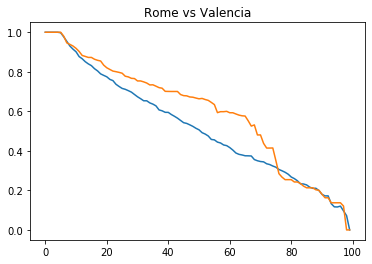

---------------------   Rome  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.30421464250310337 



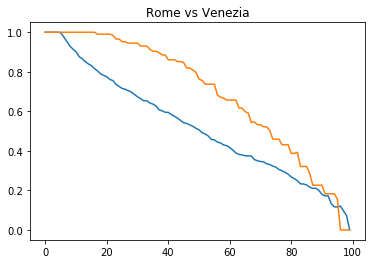

---------------------   Rome  vs.  Verona   ---------------------
Discrete Frechet distance:  0.08648961130109786 



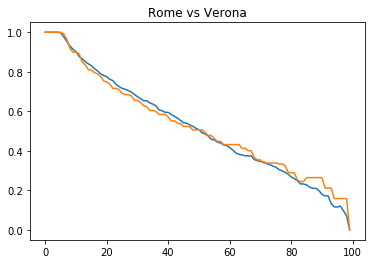

---------------------   Rome  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.1755008683425997 



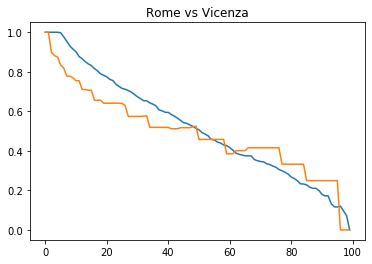

---------------------   Rome  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.7381215998669977 



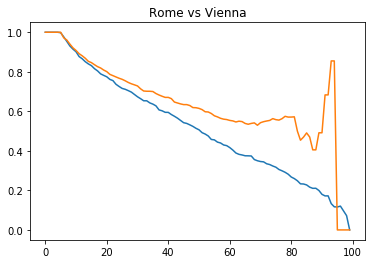

---------------------   Rome  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.1853041918202052 



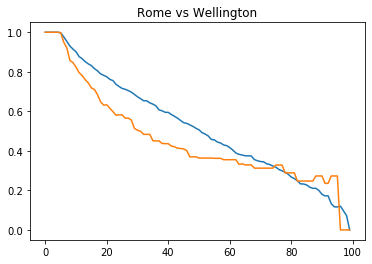

---------------------   Rome  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.40789190832865285 



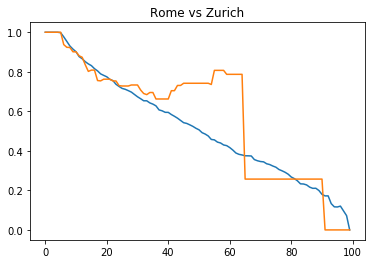

---------------------   Rome  vs.  Milan   ---------------------
Discrete Frechet distance:  0.16032010108730926 



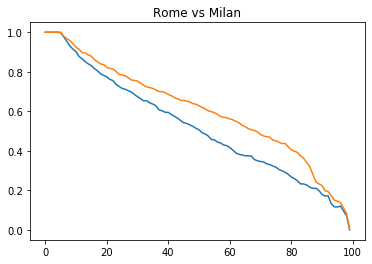

---------------------   Rome  vs.  London   ---------------------
Discrete Frechet distance:  0.17492376515118052 



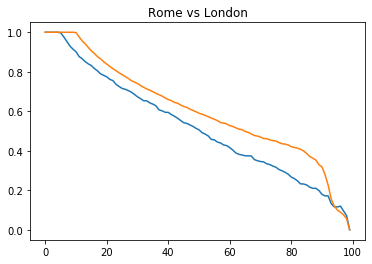

---------------------   Rome  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.5466974694653635 



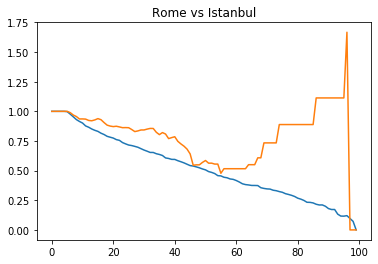

---------------------   Rome  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.34211980293014627 



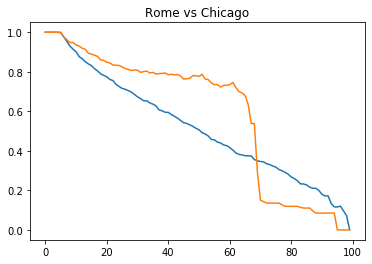

---------------------   Rome  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.30312285848524945 



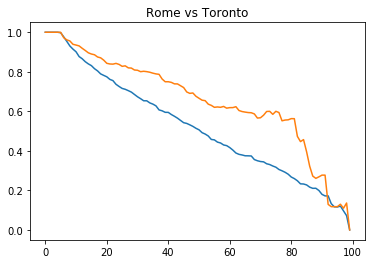

---------------------   Rome  vs.  Munich   ---------------------
Discrete Frechet distance:  0.23409581196331933 



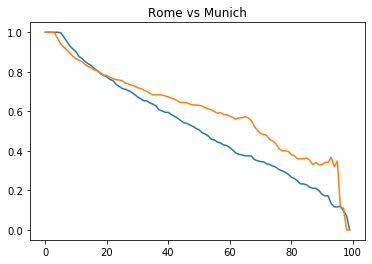

---------------------   Seoul  vs.  Seoul   ---------------------
Discrete Frechet distance:  0.0 



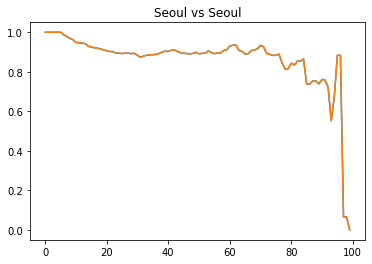

---------------------   Seoul  vs.  Siena   ---------------------
Discrete Frechet distance:  0.6653370799891507 



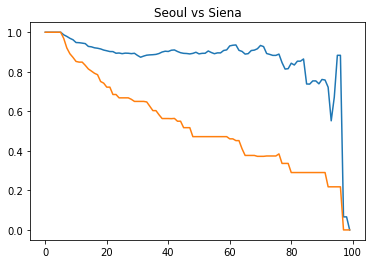

---------------------   Seoul  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.7981879152138116 



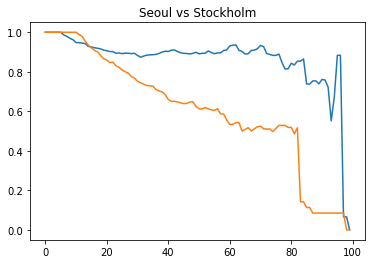

---------------------   Seoul  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.42563822873334545 



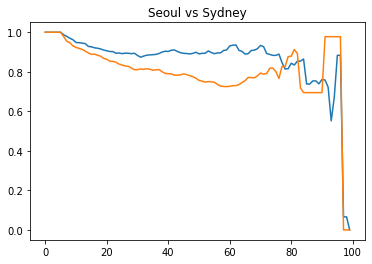

---------------------   Seoul  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.7416872769046796 



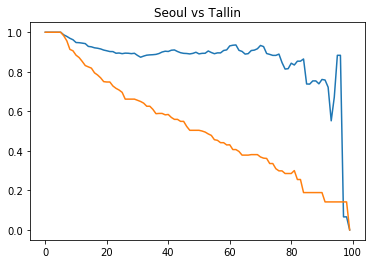

---------------------   Seoul  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.8833447012990394 



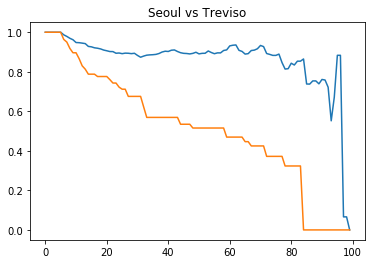

---------------------   Seoul  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.7460949836691908 



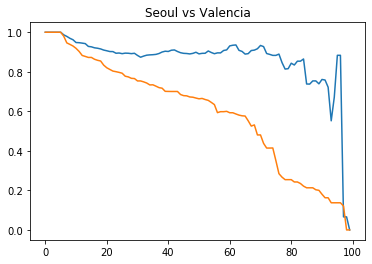

---------------------   Seoul  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.8833447012990394 



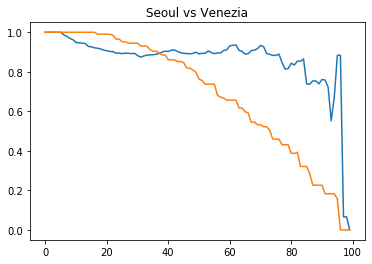

---------------------   Seoul  vs.  Verona   ---------------------
Discrete Frechet distance:  0.7246423330564759 



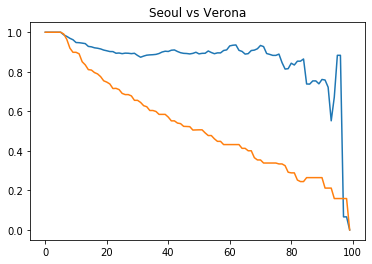

---------------------   Seoul  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.8833447012990394 



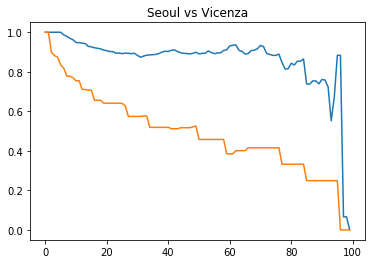

---------------------   Seoul  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.8833447012990394 



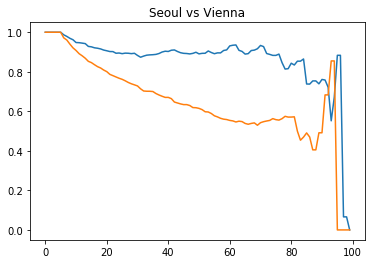

---------------------   Seoul  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.8833447012990394 



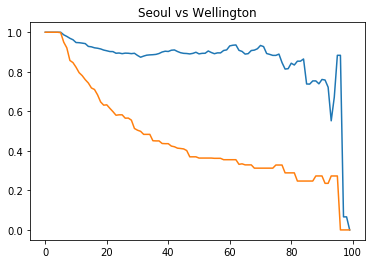

---------------------   Seoul  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.8833447012990394 



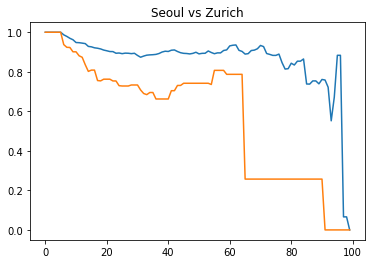

---------------------   Seoul  vs.  Milan   ---------------------
Discrete Frechet distance:  0.7451477270975471 



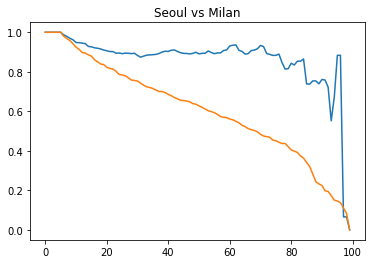

---------------------   Seoul  vs.  London   ---------------------
Discrete Frechet distance:  0.793408067056383 



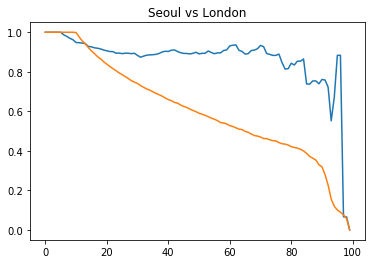

---------------------   Seoul  vs.  Istanbul   ---------------------
Discrete Frechet distance:  0.7837073630688531 



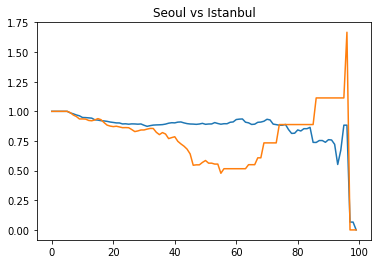

---------------------   Seoul  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.8833447012990394 



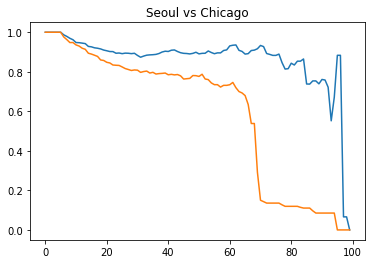

---------------------   Seoul  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.7657230299297724 



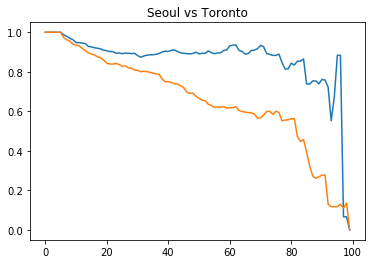

---------------------   Seoul  vs.  Munich   ---------------------
Discrete Frechet distance:  0.7719470995431591 



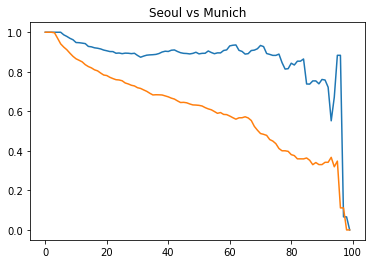

---------------------   Siena  vs.  Siena   ---------------------
Discrete Frechet distance:  0.0 



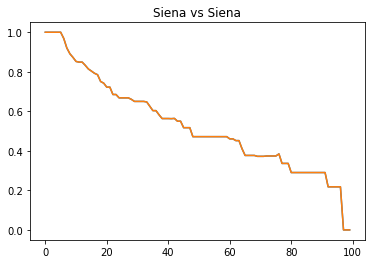

---------------------   Siena  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.2283302057594978 



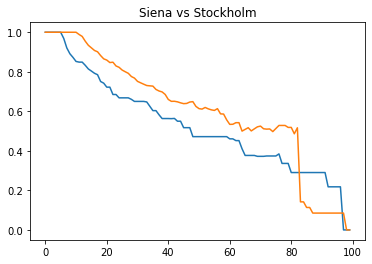

---------------------   Siena  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.7595419895896467 



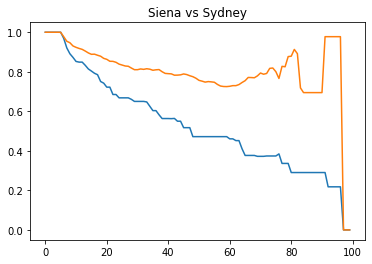

---------------------   Siena  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.1485900699364549 



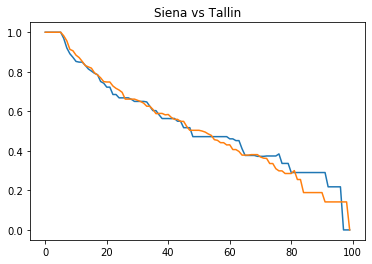

---------------------   Siena  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.29024749433081465 



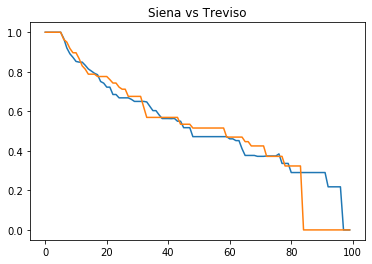

---------------------   Siena  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.19948204626311355 



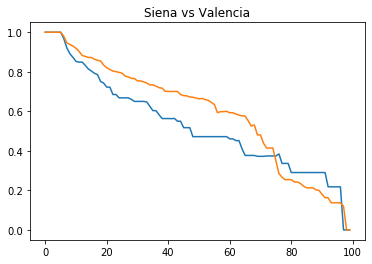

---------------------   Siena  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.3371405074617481 



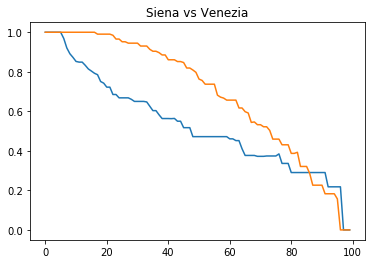

---------------------   Siena  vs.  Verona   ---------------------
Discrete Frechet distance:  0.1587023682425636 



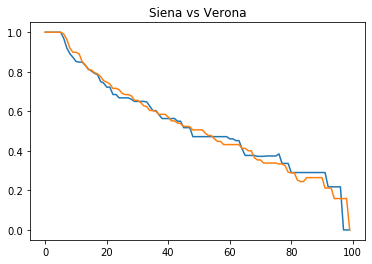

---------------------   Siena  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.21800762130988874 



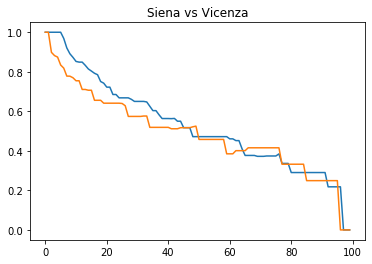

---------------------   Siena  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.6369049875201996 



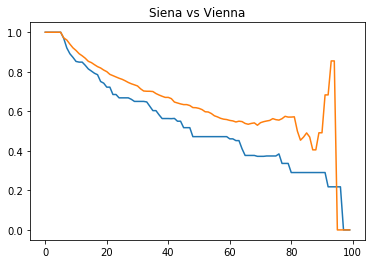

---------------------   Siena  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.21800762130988874 



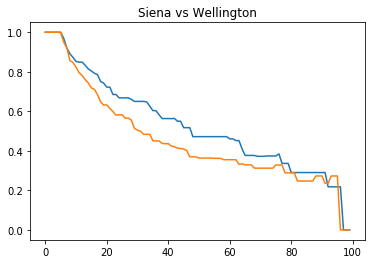

---------------------   Siena  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.3766102394172228 



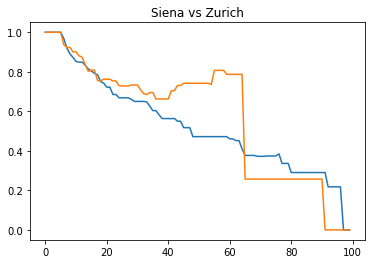

---------------------   Siena  vs.  Milan   ---------------------
Discrete Frechet distance:  0.16689932119084233 



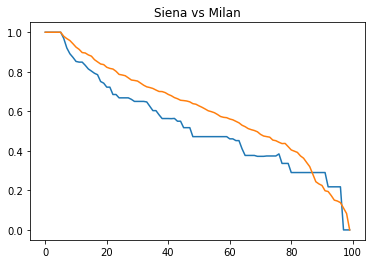

---------------------   Siena  vs.  London   ---------------------
Discrete Frechet distance:  0.14616583426520857 



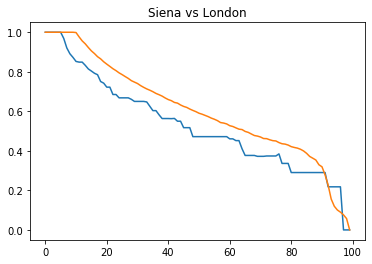

---------------------   Siena  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.4490444430580038 



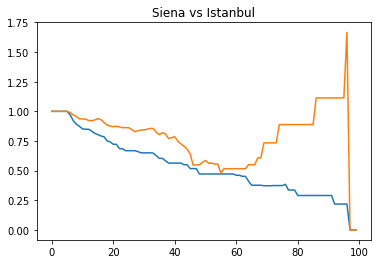

---------------------   Siena  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.315660554749214 



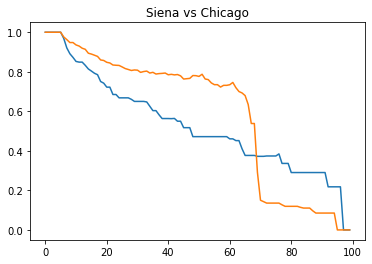

---------------------   Siena  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.27274037658779404 



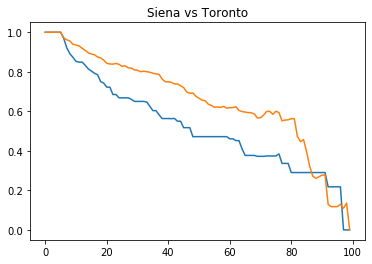

---------------------   Siena  vs.  Munich   ---------------------
Discrete Frechet distance:  0.195584371887557 



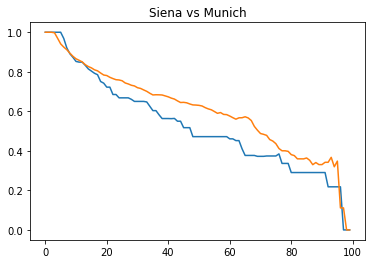

---------------------   Stockholm  vs.  Stockholm   ---------------------
Discrete Frechet distance:  0.0 



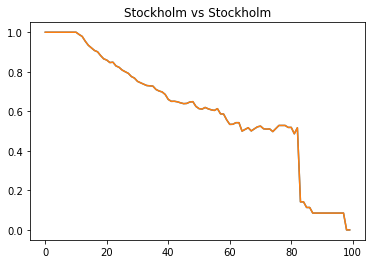

---------------------   Stockholm  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.8923928248143076 



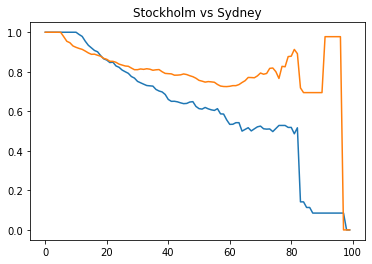

---------------------   Stockholm  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.2616268610662791 



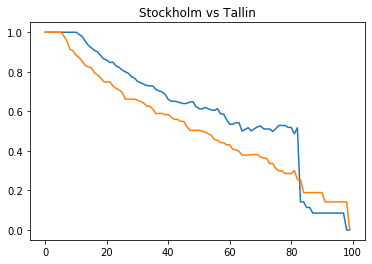

---------------------   Stockholm  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.20498107152064576 



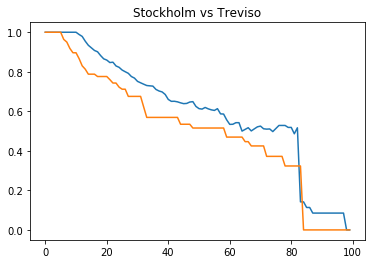

---------------------   Stockholm  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.2741905423628836 



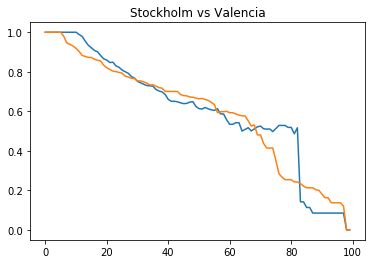

---------------------   Stockholm  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.21024570972881518 



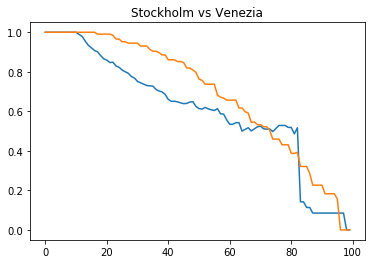

---------------------   Stockholm  vs.  Verona   ---------------------
Discrete Frechet distance:  0.2642499647307868 



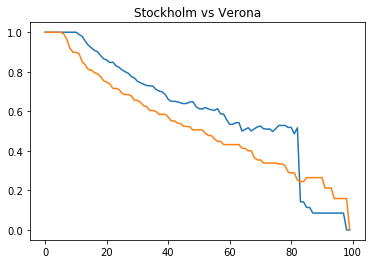

---------------------   Stockholm  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.268354557509368 



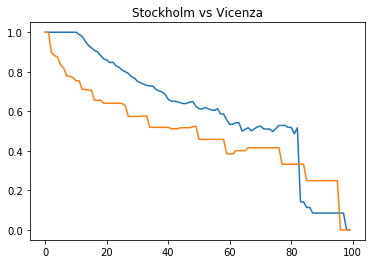

---------------------   Stockholm  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.7697558227448605 



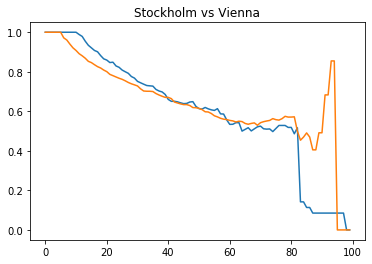

---------------------   Stockholm  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.2790664344344798 



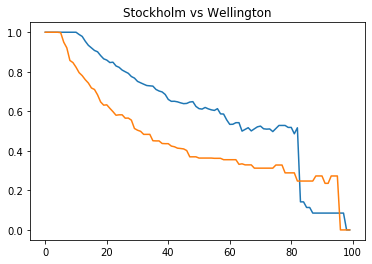

---------------------   Stockholm  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.2872427220679998 



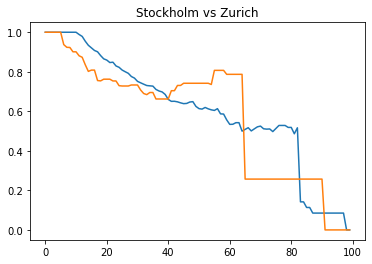

---------------------   Stockholm  vs.  Milan   ---------------------
Discrete Frechet distance:  0.2324425196552535 



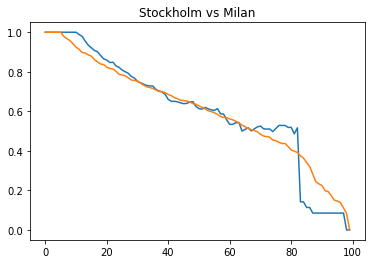

---------------------   Stockholm  vs.  London   ---------------------
Discrete Frechet distance:  0.2776850636845254 



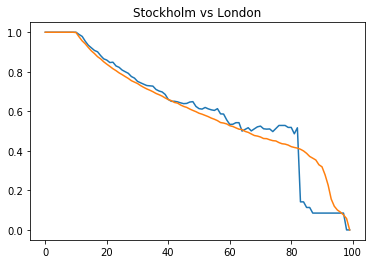

---------------------   Stockholm  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.5818952782826647 



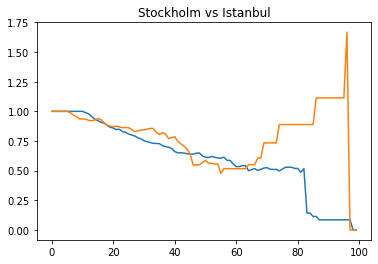

---------------------   Stockholm  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.4091112535406779 



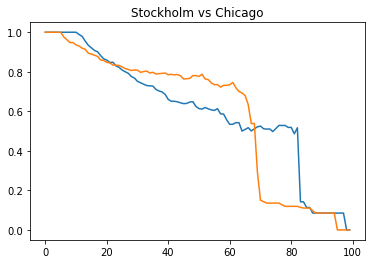

---------------------   Stockholm  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.31491037707422986 



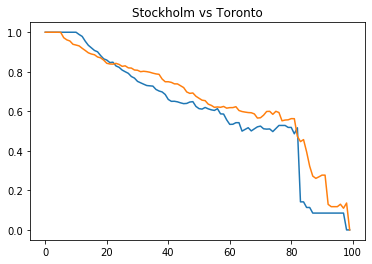

---------------------   Stockholm  vs.  Munich   ---------------------
Discrete Frechet distance:  0.28195624175627 



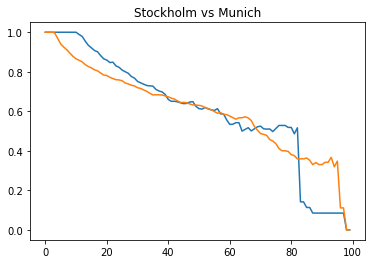

---------------------   Sydney  vs.  Sydney   ---------------------
Discrete Frechet distance:  0.0 



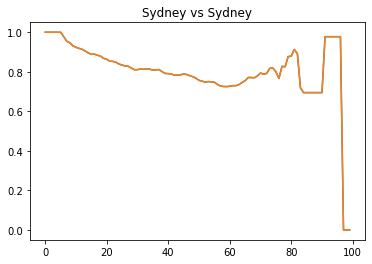

---------------------   Sydney  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.8358921865051756 



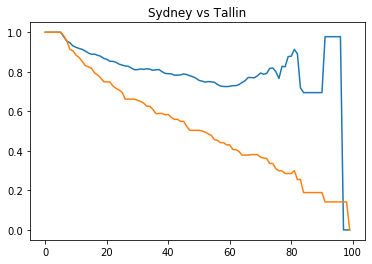

---------------------   Sydney  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.9775496108995354 



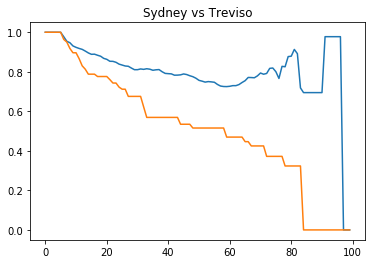

---------------------   Sydney  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.8402998932696868 



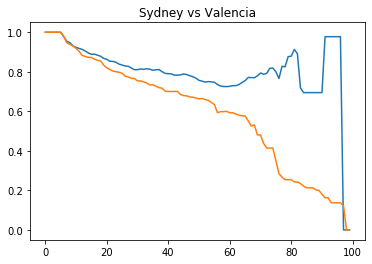

---------------------   Sydney  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.9775496108995354 



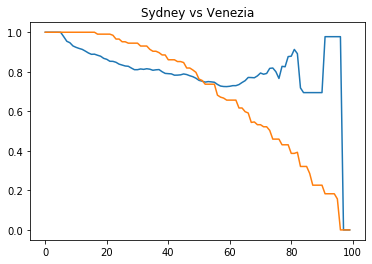

---------------------   Sydney  vs.  Verona   ---------------------
Discrete Frechet distance:  0.8188472426569718 



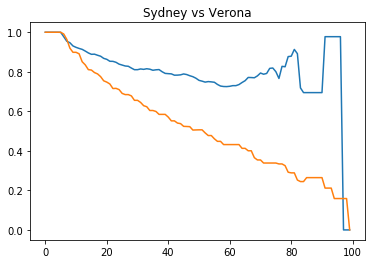

---------------------   Sydney  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.9775496108995354 



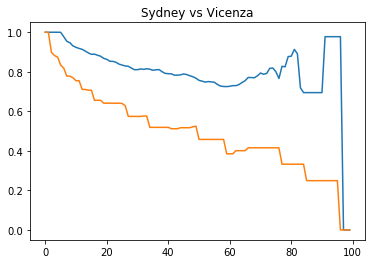

---------------------   Sydney  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.9775496108995354 



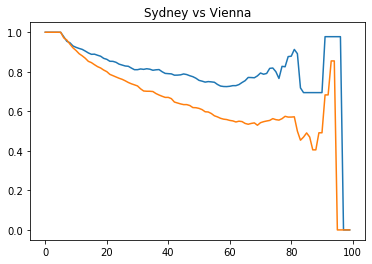

---------------------   Sydney  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.9775496108995354 



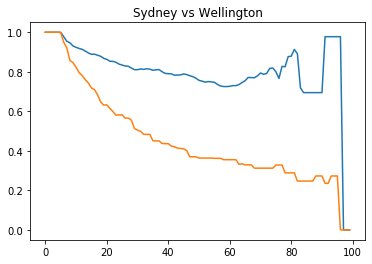

---------------------   Sydney  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.9775496108995354 



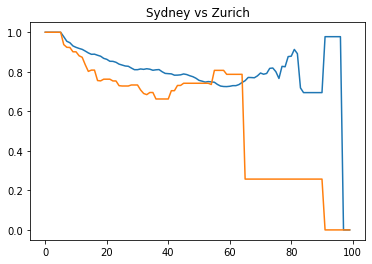

---------------------   Sydney  vs.  Milan   ---------------------
Discrete Frechet distance:  0.839352636698043 



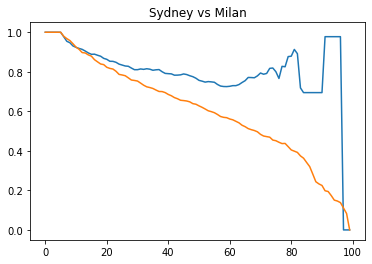

---------------------   Sydney  vs.  London   ---------------------
Discrete Frechet distance:  0.887612976656879 



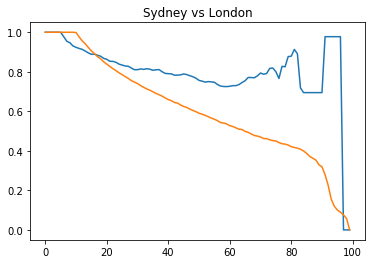

---------------------   Sydney  vs.  Istanbul   ---------------------
Discrete Frechet distance:  0.6895024534683571 



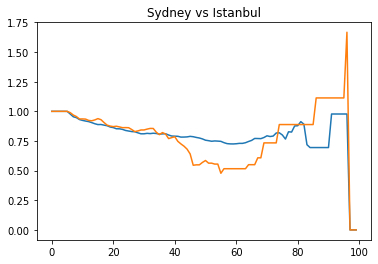

---------------------   Sydney  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.9775496108995354 



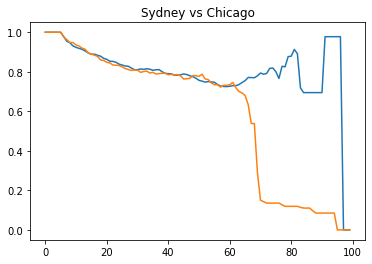

---------------------   Sydney  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.8599279395302684 



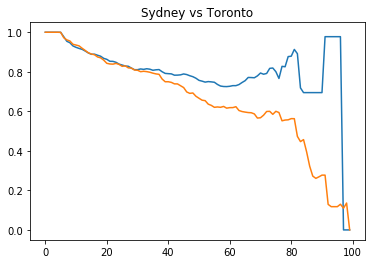

---------------------   Sydney  vs.  Munich   ---------------------
Discrete Frechet distance:  0.8661520091436551 



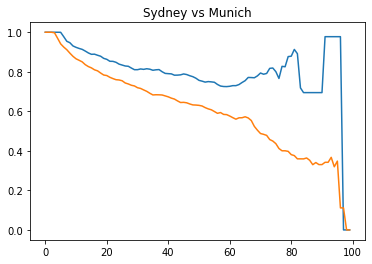

---------------------   Tallin  vs.  Tallin   ---------------------
Discrete Frechet distance:  0.0 



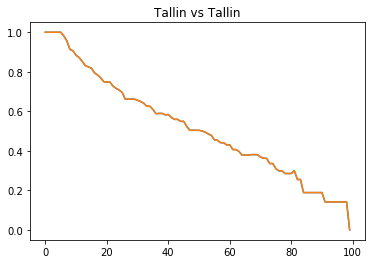

---------------------   Tallin  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.18887656585922125 



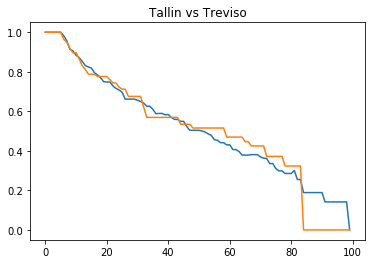

---------------------   Tallin  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.19894788493418097 



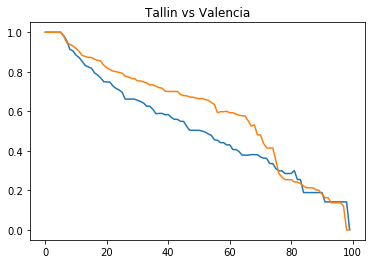

---------------------   Tallin  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.31581059299336445 



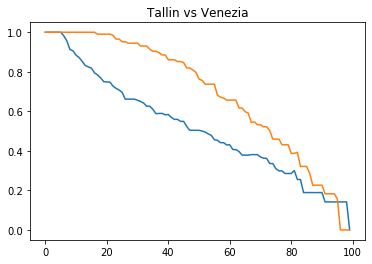

---------------------   Tallin  vs.  Verona   ---------------------
Discrete Frechet distance:  0.07562738121181234 



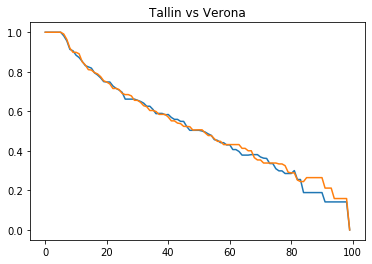

---------------------   Tallin  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.17840518680779283 



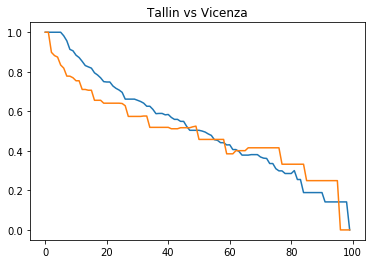

---------------------   Tallin  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.7132551844357287 



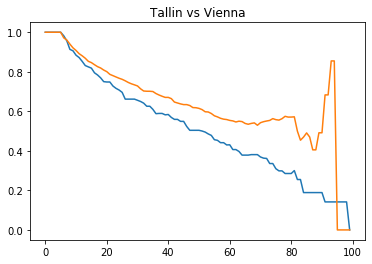

---------------------   Tallin  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.15873915820666717 



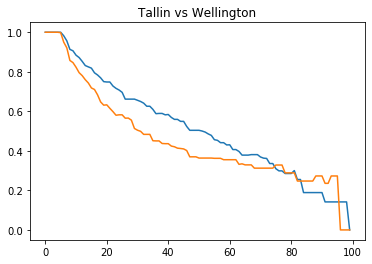

---------------------   Tallin  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.40867416011082763 



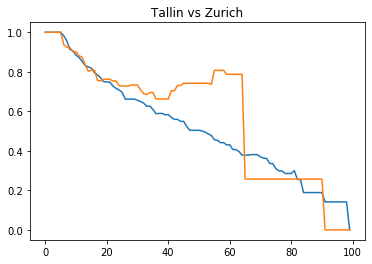

---------------------   Tallin  vs.  Milan   ---------------------
Discrete Frechet distance:  0.17404198634184032 



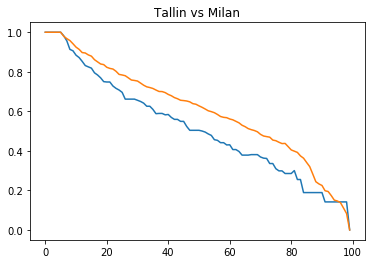

---------------------   Tallin  vs.  London   ---------------------
Discrete Frechet distance:  0.21066602993505956 



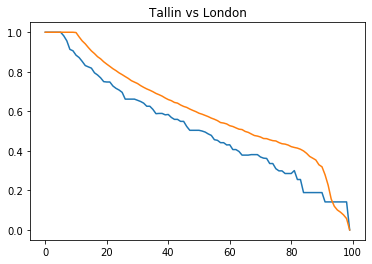

---------------------   Tallin  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.5253946399735328 



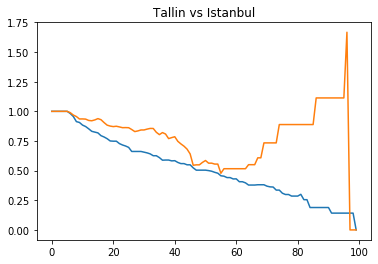

---------------------   Tallin  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.33961820426054173 



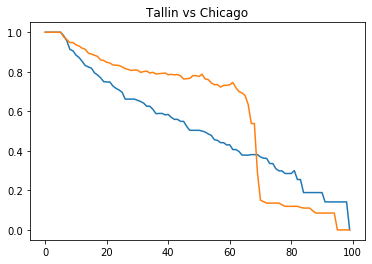

---------------------   Tallin  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.2951482524566991 



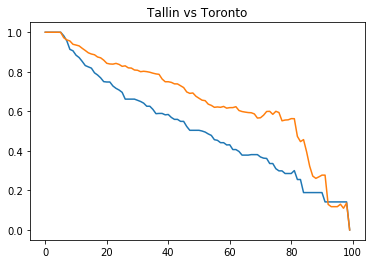

---------------------   Tallin  vs.  Munich   ---------------------
Discrete Frechet distance:  0.22545560344713805 



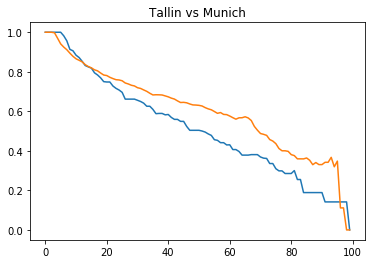

---------------------   Treviso  vs.  Treviso   ---------------------
Discrete Frechet distance:  0.0 



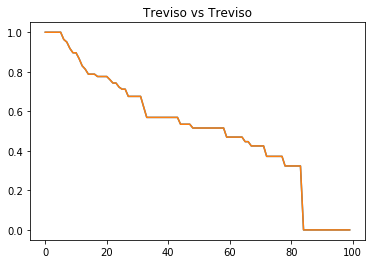

---------------------   Treviso  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.22145665639939938 



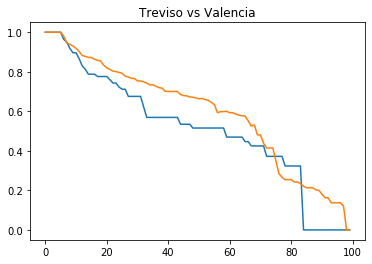

---------------------   Treviso  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.36103564831901447 



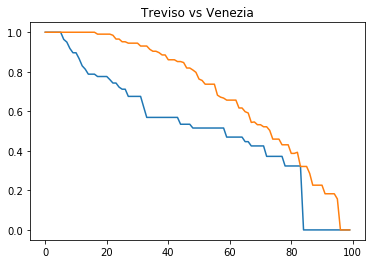

---------------------   Treviso  vs.  Verona   ---------------------
Discrete Frechet distance:  0.2645039470710336 



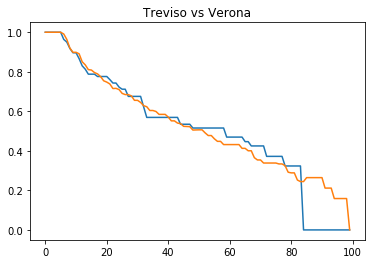

---------------------   Treviso  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.33235704546712314 



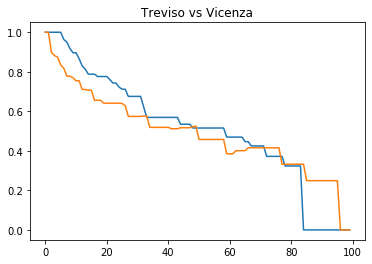

---------------------   Treviso  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.8549126088300883 



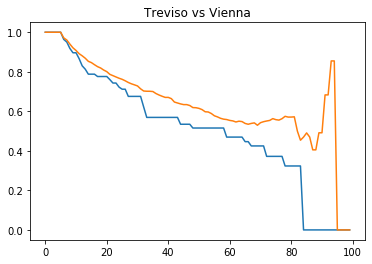

---------------------   Treviso  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.2729872854290622 



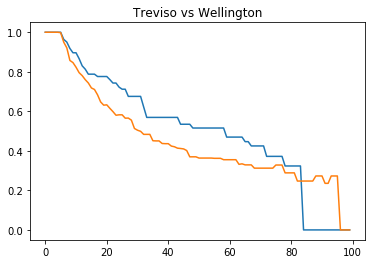

---------------------   Treviso  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.3174988487238296 



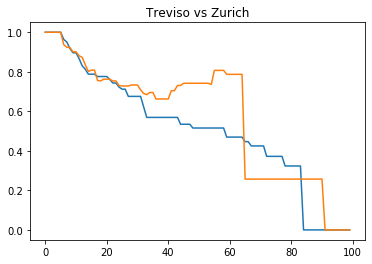

---------------------   Treviso  vs.  Milan   ---------------------
Discrete Frechet distance:  0.36291855220106156 



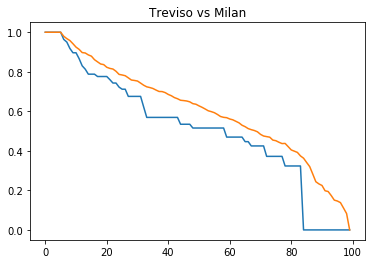

---------------------   Treviso  vs.  London   ---------------------
Discrete Frechet distance:  0.3995425957942808 



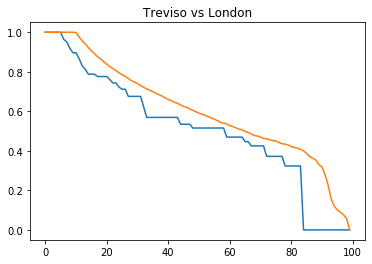

---------------------   Treviso  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.6670520643678925 



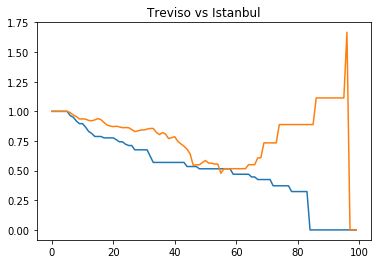

---------------------   Treviso  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.2818309398258848 



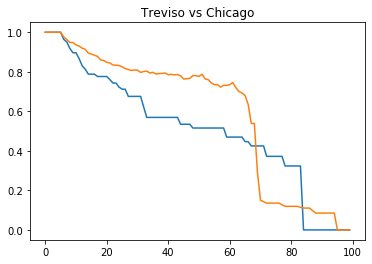

---------------------   Treviso  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.4568383538830778 



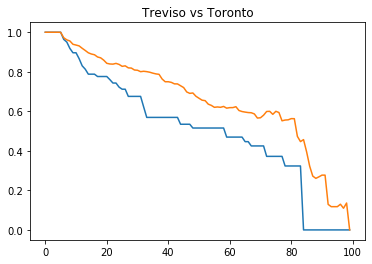

---------------------   Treviso  vs.  Munich   ---------------------
Discrete Frechet distance:  0.3671130278414978 



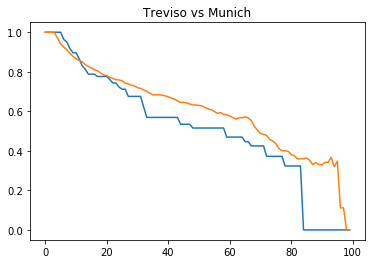

---------------------   Valencia  vs.  Valencia   ---------------------
Discrete Frechet distance:  0.0 



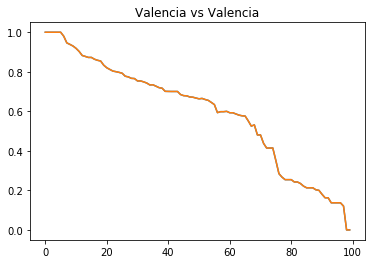

---------------------   Valencia  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.19109065824472493 



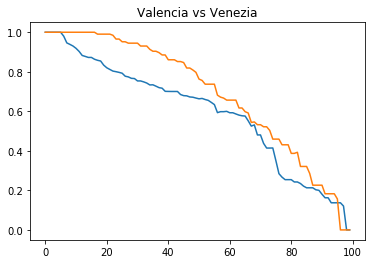

---------------------   Valencia  vs.  Verona   ---------------------
Discrete Frechet distance:  0.17792726170986534 



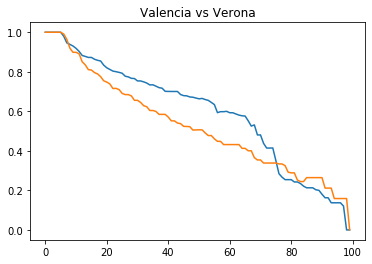

---------------------   Valencia  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.2152811004153916 



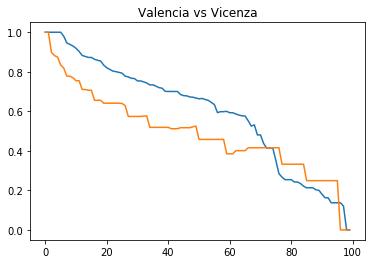

---------------------   Valencia  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.7176628912001849 



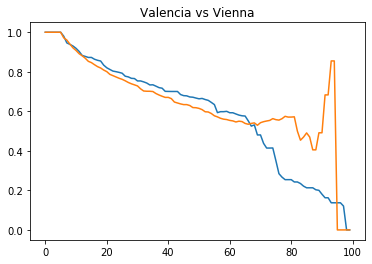

---------------------   Valencia  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.3028915082207763 



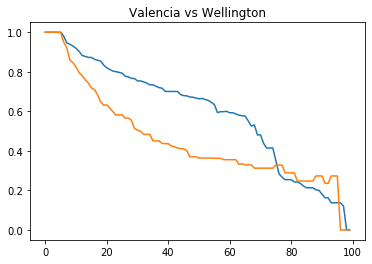

---------------------   Valencia  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.31899736712925025 



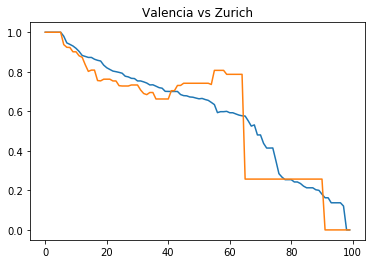

---------------------   Valencia  vs.  Milan   ---------------------
Discrete Frechet distance:  0.18333137917783227 



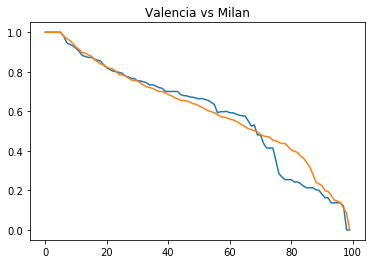

---------------------   Valencia  vs.  London   ---------------------
Discrete Frechet distance:  0.17978172169600343 



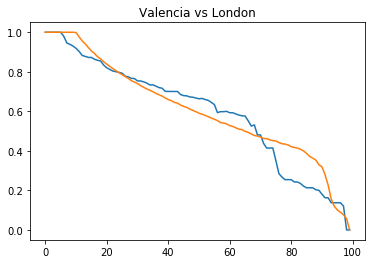

---------------------   Valencia  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.529802346738044 



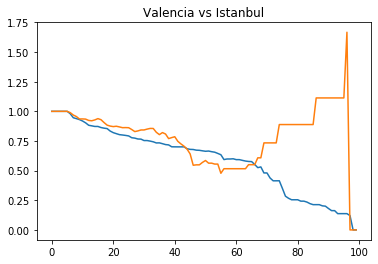

---------------------   Valencia  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.33038639490391253 



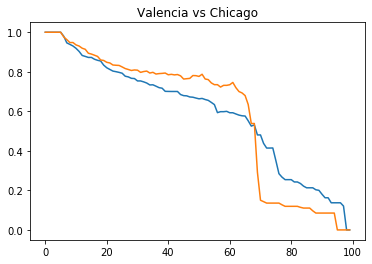

---------------------   Valencia  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.32017537096743076 



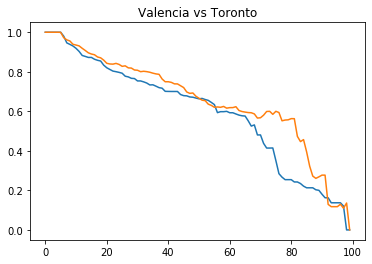

---------------------   Valencia  vs.  Munich   ---------------------
Discrete Frechet distance:  0.22986331021159434 



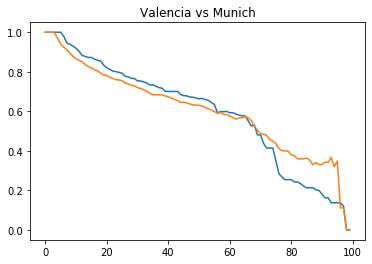

---------------------   Venezia  vs.  Venezia   ---------------------
Discrete Frechet distance:  0.0 



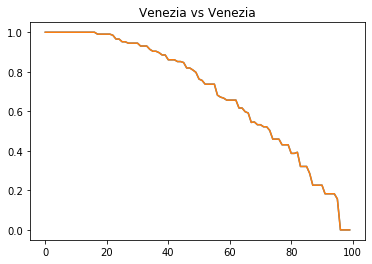

---------------------   Venezia  vs.  Verona   ---------------------
Discrete Frechet distance:  0.32272116406997786 



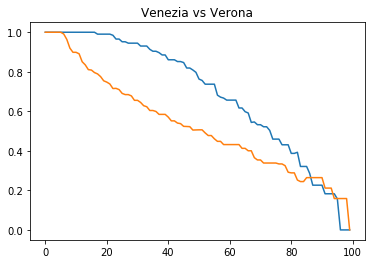

---------------------   Venezia  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.3946699724858913 



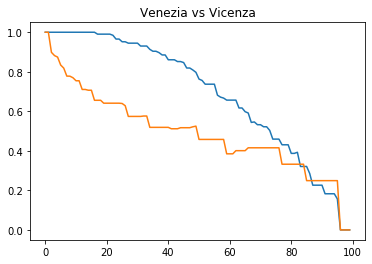

---------------------   Venezia  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.672031806366487 



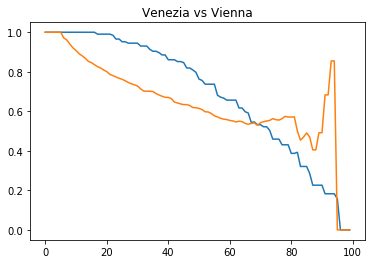

---------------------   Venezia  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.453564519422648 



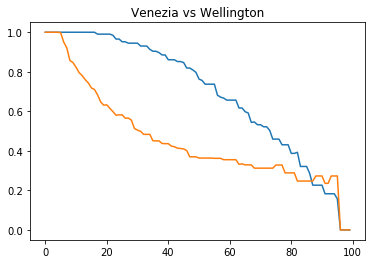

---------------------   Venezia  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.3410425997705448 



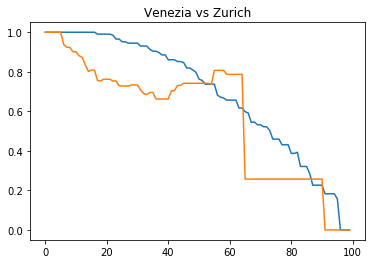

---------------------   Venezia  vs.  Milan   ---------------------
Discrete Frechet distance:  0.20635267373544253 



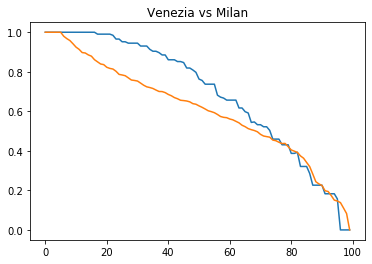

---------------------   Venezia  vs.  London   ---------------------
Discrete Frechet distance:  0.2219036496861998 



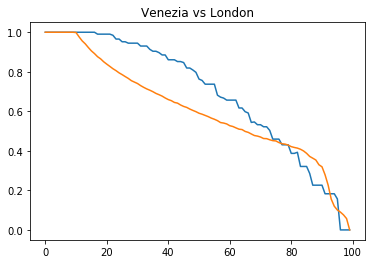

---------------------   Venezia  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.6670520643678925 



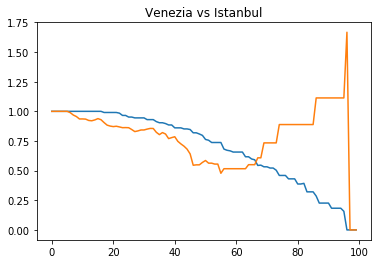

---------------------   Venezia  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.38614520826720256 



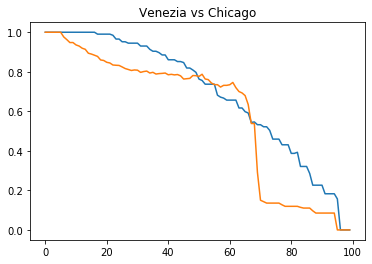

---------------------   Venezia  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.17582396291144398 



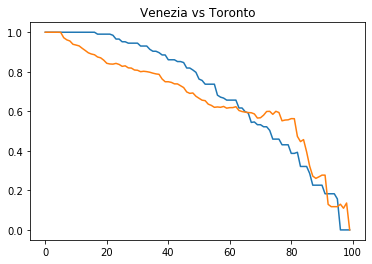

---------------------   Venezia  vs.  Munich   ---------------------
Discrete Frechet distance:  0.229154468173991 



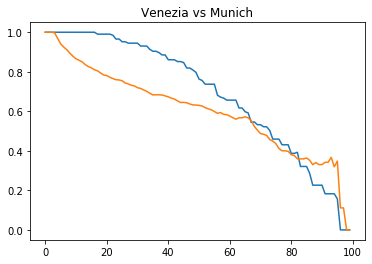

---------------------   Verona  vs.  Verona   ---------------------
Discrete Frechet distance:  0.0 



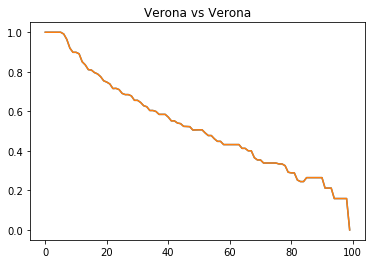

---------------------   Verona  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.18546224758248953 



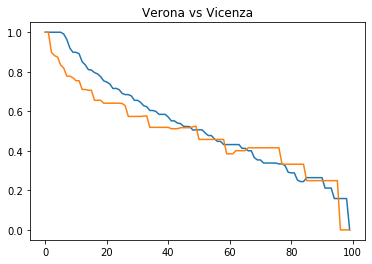

---------------------   Verona  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.6962102405875248 



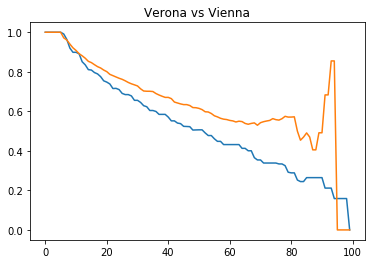

---------------------   Verona  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.1587023682425636 



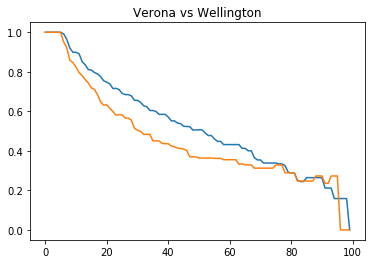

---------------------   Verona  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.37545703765584726 



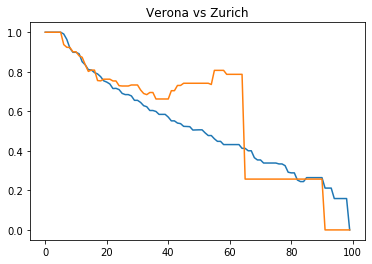

---------------------   Verona  vs.  Milan   ---------------------
Discrete Frechet distance:  0.14246281850222786 



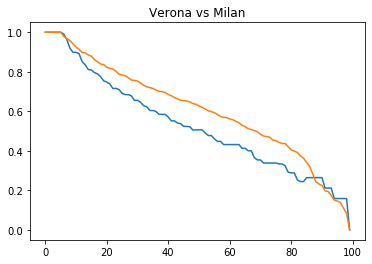

---------------------   Verona  vs.  London   ---------------------
Discrete Frechet distance:  0.1635054800693224 



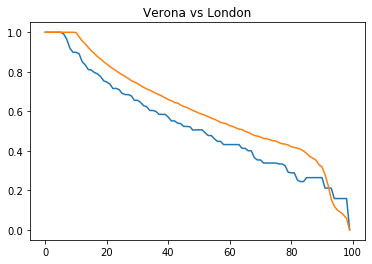

---------------------   Verona  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.5083496961253289 



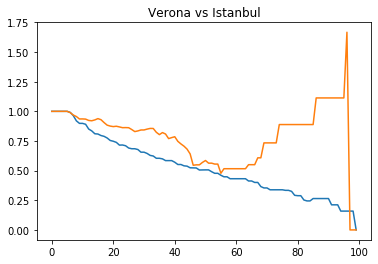

---------------------   Verona  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.31435869409600825 



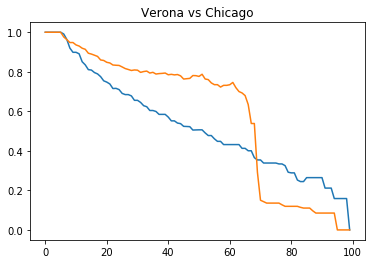

---------------------   Verona  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.27437900929369374 



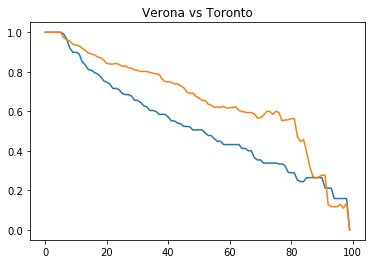

---------------------   Verona  vs.  Munich   ---------------------
Discrete Frechet distance:  0.1894144469340787 



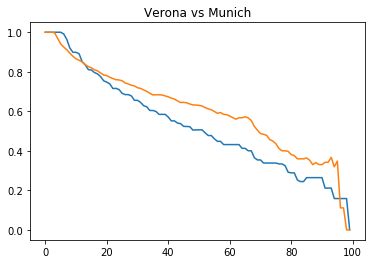

---------------------   Vicenza  vs.  Vicenza   ---------------------
Discrete Frechet distance:  0.0 



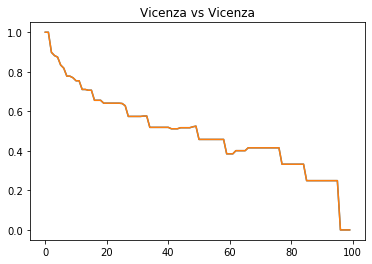

---------------------   Vicenza  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.605644824729746 



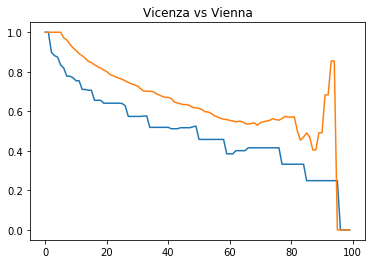

---------------------   Vicenza  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.1638370336470183 



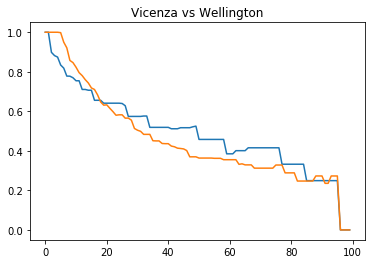

---------------------   Vicenza  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.4021161936925716 



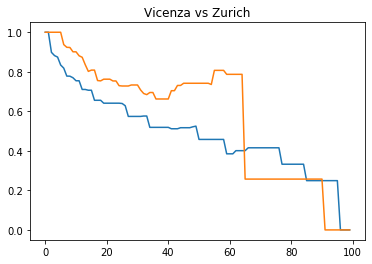

---------------------   Vicenza  vs.  Milan   ---------------------
Discrete Frechet distance:  0.20542283889191193 



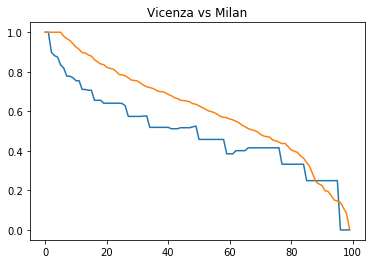

---------------------   Vicenza  vs.  London   ---------------------
Discrete Frechet distance:  0.24572622667773492 



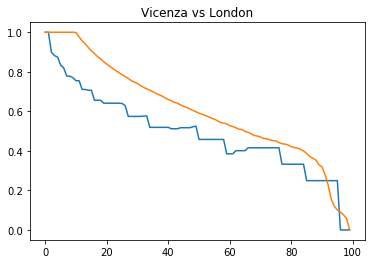

---------------------   Vicenza  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.6670520643678925 



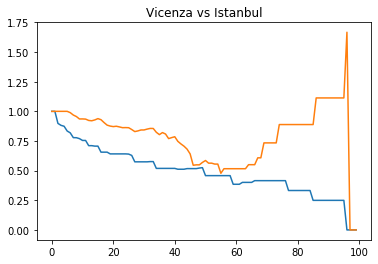

---------------------   Vicenza  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.36110937271308413 



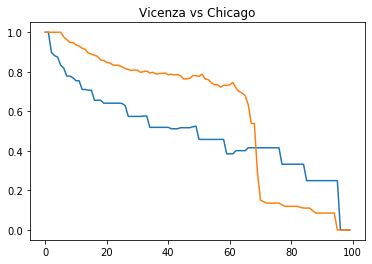

---------------------   Vicenza  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.2788119114093709 



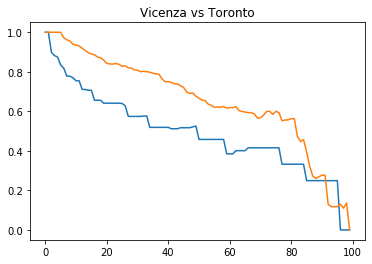

---------------------   Vicenza  vs.  Munich   ---------------------
Discrete Frechet distance:  0.19828513497491335 



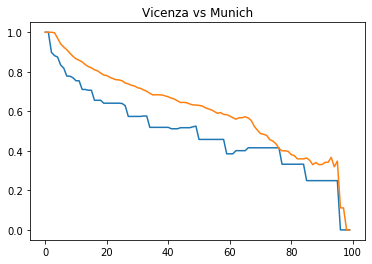

---------------------   Vienna  vs.  Vienna   ---------------------
Discrete Frechet distance:  0.0 



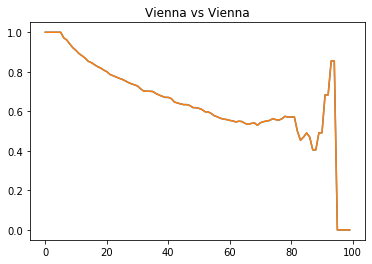

---------------------   Vienna  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.582004551237632 



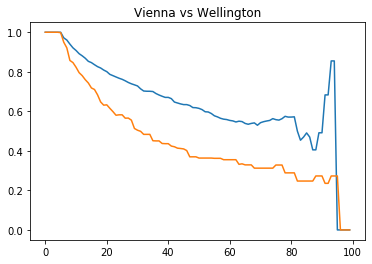

---------------------   Vienna  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.8549126088300883 



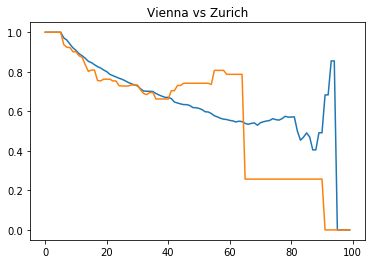

---------------------   Vienna  vs.  Milan   ---------------------
Discrete Frechet distance:  0.7041305374126714 



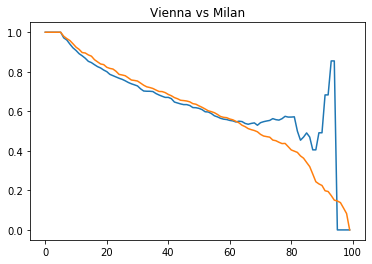

---------------------   Vienna  vs.  London   ---------------------
Discrete Frechet distance:  0.735056811829242 



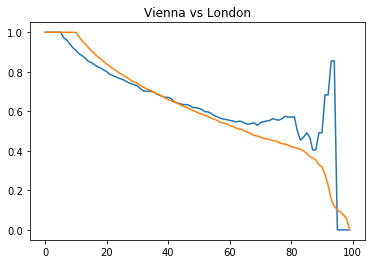

---------------------   Vienna  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.6670520643678925 



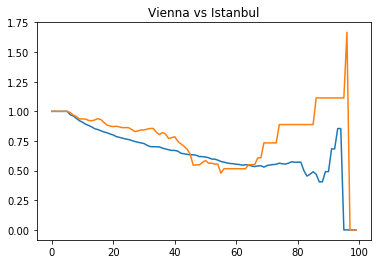

---------------------   Vienna  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.7696229760562355 



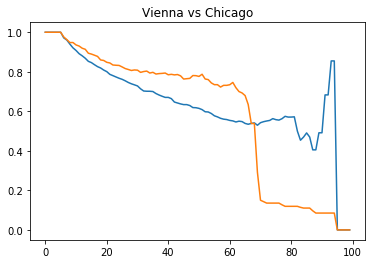

---------------------   Vienna  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.7372909374608213 



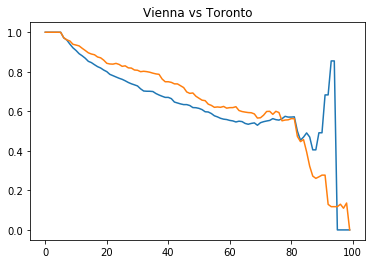

---------------------   Vienna  vs.  Munich   ---------------------
Discrete Frechet distance:  0.5354728184346973 



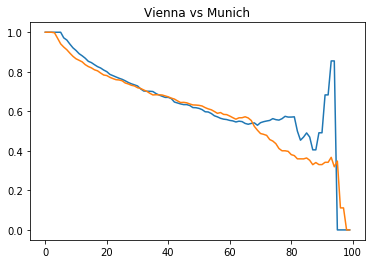

---------------------   Wellington  vs.  Wellington   ---------------------
Discrete Frechet distance:  0.0 



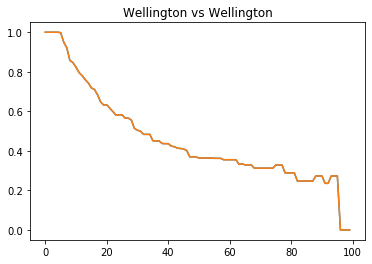

---------------------   Wellington  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.4552551586219797 



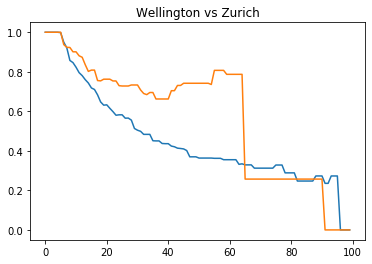

---------------------   Wellington  vs.  Milan   ---------------------
Discrete Frechet distance:  0.2781438473664832 



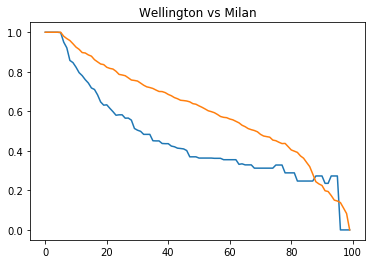

---------------------   Wellington  vs.  London   ---------------------
Discrete Frechet distance:  0.2482097661068985 



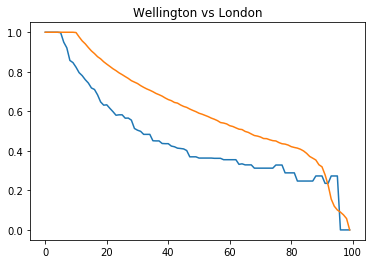

---------------------   Wellington  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.6670520643678925 



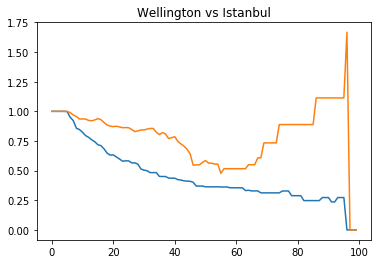

---------------------   Wellington  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.424010984051686 



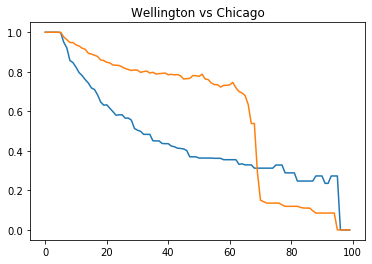

---------------------   Wellington  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.3418657408365201 



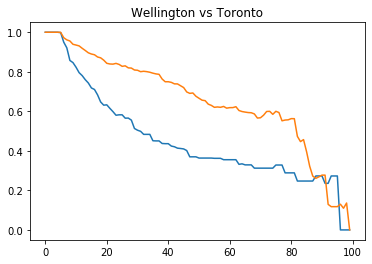

---------------------   Wellington  vs.  Munich   ---------------------
Discrete Frechet distance:  0.2674026872461555 



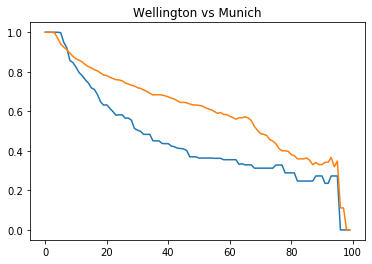

---------------------   Zurich  vs.  Zurich   ---------------------
Discrete Frechet distance:  0.0 



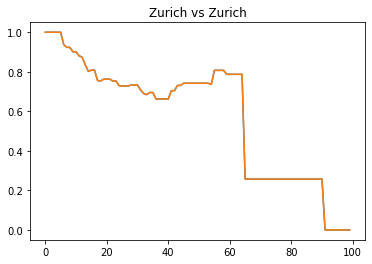

---------------------   Zurich  vs.  Milan   ---------------------
Discrete Frechet distance:  0.26520797833465987 



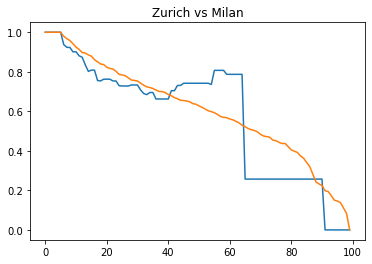

---------------------   Zurich  vs.  London   ---------------------
Discrete Frechet distance:  0.2793951756151114 



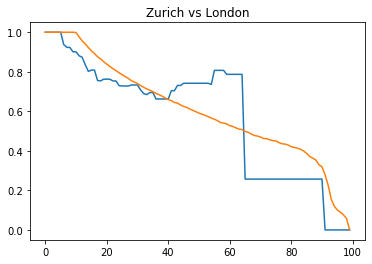

---------------------   Zurich  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.6670520643678925 



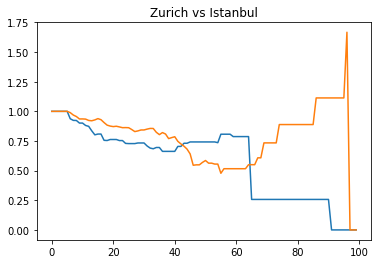

---------------------   Zurich  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.4224310197778704 



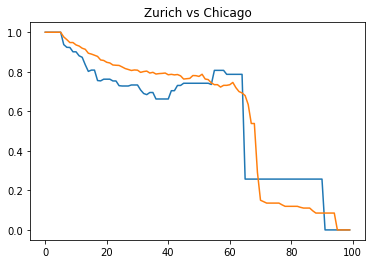

---------------------   Zurich  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.3429630531698293 



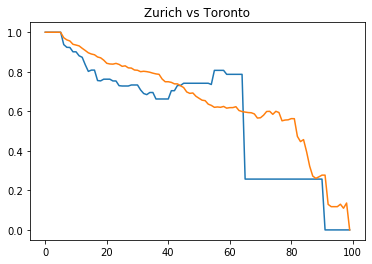

---------------------   Zurich  vs.  Munich   ---------------------
Discrete Frechet distance:  0.3671130278414978 



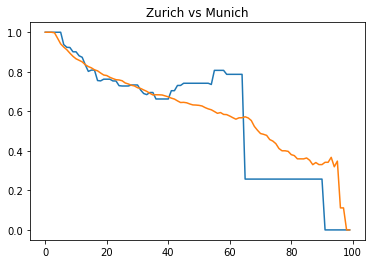

---------------------   Milan  vs.  Milan   ---------------------
Discrete Frechet distance:  0.0 



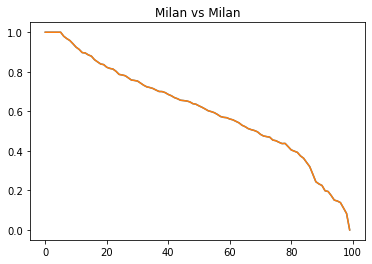

---------------------   Milan  vs.  London   ---------------------
Discrete Frechet distance:  0.10987165929855311 



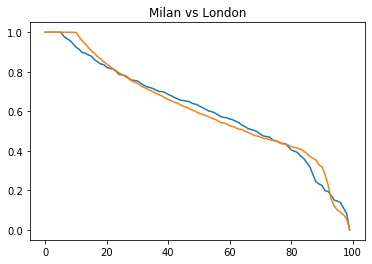

---------------------   Milan  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.5288550901664002 



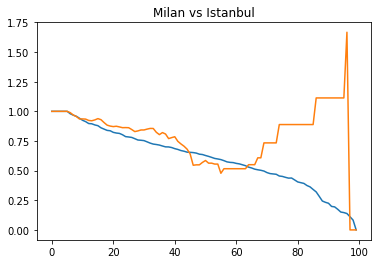

---------------------   Milan  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.33631602055998133 



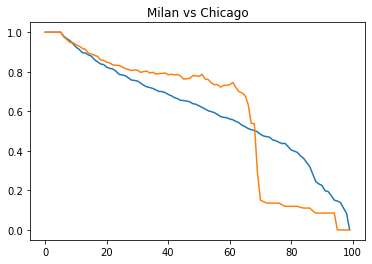

---------------------   Milan  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.1643762343334922 



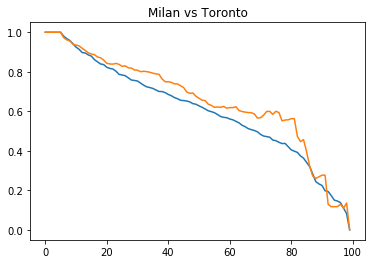

---------------------   Milan  vs.  Munich   ---------------------
Discrete Frechet distance:  0.20194887711535192 



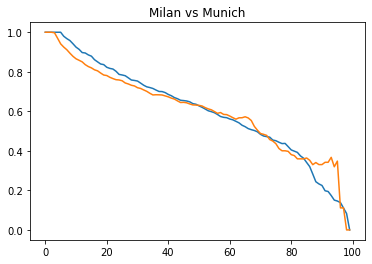

---------------------   London  vs.  London   ---------------------
Discrete Frechet distance:  0.0 



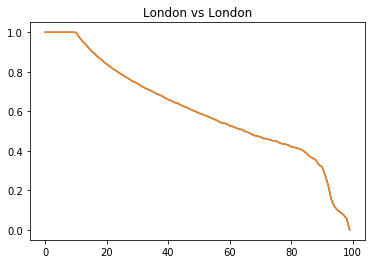

---------------------   London  vs.  Istanbul   ---------------------
Discrete Frechet distance:  1.5771154301252361 



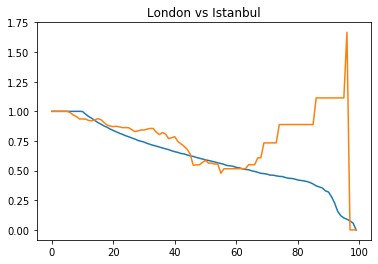

---------------------   London  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.3260407703476683 



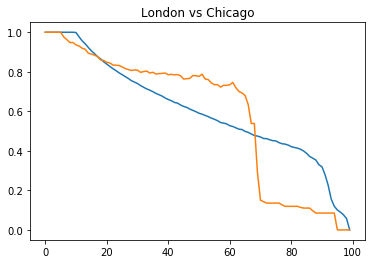

---------------------   London  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.15202967214712243 



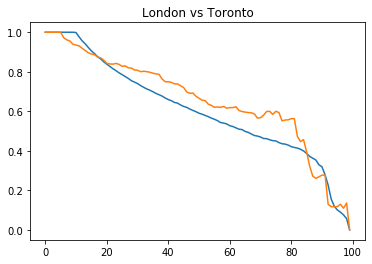

---------------------   London  vs.  Munich   ---------------------
Discrete Frechet distance:  0.2473300598375628 



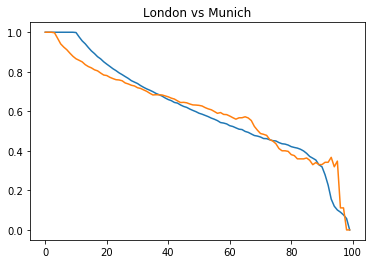

---------------------   Istanbul  vs.  Istanbul   ---------------------
Discrete Frechet distance:  0.0 



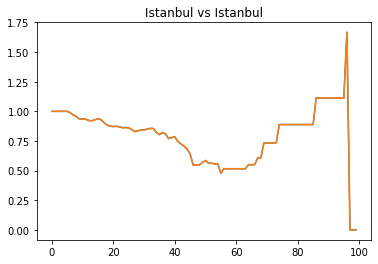

---------------------   Istanbul  vs.  Chicago   ---------------------
Discrete Frechet distance:  1.6670520643678925 



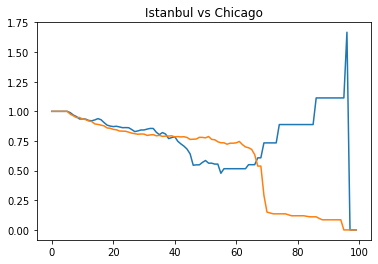

---------------------   Istanbul  vs.  Toronto   ---------------------
Discrete Frechet distance:  1.537115298832429 



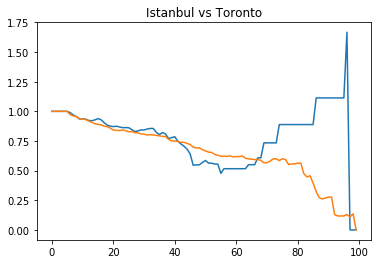

---------------------   Istanbul  vs.  Munich   ---------------------
Discrete Frechet distance:  1.5556544626120123 



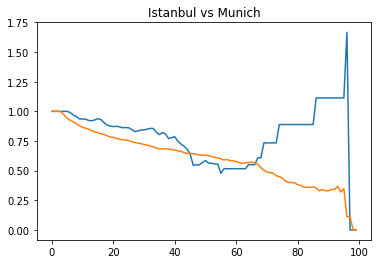

---------------------   Chicago  vs.  Chicago   ---------------------
Discrete Frechet distance:  0.0 



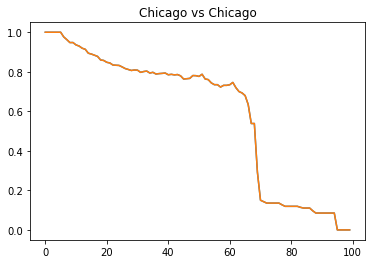

---------------------   Chicago  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.46436653695335295 



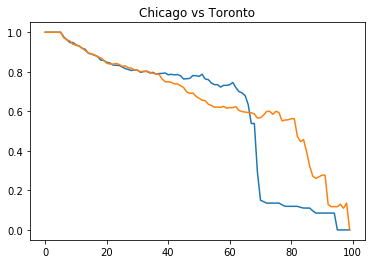

---------------------   Chicago  vs.  Munich   ---------------------
Discrete Frechet distance:  0.3481168151766423 



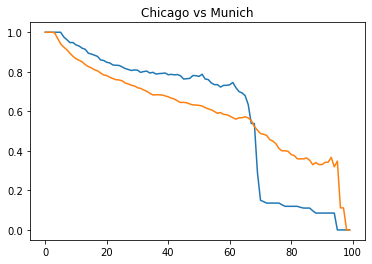

---------------------   Toronto  vs.  Toronto   ---------------------
Discrete Frechet distance:  0.0 



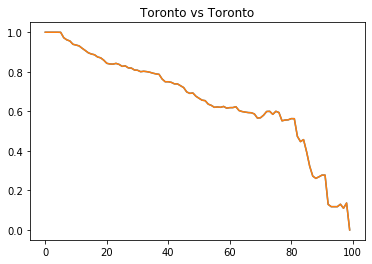

---------------------   Toronto  vs.  Munich   ---------------------
Discrete Frechet distance:  0.24949135647223072 



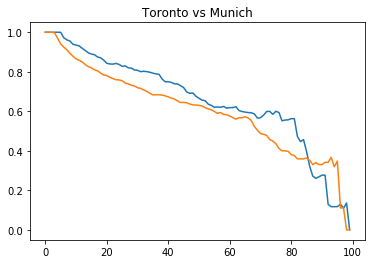

---------------------   Munich  vs.  Munich   ---------------------
Discrete Frechet distance:  0.0 



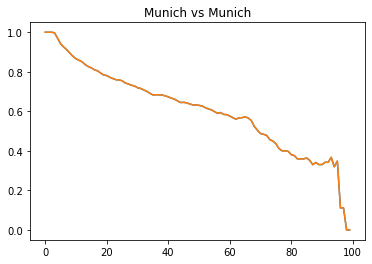


[[0.         0.41397239 0.32519774 ... 0.38304795 0.18035153 0.27064917]
 [0.41397239 0.         0.52427067 ... 0.52470107 0.27719863 0.36711303]
 [0.32519774 0.52427067 0.         ... 0.61062068 0.35338984 0.34811682]
 ...
 [0.38304795 0.52470107 0.61062068 ... 0.         0.46436654 0.34811682]
 [0.18035153 0.27719863 0.35338984 ... 0.46436654 0.         0.24949136]
 [0.27064917 0.36711303 0.34811682 ... 0.34811682 0.24949136 0.        ]]
time: 8min 39s


In [10]:
from tqdm import tqdm_notebook
num_cities = len(etas_cut_threshold_dict)
dist_mat = np.zeros((num_cities, num_cities))
for pair in tqdm_notebook(city_pairs):
    print('---------------------  ', city_dict[pair[0]], ' vs. ', city_dict[pair[1]], '  ---------------------')
    curve1 = np.zeros((100, 2))
    curve1[:,0] = np.arange(100)
    curve1[:,1] = etas_cut_threshold_dict[city_dict[pair[0]]]
    
    curve2 = np.zeros((100, 2))
    curve2[:,0] = np.arange(100)
    curve2[:,1] = etas_cut_threshold_dict[city_dict[pair[1]]]
    
        # quantify the difference between the two curves using PCM
#     pcm = similaritymeasures.pcm(curve1, curve2)

    # quantify the difference between the two curves using
    # Discrete Frechet distance
    df = similaritymeasures.frechet_dist(curve1, curve2)

#     # quantify the difference between the two curves using
#     # area between two curves
#     area = similaritymeasures.area_between_two_curves(curve, paris_data)

#     # quantify the difference between the two curves using
#     # Curve Length based similarity measure
#     cl = similaritymeasures.curve_length_measure(curve, paris_data)

#     # quantify the difference between the two curves using
#     # Dynamic Time Warping distance
#     dtw, d = similaritymeasures.dtw(curve, paris_data)

    # print the results
#     print('----------', key, '----------')
#     print('PCM distance: ', pcm, '\n')
    print('Discrete Frechet distance: ', df, '\n')
#     print('Are between the curves: ', area, '\n')
#     print('Curve Length based similarity measure: ', cl, '\n')
#     print('Dynamic Time Warping distance: ', dtw, '\n')
    dist_mat[pair[0], pair[1]] = df
    dist_mat[pair[1], pair[0]] = df
    # plot the data
    plt.figure()
    plt.plot(curve1[:, 0], curve1[:, 1])
    plt.plot(curve2[:, 0], curve2[:, 1])
    plt.title('{} vs {}'.format(city_dict[pair[0]], city_dict[pair[1]]))
    plt.show()
print(dist_mat)    

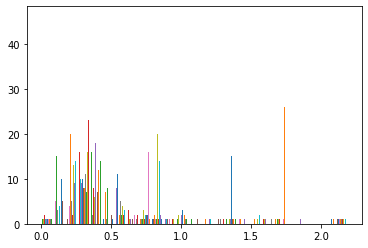

time: 3.23 s


In [11]:
plt.hist(dist_mat, bins=25)
plt.show()

In [12]:
from sklearn import manifold
from sklearn.metrics import euclidean_distances
from sklearn.decomposition import PCA

time: 80 ms


In [13]:
mds = manifold.MDS(n_components=2, max_iter=3000, eps=1e-9, random_state=1,
                   dissimilarity="precomputed", n_jobs=1)
pos = mds.fit(dist_mat).embedding_
pos

array([[-7.71494695e-02,  8.11937395e-02],
       [-1.17040190e-01,  3.66585672e-01],
       [-2.49973788e-01,  1.66466037e-01],
       [-9.77673841e-05,  2.56587245e-01],
       [-2.24125564e-01, -2.85875525e-01],
       [-2.21296293e-01,  2.82890721e-01],
       [ 1.13013275e-01,  2.44768458e-01],
       [ 4.98794638e-02,  8.01857783e-02],
       [ 2.22520859e-01,  2.60196633e-01],
       [ 4.64883878e-01,  1.83862822e-01],
       [ 5.65907419e-01,  9.27229879e-02],
       [ 1.15511752e-01, -4.10162645e-01],
       [ 1.61655959e-01,  1.16897548e-01],
       [ 1.21422181e-01,  6.96239135e-02],
       [ 1.99980668e-01,  2.18946276e-01],
       [-9.19538474e-02, -1.21235610e+00],
       [ 1.75216194e-01,  3.49406822e-01],
       [ 6.40726630e-02,  1.99133754e-01],
       [ 5.37508279e-01, -7.67310956e-02],
       [-2.04371771e+00,  2.83528334e-01],
       [ 2.14816356e-01,  7.76148939e-02],
       [ 2.95173956e-02,  4.71491227e-02],
       [-4.80385694e-02,  6.68059510e-02],
       [ 3.

time: 909 ms


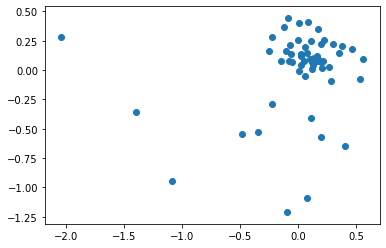

time: 186 ms


In [14]:
plt.scatter(pos[:,0], pos[:,1])
plt.show()

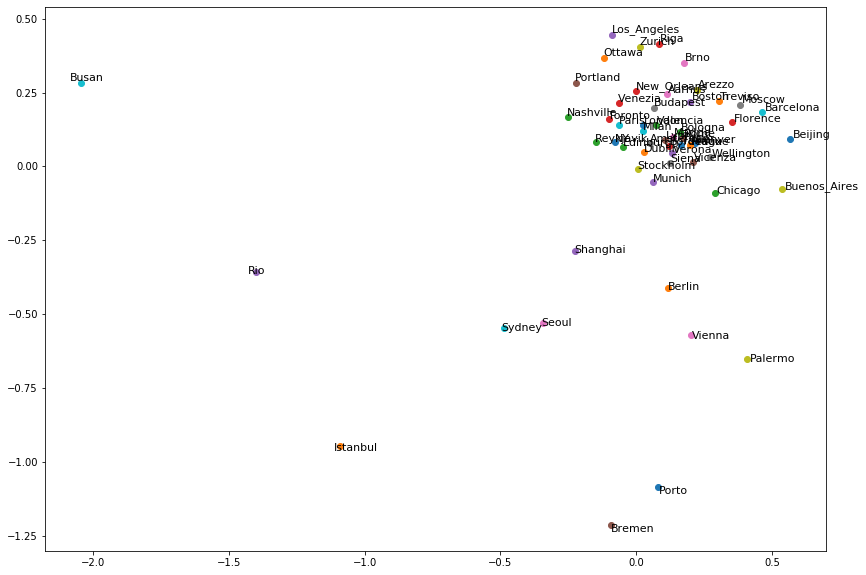

time: 653 ms


In [15]:
cities = list(city_dict.values())
plt.figure(figsize=(14, 10))

for n, city in enumerate(cities):
    x = pos[n,0]
    y = pos[n,1]
    plt.scatter(x, y)
    plt.text(x * (1 + 0.02), y * (1 + 0.02) , city, fontsize=11)
    
# text = plt.annotate("no price peak olycentric", xy=(.018, .8), xytext=(.018, .8), fontsize=70, c="red")
# text.set_alpha(.1)

# plt.xlabel("Airbnb price decay", fontsize=15)
# plt.ylabel("Spreading index", fontsize=15)
# plt.xlim((0, 0.03))
# plt.ylim((0.3, 1))
plt.show()

## Surface Distance

In [16]:
pickle_in = open("etas_surface_dict.pickle","rb")
etas_surface_dict = pickle.load(pickle_in)
etas_surface_dict

{'NY': array([[1.        , 0.95418349, 0.92471336, ..., 0.        , 0.        ,
         0.        ],
        [1.        , 0.96911482, 0.94572765, ..., 0.        , 0.        ,
         0.        ],
        [1.        , 0.97410736, 0.95689256, ..., 0.        , 0.        ,
         0.        ],
        ...,
        [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
         0.        ],
        [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
         0.        ],
        [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
         0.        ]]),
 'Boston': array([[1.        , 0.94621367, 0.92299712, ..., 0.        , 0.        ,
         0.        ],
        [1.        , 0.97340556, 0.95206791, ..., 0.        , 0.        ,
         0.        ],
        [1.        , 0.96708982, 0.94781127, ..., 0.        , 0.        ,
         0.        ],
        ...,
        [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
         0.       

time: 37 ms


In [17]:
Istanbul_data = []
coords = etas_surface_dict['Istanbul']
for i,q in enumerate(np.linspace(0,1, 100)):
    for j,k in enumerate(np.linspace(0,1, 100)):
        Istanbul_data.append([q, k, coords[i,j]])
Istanbul_data = np.array(Istanbul_data)
Istanbul_data

array([[0.        , 0.        , 1.        ],
       [0.        , 0.01010101, 0.94156919],
       [0.        , 0.02020202, 0.88447328],
       ...,
       [1.        , 0.97979798, 0.        ],
       [1.        , 0.98989899, 0.        ],
       [1.        , 1.        , 0.        ]])

time: 19 ms


In [18]:
London_data = []
coords = etas_surface_dict['London']
for i,q in enumerate(np.linspace(0,1, 100)):
    for j,k in enumerate(np.linspace(0,1, 100)):
        London_data.append([q, k, coords[i,j]])
London_data = np.array(London_data)
London_data

array([[0.        , 0.        , 1.        ],
       [0.        , 0.01010101, 0.91955681],
       [0.        , 0.02020202, 0.86977963],
       ...,
       [1.        , 0.97979798, 0.        ],
       [1.        , 0.98989899, 0.        ],
       [1.        , 1.        , 0.        ]])

time: 21 ms


In [20]:
np.mean(np.abs(Istanbul_data[:,2] - London_data[:,2]))

0.49781379307975765

time: 7.99 ms


In [21]:
city_dict_surf = {}
for n, key in enumerate(etas_surface_dict):
    city_dict_surf[n] = key
city_dict_surf

{0: 'NY',
 1: 'Boston',
 2: 'Rio',
 3: 'Budapest',
 4: 'Ottawa',
 5: 'Nashville',
 6: 'New_Orleans',
 7: 'Shanghai',
 8: 'Portland',
 9: 'Aarhus',
 10: 'Amsterdam',
 11: 'Arezzo',
 12: 'Barcelona',
 13: 'Beijing',
 14: 'Berlin',
 15: 'Bologna',
 16: 'Bordeaux',
 17: 'Bremen',
 18: 'Brno',
 19: 'Buenos_Aires',
 20: 'Busan',
 21: 'Denver',
 22: 'Dublin',
 23: 'Edinburgh',
 24: 'Florence',
 25: 'Los_Angeles',
 26: 'Lyon',
 27: 'Madrid',
 28: 'Moscow',
 29: 'Palermo',
 30: 'Paris',
 31: 'Porto',
 32: 'Prague',
 33: 'Reykjavik',
 34: 'Riga',
 35: 'Rome',
 36: 'Seoul',
 37: 'Siena',
 38: 'Stockholm',
 39: 'Sydney',
 40: 'Tallin',
 41: 'Treviso',
 42: 'Valencia',
 43: 'Venezia',
 44: 'Verona',
 45: 'Vicenza',
 46: 'Vienna',
 47: 'Wellington',
 48: 'Zurich',
 49: 'Milan',
 50: 'London',
 51: 'Istanbul',
 52: 'Chicago',
 53: 'Toronto',
 54: 'Munich'}

time: 3.98 ms


In [140]:
city_pairs[-1]

(54, 54)

time: 1.98 ms


In [148]:
from tqdm import tqdm_notebook

dist_mat_surf = np.zeros((num_cities, num_cities))
for pair in tqdm_notebook(city_pairs):
    print('---------------------  ', city_dict_surf[pair[0]], ' vs. ', city_dict_surf[pair[1]], '  ---------------------')
    
    surf1 = []
    coords1 = etas_surface_dict[city_dict_surf[pair[0]]]
    for i,q in enumerate(np.linspace(0,1, 100)):
        for j,k in enumerate(np.linspace(0,1, 100)):
            surf1.append([q, k, coords1[i,j]])
    surf1 = np.array(surf1)
    
    surf2 = []
    coords2 = etas_surface_dict[city_dict_surf[pair[1]]]
    for i,q in enumerate(np.linspace(0,1, 100)):
        for j,k in enumerate(np.linspace(0,1, 100)):
            surf2.append([q, k, coords2[i,j]])
    surf2 = np.array(surf2)
    
        # quantify the difference between the two curves using PCM
#     pcm = similaritymeasures.pcm(curve1, curve2)

    # quantify the difference between the two curves using
    # Discrete Frechet distance
    df = np.mean((surf1[:,2] - surf2[:,2])**2)

#     # quantify the difference between the two curves using
#     # area between two curves
#     area = similaritymeasures.area_between_two_curves(curve, paris_data)

#     # quantify the difference between the two curves using
#     # Curve Length based similarity measure
#     cl = similaritymeasures.curve_length_measure(curve, paris_data)

#     # quantify the difference between the two curves using
#     # Dynamic Time Warping distance
#     dtw, d = similaritymeasures.dtw(curve, paris_data)

    # print the results
#     print('----------', key, '----------')
#     print('PCM distance: ', pcm, '\n')
    print('Distance between surfaces: ', df, '\n')
#     print('Are between the curves: ', area, '\n')
#     print('Curve Length based similarity measure: ', cl, '\n')
#     print('Dynamic Time Warping distance: ', dtw, '\n')
    dist_mat_surf[pair[0], pair[1]] = df
    dist_mat_surf[pair[1], pair[0]] = df
    # plot the data
#     plt.figure()
#     plt.plot(curve1[:, 0], curve1[:, 1])
#     plt.plot(curve2[:, 0], curve2[:, 1])
#     plt.title('{} vs {}'.format(city_dict_surf[pair[0]], city_dict_surf[pair[1]]))
#     plt.show()
print(dist_mat_surf)    

---------------------   NY  vs.  NY   ---------------------
Distance between surfaces:  0.0 

---------------------   NY  vs.  Boston   ---------------------
Distance between surfaces:  0.08211484996250158 

---------------------   NY  vs.  Rio   ---------------------
Distance between surfaces:  0.3259995113089757 

---------------------   NY  vs.  Budapest   ---------------------
Distance between surfaces:  0.029589022606778075 

---------------------   NY  vs.  Ottawa   ---------------------
Distance between surfaces:  0.13853301997655973 

---------------------   NY  vs.  Nashville   ---------------------
Distance between surfaces:  0.09295909789110812 

---------------------   NY  vs.  New_Orleans   ---------------------
Distance between surfaces:  0.039248045954595 

---------------------   NY  vs.  Shanghai   ---------------------
Distance between surfaces:  0.13392026189150302 

---------------------   NY  vs.  Portland   ---------------------
Distance between surfaces:  0.11355

---------------------   Rio  vs.  Riga   ---------------------
Distance between surfaces:  0.4995482204867085 

---------------------   Rio  vs.  Rome   ---------------------
Distance between surfaces:  0.3080354383359578 

---------------------   Rio  vs.  Seoul   ---------------------
Distance between surfaces:  0.1440250712791747 

---------------------   Rio  vs.  Siena   ---------------------
Distance between surfaces:  0.3240874730670054 

---------------------   Rio  vs.  Stockholm   ---------------------
Distance between surfaces:  0.44236175535344885 

---------------------   Rio  vs.  Sydney   ---------------------
Distance between surfaces:  0.1922775531028183 

---------------------   Rio  vs.  Tallin   ---------------------
Distance between surfaces:  0.342785183537954 

---------------------   Rio  vs.  Treviso   ---------------------
Distance between surfaces:  0.5956625126118559 

---------------------   Rio  vs.  Valencia   ---------------------
Distance between surfac

---------------------   Nashville  vs.  Brno   ---------------------
Distance between surfaces:  0.11748029513895085 

---------------------   Nashville  vs.  Buenos_Aires   ---------------------
Distance between surfaces:  0.20960218170569955 

---------------------   Nashville  vs.  Busan   ---------------------
Distance between surfaces:  0.9145603318351611 

---------------------   Nashville  vs.  Denver   ---------------------
Distance between surfaces:  0.10586518277216243 

---------------------   Nashville  vs.  Dublin   ---------------------
Distance between surfaces:  0.09770427708053715 

---------------------   Nashville  vs.  Edinburgh   ---------------------
Distance between surfaces:  0.09045721266125838 

---------------------   Nashville  vs.  Florence   ---------------------
Distance between surfaces:  0.11471516362630302 

---------------------   Nashville  vs.  Los_Angeles   ---------------------
Distance between surfaces:  0.1668330335835426 

---------------------

Distance between surfaces:  0.0 

---------------------   Portland  vs.  Aarhus   ---------------------
Distance between surfaces:  0.06036088462479584 

---------------------   Portland  vs.  Amsterdam   ---------------------
Distance between surfaces:  0.11803925821878188 

---------------------   Portland  vs.  Arezzo   ---------------------
Distance between surfaces:  0.05205702556457537 

---------------------   Portland  vs.  Barcelona   ---------------------
Distance between surfaces:  0.1283020000375929 

---------------------   Portland  vs.  Beijing   ---------------------
Distance between surfaces:  0.2444385520940802 

---------------------   Portland  vs.  Berlin   ---------------------
Distance between surfaces:  0.24257708529416244 

---------------------   Portland  vs.  Bologna   ---------------------
Distance between surfaces:  0.12266972722404111 

---------------------   Portland  vs.  Bordeaux   ---------------------
Distance between surfaces:  0.1273686424405667 


---------------------   Amsterdam  vs.  Munich   ---------------------
Distance between surfaces:  0.018834235574569688 

---------------------   Arezzo  vs.  Arezzo   ---------------------
Distance between surfaces:  0.0 

---------------------   Arezzo  vs.  Barcelona   ---------------------
Distance between surfaces:  0.06834837329230936 

---------------------   Arezzo  vs.  Beijing   ---------------------
Distance between surfaces:  0.19226937885767023 

---------------------   Arezzo  vs.  Berlin   ---------------------
Distance between surfaces:  0.253913813401904 

---------------------   Arezzo  vs.  Bologna   ---------------------
Distance between surfaces:  0.11936093914773344 

---------------------   Arezzo  vs.  Bordeaux   ---------------------
Distance between surfaces:  0.1280434555411934 

---------------------   Arezzo  vs.  Bremen   ---------------------
Distance between surfaces:  0.6288647045309109 

---------------------   Arezzo  vs.  Brno   ---------------------

---------------------   Berlin  vs.  Denver   ---------------------
Distance between surfaces:  0.11130324620434974 

---------------------   Berlin  vs.  Dublin   ---------------------
Distance between surfaces:  0.06116836724483054 

---------------------   Berlin  vs.  Edinburgh   ---------------------
Distance between surfaces:  0.10009467140800761 

---------------------   Berlin  vs.  Florence   ---------------------
Distance between surfaces:  0.26811705233737637 

---------------------   Berlin  vs.  Los_Angeles   ---------------------
Distance between surfaces:  0.24867407842917627 

---------------------   Berlin  vs.  Lyon   ---------------------
Distance between surfaces:  0.08977799128870272 

---------------------   Berlin  vs.  Madrid   ---------------------
Distance between surfaces:  0.11698613459769694 

---------------------   Berlin  vs.  Moscow   ---------------------
Distance between surfaces:  0.4072253554531723 

---------------------   Berlin  vs.  Palermo   --

---------------------   Bremen  vs.  Treviso   ---------------------
Distance between surfaces:  0.6668926328895616 

---------------------   Bremen  vs.  Valencia   ---------------------
Distance between surfaces:  0.4565480101038298 

---------------------   Bremen  vs.  Venezia   ---------------------
Distance between surfaces:  0.4202421455736828 

---------------------   Bremen  vs.  Verona   ---------------------
Distance between surfaces:  0.3770211719196962 

---------------------   Bremen  vs.  Vicenza   ---------------------
Distance between surfaces:  0.3886883815332684 

---------------------   Bremen  vs.  Vienna   ---------------------
Distance between surfaces:  0.15835683942703727 

---------------------   Bremen  vs.  Wellington   ---------------------
Distance between surfaces:  0.291989452665547 

---------------------   Bremen  vs.  Zurich   ---------------------
Distance between surfaces:  0.7292141051863688 

---------------------   Bremen  vs.  Milan   ----------

---------------------   Denver  vs.  Siena   ---------------------
Distance between surfaces:  0.028402592061588156 

---------------------   Denver  vs.  Stockholm   ---------------------
Distance between surfaces:  0.07961053247756672 

---------------------   Denver  vs.  Sydney   ---------------------
Distance between surfaces:  0.20270266019627184 

---------------------   Denver  vs.  Tallin   ---------------------
Distance between surfaces:  0.028954226676995615 

---------------------   Denver  vs.  Treviso   ---------------------
Distance between surfaces:  0.1280084020988026 

---------------------   Denver  vs.  Valencia   ---------------------
Distance between surfaces:  0.03220473214583118 

---------------------   Denver  vs.  Venezia   ---------------------
Distance between surfaces:  0.02962892297018647 

---------------------   Denver  vs.  Verona   ---------------------
Distance between surfaces:  0.019402632438560715 

---------------------   Denver  vs.  Vicenza   -

---------------------   Los_Angeles  vs.  Wellington   ---------------------
Distance between surfaces:  0.19245458843641142 

---------------------   Los_Angeles  vs.  Zurich   ---------------------
Distance between surfaces:  0.17948941173457983 

---------------------   Los_Angeles  vs.  Milan   ---------------------
Distance between surfaces:  0.12832525640805187 

---------------------   Los_Angeles  vs.  London   ---------------------
Distance between surfaces:  0.13312937594985264 

---------------------   Los_Angeles  vs.  Istanbul   ---------------------
Distance between surfaces:  0.7984654092031125 

---------------------   Los_Angeles  vs.  Chicago   ---------------------
Distance between surfaces:  0.1299183363276464 

---------------------   Los_Angeles  vs.  Toronto   ---------------------
Distance between surfaces:  0.1546428807548241 

---------------------   Los_Angeles  vs.  Munich   ---------------------
Distance between surfaces:  0.18412932973585308 

------------

---------------------   Paris  vs.  Istanbul   ---------------------
Distance between surfaces:  0.5357911915133359 

---------------------   Paris  vs.  Chicago   ---------------------
Distance between surfaces:  0.10472657614172169 

---------------------   Paris  vs.  Toronto   ---------------------
Distance between surfaces:  0.04102746187587923 

---------------------   Paris  vs.  Munich   ---------------------
Distance between surfaces:  0.04350737831405482 

---------------------   Porto  vs.  Porto   ---------------------
Distance between surfaces:  0.0 

---------------------   Porto  vs.  Prague   ---------------------
Distance between surfaces:  0.24958740607833516 

---------------------   Porto  vs.  Reykjavik   ---------------------
Distance between surfaces:  0.2859403260485217 

---------------------   Porto  vs.  Riga   ---------------------
Distance between surfaces:  0.3893535129654717 

---------------------   Porto  vs.  Rome   ---------------------
Distance betwe

---------------------   Siena  vs.  Venezia   ---------------------
Distance between surfaces:  0.03134735936439388 

---------------------   Siena  vs.  Verona   ---------------------
Distance between surfaces:  0.02924823683941573 

---------------------   Siena  vs.  Vicenza   ---------------------
Distance between surfaces:  0.04487468561721876 

---------------------   Siena  vs.  Vienna   ---------------------
Distance between surfaces:  0.1352733386000912 

---------------------   Siena  vs.  Wellington   ---------------------
Distance between surfaces:  0.034463505268479515 

---------------------   Siena  vs.  Zurich   ---------------------
Distance between surfaces:  0.18534222825383095 

---------------------   Siena  vs.  Milan   ---------------------
Distance between surfaces:  0.048019627696009655 

---------------------   Siena  vs.  London   ---------------------
Distance between surfaces:  0.04475540961394261 

---------------------   Siena  vs.  Istanbul   -----------

---------------------   Zurich  vs.  Milan   ---------------------
Distance between surfaces:  0.19547818380694398 

---------------------   Zurich  vs.  London   ---------------------
Distance between surfaces:  0.21668072874206595 

---------------------   Zurich  vs.  Istanbul   ---------------------
Distance between surfaces:  1.020255184547005 

---------------------   Zurich  vs.  Chicago   ---------------------
Distance between surfaces:  0.11761374524896648 

---------------------   Zurich  vs.  Toronto   ---------------------
Distance between surfaces:  0.22881395322393008 

---------------------   Zurich  vs.  Munich   ---------------------
Distance between surfaces:  0.2444520667215607 

---------------------   Milan  vs.  Milan   ---------------------
Distance between surfaces:  0.0 

---------------------   Milan  vs.  London   ---------------------
Distance between surfaces:  0.014699204968469104 

---------------------   Milan  vs.  Istanbul   ---------------------
Dista

In [149]:
mds_surf = manifold.MDS(n_components=2, max_iter=3000, eps=1e-9,
                   dissimilarity="precomputed", n_jobs=1)
pos_surf = mds.fit(dist_mat_surf).embedding_
pos_surf

array([[-4.81104622e-05, -8.77728577e-03],
       [-6.72683654e-02, -6.17490001e-02],
       [ 2.90450612e-01,  2.01599032e-01],
       [-3.01482164e-02, -1.67276460e-02],
       [-1.28438685e-01, -6.60731235e-02],
       [-9.88978773e-02,  2.80660321e-02],
       [-6.37721255e-02, -3.35710304e-04],
       [ 1.05491416e-01,  9.98794693e-02],
       [-1.27082381e-01, -3.36728958e-02],
       [-6.46441819e-02, -2.30455364e-02],
       [-2.19168022e-03,  1.66802973e-02],
       [-1.38421030e-01, -5.44673582e-02],
       [-1.95995250e-01, -8.43186980e-02],
       [-3.53846644e-01, -7.64715244e-02],
       [ 1.07661399e-01,  2.73071666e-02],
       [ 3.05230643e-03, -1.65033517e-02],
       [-5.42737834e-03,  1.47048098e-02],
       [ 4.06981147e-01, -5.52161686e-02],
       [-1.10955771e-01, -8.00834514e-02],
       [-2.57709521e-01, -7.81464390e-02],
       [ 6.22891202e-01,  4.21757045e-01],
       [-2.37419473e-02,  3.79610121e-03],
       [ 9.52085556e-03, -7.37200574e-03],
       [-1.

time: 273 ms


In [150]:
dist_mat_surf

array([[0.        , 0.08211485, 0.32599951, ..., 0.08153897, 0.08161551,
        0.03156684],
       [0.08211485, 0.        , 0.47886695, ..., 0.09626703, 0.11206724,
        0.12644238],
       [0.32599951, 0.47886695, 0.        , ..., 0.52641155, 0.28107206,
        0.22123165],
       ...,
       [0.08153897, 0.09626703, 0.52641155, ..., 0.        , 0.16036686,
        0.12440507],
       [0.08161551, 0.11206724, 0.28107206, ..., 0.16036686, 0.        ,
        0.07142875],
       [0.03156684, 0.12644238, 0.22123165, ..., 0.12440507, 0.07142875,
        0.        ]])

time: 1.98 ms


In [151]:
city_list = list(city_dict_surf.values())

Error in callback <function LineWatcher.stop at 0x000001E4E9A7F0D0> (for post_run_cell):


AssertionError: 

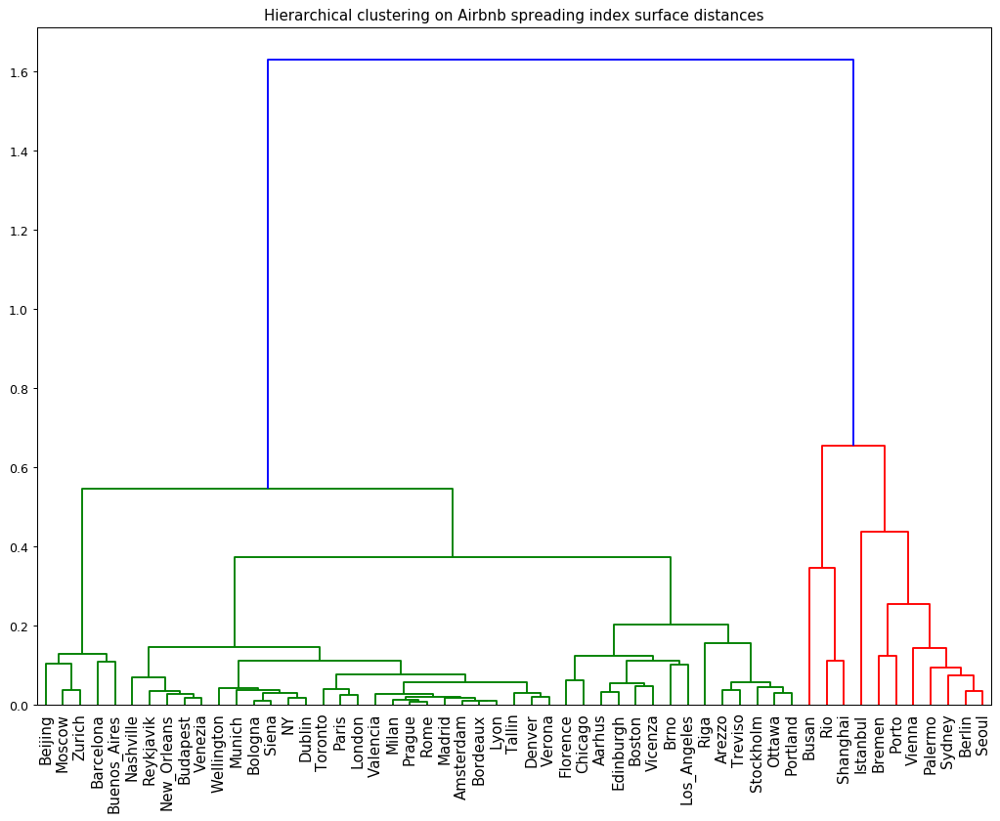

time: 2.22 s


In [256]:
from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.spatial.distance import squareform

dists = squareform(dist_mat_surf)
linkage_matrix = linkage(dists, "ward")
fig, ax = plt.subplots(figsize=(14,10), dpi=90)
dendrogram(linkage_matrix, labels=city_list, leaf_font_size=12)
plt.title("Hierarchical clustering on Airbnb spreading index surface distances")
plt.savefig('dendro1.jpg', dpi=fig.dpi)
plt.show()

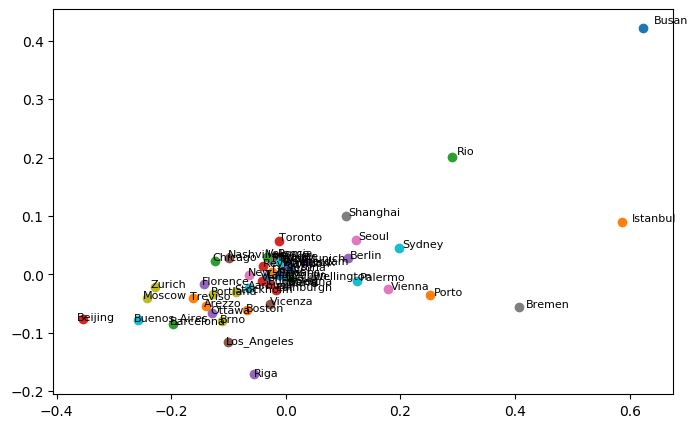

time: 495 ms


In [315]:
cities = list(city_dict_surf.values())
plt.figure(figsize=(8, 5))

for n, city in enumerate(cities):
    x = pos_surf[n,0]
    y = pos_surf[n,1]
    plt.scatter(x, y)
    plt.text(x * (1 + 0.03), y * (1 + 0.02) , city, fontsize=8)

plt.show()

In [25]:
#average_slopes = {}
pickle_in_long = open("Average_price_slopes_long.pickle","rb")
average_slopes_long = pickle.load(pickle_in_long)
pickle_in_short = open("Average_price_slopes_short.pickle","rb")
average_slopes_short = pickle.load(pickle_in_short)
assert len(average_slopes_long) == len(average_slopes_short)

time: 2 ms


In [26]:
ds = [average_slopes_long, average_slopes_short]
d = {}
for k in average_slopes_long.keys():
    d[k] = [d[k] for d in ds]
    
d

{'Paris': [0.010453121182320417, 0.0026849653157961857],
 'Amsterdam': [0.017790862401138207, 0.0050778636874671094],
 'Stockholm': [0.01160078748441716, 0.003210832098237617],
 'Arezzo': [0.012661960610292892, 0.010533307389713151],
 'Berlin': [0.017168942092868542, 0.007168052637480604],
 'Bordeaux': [0.0057209390468692745, 0.005525146683006936],
 'Denver': [0.00873766709683174, 0.005199074627718015],
 'Edinburgh': [0.012921100209712873, 0.005924493140112727],
 'Lyon': [0.00594530194011358, 0.0031514434652750753],
 'Madrid': [0.01315080289968449, 0.005565085955702098],
 'Buenos_Aires': [0.00938788752473718, 0.0037366820044496137],
 'Palermo': [0.02659431146972356, 0.008434622245707494],
 'Los_Angeles': [0.0056655377791732745, 0.0021692278034399874],
 'Beijing': [0.03548021455387483, 0.009070495145543242],
 'Florence': [0.011913882705309832, 0.005257435225042071],
 'Moscow': [0.026524810524746, 0.010314323147937777],
 'Porto': [0.03745056113103571, 0.009267357738054066],
 'Prague': [0

time: 6 ms


In [27]:
df = pd.DataFrame(
    {"City":list(d.keys()), "avg_slope_long": list(average_slopes_long.values()), "avg_slope_short":list(average_slopes_short.values())})

df

,City,avg_slope_long,avg_slope_short
0,Paris,0.010453,0.002685
1,Amsterdam,0.017791,0.005078
2,Stockholm,0.011601,0.003211
3,Arezzo,0.012662,0.010533
4,Berlin,0.017169,0.007168
5,Bordeaux,0.005721,0.005525
6,Denver,0.008738,0.005199
7,Edinburgh,0.012921,0.005924
8,Lyon,0.005945,0.003151
9,Madrid,0.013151,0.005565


time: 17 ms


In [28]:
df.index = df.City
df.head()

,City,avg_slope_long,avg_slope_short
City,,,
Paris,Paris,0.010453,0.002685
Amsterdam,Amsterdam,0.017791,0.005078
Stockholm,Stockholm,0.011601,0.003211
Arezzo,Arezzo,0.012662,0.010533
Berlin,Berlin,0.017169,0.007168


time: 7.98 ms


In [29]:
pickle_in = open("City_spreading_index.pickle","rb")
spreading_index_dict = pickle.load(pickle_in)
spreading_index_dict

{'Paris': 0.7040705485176642,
 'Amsterdam': 0.6513935879350918,
 'Stockholm': 0.6602854885263049,
 'Arezzo': 0.5574311537992848,
 'Berlin': 0.7499866909236614,
 'Bordeaux': 0.5818334466519048,
 'Denver': 0.6312111392217781,
 'Edinburgh': 0.6813298654934006,
 'Lyon': 0.6138305864151811,
 'Madrid': 0.6426066210787698,
 'Buenos_Aires': 0.8337988194080271,
 'Palermo': 0.8841435007903967,
 'Los_Angeles': 0.7805422765911936,
 'Beijing': 0.6425383574699105,
 'Florence': 0.5049117106731263,
 'Moscow': 0.6925493573699144,
 'Porto': 0.7058843952576399,
 'Prague': 0.5522963433539414,
 'Reykjavik': 0.8276260142343259,
 'Riga': 0.6850021296374689,
 'Rome': 0.5803964773671335,
 'Seoul': 0.8924742030382572,
 'Siena': 0.5646389917673048,
 'Sydney': 0.7909301400958108,
 'Tallin': 0.5690189423395199,
 'Treviso': 0.5345662066021125,
 'Valencia': 0.6956994914059091,
 'Venezia': 0.656650370883064,
 'Verona': 0.5707647012625697,
 'Vicenza': 0.5117751186840898,
 'Vienna': 0.6189242538490607,
 'Wellington': 0

time: 5 ms


In [30]:
pickle_in = open("avg_distances_dict.pickle","rb")
avg_distances_dict = pickle.load(pickle_in)
avg_distances_dict

{'Venezia': 2398.636425932576,
 'Verona': 3141.8502884813342,
 'Vicenza': 1988.2224372858566,
 'Vienna': 5125.89366602888,
 'Wellington': 3907.509910171792,
 'Zurich': 1902.4833768402336,
 'Aarhus': 2857.919349359045,
 'Milan': 6008.128043000454,
 'Busan': 7348.804402235624,
 'Valencia': 4090.433301180094,
 'Bologna': 2104.4589605649485,
 'Barcelona': 4218.232625020259,
 'Bremen': 3495.925661234734,
 'Brno': 2231.9772664038364,
 'Budapest': 3463.3335339061914,
 'Dublin': 4260.485994007804,
 'Boston': 5610.60832524716,
 'Rio': 8357.334811118957,
 'NY': 8563.096975538809,
 'Ottawa': 2220.3476963993976,
 'Nashville': 5606.900406329212,
 'New_Orleans': 5048.047130029565,
 'Shanghai': 4619.210093903987,
 'Portland': 5406.388840795854,
 'Amsterdam': 7020.480387015727,
 'Arezzo': 1662.0178383704194,
 'Beijing': 6586.560663166117,
 'Berlin': 8495.253652229821,
 'Bordeaux': 3886.5511701192345,
 'Buenos_Aires': 4620.5517793826875,
 'Denver': 3896.3436245957214,
 'Edinburgh': 3747.7817698651684,


time: 3.99 ms


In [31]:
pickle_in = open("Time_distribution_mutual_information.pickle","rb")
MI_dict = pickle.load(pickle_in)
MI_dict

{'Beijing': 1.629373608642793,
 'Florence': 2.0836399429599792,
 'Palermo': 1.8596013030930105,
 'Los_Angeles': 1.5625394117917575,
 'Moscow': 1.6041187048612595,
 'Porto': 1.6277816420571996,
 'Prague': 2.176480497902222,
 'Reykjavik': 1.3730161847793374,
 'Riga': 2.240374487910287,
 'Rome': 1.6095563575725969,
 'Seoul': 1.2910685865906735,
 'Siena': 2.7660068415344448,
 'Sydney': 1.2712468441740412,
 'Tallin': 2.3884073435187867,
 'Treviso': 2.631909071373147,
 'Valencia': 2.1872520197930965,
 'Venezia': 2.719891808939249,
 'Verona': 2.7080241467515376,
 'Vicenza': 2.6192607829416756,
 'Vienna': 1.4481542925032476,
 'Wellington': 2.213734128592721,
 'Zurich': 2.4404888197787873,
 'Aarhus': 2.2910468431831847,
 'Milan': 1.6107461389394335,
 'Busan': 1.9300969123092464,
 'Barcelona': 1.6449937230537024,
 'Bologna': 2.7317991260148045,
 'Bremen': 1.9957279038792954,
 'Brno': 2.4300669174144036,
 'Budapest': 2.219525897631017,
 'Dublin': 1.8513553186601897,
 'Boston': 1.1451275682586615,

time: 6 ms


In [40]:
pickle_in = open("City_Accessibility.pickle","rb")
times = pickle.load(pickle_in)
times

{'Paris': {'times_1': array([ 4.69777027,  4.86009459,  4.51940991,  8.02701351,  7.2705991 ,
          6.89436937,  7.68254505, 11.151     ,  8.63963063, 14.58425225,
         15.56461712, 16.43954955, 16.23301351, 14.7475045 , 14.48808108,
         12.59840991, 14.2675    , 14.69995045, 16.42616216, 17.23072973,
         18.30277477, 20.74358108, 20.96007658, 22.52304505, 22.62630631,
         21.21677477, 21.18282883, 20.05986486, 21.16847748, 22.29274324,
         23.85174775, 22.29054955, 23.7511036 , 23.41001351, 24.60175676,
         22.07492342, 22.13865315, 22.9578964 , 22.97406306, 23.04815766,
         22.12638288, 22.52876126, 22.45859009, 22.45859009, 21.98926577,
         22.5183018 , 23.55858559, 24.20909009, 25.81832432, 25.15387387,
         26.7479009 , 27.53972973, 28.81158108, 30.52477027, 31.24355856,
         32.09335135, 31.6390045 , 41.77972523, 37.7510991 , 37.62983784,
         38.74038739, 39.95813063, 39.60736937, 38.91653153, 37.56399099,
         34.624391

time: 604 ms


In [41]:
times_dict = {city:times[city]['times_1'] for city in times}
times_dict

{'Paris': array([ 4.69777027,  4.86009459,  4.51940991,  8.02701351,  7.2705991 ,
         6.89436937,  7.68254505, 11.151     ,  8.63963063, 14.58425225,
        15.56461712, 16.43954955, 16.23301351, 14.7475045 , 14.48808108,
        12.59840991, 14.2675    , 14.69995045, 16.42616216, 17.23072973,
        18.30277477, 20.74358108, 20.96007658, 22.52304505, 22.62630631,
        21.21677477, 21.18282883, 20.05986486, 21.16847748, 22.29274324,
        23.85174775, 22.29054955, 23.7511036 , 23.41001351, 24.60175676,
        22.07492342, 22.13865315, 22.9578964 , 22.97406306, 23.04815766,
        22.12638288, 22.52876126, 22.45859009, 22.45859009, 21.98926577,
        22.5183018 , 23.55858559, 24.20909009, 25.81832432, 25.15387387,
        26.7479009 , 27.53972973, 28.81158108, 30.52477027, 31.24355856,
        32.09335135, 31.6390045 , 41.77972523, 37.7510991 , 37.62983784,
        38.74038739, 39.95813063, 39.60736937, 38.91653153, 37.56399099,
        34.62439189, 30.68119369, 28.28694

time: 192 ms


In [42]:
avg_times = {city:np.mean(times_dict[city]) for city in times_dict}
avg_times

{'Paris': 14.99612697460094,
 'Amsterdam': 15.696123954236127,
 'Stockholm': 11.409805462557587,
 'Arezzo': 6.042318306878308,
 'Berlin': 13.601257836273364,
 'Bordeaux': 13.149932250330687,
 'Denver': 12.000288337723148,
 'Edinburgh': 6.5760353638131415,
 'Lyon': 13.482817171717171,
 'Madrid': 13.57562874555612,
 'Buenos_Aires': 13.769894457519959,
 'Palermo': 15.266287412329271,
 'Los_Angeles': 25.032004304532357,
 'Beijing': 21.06116037559737,
 'Florence': 14.669572406103287,
 'Moscow': 10.4710540252758,
 'Porto': 8.667791581327872,
 'Prague': 15.856708333333335,
 'Reykjavik': 7.037485177404296,
 'Riga': 5.46440684624018,
 'Rome': 15.673064565725284,
 'Seoul': 14.595660431465403,
 'Siena': 9.72320916860917,
 'Sydney': 11.855861822902265,
 'Tallin': 8.157290260366441,
 'Treviso': 5.663177335640138,
 'Valencia': 11.272413293650795,
 'Venezia': 20.768679398148148,
 'Verona': 10.260937163978497,
 'Vicenza': 7.788943369778526,
 'Vienna': 10.778119812030074,
 'Wellington': 13.220000373482

time: 4 ms


In [43]:
df['time_to_closest'] = 0 
df['time_to_closest'].update(pd.Series(avg_times))
df.head()

,City,avg_slope_long,avg_slope_short,time_to_closest,MI,avg_dist,spread_ind
City,,,,,,,
Paris,Paris,0.010453,0.002685,14.996127,1.822148,7097.984558,0.704071
Amsterdam,Amsterdam,0.017791,0.005078,15.696124,1.606388,7020.480387,0.651394
Stockholm,Stockholm,0.011601,0.003211,11.409805,1.673804,5849.710815,0.660285
Arezzo,Arezzo,0.012662,0.010533,6.042318,2.697380,1662.017838,0.557431
Berlin,Berlin,0.017169,0.007168,13.601258,1.271940,8495.253652,0.749987


time: 12 ms


In [44]:
df['MI'] = 0 
df['MI'].update(pd.Series(MI_dict))
df.head()

,City,avg_slope_long,avg_slope_short,time_to_closest,MI,avg_dist,spread_ind
City,,,,,,,
Paris,Paris,0.010453,0.002685,14.996127,1.822148,7097.984558,0.704071
Amsterdam,Amsterdam,0.017791,0.005078,15.696124,1.606388,7020.480387,0.651394
Stockholm,Stockholm,0.011601,0.003211,11.409805,1.673804,5849.710815,0.660285
Arezzo,Arezzo,0.012662,0.010533,6.042318,2.697380,1662.017838,0.557431
Berlin,Berlin,0.017169,0.007168,13.601258,1.271940,8495.253652,0.749987


time: 12 ms


In [45]:
df['avg_dist'] = 0 
df['avg_dist'].update(pd.Series(avg_distances_dict))
df.head()

,City,avg_slope_long,avg_slope_short,time_to_closest,MI,avg_dist,spread_ind
City,,,,,,,
Paris,Paris,0.010453,0.002685,14.996127,1.822148,7097.984558,0.704071
Amsterdam,Amsterdam,0.017791,0.005078,15.696124,1.606388,7020.480387,0.651394
Stockholm,Stockholm,0.011601,0.003211,11.409805,1.673804,5849.710815,0.660285
Arezzo,Arezzo,0.012662,0.010533,6.042318,2.697380,1662.017838,0.557431
Berlin,Berlin,0.017169,0.007168,13.601258,1.271940,8495.253652,0.749987


time: 13 ms


In [46]:
df['spread_ind'] = 0 
df['spread_ind'].update(pd.Series(spreading_index_dict))
df.head()

,City,avg_slope_long,avg_slope_short,time_to_closest,MI,avg_dist,spread_ind
City,,,,,,,
Paris,Paris,0.010453,0.002685,14.996127,1.822148,7097.984558,0.704071
Amsterdam,Amsterdam,0.017791,0.005078,15.696124,1.606388,7020.480387,0.651394
Stockholm,Stockholm,0.011601,0.003211,11.409805,1.673804,5849.710815,0.660285
Arezzo,Arezzo,0.012662,0.010533,6.042318,2.697380,1662.017838,0.557431
Berlin,Berlin,0.017169,0.007168,13.601258,1.271940,8495.253652,0.749987


time: 12 ms


In [47]:
df[df.time_to_closest==df.time_to_closest.min()]

,City,avg_slope_long,avg_slope_short,time_to_closest,MI,avg_dist,spread_ind
City,,,,,,,
Riga,Riga,0.021508,0.012426,5.464407,2.240374,2526.000317,0.685002


time: 11 ms


In [58]:
df.loc['Busan', 'MI'] = 1.35697425

time: 2 ms


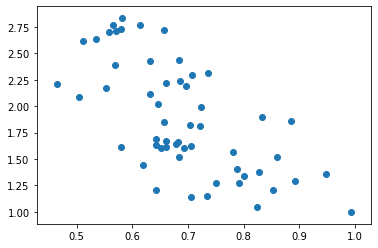

time: 167 ms


In [124]:
plt.scatter(df.spread_ind, df.MI)
plt.show()

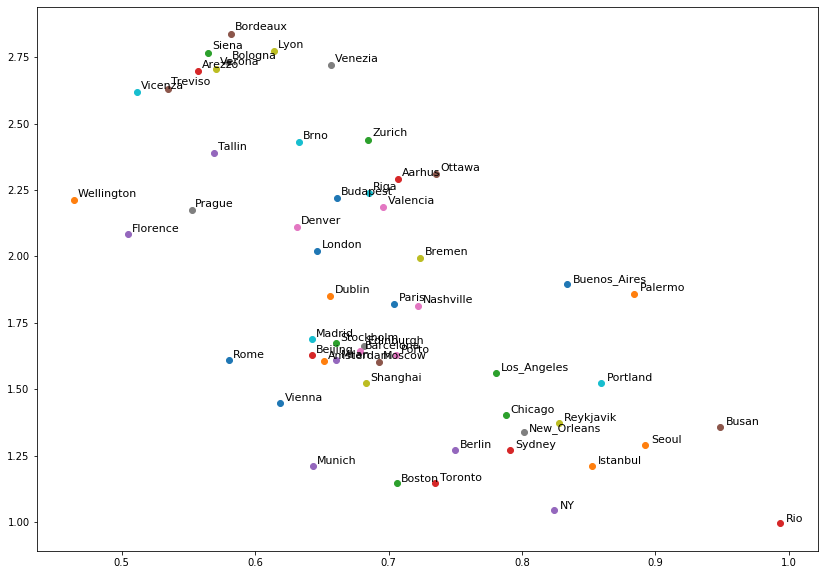

time: 518 ms


In [60]:
cities = list(df.index)
plt.figure(figsize=(14, 10))

for n, city in enumerate(cities):
    x = df.loc[city, 'spread_ind']
    y = df.loc[city, 'MI']
    plt.scatter(x, y)
    plt.text(x * (1 + 0.005), y * (1 + 0.005) , city, fontsize=11)
    
# text = plt.annotate("no price peak olycentric", xy=(.018, .8), xytext=(.018, .8), fontsize=70, c="red")
# text.set_alpha(.1)

# plt.xlabel("Airbnb price decay", fontsize=15)
# plt.ylabel("Spreading index", fontsize=15)
# plt.xlim((0, 0.03))
# plt.ylim((0.3, 1))
plt.show()

In [61]:
pop_frame = pd.read_csv('worldcities.csv', header=0, index_col=0)
pop_frame.head(10)

,city_ascii,lat,lng,country,iso2,iso3,admin_name,capital,population,id
city,,,,,,,,,,
Malishevë,Malisheve,42.4822,20.7458,Kosovo,XK,XKS,Malishevë,admin,NaN,1901597212
Prizren,Prizren,42.2139,20.7397,Kosovo,XK,XKS,Prizren,admin,NaN,1901360309
Zubin Potok,Zubin Potok,42.9144,20.6897,Kosovo,XK,XKS,Zubin Potok,admin,NaN,1901608808
Kamenicë,Kamenice,42.5781,21.5803,Kosovo,XK,XKS,Kamenicë,admin,NaN,1901851592
Viti,Viti,42.3214,21.3583,Kosovo,XK,XKS,Viti,admin,NaN,1901328795
Shtërpcë,Shterpce,42.2394,21.0272,Kosovo,XK,XKS,Shtërpcë,admin,NaN,1901828239
Shtime,Shtime,42.4331,21.0397,Kosovo,XK,XKS,Shtime,admin,NaN,1901598505
Vushtrri,Vushtrri,42.8231,20.9675,Kosovo,XK,XKS,Vushtrri,admin,NaN,1901107642
Dragash,Dragash,42.0265,20.6533,Kosovo,XK,XKS,Dragash,admin,NaN,1901112530


time: 53 ms


In [63]:
pop_frame = pop_frame.dropna()
pop_frame.head(10)

,city_ascii,lat,lng,country,iso2,iso3,admin_name,capital,population,id
city,,,,,,,,,,
Sanaa,Sanaa,15.3547,44.2066,Yemen,YE,YEM,Amānat al ‘Āşimah,primary,2008000.0,1887750814
Marib,Marib,15.4210,45.3340,Yemen,YE,YEM,Ma’rib,admin,16794.0,1887153216
Hajjah,Hajjah,15.6917,43.6021,Yemen,YE,YEM,Ḩajjah,admin,208287.0,1887522445
Ibb,Ibb,13.9759,44.1709,Yemen,YE,YEM,Ibb,admin,234837.0,1887321491
Al Hudaydah,Al Hudaydah,14.7979,42.9530,Yemen,YE,YEM,Al Ḩudaydah,admin,780000.0,1887984890
Lahij,Lahij,13.0582,44.8838,Yemen,YE,YEM,Laḩij,admin,66288.0,1887871834
Taizz,Taizz,13.6045,44.0394,Yemen,YE,YEM,Ta‘izz,admin,751000.0,1887324526
Sadah,Sadah,16.9398,43.8498,Yemen,YE,YEM,Şa‘dah,admin,105542.0,1887513055
Dhamar,Dhamar,14.5575,44.3875,Yemen,YE,YEM,Dhamār,admin,191259.0,1887135215


time: 22 ms


In [71]:
pops_df = pop_frame[pop_frame.index.isin(df.index)]
pops_df = pops_df[['population']]
pops_df

,population
city,
Riga,742572.0
Amsterdam,1031000.0
Porto,1337000.0
Moscow,10452000.0
Stockholm,1264000.0
Istanbul,10061000.0
Barcelona,600954.0
Valencia,1770000.0
Vienna,2400000.0


time: 11 ms


In [70]:
set(df.index) - set(pops_df.index)

{'Aarhus',
 'Buenos_Aires',
 'Chicago',
 'London',
 'Los_Angeles',
 'NY',
 'New_Orleans',
 'Portland',
 'Reykjavik',
 'Rio',
 'Tallin',
 'Venezia',
 'Vicenza',
 'Wellington',
 'Zurich'}

time: 1.99 ms


In [73]:
pops_df['city'] = pops_df.index
pops_df

,population,city
city,,
Riga,742572.0,Riga
Amsterdam,1031000.0,Amsterdam
Porto,1337000.0,Porto
Moscow,10452000.0,Moscow
Stockholm,1264000.0,Stockholm
Istanbul,10061000.0,Istanbul
Barcelona,600954.0,Barcelona
Valencia,1770000.0,Valencia
Vienna,2400000.0,Vienna


time: 193 ms


In [74]:
pops_df = pops_df.append({'city' : 'Aarhus' , 'population' : 336411.0} , ignore_index=True)
pops_df

,population,city
0,742572.0,Riga
1,1031000.0,Amsterdam
2,1337000.0,Porto
3,10452000.0,Moscow
4,1264000.0,Stockholm
5,10061000.0,Istanbul
6,600954.0,Barcelona
7,1770000.0,Valencia
8,2400000.0,Vienna
9,4630000.0,Sydney


time: 13 ms


In [ ]:
{'Aarhus',
 'Buenos_Aires',
 'Chicago',
 'London',
 'Los_Angeles',
 'NY',
 'New_Orleans',
 'Portland',
 'Reykjavik',
 'Rio',
 'Tallin',
 'Venezia',
 'Vicenza',
 'Wellington',
 'Zurich'}

In [75]:
pops_df = pops_df.append({'city' : 'Buenos_Aires' , 'population' : 2891000.0} , ignore_index=True)
pops_df = pops_df.append({'city' : 'Chicago' , 'population' : 2716000.0} , ignore_index=True)
pops_df = pops_df.append({'city' : 'London' , 'population' : 8912000.0} , ignore_index=True)
pops_df = pops_df.append({'city' : 'Los_Angeles' , 'population' : 4000000.0} , ignore_index=True)
pops_df = pops_df.append({'city' : 'NY' , 'population' : 8623000.0} , ignore_index=True)
pops_df = pops_df.append({'city' : 'New_Orleans' , 'population' : 393292.0} , ignore_index=True)
pops_df = pops_df.append({'city' : 'Portland' , 'population' : 647805.0} , ignore_index=True)
pops_df = pops_df.append({'city' : 'Reykjavik' , 'population' : 122853.0} , ignore_index=True)
pops_df = pops_df.append({'city' : 'Rio' , 'population' : 6320000.0} , ignore_index=True)
pops_df = pops_df.append({'city' : 'Tallin' , 'population' : 426538.0} , ignore_index=True)
pops_df = pops_df.append({'city' : 'Venezia' , 'population' : 53000.0} , ignore_index=True)
pops_df = pops_df.append({'city' : 'Vicenza' , 'population' : 112198.0} , ignore_index=True)
pops_df = pops_df.append({'city' : 'Wellington' , 'population' : 212700.0} , ignore_index=True)
pops_df = pops_df.append({'city' : 'Zurich' , 'population' : 402762.0} , ignore_index=True)
pops_df

,population,city
0,742572.0,Riga
1,1031000.0,Amsterdam
2,1337000.0,Porto
3,10452000.0,Moscow
4,1264000.0,Stockholm
5,10061000.0,Istanbul
6,600954.0,Barcelona
7,1770000.0,Valencia
8,2400000.0,Vienna
9,4630000.0,Sydney


time: 42 ms


In [76]:
pops_df[pops_df.city=='Valencia']

,population,city
7,1770000.0,Valencia
20,808000.0,Valencia


time: 5.98 ms


In [77]:
pops_df = pops_df.drop(pops_df[pops_df.population == 808000.0].index)
pops_df

,population,city
0,742572.0,Riga
1,1031000.0,Amsterdam
2,1337000.0,Porto
3,10452000.0,Moscow
4,1264000.0,Stockholm
5,10061000.0,Istanbul
6,600954.0,Barcelona
7,1770000.0,Valencia
8,2400000.0,Vienna
9,4630000.0,Sydney


time: 14 ms


In [79]:
pops_df = pops_df[pops_df.city.isin(pops_df.city.unique())]
pops_df

,population,city
0,742572.0,Riga
1,1031000.0,Amsterdam
2,1337000.0,Porto
3,10452000.0,Moscow
4,1264000.0,Stockholm
5,10061000.0,Istanbul
6,600954.0,Barcelona
7,1770000.0,Valencia
8,2400000.0,Vienna
9,4630000.0,Sydney


time: 13 ms


In [81]:
pops_df.loc[pops_df.city=='Valencia', 'population'] = 2531000.0
pops_df

,population,city
0,742572.0,Riga
1,1031000.0,Amsterdam
2,1337000.0,Porto
3,10452000.0,Moscow
4,1264000.0,Stockholm
5,10061000.0,Istanbul
6,600954.0,Barcelona
7,2531000.0,Valencia
8,2400000.0,Vienna
9,4630000.0,Sydney


time: 14 ms


In [82]:
pop_dict = dict(zip(pops_df.city, pops_df.population))
pop_dict

{'Riga': 742572.0,
 'Amsterdam': 1031000.0,
 'Porto': 1337000.0,
 'Moscow': 10452000.0,
 'Stockholm': 1264000.0,
 'Istanbul': 10061000.0,
 'Barcelona': 4920000.0,
 'Valencia': 2531000.0,
 'Vienna': 2400000.0,
 'Sydney': 4630000.0,
 'Toronto': 5213000.0,
 'Ottawa': 1145000.0,
 'Shanghai': 14987000.0,
 'Beijing': 11106000.0,
 'Prague': 1162000.0,
 'Brno': 388277.0,
 'Berlin': 3406000.0,
 'Munich': 1275000.0,
 'Bremen': 724909.0,
 'Madrid': 5567000.0,
 'Paris': 9904000.0,
 'Bordeaux': 803000.0,
 'Lyon': 1423000.0,
 'Edinburgh': 504966.0,
 'Budapest': 1679000.0,
 'Dublin': 1059000.0,
 'Rome': 3339000.0,
 'Palermo': 863000.0,
 'Bologna': 488172.0,
 'Milan': 2945000.0,
 'Florence': 1500000.0,
 'Treviso': 177309.0,
 'Verona': 347459.0,
 'Arezzo': 91589.0,
 'Siena': 52625.0,
 'Seoul': 9796000.0,
 'Busan': 3480000.0,
 'Nashville': 1076645.0,
 'Denver': 2787266.0,
 'Boston': 4637537.0,
 'Aarhus': 336411.0,
 'Buenos_Aires': 2891000.0,
 'Chicago': 2716000.0,
 'London': 8912000.0,
 'Los_Angeles': 4

time: 4 ms


In [85]:
df['population'] = 0 
df['population'].update(pd.Series(pop_dict))
df.head()

,City,avg_slope_long,avg_slope_short,time_to_closest,MI,avg_dist,spread_ind,population
City,,,,,,,,
Paris,Paris,0.010453,0.002685,14.996127,1.822148,7097.984558,0.704071,9904000
Amsterdam,Amsterdam,0.017791,0.005078,15.696124,1.606388,7020.480387,0.651394,1031000
Stockholm,Stockholm,0.011601,0.003211,11.409805,1.673804,5849.710815,0.660285,1264000
Arezzo,Arezzo,0.012662,0.010533,6.042318,2.697380,1662.017838,0.557431,91589
Berlin,Berlin,0.017169,0.007168,13.601258,1.271940,8495.253652,0.749987,3406000


time: 13 ms


In [87]:
df['gaussian_axes_ratio'] = df.avg_slope_long / df.avg_slope_short
df['avg_dist'] = df.avg_dist / 1000
df['population'] = df.population / 1000000
city_frame = df.copy()
city_frame.drop(['City', 'avg_slope_long', 'avg_slope_short'], axis=1, inplace=True)
city_frame.head(10)

,time_to_closest,MI,avg_dist,spread_ind,population,gaussian_axes_ratio
City,,,,,,
Paris,14.996127,1.822148,7.097985,0.704071,9.904000,3.893205
Amsterdam,15.696124,1.606388,7.020480,0.651394,1.031000,3.503612
Stockholm,11.409805,1.673804,5.849711,0.660285,1.264000,3.613016
Arezzo,6.042318,2.697380,1.662018,0.557431,0.091589,1.202088
Berlin,13.601258,1.271940,8.495254,0.749987,3.406000,2.395203
Bordeaux,13.149932,2.837285,3.886551,0.581833,0.803000,1.035437
Denver,12.000288,2.112497,3.896344,0.631211,2.787266,1.680620
Edinburgh,6.576035,1.663528,3.747782,0.681330,0.504966,2.180963
Lyon,13.482817,2.772300,4.921517,0.613831,1.423000,1.886533


time: 14 ms


In [327]:
times['Paris']

{'times_1': array([ 4.69777027,  4.86009459,  4.51940991,  8.02701351,  7.2705991 ,
         6.89436937,  7.68254505, 11.151     ,  8.63963063, 14.58425225,
        15.56461712, 16.43954955, 16.23301351, 14.7475045 , 14.48808108,
        12.59840991, 14.2675    , 14.69995045, 16.42616216, 17.23072973,
        18.30277477, 20.74358108, 20.96007658, 22.52304505, 22.62630631,
        21.21677477, 21.18282883, 20.05986486, 21.16847748, 22.29274324,
        23.85174775, 22.29054955, 23.7511036 , 23.41001351, 24.60175676,
        22.07492342, 22.13865315, 22.9578964 , 22.97406306, 23.04815766,
        22.12638288, 22.52876126, 22.45859009, 22.45859009, 21.98926577,
        22.5183018 , 23.55858559, 24.20909009, 25.81832432, 25.15387387,
        26.7479009 , 27.53972973, 28.81158108, 30.52477027, 31.24355856,
        32.09335135, 31.6390045 , 41.77972523, 37.7510991 , 37.62983784,
        38.74038739, 39.95813063, 39.60736937, 38.91653153, 37.56399099,
        34.62439189, 30.68119369, 28.286

time: 24 ms


In [329]:
list(times['Paris'].values())[0]

array([ 4.69777027,  4.86009459,  4.51940991,  8.02701351,  7.2705991 ,
        6.89436937,  7.68254505, 11.151     ,  8.63963063, 14.58425225,
       15.56461712, 16.43954955, 16.23301351, 14.7475045 , 14.48808108,
       12.59840991, 14.2675    , 14.69995045, 16.42616216, 17.23072973,
       18.30277477, 20.74358108, 20.96007658, 22.52304505, 22.62630631,
       21.21677477, 21.18282883, 20.05986486, 21.16847748, 22.29274324,
       23.85174775, 22.29054955, 23.7511036 , 23.41001351, 24.60175676,
       22.07492342, 22.13865315, 22.9578964 , 22.97406306, 23.04815766,
       22.12638288, 22.52876126, 22.45859009, 22.45859009, 21.98926577,
       22.5183018 , 23.55858559, 24.20909009, 25.81832432, 25.15387387,
       26.7479009 , 27.53972973, 28.81158108, 30.52477027, 31.24355856,
       32.09335135, 31.6390045 , 41.77972523, 37.7510991 , 37.62983784,
       38.74038739, 39.95813063, 39.60736937, 38.91653153, 37.56399099,
       34.62439189, 30.68119369, 28.28694144, 26.23803153, 27.71

time: 13 ms


In [330]:
closest_furthest_times = {city:np.round(np.mean(list(times[city].values())[-1]) - np.mean(list(times[city].values())[0]),4) for city in times}
closest_furthest_times

{'Paris': 20.0605,
 'Amsterdam': 41.621,
 'Stockholm': 22.6757,
 'Arezzo': 0.0,
 'Berlin': 35.1038,
 'Bordeaux': 0.0,
 'Denver': 10.5161,
 'Edinburgh': 14.9102,
 'Lyon': 0.0,
 'Madrid': 17.767,
 'Buenos_Aires': 26.0169,
 'Palermo': 41.8066,
 'Los_Angeles': 80.5721,
 'Beijing': 22.9697,
 'Florence': 7.8353,
 'Moscow': 21.3111,
 'Porto': 20.9129,
 'Prague': 6.8733,
 'Reykjavik': 17.8703,
 'Riga': 7.1004,
 'Rome': 24.6743,
 'Seoul': 41.4231,
 'Siena': 0.0,
 'Sydney': 70.8149,
 'Tallin': 3.537,
 'Treviso': 0.0,
 'Valencia': 11.4912,
 'Venezia': 0.0,
 'Verona': 0.0,
 'Vicenza': 0.0,
 'Vienna': 18.6821,
 'Wellington': 6.6273,
 'Zurich': 4.4626,
 'Aarhus': 6.571,
 'Milan': 19.4688,
 'Busan': 58.266,
 'Barcelona': 20.8052,
 'Bologna': 0.0,
 'Bremen': 15.0176,
 'Brno': 6.1512,
 'Budapest': 9.706,
 'Dublin': 12.4958,
 'Boston': 33.781,
 'Rio': 114.8311,
 'NY': 67.6977,
 'Ottawa': 8.0907,
 'Nashville': 26.1823,
 'New Orleans': 50.5871,
 'Shanghai': 26.8743,
 'Portland': 38.3269,
 'Istanbul': 69.8

time: 8.98 ms


In [333]:
city_frame = city_frame.drop(['lat', 'lon', 'cluster'], 1)
city_frame['time_diff'] = 0 
city_frame['time_diff'].update(pd.Series(closest_furthest_times))
city_frame.head()

,time_to_closest,MI,avg_dist,spread_ind,population,gaussian_axes_ratio,time_diff
City,,,,,,,
Paris,14.996127,1.822148,7.097985,0.704071,9.904000,3.893205,20.0605
Amsterdam,15.696124,1.606388,7.020480,0.651394,1.031000,3.503612,41.6210
Stockholm,11.409805,1.673804,5.849711,0.660285,1.264000,3.613016,22.6757
Arezzo,6.042318,2.697380,1.662018,0.557431,0.091589,1.202088,0.0000
Berlin,13.601258,1.271940,8.495254,0.749987,3.406000,2.395203,35.1038


time: 12 ms


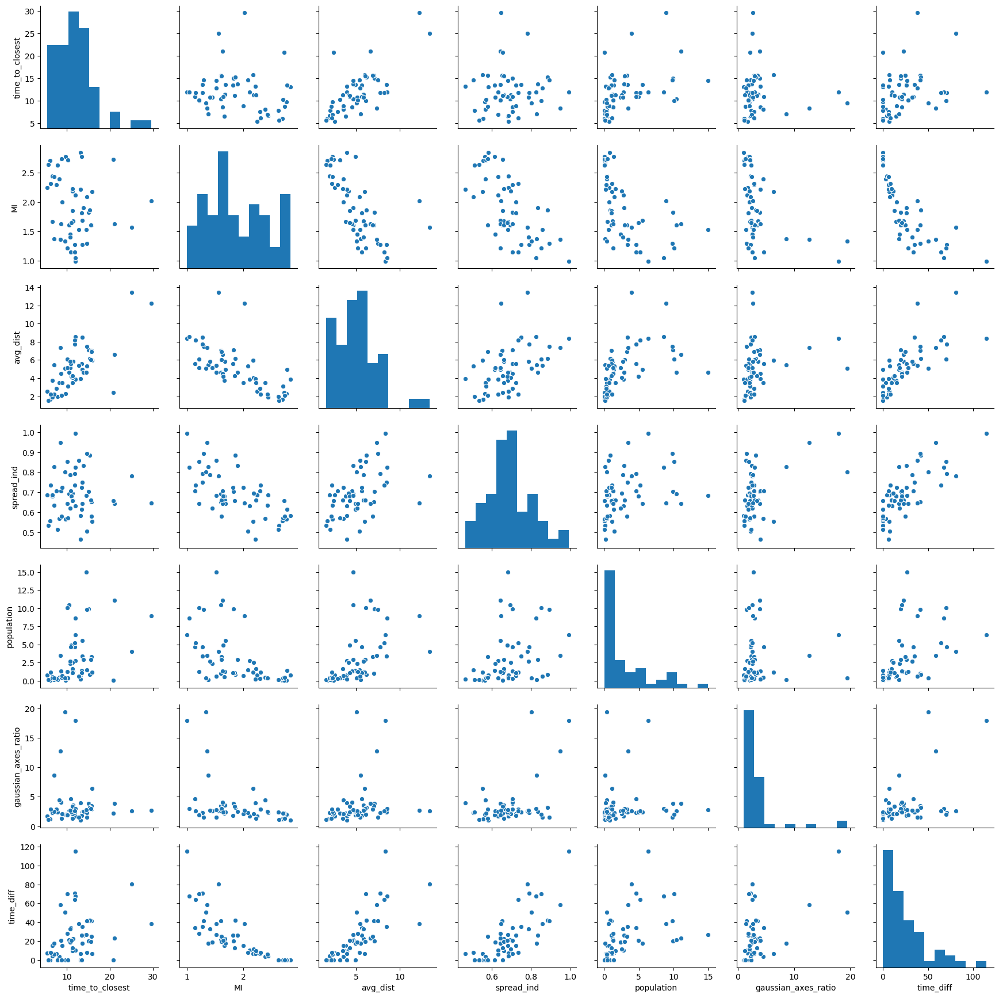

time: 15.9 s


In [334]:
import seaborn as sns
g = sns.pairplot(city_frame)

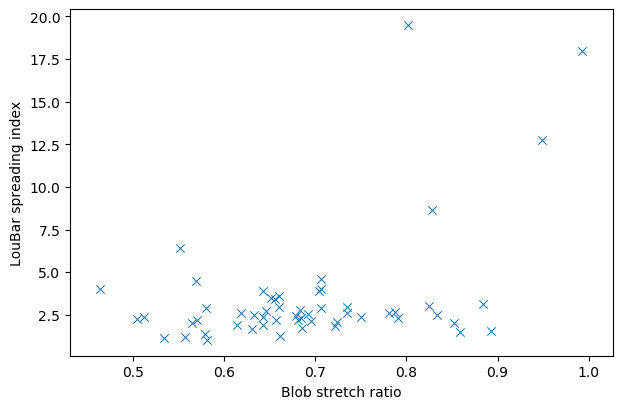

time: 188 ms


In [342]:
fig, ax = plt.subplots(figsize=(7,4.5))
sns.scatterplot(x='spread_ind',y='gaussian_axes_ratio',data=city_frame, marker='x', ax=ax) 
# Add a title to the Figure
#fig.suptitle("My figtitle", fontsize=11)
ax.set_ylabel('LouBar spreading index')
ax.set_xlabel('Blob stretch ratio')
plt.show()

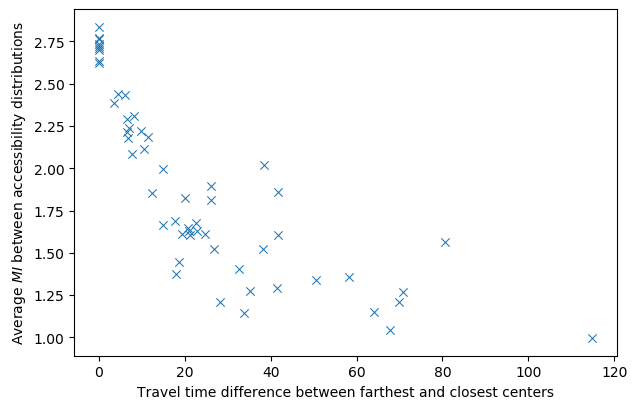

time: 199 ms


In [337]:
fig, ax = plt.subplots(figsize=(7,4.5))
sns.scatterplot(x='time_diff',y='MI',data=city_frame, marker='x', ax=ax) 
# Add a title to the Figure
#fig.suptitle("My figtitle", fontsize=11)
ax.set_ylabel('Average $MI$ between accessibility distributions')
ax.set_xlabel('Travel time difference between farthest and closest centers')
plt.show()

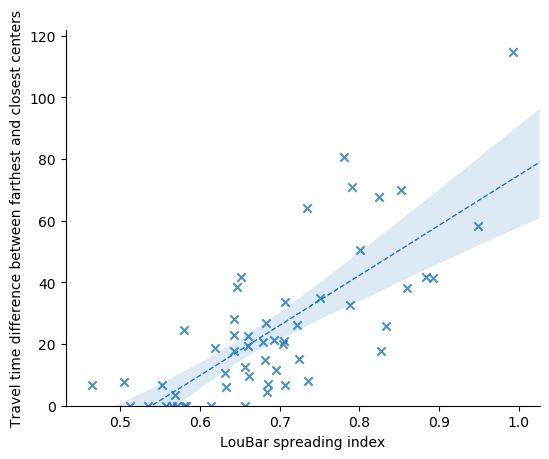

time: 363 ms


In [343]:
lm = sns.lmplot(x='spread_ind',y='time_diff',data=city_frame,fit_reg=True, height=4.5, aspect=1.25, markers='x', line_kws={"lw":1,
                     'ls':'--'}) 
fig = lm.fig 
axes= lm.axes
axes[0,0].set_ylim(0,)
# Add a title to the Figure
lm.set(xlabel='LouBar spreading index', ylabel='Travel time difference between farthest and closest centers')
#fig.suptitle("My figtitle", fontsize=11)


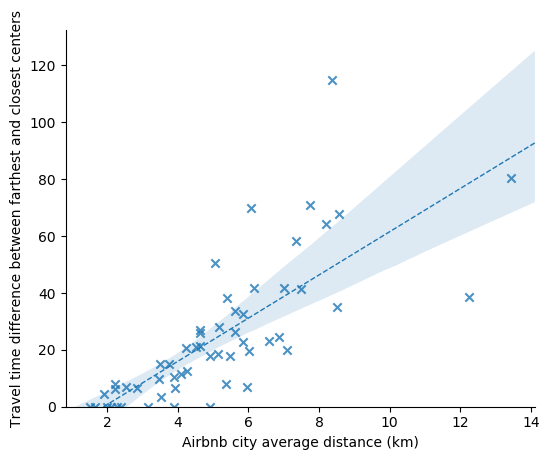

time: 378 ms


In [341]:
lm = sns.lmplot(x='avg_dist',y='time_diff',data=city_frame,fit_reg=True, height=4.5, aspect=1.25, markers='x', line_kws={"lw":1,
                     'ls':'--'}) 
fig = lm.fig 
axes= lm.axes
axes[0,0].set_ylim(0,)
# Add a title to the Figure
lm.set(xlabel='Airbnb city average distance (km)', ylabel='Travel time difference between farthest and closest centers')
#fig.suptitle("My figtitle", fontsize=11)


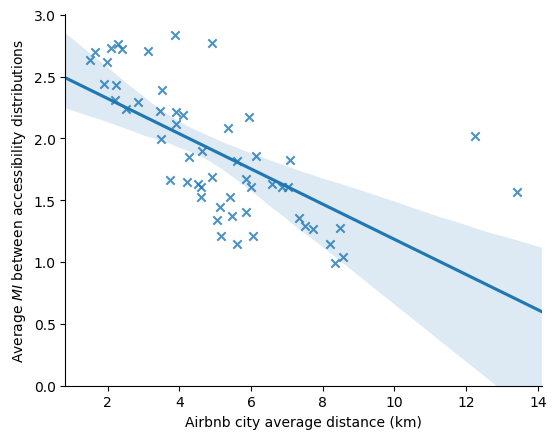

time: 381 ms


In [303]:
lm = sns.lmplot(x='avg_dist',y='MI',data=city_frame,fit_reg=True, height=4.5, aspect=1.25, markers='x') 
fig = lm.fig 
axes= lm.axes
axes[0,0].set_ylim(0,)
# Add a title to the Figure
lm.set(xlabel='Airbnb city average distance (km)', ylabel='Average $MI$ between accessibility distributions')
#fig.suptitle("My figtitle", fontsize=11)


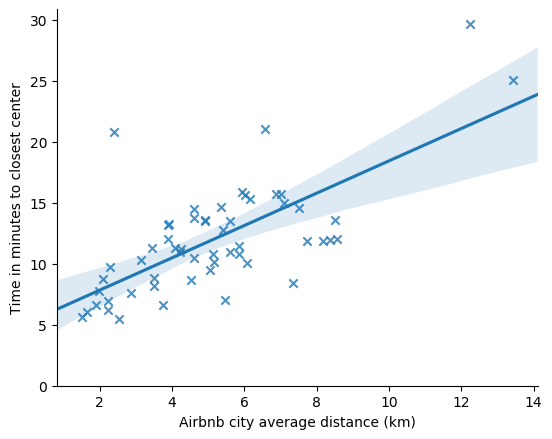

time: 342 ms


In [304]:
lm = sns.lmplot(x='avg_dist',y='time_to_closest',data=city_frame,fit_reg=True, height=4.5, aspect=1.25, markers='x') 
fig = lm.fig 
axes= lm.axes
axes[0,0].set_ylim(0,)
# Add a title to the Figure
lm.set(xlabel='Airbnb city average distance (km)', ylabel='Time in minutes to closest center')
#fig.suptitle("My figtitle", fontsize=11)


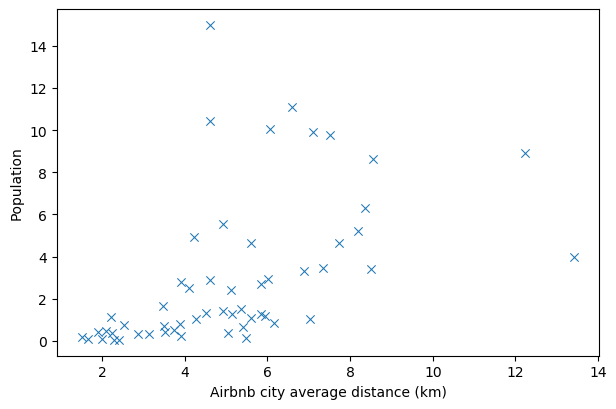

time: 181 ms


In [305]:
fig, ax = plt.subplots(figsize=(7,4.5))
sns.scatterplot(x='avg_dist',y='population',data=city_frame, marker='x', ax=ax) 
# Add a title to the Figure
#fig.suptitle("My figtitle", fontsize=11)
ax.set_ylabel('Population')
ax.set_xlabel('Airbnb city average distance (km)')
plt.show()

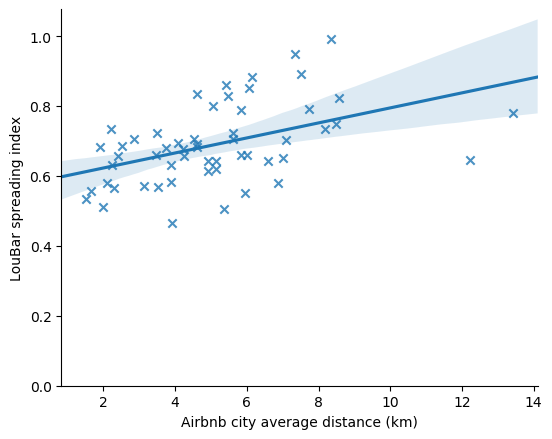

time: 363 ms


In [306]:
lm = sns.lmplot(x='avg_dist',y='spread_ind',data=city_frame,fit_reg=True, height=4.5, aspect=1.25, markers='x') 
fig = lm.fig 
axes= lm.axes
axes[0,0].set_ylim(0,)
# Add a title to the Figure
lm.set(xlabel='Airbnb city average distance (km)', ylabel='LouBar spreading index')
#fig.suptitle("My figtitle", fontsize=11)


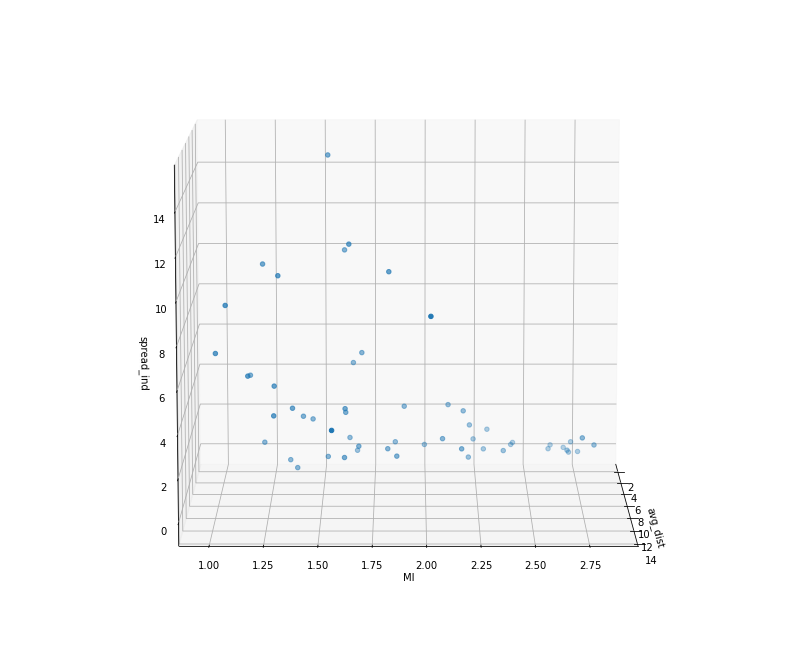

time: 204 ms


In [98]:
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D

threedee = plt.figure(figsize=(14,12)).gca(projection='3d')
threedee.scatter(city_frame.avg_dist, city_frame['MI'], city_frame['population'])
threedee.set_xlabel('avg_dist')
threedee.set_ylabel('MI')
threedee.set_zlabel('spread_ind')
threedee.view_init(10, 0)
plt.show()

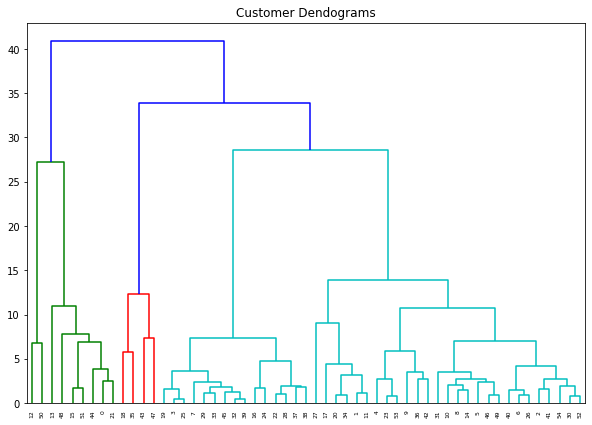

time: 1.39 s


In [123]:
import scipy.cluster.hierarchy as shc
data = city_frame.iloc[:,:-3].values
plt.figure(figsize=(10, 7))
plt.title("Customer Dendograms")
dend = shc.dendrogram(shc.linkage(data, method='ward'))

In [100]:
from sklearn.cluster import AgglomerativeClustering

cluster = AgglomerativeClustering(n_clusters=5, affinity='euclidean', linkage='ward')
cluster.fit_predict(data)

array([1, 0, 0, 3, 0, 0, 0, 3, 0, 0, 0, 0, 4, 1, 0, 1, 3, 0, 2, 3, 0, 1,
       3, 0, 3, 3, 0, 0, 3, 3, 0, 0, 3, 3, 0, 2, 0, 3, 3, 3, 0, 0, 0, 2,
       1, 3, 0, 2, 1, 0, 4, 1, 0, 0, 0], dtype=int64)

time: 162 ms


In [101]:
labels = cluster.fit_predict(data)
len(labels)

55

time: 4 ms


In [102]:
city_frame['cluster'] = labels
city_frame.head()

,time_to_closest,MI,avg_dist,spread_ind,population,gaussian_axes_ratio,cluster
City,,,,,,,
Paris,14.996127,1.822148,7.097985,0.704071,9.904000,3.893205,1
Amsterdam,15.696124,1.606388,7.020480,0.651394,1.031000,3.503612,0
Stockholm,11.409805,1.673804,5.849711,0.660285,1.264000,3.613016,0
Arezzo,6.042318,2.697380,1.662018,0.557431,0.091589,1.202088,3
Berlin,13.601258,1.271940,8.495254,0.749987,3.406000,2.395203,0


time: 11 ms


In [110]:
city_frame[city_frame.cluster == 0].index

Index(['Amsterdam', 'Stockholm', 'Berlin', 'Bordeaux', 'Denver', 'Lyon',
       'Madrid', 'Buenos_Aires', 'Palermo', 'Florence', 'Prague', 'Rome',
       'Sydney', 'Valencia', 'Venezia', 'Vienna', 'Wellington', 'Milan',
       'Barcelona', 'Budapest', 'Dublin', 'Boston', 'Nashville', 'Portland',
       'Chicago', 'Toronto', 'Munich'],
      dtype='object', name='City')

time: 4 ms


In [113]:
pop_frame

,city_ascii,lat,lng,country,iso2,iso3,admin_name,capital,population,id
city,,,,,,,,,,
Sanaa,Sanaa,15.3547,44.2066,Yemen,YE,YEM,Amānat al ‘Āşimah,primary,2008000.0,1887750814
Marib,Marib,15.4210,45.3340,Yemen,YE,YEM,Ma’rib,admin,16794.0,1887153216
Hajjah,Hajjah,15.6917,43.6021,Yemen,YE,YEM,Ḩajjah,admin,208287.0,1887522445
Ibb,Ibb,13.9759,44.1709,Yemen,YE,YEM,Ibb,admin,234837.0,1887321491
Al Hudaydah,Al Hudaydah,14.7979,42.9530,Yemen,YE,YEM,Al Ḩudaydah,admin,780000.0,1887984890
Lahij,Lahij,13.0582,44.8838,Yemen,YE,YEM,Laḩij,admin,66288.0,1887871834
Taizz,Taizz,13.6045,44.0394,Yemen,YE,YEM,Ta‘izz,admin,751000.0,1887324526
Sadah,Sadah,16.9398,43.8498,Yemen,YE,YEM,Şa‘dah,admin,105542.0,1887513055
Dhamar,Dhamar,14.5575,44.3875,Yemen,YE,YEM,Dhamār,admin,191259.0,1887135215


time: 38 ms


In [114]:
lat_dict = dict(zip(pop_frame.index, pop_frame.lat))
lon_dict = dict(zip(pop_frame.index, pop_frame.lng))
city_frame['lat'] = 0 
city_frame['lat'].update(pd.Series(lat_dict))
city_frame['lon'] = 0 
city_frame['lon'].update(pd.Series(lon_dict))
city_frame

,time_to_closest,MI,avg_dist,spread_ind,population,gaussian_axes_ratio,cluster,lat,lon
City,,,,,,,,,
Paris,14.996127,1.822148,7.097985,0.704071,9.904000,3.893205,1,48.8667,2.3333
Amsterdam,15.696124,1.606388,7.020480,0.651394,1.031000,3.503612,0,52.3500,4.9166
Stockholm,11.409805,1.673804,5.849711,0.660285,1.264000,3.613016,0,59.3508,18.0973
Arezzo,6.042318,2.697380,1.662018,0.557431,0.091589,1.202088,3,43.4617,11.8750
Berlin,13.601258,1.271940,8.495254,0.749987,3.406000,2.395203,0,52.5218,13.4015
Bordeaux,13.149932,2.837285,3.886551,0.581833,0.803000,1.035437,0,44.8500,-0.5950
Denver,12.000288,2.112497,3.896344,0.631211,2.787266,1.680620,0,39.7621,-104.8759
Edinburgh,6.576035,1.663528,3.747782,0.681330,0.504966,2.180963,3,55.9483,-3.2191
Lyon,13.482817,2.772300,4.921517,0.613831,1.423000,1.886533,0,45.7700,4.8300


time: 38 ms


In [156]:
city_frame_normalised = city_frame.iloc[:,:-3]
from sklearn import preprocessing

x = city_frame_normalised.values #returns a numpy array
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
city_frame_normalised = pd.DataFrame(x_scaled)
city_frame_normalised

,0,1,2,3,4,5
0,0.394955,0.449082,0.468958,0.453353,0.659644,0.154912
1,0.423960,0.331988,0.462456,0.353702,0.065512,0.133793
2,0.246353,0.368575,0.364227,0.370523,0.081113,0.139723
3,0.023946,0.924073,0.012875,0.175950,0.002609,0.009034
4,0.337157,0.150482,0.586191,0.540214,0.224541,0.073709
5,0.318456,1.000000,0.199516,0.222112,0.050245,0.000000
6,0.270820,0.606655,0.200337,0.315522,0.183111,0.034974
7,0.046061,0.362998,0.187873,0.410333,0.030289,0.062096
8,0.332250,0.964732,0.286350,0.282643,0.091760,0.046136
9,0.336095,0.376282,0.286431,0.337079,0.369240,0.071968


time: 18 ms


In [157]:
from scipy.spatial.distance import cdist
city_array = city_frame_normalised.to_numpy()
dist_mat_city = cdist(city_array, city_array)
dist_mat_city

array([[0.        , 0.61478816, 0.617513  , ..., 0.59496557, 0.51601108,
        0.73242263],
       [0.61478816, 0.        , 0.20758952, ..., 0.37994809, 0.45027228,
        0.36351072],
       [0.617513  , 0.20758952, 0.        , ..., 0.30375824, 0.46160281,
        0.28130825],
       ...,
       [0.59496557, 0.37994809, 0.30375824, ..., 0.        , 0.31267902,
        0.31802896],
       [0.51601108, 0.45027228, 0.46160281, ..., 0.31267902, 0.        ,
        0.41524304],
       [0.73242263, 0.36351072, 0.28130825, ..., 0.31802896, 0.41524304,
        0.        ]])

time: 4.01 ms


In [163]:
dist_mat_surf.max()

1.417673701211141

time: 2.99 ms


In [164]:
surf_mat_norm = dist_mat_surf/dist_mat_surf.max()
surf_mat_norm

array([[0.        , 0.05792225, 0.22995384, ..., 0.05751603, 0.05757003,
        0.02226665],
       [0.05792225, 0.        , 0.33778362, ..., 0.06790493, 0.0790501 ,
        0.08919005],
       [0.22995384, 0.33778362, 0.        , ..., 0.37132067, 0.19826287,
        0.15605259],
       ...,
       [0.05751603, 0.06790493, 0.37132067, ..., 0.        , 0.11311973,
        0.08775297],
       [0.05757003, 0.0790501 , 0.19826287, ..., 0.11311973, 0.        ,
        0.05038448],
       [0.02226665, 0.08919005, 0.15605259, ..., 0.08775297, 0.05038448,
        0.        ]])

time: 2.99 ms


In [165]:
total_distmat = surf_mat_norm + dist_mat_city
total_distmat

array([[0.        , 0.67271041, 0.84746684, ..., 0.6524816 , 0.57358111,
        0.75468928],
       [0.67271041, 0.        , 0.54537313, ..., 0.44785302, 0.52932238,
        0.45270076],
       [0.84746684, 0.54537313, 0.        , ..., 0.67507891, 0.65986569,
        0.43736083],
       ...,
       [0.6524816 , 0.44785302, 0.67507891, ..., 0.        , 0.42579875,
        0.40578192],
       [0.57358111, 0.52932238, 0.65986569, ..., 0.42579875, 0.        ,
        0.46562752],
       [0.75468928, 0.45270076, 0.43736083, ..., 0.40578192, 0.46562752,
        0.        ]])

time: 3 ms


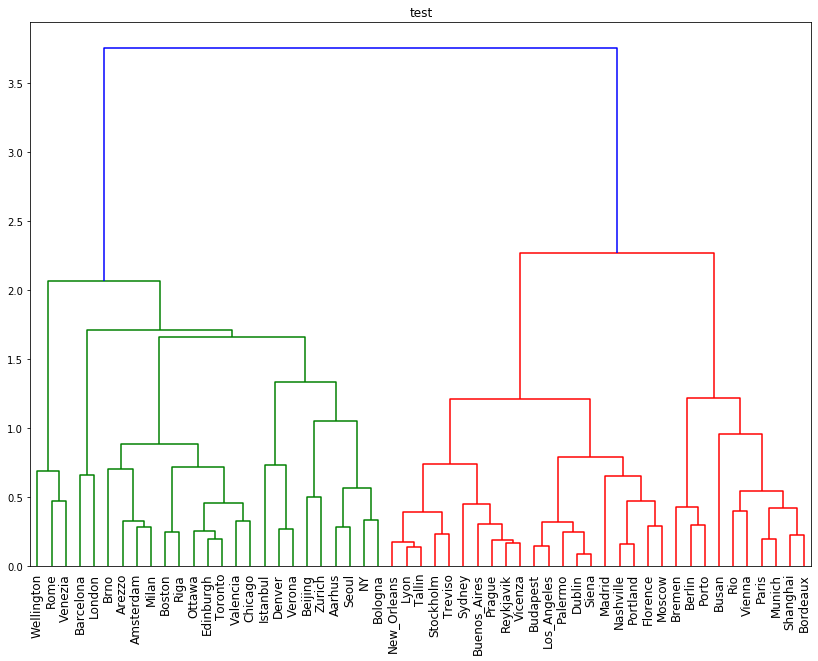

time: 1.56 s


In [166]:
dists = squareform(total_distmat)
linkage_matrix = linkage(dists, "ward")
fig, ax = plt.subplots(figsize=(14,10))
dendrogram(linkage_matrix, labels=city_list, leaf_font_size=12)
plt.title("test")
plt.show()

In [169]:
etas_cut_threshold_dict

{'NY': array([1.        , 1.        , 1.        , 1.        , 1.        ,
        0.99991145, 0.98955316, 0.97868522, 0.96344498, 0.95205618,
        0.94615067, 0.93194961, 0.92540239, 0.92150344, 0.91822455,
        0.91569734, 0.91218202, 0.90337978, 0.898264  , 0.89376519,
        0.89441924, 0.88573077, 0.88617046, 0.87902683, 0.87195329,
        0.87101443, 0.87158631, 0.86935351, 0.86321974, 0.86053312,
        0.86079304, 0.86069179, 0.86140605, 0.85888874, 0.8617884 ,
        0.85709178, 0.8579834 , 0.85179248, 0.84947743, 0.84847717,
        0.84228408, 0.82983947, 0.82767187, 0.82334824, 0.81678545,
        0.81788964, 0.81304395, 0.807866  , 0.79902867, 0.79698224,
        0.78820712, 0.76853775, 0.76312442, 0.75071909, 0.7481045 ,
        0.73389742, 0.71700231, 0.70245218, 0.68328343, 0.67990807,
        0.66811743, 0.61552082, 0.58620924, 0.57826542, 0.57372339,
        0.55441141, 0.5326264 , 0.53706259, 0.53126932, 0.52772792,
        0.5331439 , 0.51700595, 0.49034259

time: 55 ms


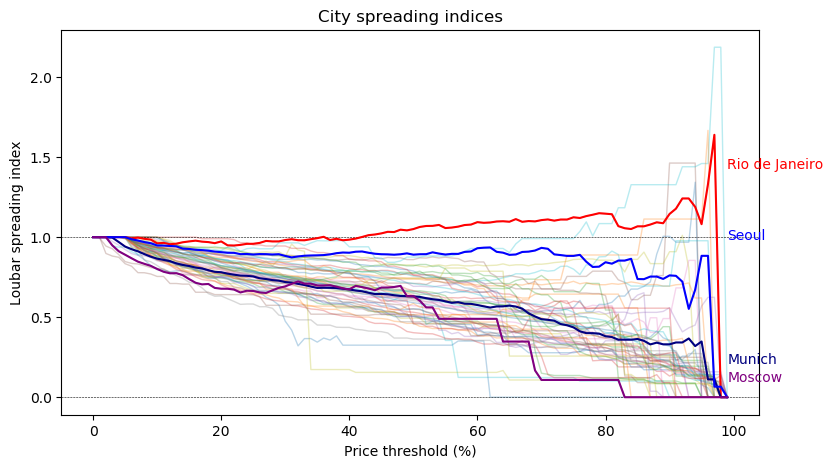

time: 384 ms


In [254]:
x = np.arange(100)
plt.style.use('default')
fig, ax = plt.subplots(figsize=(9, 5))

plt.plot(x, etas_cut_threshold_dict['Rio'], linestyle='-', linewidth=1.5, c ='r', zorder=60)
plt.text(x[-4]+3,etas_cut_threshold_dict['Rio'][-4]+0.1, 'Rio de Janeiro', fontsize=10, c='r')

plt.plot(x, etas_cut_threshold_dict['Munich'], linestyle='-', linewidth=1.5, c ='navy', zorder=100)
plt.text(x[-4]+3,etas_cut_threshold_dict['Munich'][-4]+0.1, 'Munich', fontsize=10, c='navy')

plt.plot(x, etas_cut_threshold_dict['Seoul'], linestyle='-', linewidth=1.5, c ='b', zorder=100)
plt.text(x[-4]+3,etas_cut_threshold_dict['Seoul'][-4]+0.1, 'Seoul', fontsize=10, c='b')

plt.plot(x, etas_cut_threshold_dict['Moscow'], linestyle='-', linewidth=1.5, c ='purple', zorder=100)
plt.text(x[-4]+3,etas_cut_threshold_dict['Moscow'][-4]+0.1, 'Moscow', fontsize=10, c='purple')

# plt.plot(x, etas_cut_threshold_dict['Busan'], linestyle='-', linewidth=1.5, c ='navy', zorder=100)
# plt.text(x[-4]+3,etas_cut_threshold_dict['Busan'][-3]-0.3, 'Busan', fontsize=10, c='navy')

for key in etas_cut_threshold_dict:
    plt.plot(x, etas_cut_threshold_dict[key], linestyle='-', linewidth=1, alpha=0.3)
plt.axhline(y=0, linestyle='--', linewidth=0.4, c='k')
plt.axhline(y=1, linestyle='--', linewidth=0.4, c='k')
plt.xlabel("Price threshold (%)")
plt.ylabel("Loubar spreading index")
plt.title('City spreading indices')
#plt.legend()
plt.show()

In [316]:
import tiles

time: 68.1 ms
